### RMSprop Optimizer Effect

In [1]:
%matplotlib inline

In [2]:
# pip install tensorflow-gpu

### Imports

In [3]:
# from google.colab import drive
# drive.mount('/content/drive')

In [4]:
# !cd /content/drive/My\ Drive/BTP/RandomInit/2D_FINAL/
# DRIVE_PATH = '/content/drive/My\ Drive/BTP/RandomInit/2D_FINAL/'

In [5]:
from __future__ import print_function, division
import numpy as np 
import sklearn
import json
from sklearn import datasets
import tensorflow as tf
from tensorflow.keras.layers import Input, Dense, Reshape, Flatten, Dropout
from tensorflow.keras.layers import BatchNormalization, Activation, ZeroPadding2D
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.optimizers import Adam, SGD, RMSprop, Nadam
import tensorflow.keras.backend as K
import os
from functools import partial
from scipy import stats
import matplotlib.pyplot as plt
import sys
import numpy as np
import pickle

In [6]:
tf.random.set_seed(53)

In [7]:
os.environ["CUDA_VISIBLE_DEVICES"]="0"

### Synthetic 2D Datsasets

In [8]:
def gaussian_8_modes(BATCH_SIZE=64):
    scale = 2.
    centers = [
        (1, 0),
        (-1, 0),
        (0, 1),
        (0, -1),
        (1. / np.sqrt(2), 1. / np.sqrt(2)),
        (1. / np.sqrt(2), -1. / np.sqrt(2)),
        (-1. / np.sqrt(2), 1. / np.sqrt(2)),
        (-1. / np.sqrt(2), -1. / np.sqrt(2))
    ]
    centers = [(scale * x, scale * y) for x, y in centers]
    while True:
        dataset = []
        for i in range(BATCH_SIZE):
            point = np.random.randn(2) * .02
            center = centers[np.random.choice(len(centers))]
            point[0] += center[0]
            point[1] += center[1]
            dataset.append(point)
        dataset = np.array(dataset, dtype='float32')
        dataset /= 1.414  
        return dataset
      
def gaussian_9_modes(BATCH_SIZE):
    dataset = []
    for i in range(int((90000 / 9))):
        for x in range(-3, 3,2):
            for y in range(-3, 3,2):
                point = np.random.randn(2) * 0.05
                point[0] += 2 * x
                point[1] += 2 * y
                dataset.append(point)
    dataset = np.array(dataset, dtype='float32')
    np.random.shuffle(dataset)
    dataset /= 2.828  

    return dataset
    
def swiss_roll(BATCH_SIZE):
    batch_data = sklearn.datasets.make_swiss_roll(n_samples=BATCH_SIZE, noise=0.25)[0]
    batch_data = batch_data.astype(np.float32)[:, [0, 2]]
    batch_data /= 7.5
    return batch_data
    
def load_data(dataset,DATASET_SIZE):
    if(dataset == '8_modes'):
        return gaussian_8_modes(DATASET_SIZE)
    elif(dataset == '9_modes'):
        return gaussian_9_modes(DATASET_SIZE)
    elif(dataset=='swiss_roll'):
        return swiss_roll(DATASET_SIZE)
    else:
        print('Invalid Dataset')
        exit(0)

### Loss Functions

In [9]:
bce = tf.keras.losses.BinaryCrossentropy()

def ns_loss(y_true,y_pred):
  return -tf.math.log(y_pred+1e-8)


### Utility

In [10]:

def kde(values, fig_size=(8, 8), bbox=[-2, 2, -2, 2], xlabel="", ylabel="", cmap='BuPu', show=False, save=None):
    
    fig, ax = plt.subplots(figsize=fig_size)
    
    kernel = stats.gaussian_kde(values)

    ax.axis(bbox)
    xx, yy = np.mgrid[bbox[0]:bbox[1]:300j, bbox[2]:bbox[3]:300j]
    positions = np.vstack([xx.ravel(), yy.ravel()])
    f = np.reshape(kernel(positions).T, xx.shape)
    cfset = ax.contourf(xx, yy, f, cmap=cmap)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_aspect('equal')

    if save is not None: plt.savefig(save,bbox_inches='tight')
    if show: plt.show()

    plt.close()

    
def dim_vis(D, fig_size=(8, 8), bbox=[-2, 2, -2, 2], xlabel="", ylabel="", cmap='BuPu', 
            color_range=False, show=False, save=None, device='cpu'):

    fig, ax = plt.subplots(figsize=fig_size)
    ax.axis(bbox)
    xx, yy = np.mgrid[bbox[0]:bbox[1]:300j, bbox[2]:bbox[3]:300j]
    positions = np.vstack([xx.ravel(), yy.ravel()])
    f = np.reshape(D(positions.T).numpy().T, xx.shape)
    if color_range:
        cfset = ax.contourf(xx, yy, f, levels=np.linspace(0.35, 0.65, 100), cmap=cmap)
    else:
        cfset = ax.contourf(xx, yy, f, 100, cmap=cmap)

    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_aspect('equal')
    cbar = fig.colorbar(cfset,fraction=0.046, pad=0.04)
    if color_range: 
        seq = [0.35, f.min(), f.mean(), f.max(), 0.65]
        cbar.set_ticks(seq)
        cbar.set_ticklabels(['%.2f' % val for val in np.round(seq, 2)])
        cbar.ax.tick_params(labelsize=22)
        #cbar.set_ticks(np.linspace(0., 1., 11))
    else:
        cbar.set_ticks(np.linspace(f.min(), f.max(), 5))
        cbar.set_ticklabels(['%.2f' % val for val in np.round(np.linspace(f.min(), f.max(), 5), 2)])
    if save is not None: plt.savefig(save,bbox_inches='tight')
    if show: plt.show()

    plt.close()

    

### Log Data

In [11]:
duality_gaps = {}
M1 = {}
M2 = {}
bbox=[-3, 3, -3,3]  

### Model Definitions

#### Parent GAN Class

In [12]:
class GAN():
    def __init__(self):
        self.latent_dim = 100
        self.img_shape = (2,)
        
        optimizer = Adam(1e-4, 0.5)
        dg_optimizer = RMSprop(1e-3)
        
        self.d_updates = 1
        self.g_updates = 1
        self.name      = 'GAN'
        self.setting   = 'convergence'
        self.discriminator = self.build_discriminator()
        
        self.discriminator.compile(loss=bce,
            optimizer=optimizer,
            metrics=['accuracy'])
        
        optimizer = Adam(5e-2, 0.5)
        self.generator = self.build_generator()
        z              = Input(shape=(self.latent_dim,))
        img            = self.generator(z)
        self.discriminator.trainable = False
        valid          = self.discriminator(img)
        self.combined  = Model(z, valid)
        self.combined.compile(loss=bce, optimizer=optimizer)

        
        self.D_norm = []
        self.G_norm = []
        self.D_var = []
        self.G_var = []
        
        init_var_d = [0.1 for i in range(len(self.discriminator.get_weights()))]
        init_var_g = [0.1 for i in range(len(self.generator.get_weights()))]
        
        self.D_var.append(init_var_d)
        self.G_var.append(init_var_g)
        #--------------------------------------------------------------------
        #                      DUALITY GAP
        #--------------------------------------------------------------------
        optimizer = Adam(5e-4, 0.5)
        self.dg_discriminator = self.build_discriminator()
        self.dg_discriminator.compile(loss=bce,
            optimizer=dg_optimizer,
            metrics=['accuracy'])
        
        dg_optimizer = RMSprop(1e-3)
        optimizer = Adam(5e-4, 0.5)
        self.dg_generator = self.build_generator()
        z                 = Input(shape=(self.latent_dim,))
        img               = self.dg_generator(z)
        self.dg_discriminator.trainable = False
        valid             = self.dg_discriminator(img)
        self.dg_combined  = Model(z, valid)
        self.dg_combined.compile(loss=bce, optimizer=dg_optimizer)

    def configure_setting(self,setting):
          
        if(setting=='convergence'):
          self.setting = 'convergence'
          self.d_updates = 1
          self.g_updates = 1

        elif(setting=='mode_collapse'):
          self.setting = 'mode_collapse'
          self.d_updates = 15
          self.g_updates = 1
        
        elif(setting=='divergence'):
          self.setting = 'divergence'
          self.d_updates = 1
          self.g_updates = 1
        else:
          return "Invalid Setting"
          
    def build_generator(self):
        model = Sequential()
        model.add(Dense(128 , input_dim=self.latent_dim))
        model.add(Activation("relu"))
        model.add(Dense(128 ))
        model.add(Activation("relu"))
        model.add(Dense(2 , activation=None))
#         model.summary()
        noise = Input(shape=(self.latent_dim,))
        img   = model(noise)

        return Model(noise, img)

    def build_discriminator(self):
        model = Sequential()
        model.add(Dense(128 , input_dim=2))
        model.add(Activation("relu"))
        model.add(Dense(128 ))
        model.add(Activation("relu"))
        model.add(Dense(1, activation='sigmoid'))
#         model.summary()
        img = Input(shape=self.img_shape)
        validity = model(img)

        return Model(img, validity)


    def duality_gap(self):
        
        DG = {}
        M1 = {}
        M2 = {}
        
        M_u_v_worst = 0
        M_u_worst_v = 0

        self.dg_train_d(random=False)
        M_u_v_worst =  self.score()
        self.dg_train_g(random=False)
        M_u_worst_v =  self.score()
        
        DG['vanilla'] = M_u_v_worst - M_u_worst_v
        M1['vanilla'] = M_u_v_worst
        M2['vanilla'] = M_u_worst_v
        
        self.dg_train_d(random=True)
        M_u_v_worst =  self.score()
        self.dg_train_g(random=True)
        M_u_worst_v =  self.score()
        
        DG['local_random'] = M_u_v_worst - M_u_worst_v
        M1['local_random'] = M_u_v_worst
        M2['local_random'] = M_u_worst_v
        
        return DG,M1,M2

    def score(self):
        nsamples = 128
        ntrials  = 100

        scores = []
        for i in range(ntrials):
          idx = np.random.randint(0, self.X.shape[0], nsamples)
          X = tf.convert_to_tensor(self.X[idx])
          noise = tf.convert_to_tensor(np.random.normal(0, 1, (nsamples, self.latent_dim)),dtype=tf.float32)
          score = tf.reduce_mean( tf.math.log(self.dg_discriminator(X)+1e-4)) + tf.reduce_mean(tf.math.log(abs(1 - self.dg_combined(noise)+1e-4)))
          scores.append(score)
        return np.average(scores)

    def dg_train_g(self, epochs=250, batch_size=64, save_interval=50,random=False):
        
        
        
        if(self.setting=='convergence'):
           std = 0.25
        if(self.setting=='divergence'):
           std = 1.0
        if(self.setting=='mode_collapse'):
           std = 0.10
        
        if(random):
            random_weight_init = [ w + np.random.normal(size=w.shape,scale=std).reshape(w.shape) for i,w in enumerate(self.generator.get_weights())]
#             random_weight_init = [ w + np.random.normal(size=w.shape,scale=np.sqrt(np.asarray(self.G_var)[-1,i])).reshape(w.shape) for i,w in enumerate(self.generator.get_weights())]
            self.dg_generator.set_weights(random_weight_init)
        else:
            self.dg_generator.set_weights(self.generator.get_weights())
        
        self.dg_discriminator.set_weights(self.discriminator.get_weights())
        
        valid = self.get_valid_label(batch_size)
        fake  = self.get_fake_label(batch_size)

        print(" M2 - Random : {}".format(random))
        progbar = tf.keras.utils.Progbar(epochs)
        for epoch in range(1,epochs):
            noise = np.random.normal(0, 1, (batch_size, self.latent_dim))
            g_loss = self.dg_combined.train_on_batch(noise, valid)
            progbar.update(epoch)

    def dg_train_d(self, epochs=250, batch_size=64, save_interval=50,random=False):
        
        
        if(self.setting=='convergence'):
           std = 0.25
        if(self.setting=='divergence'):
           std = 1.0
        if(self.setting=='mode_collapse'):
           std = 0.10
           
        if(random):
            random_weight_init = [ w + np.random.normal(size=w.shape,scale=std).reshape(w.shape) for i,w in enumerate(self.discriminator.get_weights())]
#             random_weight_init = [ w + np.random.normal(size=w.shape,scale=np.sqrt(np.asarray(self.D_var)[-1,i])).reshape(w.shape) for i,w in enumerate(self.discriminator.get_weights())]
            self.dg_discriminator.set_weights(random_weight_init)
        else:    
            self.dg_discriminator.set_weights(self.discriminator.get_weights())
            
        self.dg_generator.set_weights(self.generator.get_weights())
        
        
        valid = self.get_valid_label(batch_size)
        fake  = self.get_fake_label(batch_size)

        print(" M1 - Random : {}".format(random))
        progbar = tf.keras.utils.Progbar(epochs)
        for epoch in range(1,epochs):
            X_train = self.X
            idx = np.random.randint(0, X_train.shape[0], batch_size)
            imgs = X_train[idx]
            noise = np.random.normal(0, 1, (batch_size, self.latent_dim))
            gen_imgs = self.dg_generator.predict(noise)
            d_loss_real = self.dg_discriminator.train_on_batch(imgs, valid)
            d_loss_fake = self.dg_discriminator.train_on_batch(gen_imgs, fake)
            d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)
            progbar.update(epoch)

    def get_valid_label(self,batch_size):
        return np.ones((batch_size, 1))
    
    def get_fake_label(self,batch_size):
        return np.zeros((batch_size, 1))

    def dataset_tune(self,dataset):
        print(dataset,self.setting)
        if(self.setting=='convergence'):
          
          if(dataset=='swiss_roll'):
            self.d_updates = 3
            self.g_updates = 2

          elif(dataset=='8_modes'):
            self.d_updates = 1
            self.g_updates = 1
          
          elif(dataset=='9_modes'):
            self.d_updates = 3
            self.g_updates = 3
          
          else:
            print("Invalid Dataset")
        print(self.d_updates,self.g_updates)
        
        
    def train(self, epochs, batch_size=128, save_interval=50,d_updates=1,g_updates=1,dataset='8_modes',save_path='./'):
        
        d_updates = self.d_updates
        g_updates = self.g_updates
        X_train = load_data(dataset,10000*batch_size)
        self.X = X_train
        self.dataset_tune(dataset)

        idx = np.random.randint(0, X_train.shape[0], 8000)
        gt = X_train[idx]      
#         kde(gt.T, show=True, save=os.path.join(save_path, 'ground_truth'), bbox=bbox)

        valid = self.get_valid_label(batch_size)
        fake  = self.get_fake_label(batch_size)

        global M1
        global M2
        global duality_gaps

        progbar = tf.keras.utils.Progbar(epochs)
        for epoch in range(epochs):

            if epoch % save_interval == 0:
                weight_save_path  = '{}/weights'.format(save_path)
                generator_weights = '{}/weights/G/step_{}/'.format(save_path,epoch)
                discriminator_weights = '{}/weights/D/step_{}/'.format(save_path,epoch)
                self.generator.load_weights(generator_weights)
                self.discriminator.load_weights(discriminator_weights)
                
                d_weights = self.discriminator.get_weights()
                g_weights = self.generator.get_weights()

                d_norm = [ np.linalg.norm(x) for x in d_weights ]
                g_norm = [ np.linalg.norm(x) for x in g_weights ]

                d_var  = [np.var(x) for x in d_weights]
                g_var  = [np.var(x) for x in g_weights]

                self.D_norm.append(d_norm)
                self.G_norm.append(g_norm)
                self.D_var.append(d_var)
                self.G_var.append(g_var)

                DG,M1_,M2_ = self.duality_gap()
#                 print ("Iteration : %d [D loss: %f, acc.: %.2f%%] [G loss: %f]" % (epoch, d_loss[0], 100*d_loss[1], g_loss))
                print('Vanilla   Duality GAP : ',DG['vanilla'])
                print('L Random  Duality Gap : ',DG['local_random'])
                duality_gaps['{}-vanilla-{}'.format(self.name,self.setting)].append(DG['vanilla'])
                M1['{}-vanilla-{}'.format(self.name,self.setting)].append(M1_['vanilla'])
                M2['{}-vanilla-{}'.format(self.name,self.setting)].append(M2_['vanilla'])
                
                duality_gaps['{}-local_random-{}'.format(self.name,self.setting)].append(DG['local_random'])
                M1['{}-local_random-{}'.format(self.name,self.setting)].append(M1_['local_random'])
                M2['{}-local_random-{}'.format(self.name,self.setting)].append(M2_['local_random'])
                
                
                save_data = {
                    'DG':{
                        'vanilla': duality_gaps['{}-vanilla-{}'.format(self.name,self.setting)],
                        'local_random': duality_gaps['{}-local_random-{}'.format(self.name,self.setting)]
                    },
                    'M1':{
                        'vanilla': M1['{}-vanilla-{}'.format(self.name,self.setting)],
                        'local_random': M1['{}-local_random-{}'.format(self.name,self.setting)]
                    },
                    'M2':{
                        'vanilla': M2['{}-vanilla-{}'.format(self.name,self.setting)],
                        'local_random': M2['{}-local_random-{}'.format(self.name,self.setting)]
                    },
                    'D_norm':np.asarray(self.D_norm),
                    'G_norm':np.asarray(self.G_norm),
                    'D_var':np.asarray(self.D_var),
                    'G_var':np.asarray(self.G_var)
                }

                # with open(os.path.join(save_path,'data.json'), 'w') as save_file:
                #   json.dump(save_data, save_file)

                with open( os.path.join(save_path,'tuned_rmsprop_data.pkl'), 'wb') as fp:
                    pickle.dump(save_data, fp)

                self.save_imgs(epoch,d_updates,g_updates,save_path=save_path)
            progbar.update(epoch)

    def save_imgs(self, epoch,d_updates=1,g_updates=1,save_path='./'):
        r, c = 1, 1
        visualize_count = 5000
        noise = np.random.normal(0, 1, (visualize_count, self.latent_dim))
        gen_imgs = self.generator.predict(noise)
        gen_imgs = gen_imgs + np.random.normal(size=gen_imgs.shape,scale=0.1)
        fig_dir = '{}/iterations'.format(save_path)
        if not os.path.exists(fig_dir):
            os.makedirs(fig_dir)
        
        if(epoch%500==0):
            generator_save_name = os.path.join(fig_dir, 'generator_step_' + str(epoch))
            discriminator_save_name = os.path.join(fig_dir, 'discriminator_step_' + str(epoch))
#             kde(gen_imgs.T, show=True, save=generator_save_name, bbox=bbox)
#             dim_vis(self.discriminator, show=True, save=discriminator_save_name, bbox=bbox)
        
        else:
            r, c = 3, 2
            visualize_count = 5000
            noise = np.random.normal(0, 1, (visualize_count, self.latent_dim))
            gen_imgs = self.generator.predict(noise)
            
            global duality_gaps
            
            fig, axs = plt.subplots(r, c,figsize=(16,16))
            cnt = 0
            axs[0,0].set_title('Learning Visualization D{} G{}'.format(d_updates,g_updates))
            axs[0,0].scatter(self.X[:visualize_count,0],self.X[:visualize_count,1],color='r',alpha=0.11,label='Real Data')
            axs[0,0].scatter(gen_imgs[:,0],gen_imgs[:,1], color='b',alpha=0.1,label='Fake Data')
            
            axs[0,1].set_title('Duality Gap')
            xaxis = [i*100 for i in range(len(duality_gaps['{}-local_random-{}'.format(self.name,self.setting)]))]
            axs[0,1].plot(xaxis,duality_gaps['{}-vanilla-{}'.format(self.name,self.setting)],label='Vanilla')
            axs[0,1].plot(xaxis,duality_gaps['{}-local_random-{}'.format(self.name,self.setting)],label='Random')
            
            norm_axis = [i*100 for i in range(len(self.D_norm))]
            var_axis = [i*100 for i in range(len(self.D_var))]
            
            axs[1,0].set_title('Discriminator Weight Norm')
            for i in range(len(self.discriminator.get_weights())):
                axs[1,0].plot(norm_axis,np.asarray(self.D_norm)[:,i],label='Layer {}'.format(i+1))

            axs[1,1].set_title('Discriminator Weight Variance')
            for i in range(len(self.discriminator.get_weights())):
                axs[1,1].plot(var_axis,np.asarray(self.D_var)[:,i],label='Layer {}'.format(i+1))
 
            
            axs[2,0].set_title('Generator Weight Norm')
            for i in range(len(self.generator.get_weights())):
                axs[2,0].plot(norm_axis,np.asarray(self.G_norm)[:,i],label='Layer {}'.format(i+1))

            axs[2,1].set_title('Generator Weight Variance')
            for i in range(len(self.generator.get_weights())):
                axs[2,1].plot(var_axis,np.asarray(self.G_var)[:,i],label='Layer {}'.format(i+1))
 
 
            plt.legend()
            
            fig_dir = '{}/dg_plots'.format(save_path)
            
#             if not os.path.exists(fig_dir):
#                 os.makedirs(fig_dir,exist_ok=True)
#             plt.savefig(fig_dir+'/{}.png'.format(epoch))
        
            plt.show()
            plt.close()

        
        

#### DCGAN

In [13]:
class DCGAN(GAN):
    def __init__(self):
        super().__init__()
        self.name      = 'DCGAN'


class NSGAN(GAN):
    def __init__(self):
        super().__init__()
        optimizer = Adam(5e-4, 0.5)
        self.name      = 'NSGAN'
        self.combined.compile(loss=ns_loss, optimizer=optimizer)
        self.dg_combined.compile(loss=ns_loss, optimizer=optimizer)


### Experimentation

----------------------------------------------------------------------------------------------------
		8_modes DCGAN convergence
----------------------------------------------------------------------------------------------------
./Experiments/8_modes/DCGAN/convergence
8_modes convergence
1 1
 M1 - Random : False
242/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  9.567478
L Random  Duality Gap :  9.697832
246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  9.632723
L Random  Duality Gap :  9.771799


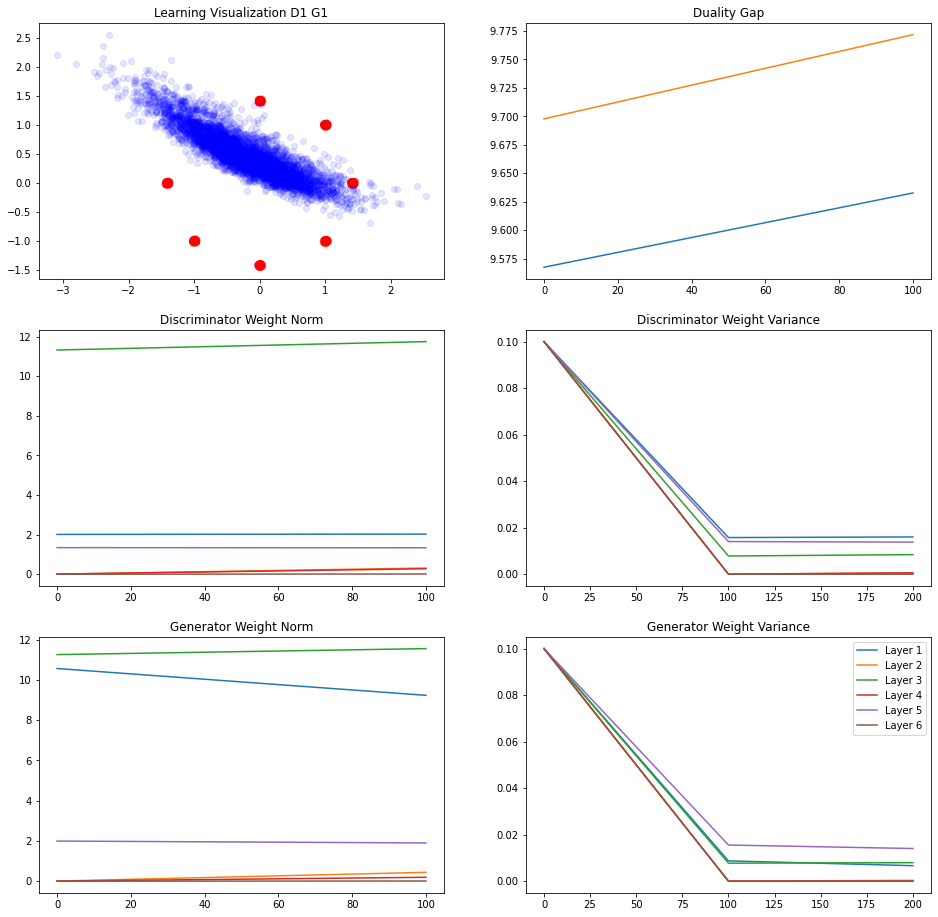

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  9.70035
L Random  Duality Gap :  9.79042


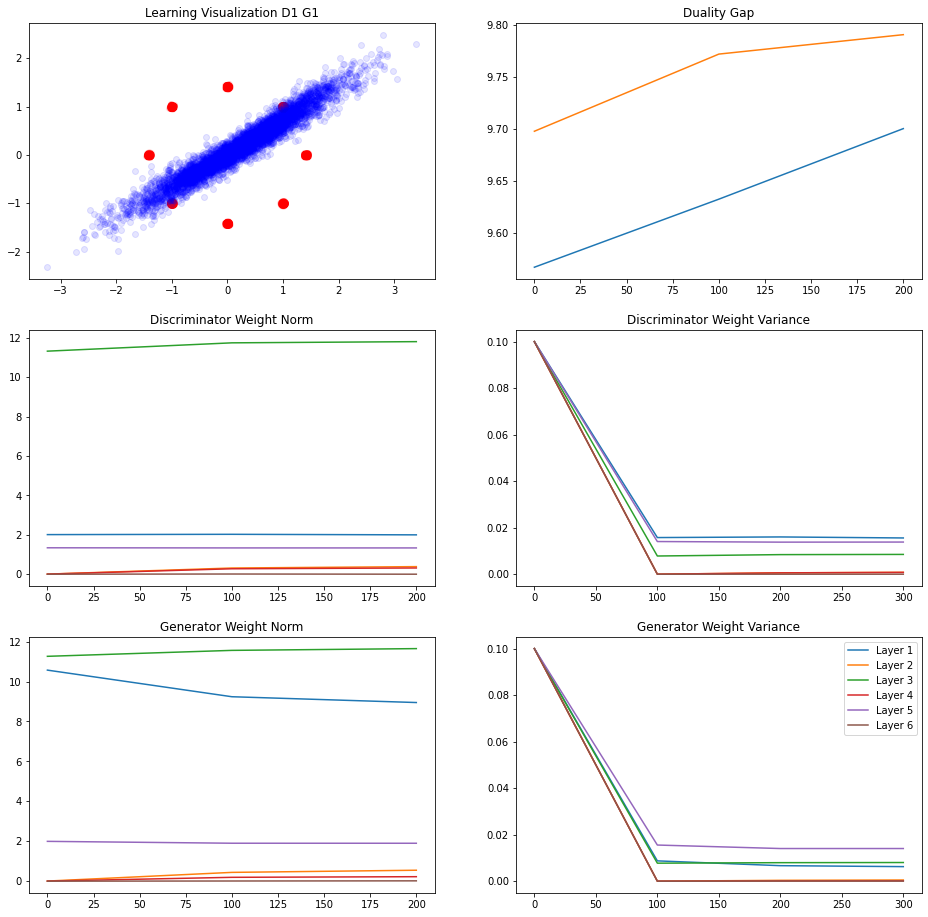

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  9.571013
L Random  Duality Gap :  9.669066


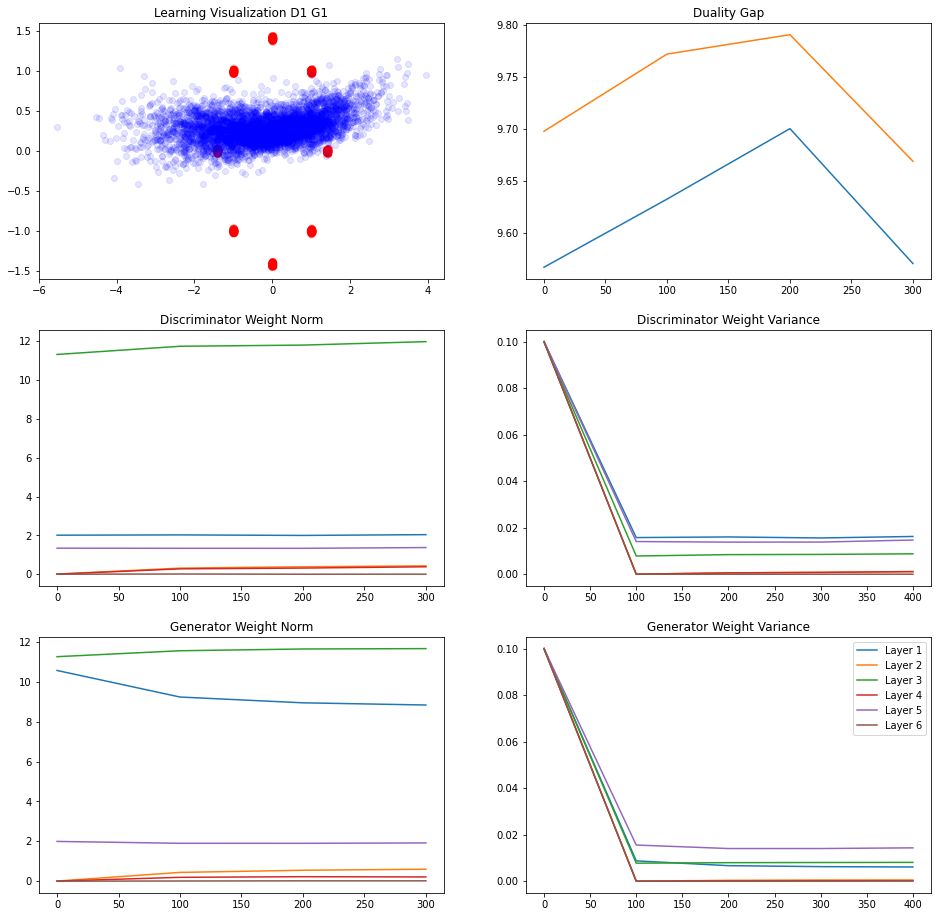

241/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  9.685547
L Random  Duality Gap :  9.788947


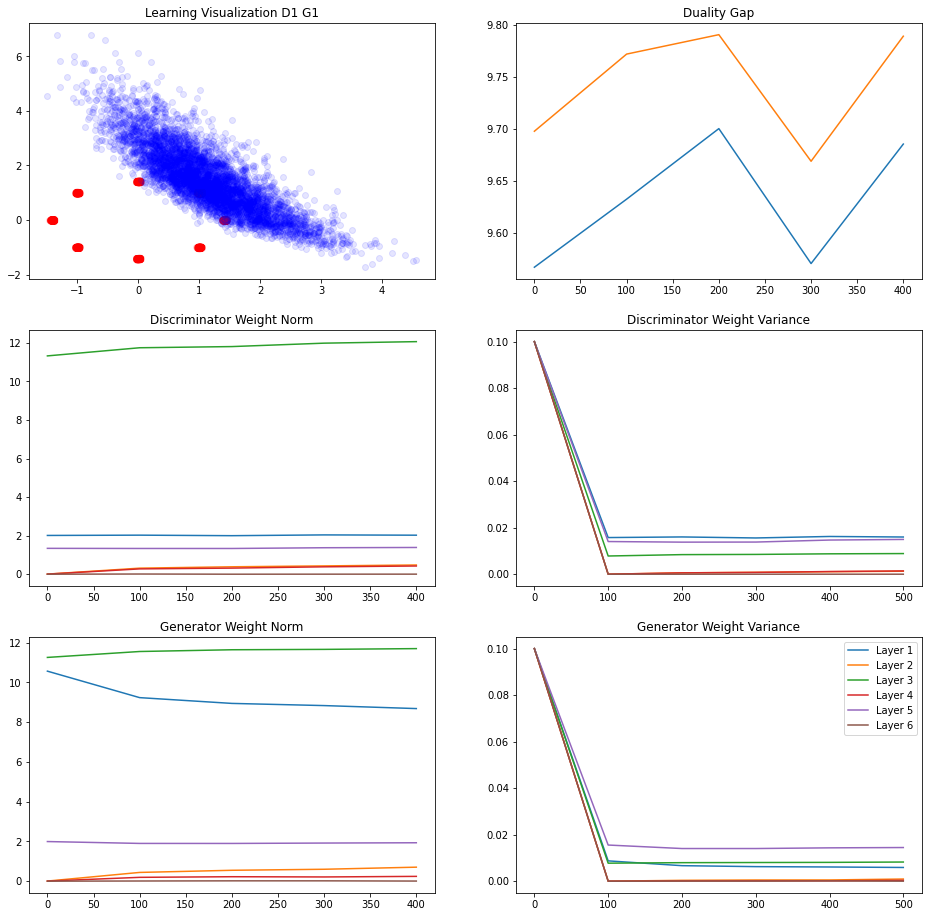

237/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  9.373982
L Random  Duality Gap :  9.699101
238/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  9.270684
L Random  Duality Gap :  9.415234


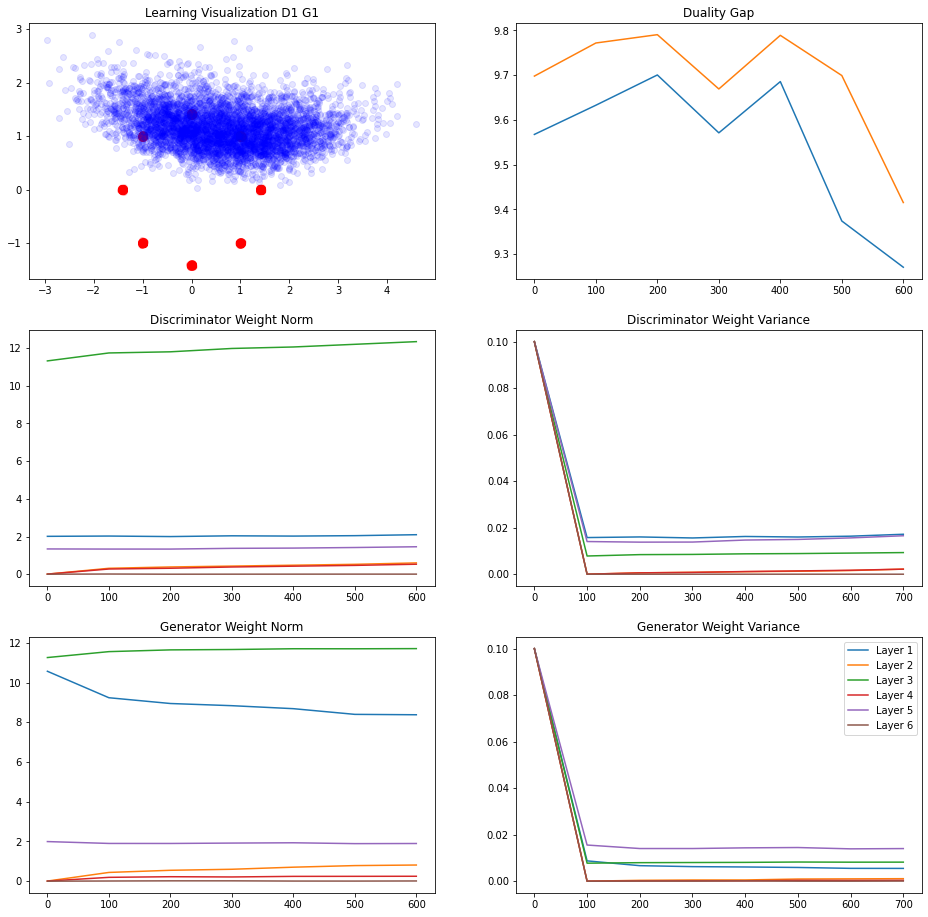

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  9.329202
L Random  Duality Gap :  9.505467


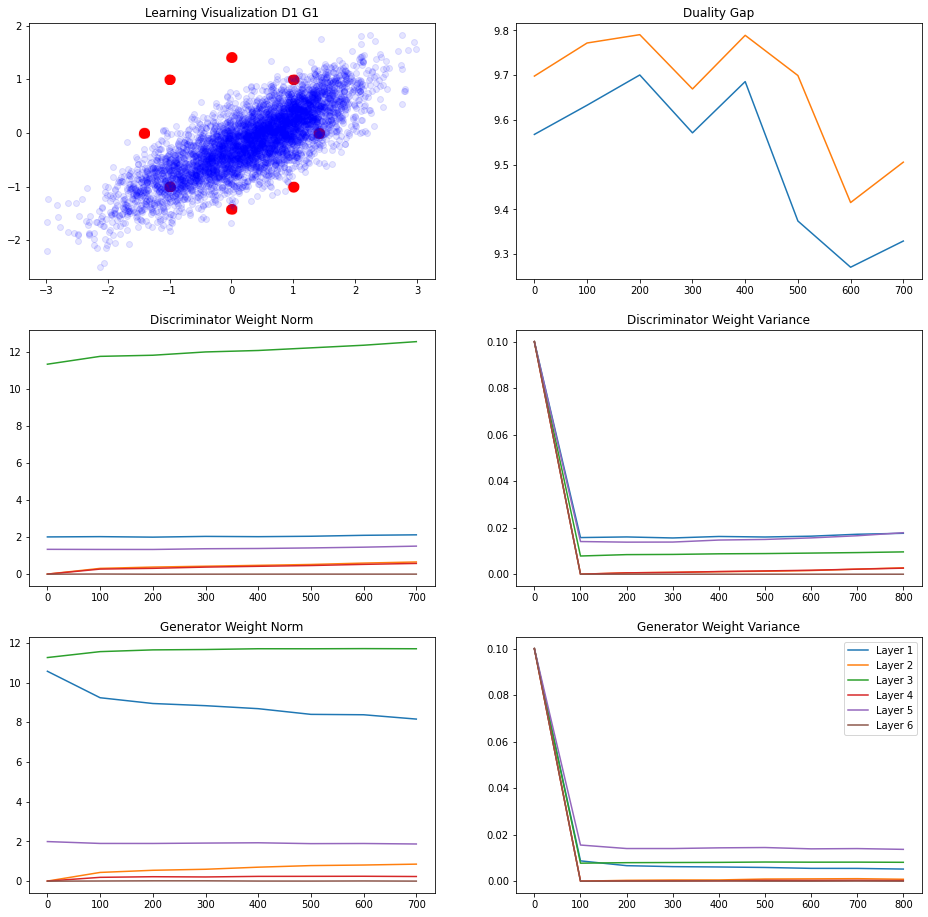

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  8.972404
L Random  Duality Gap :  9.108247


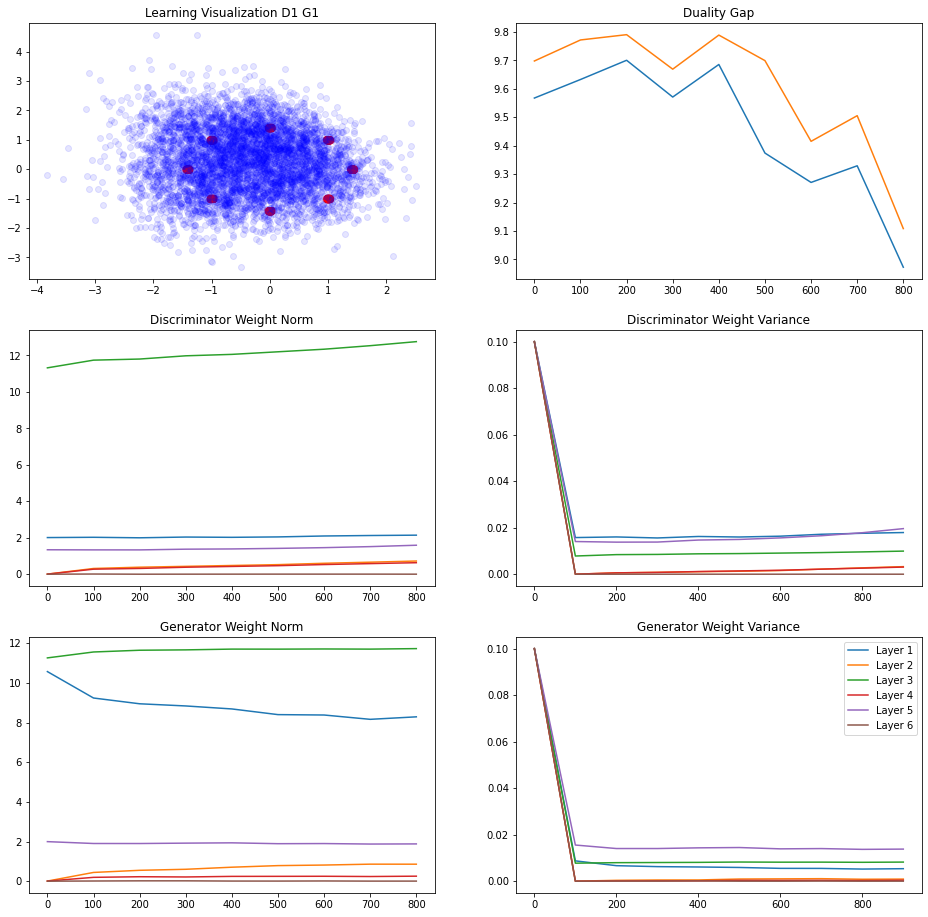

242/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.5399263
L Random  Duality Gap :  0.4053042


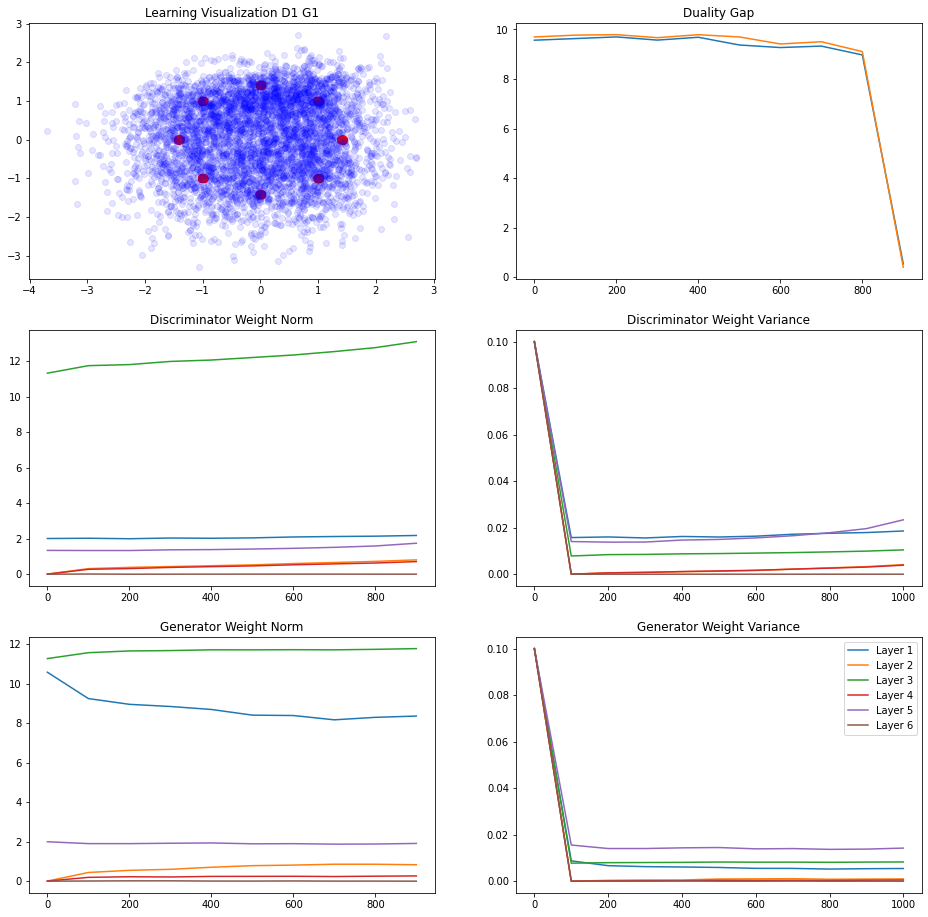

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.55855495
L Random  Duality Gap :  0.34186327
246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.38095164
L Random  Duality Gap :  0.025295556


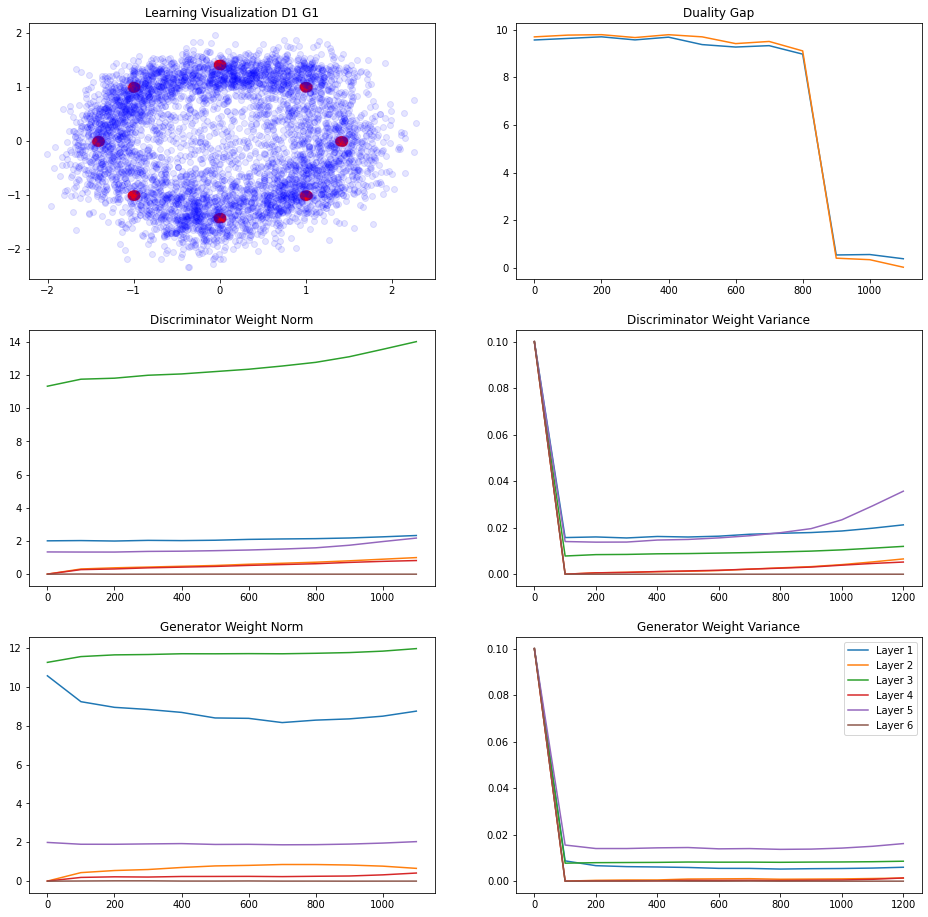

245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.222202
L Random  Duality Gap :  -0.19930989


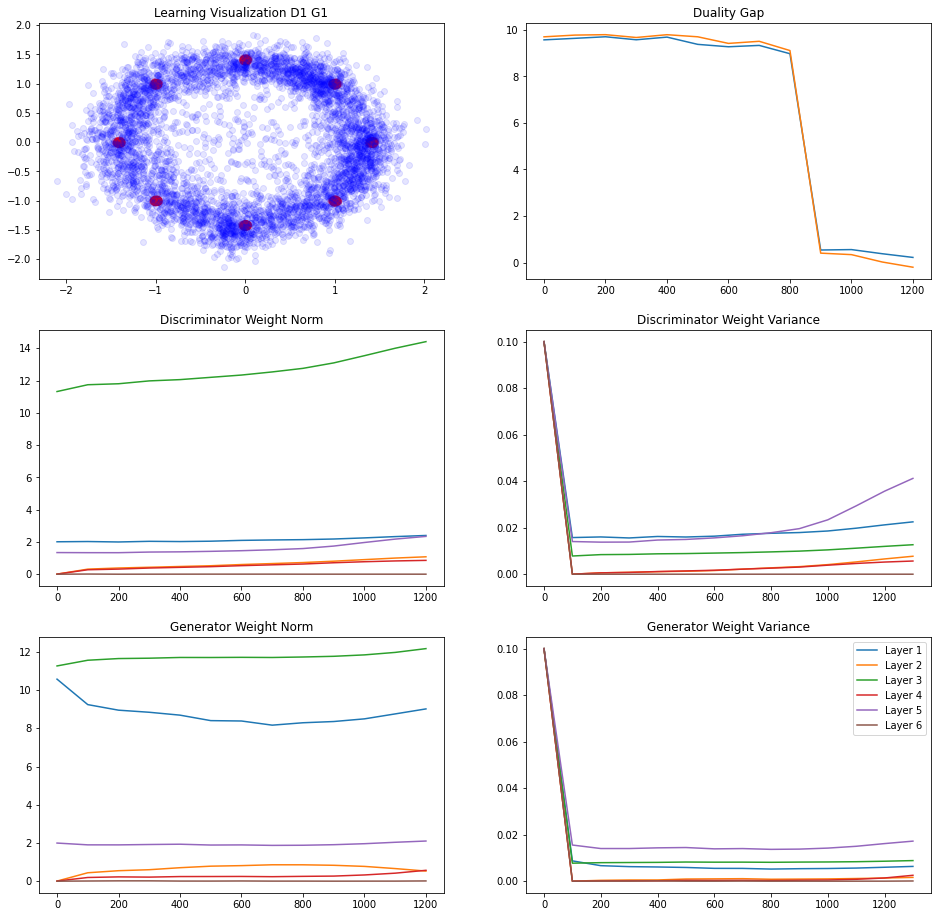

241/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  0.20323151
L Random  Duality Gap :  -0.22738642


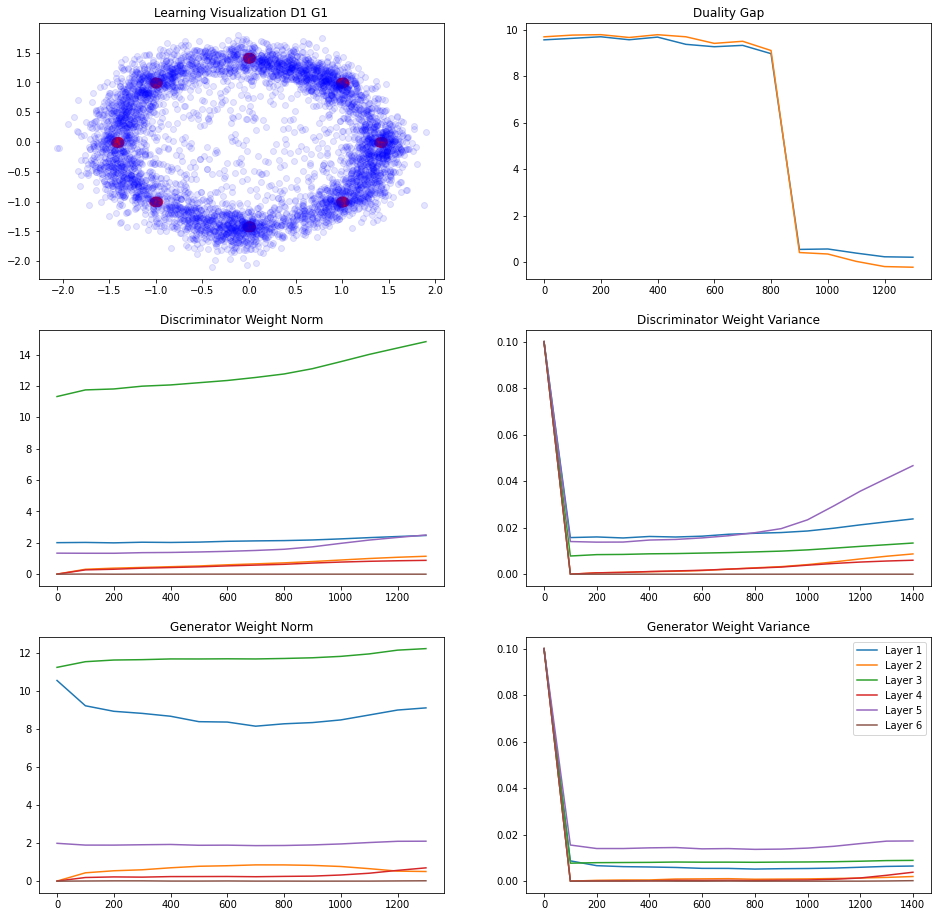

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.14465475
L Random  Duality Gap :  -0.2305646


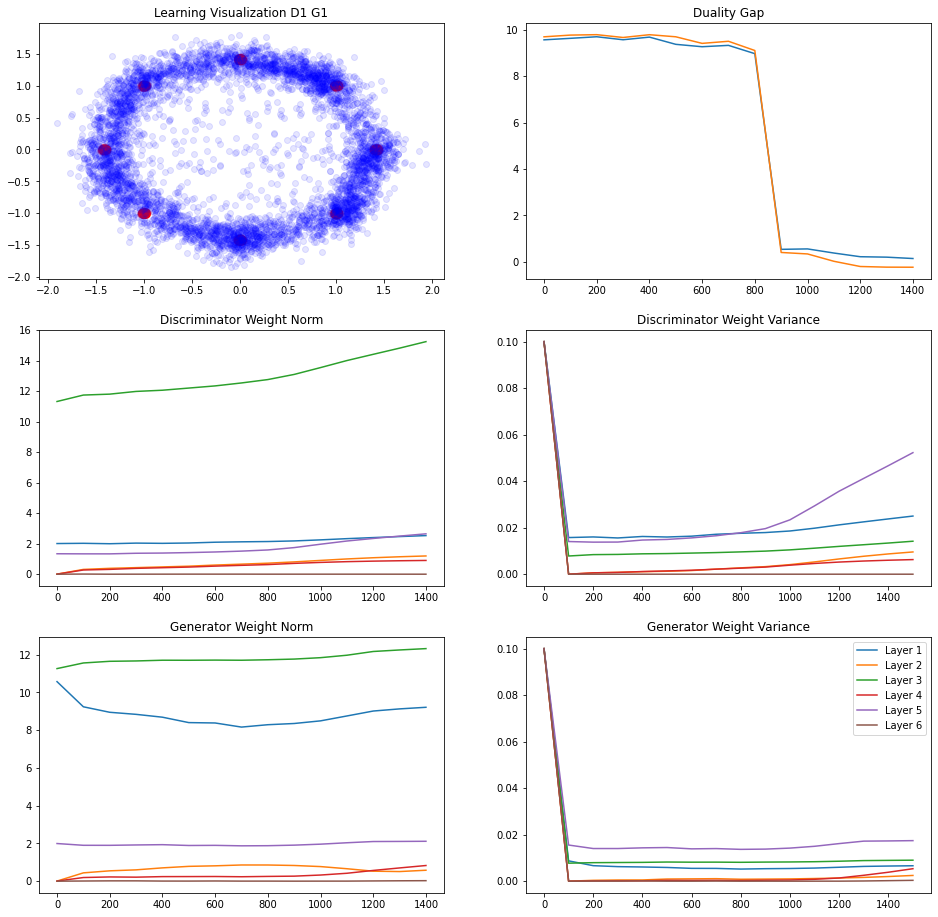

237/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  0.16446453
L Random  Duality Gap :  -0.2309416
241/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  0.1290518
L Random  Duality Gap :  -0.35609287


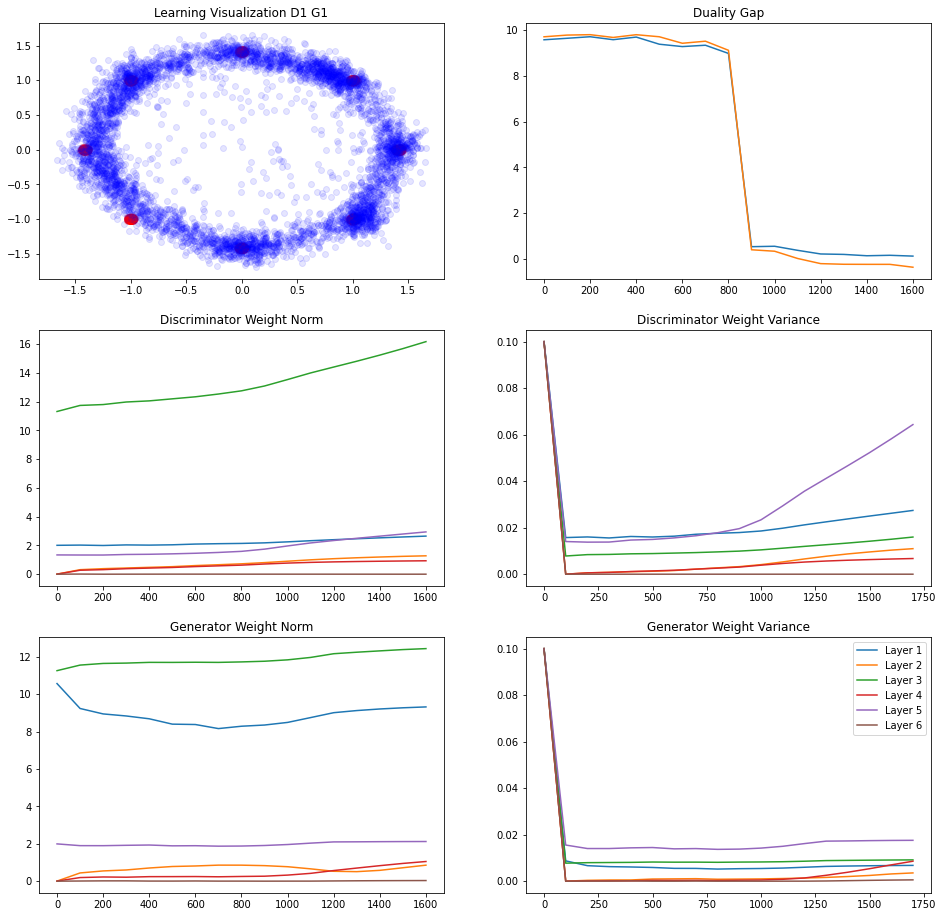

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.11095941
L Random  Duality Gap :  -0.38268763


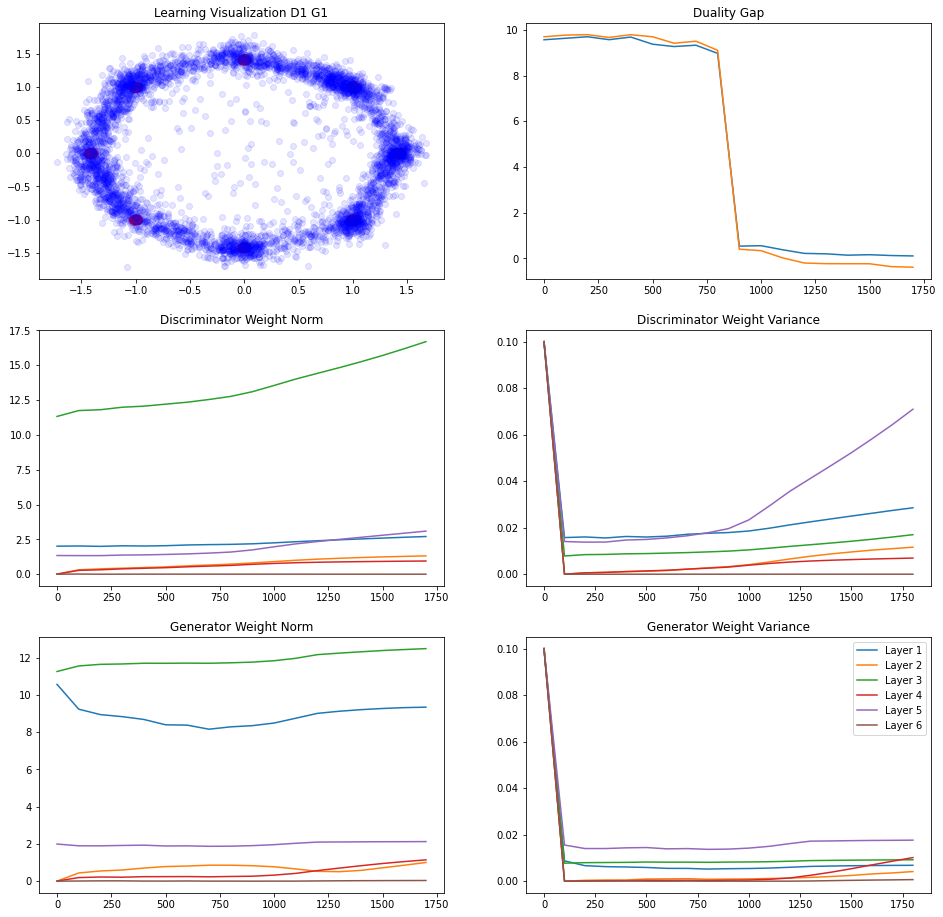

239/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  0.09497237
L Random  Duality Gap :  -0.32378453


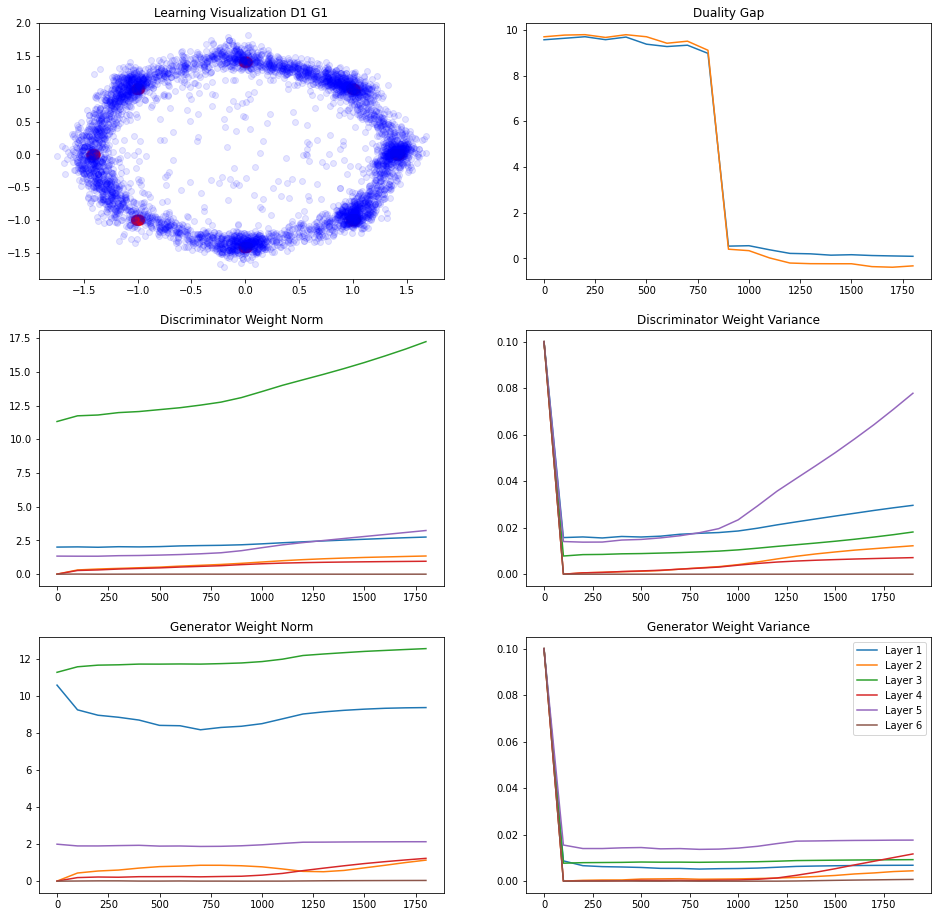

245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.100639105
L Random  Duality Gap :  -0.36145002


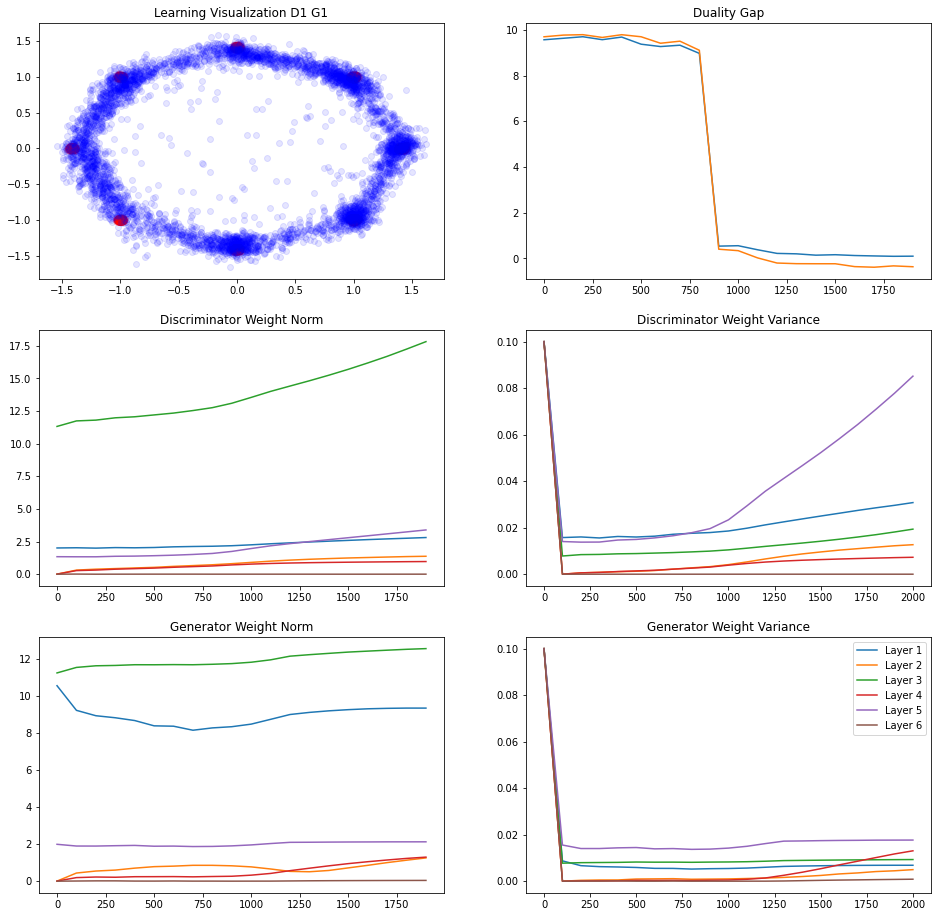

238/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  0.07370114
L Random  Duality Gap :  -0.42022812
241/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  0.07154131
L Random  Duality Gap :  -0.4926287


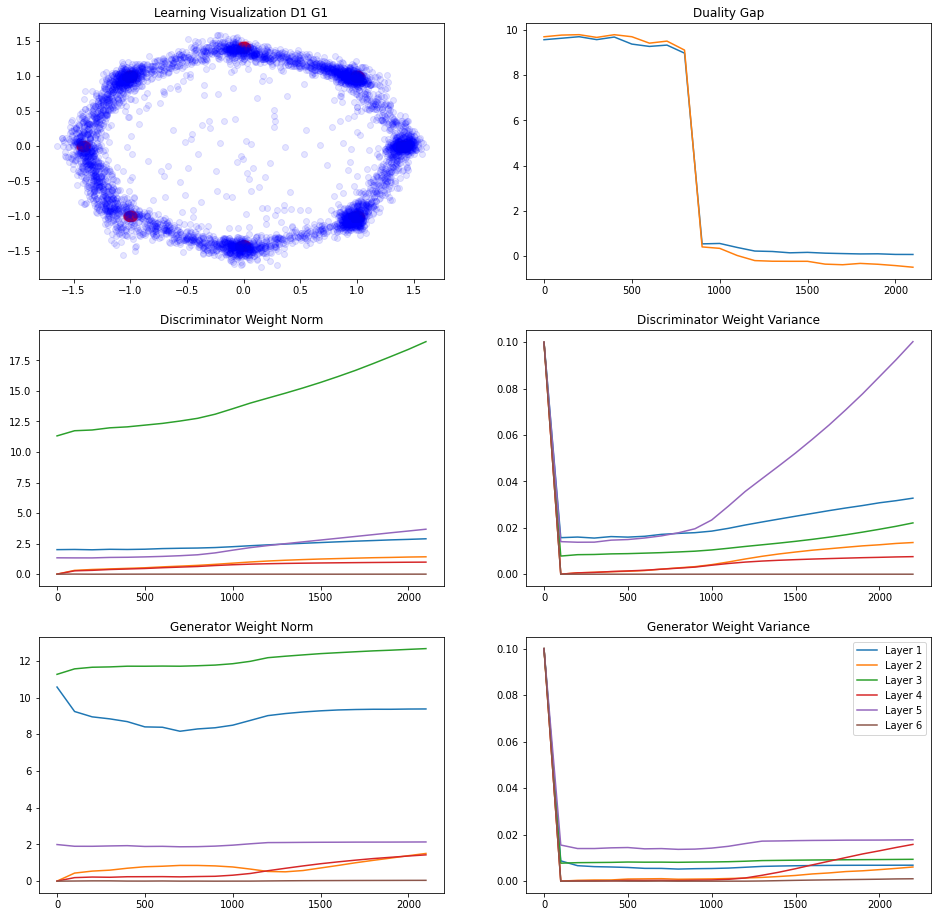

244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.07489437
L Random  Duality Gap :  -0.48452204


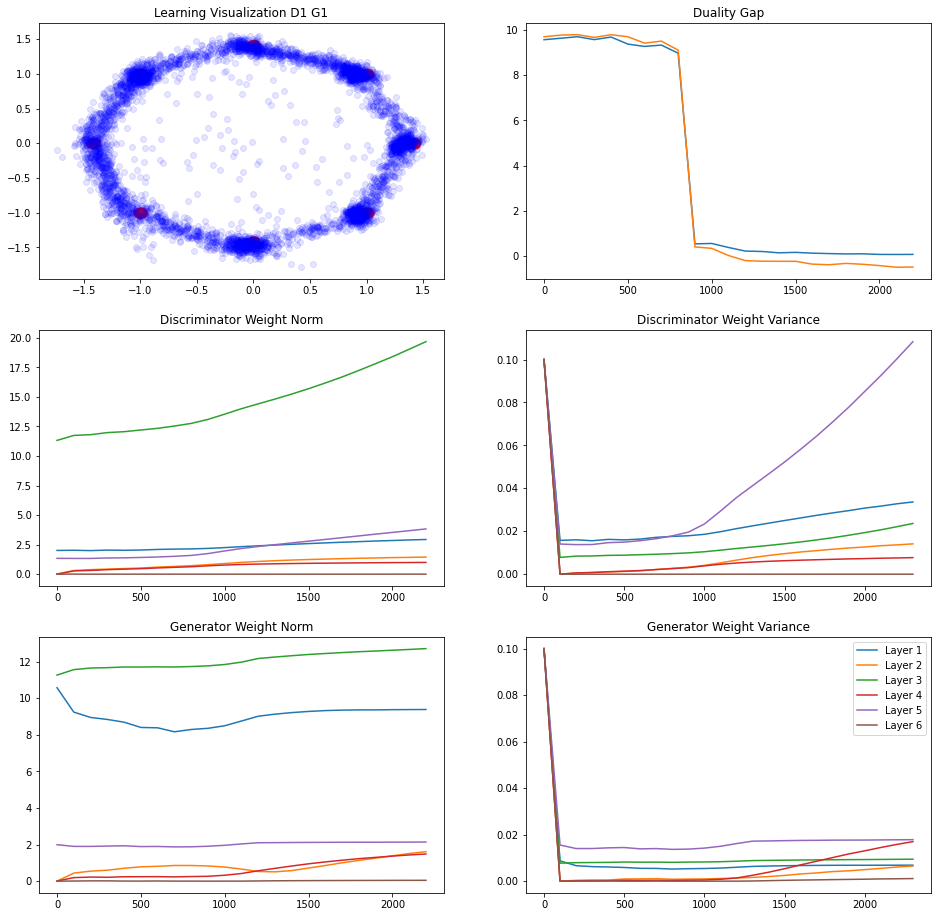

244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.04835248
L Random  Duality Gap :  -0.4859088


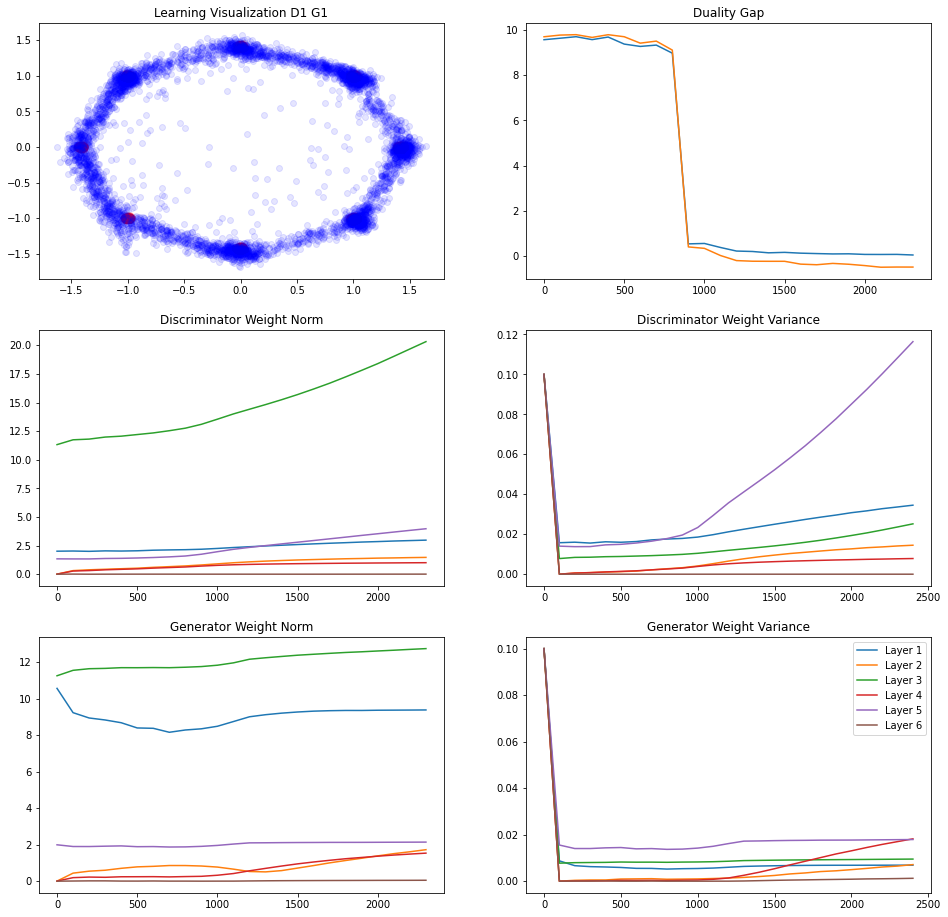

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.0153336525
L Random  Duality Gap :  -0.5424277


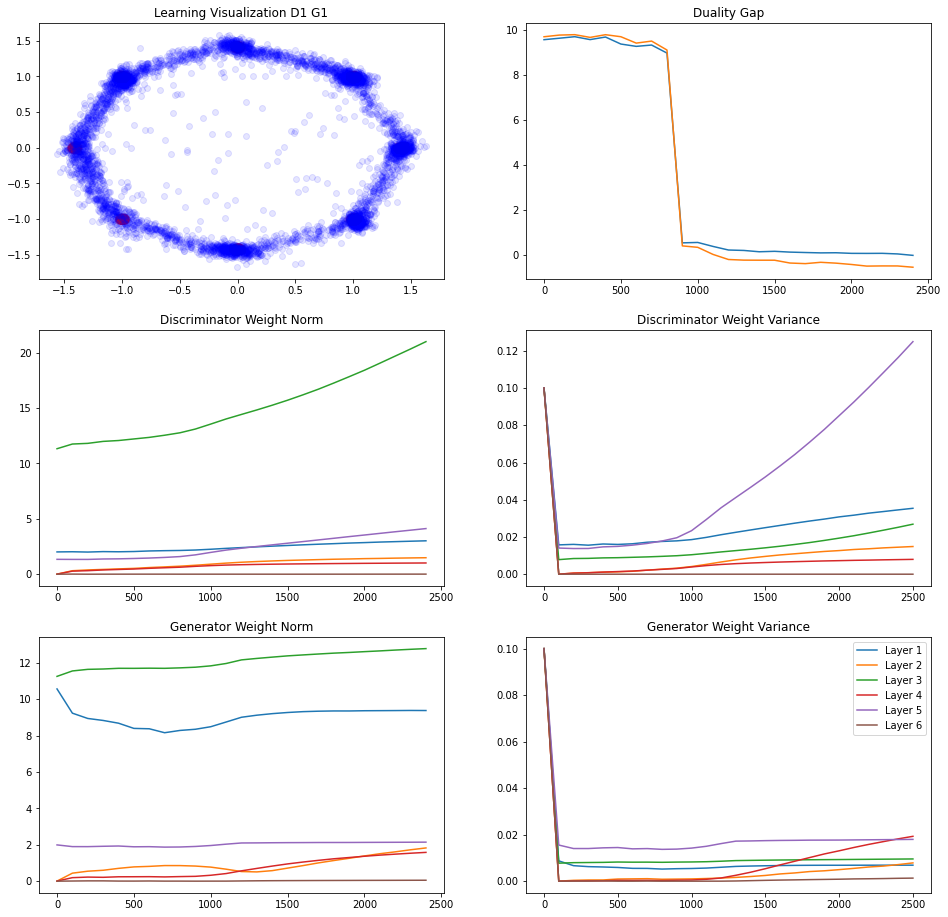

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.032340407
L Random  Duality Gap :  -0.5742541
246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.021665037
L Random  Duality Gap :  -0.58587587


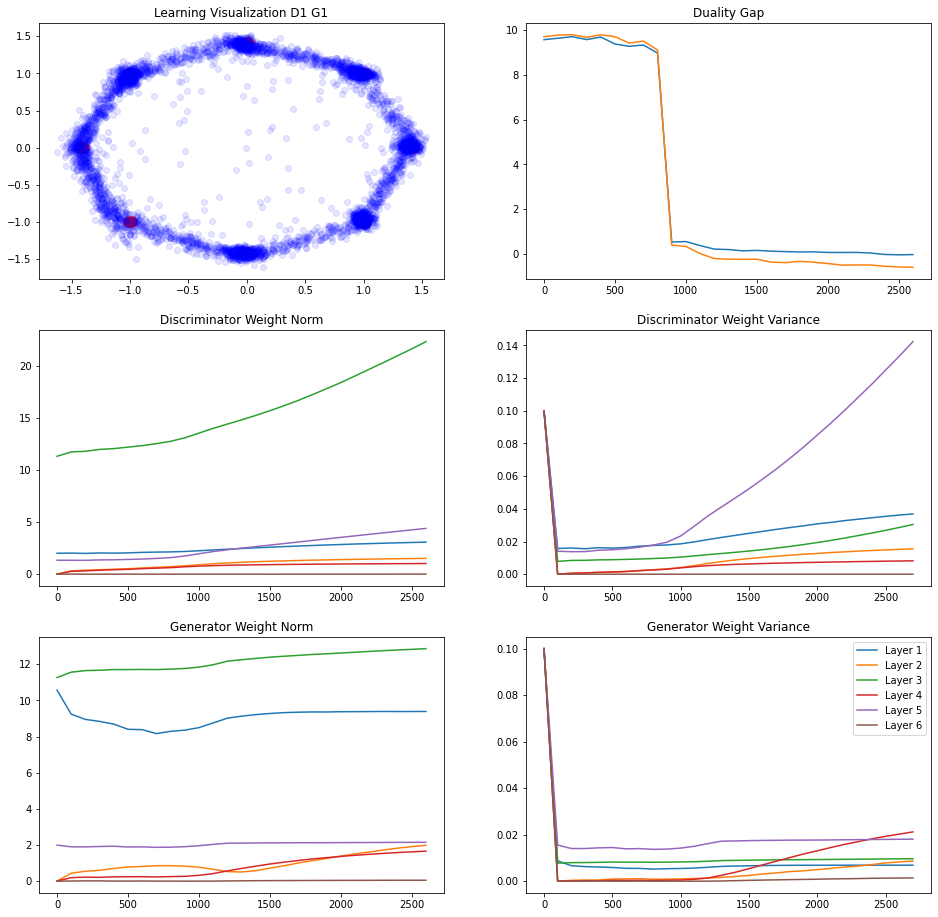

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.021151304
L Random  Duality Gap :  -0.52763015


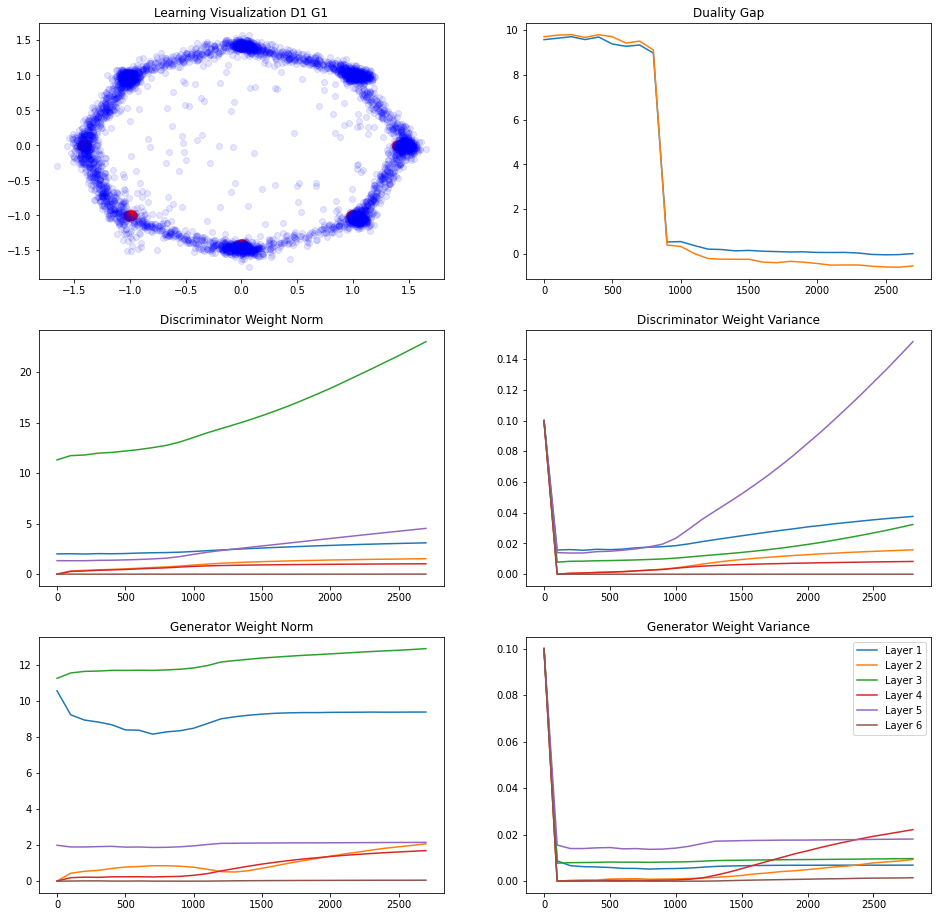

239/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  -0.018829525
L Random  Duality Gap :  -0.5724128


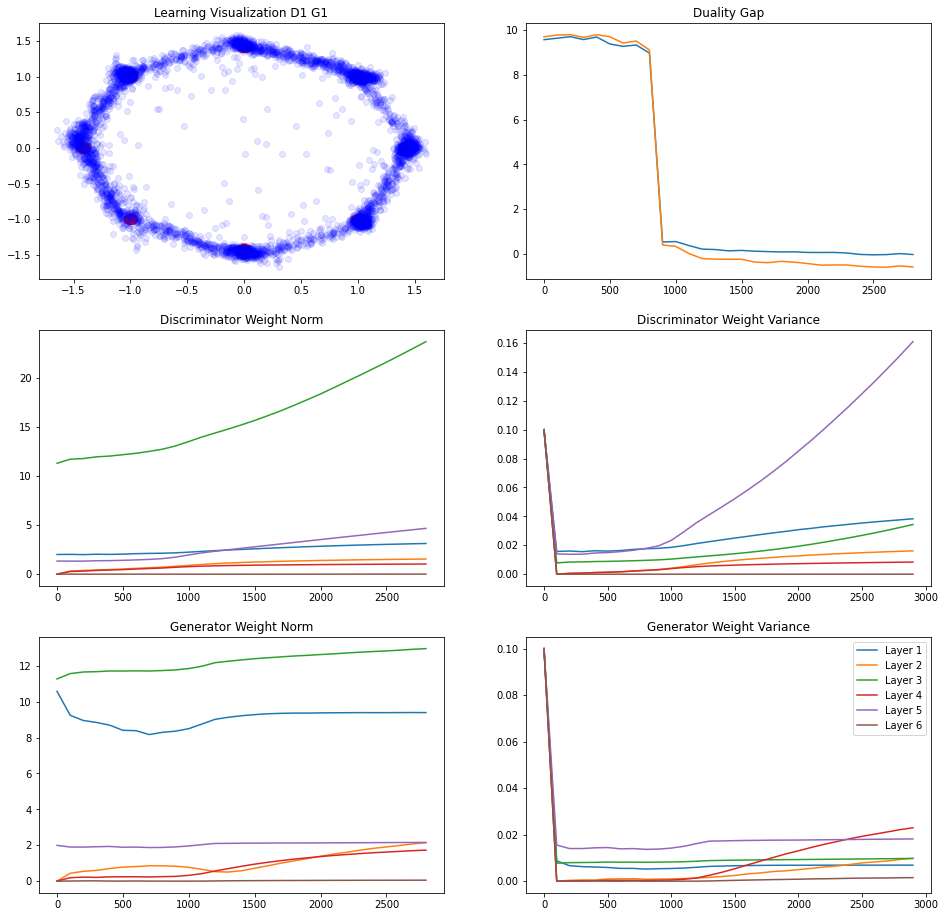

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.11905813
L Random  Duality Gap :  -0.6392672


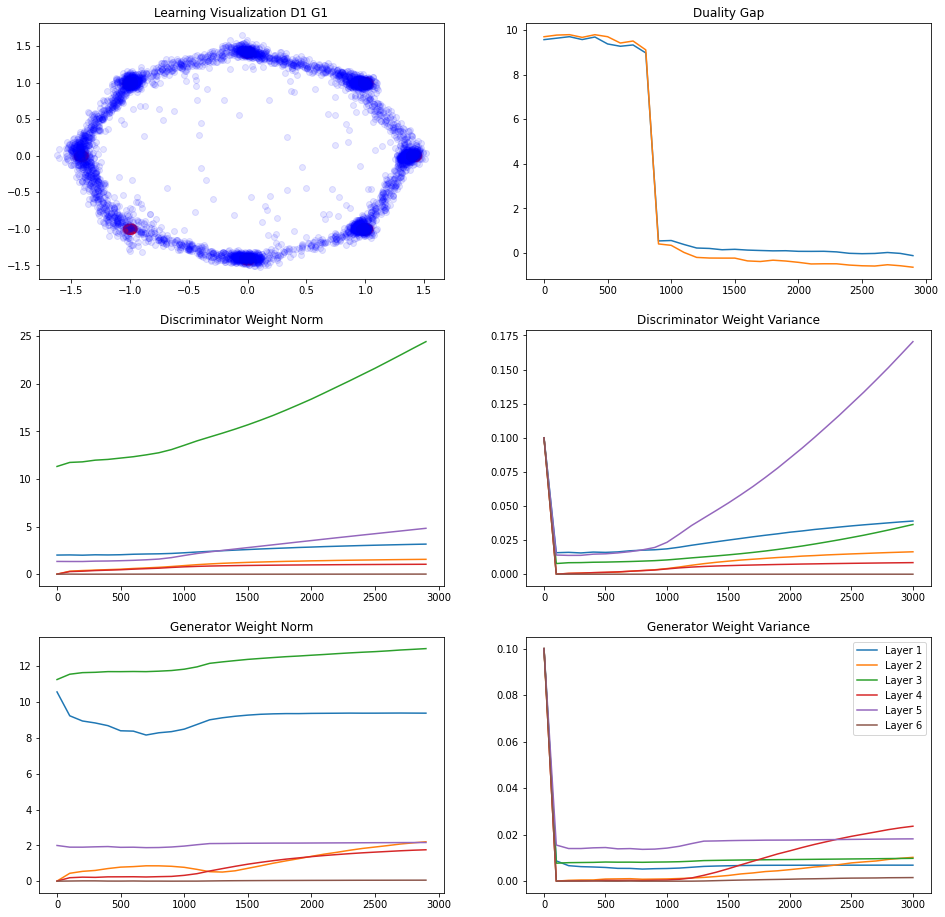

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.061402977
L Random  Duality Gap :  -0.60921085
243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.13185042
L Random  Duality Gap :  -0.6350075


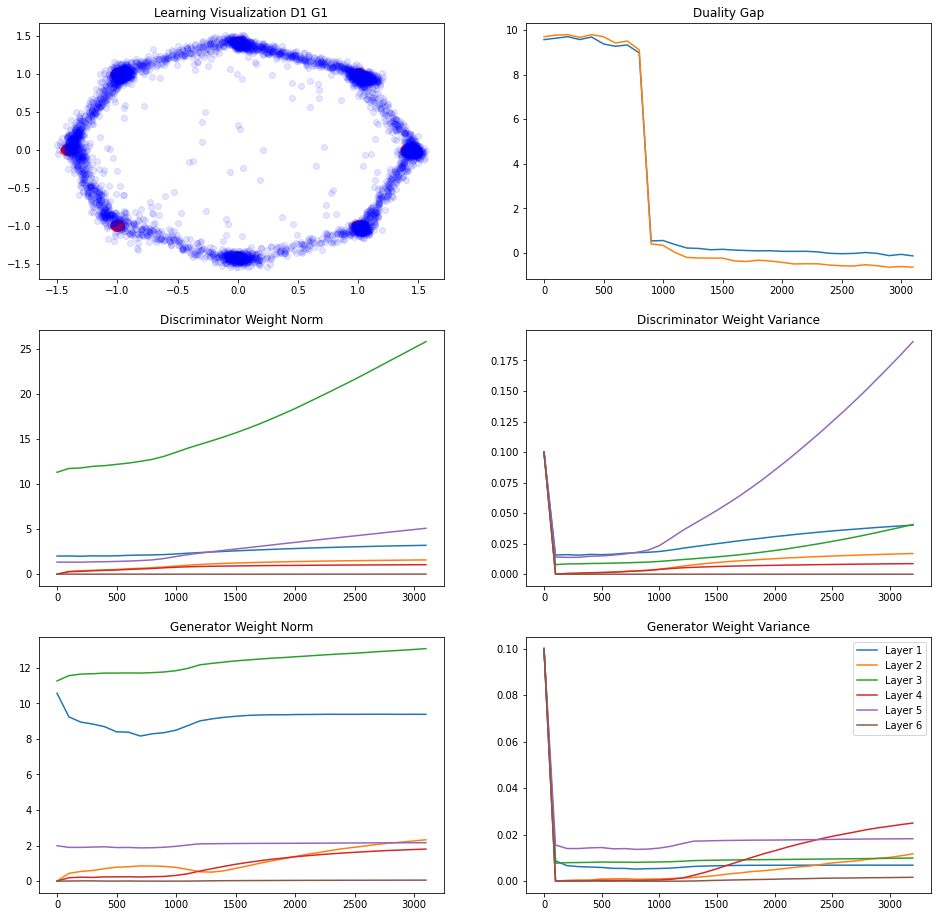

245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.21239215
L Random  Duality Gap :  -0.6260535


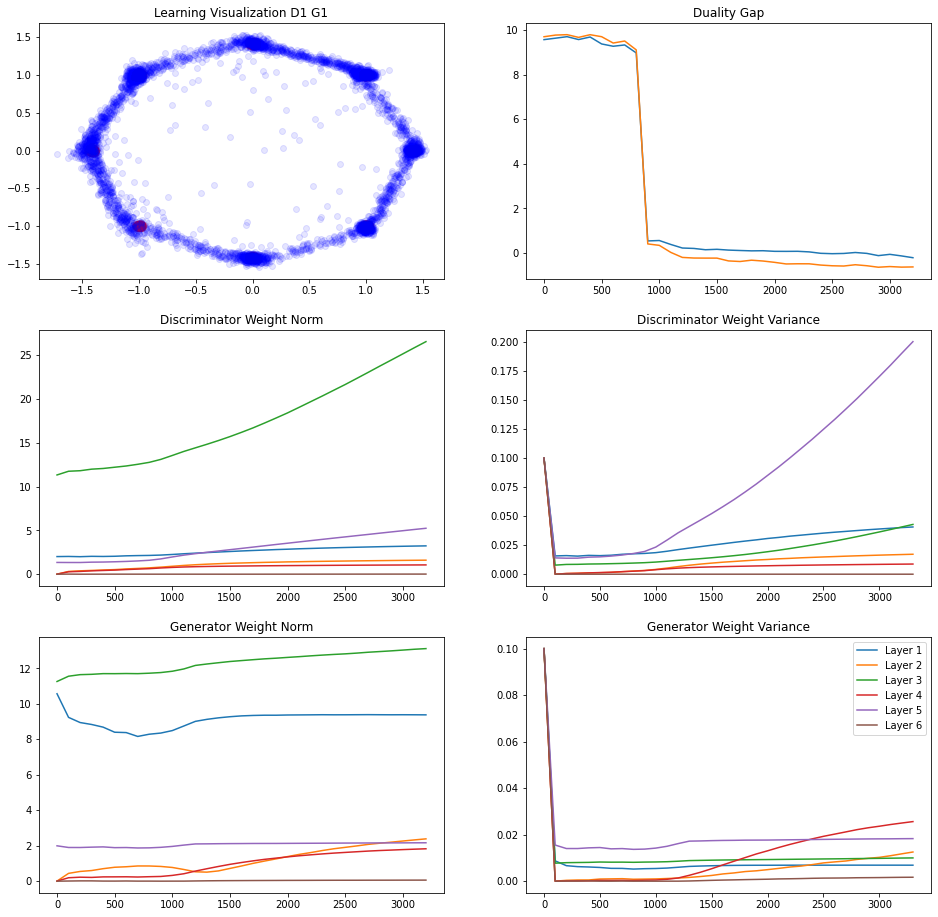

242/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.018044889
L Random  Duality Gap :  -0.5458548


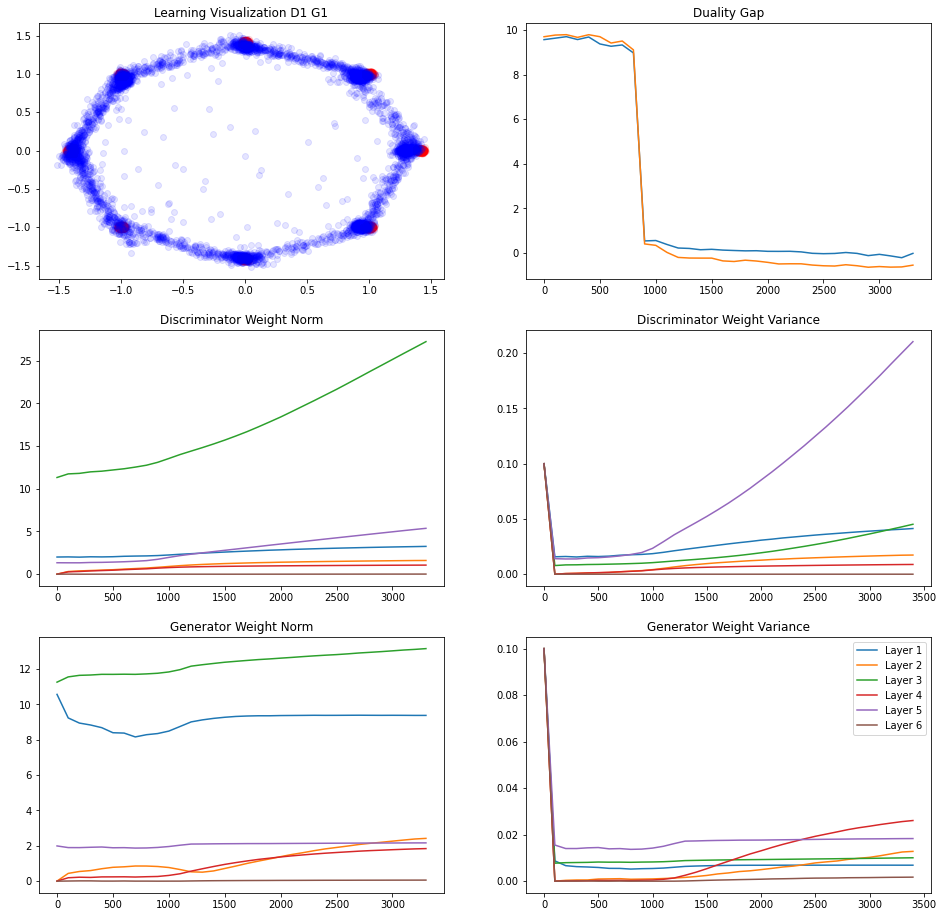

237/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  -0.14544296
L Random  Duality Gap :  -0.6471065


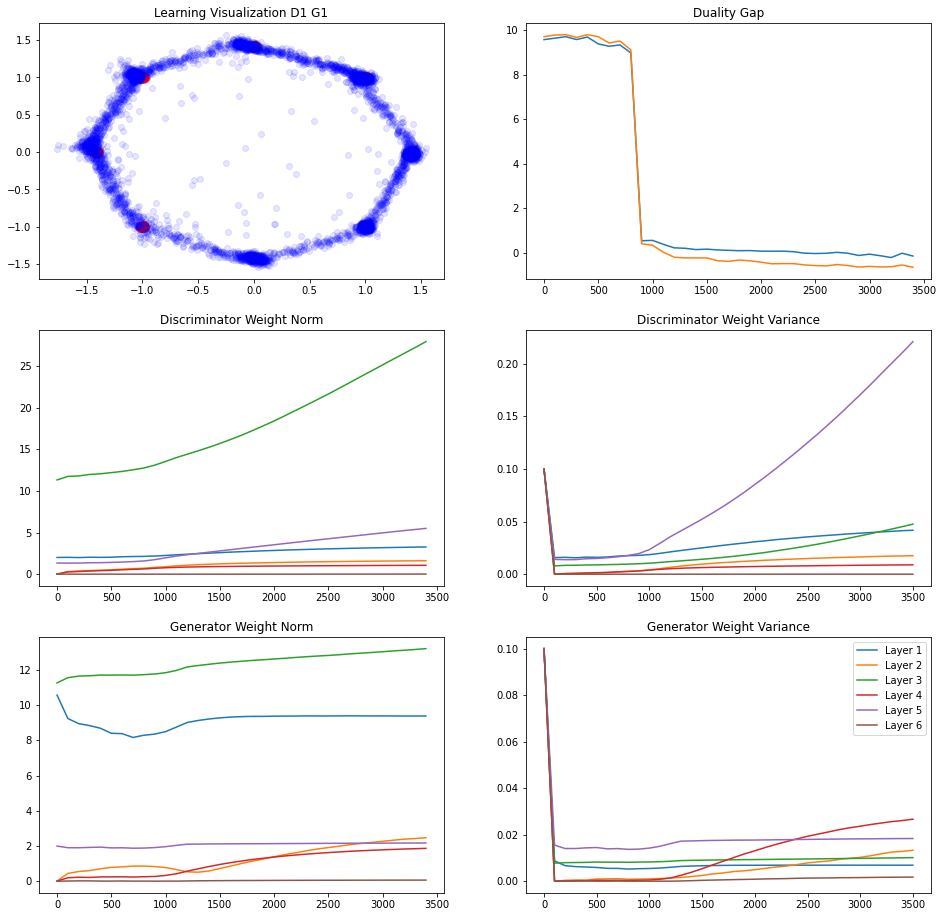

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.10555047
L Random  Duality Gap :  -0.63064706
248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.022482336
L Random  Duality Gap :  -0.5445961


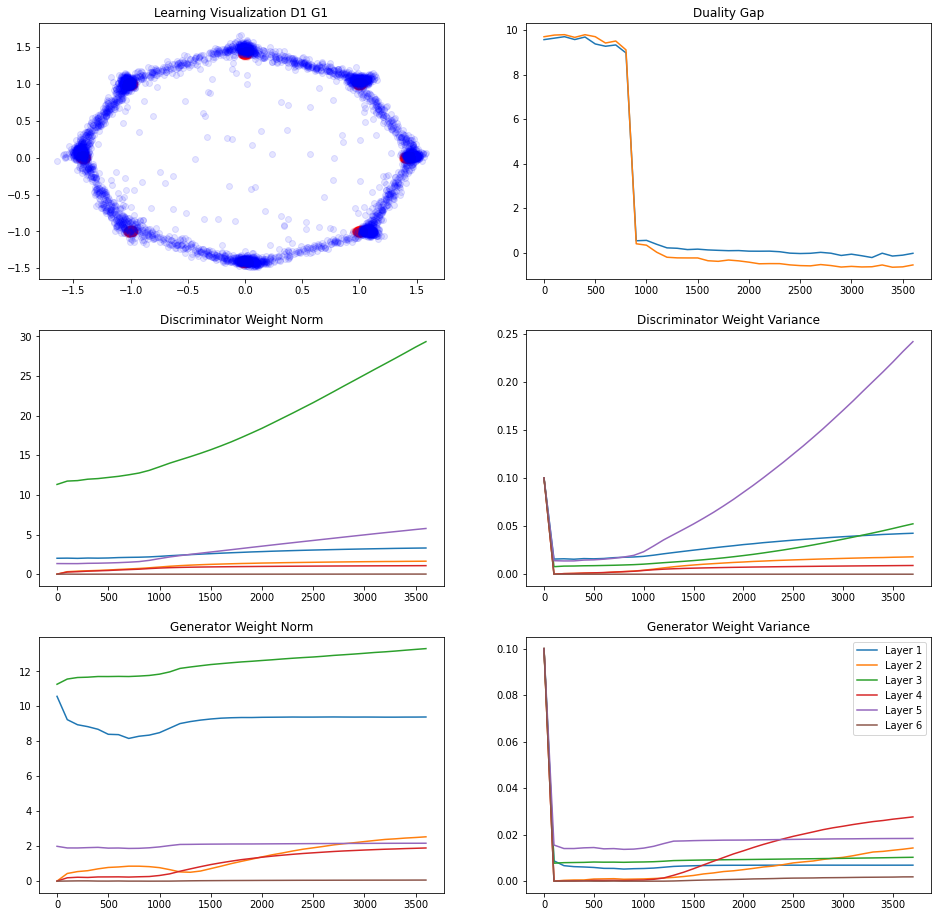

240/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  -0.011547446
L Random  Duality Gap :  -0.5986495


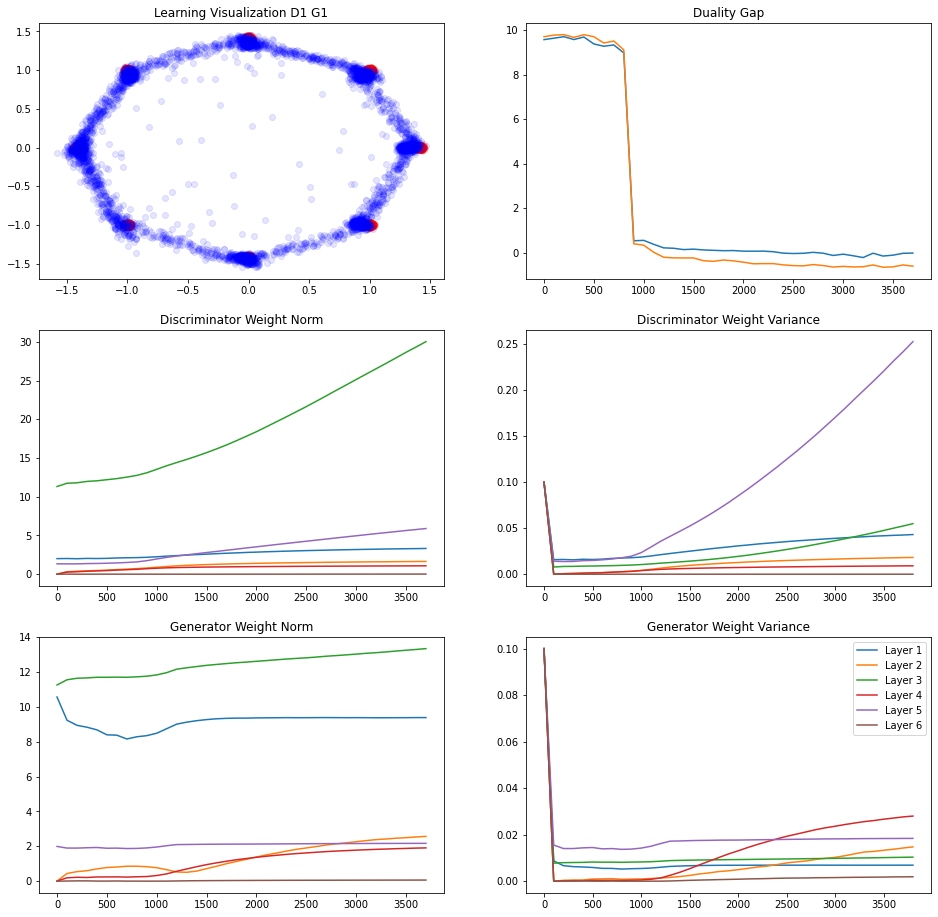

241/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  -0.14384776
L Random  Duality Gap :  -0.69871795


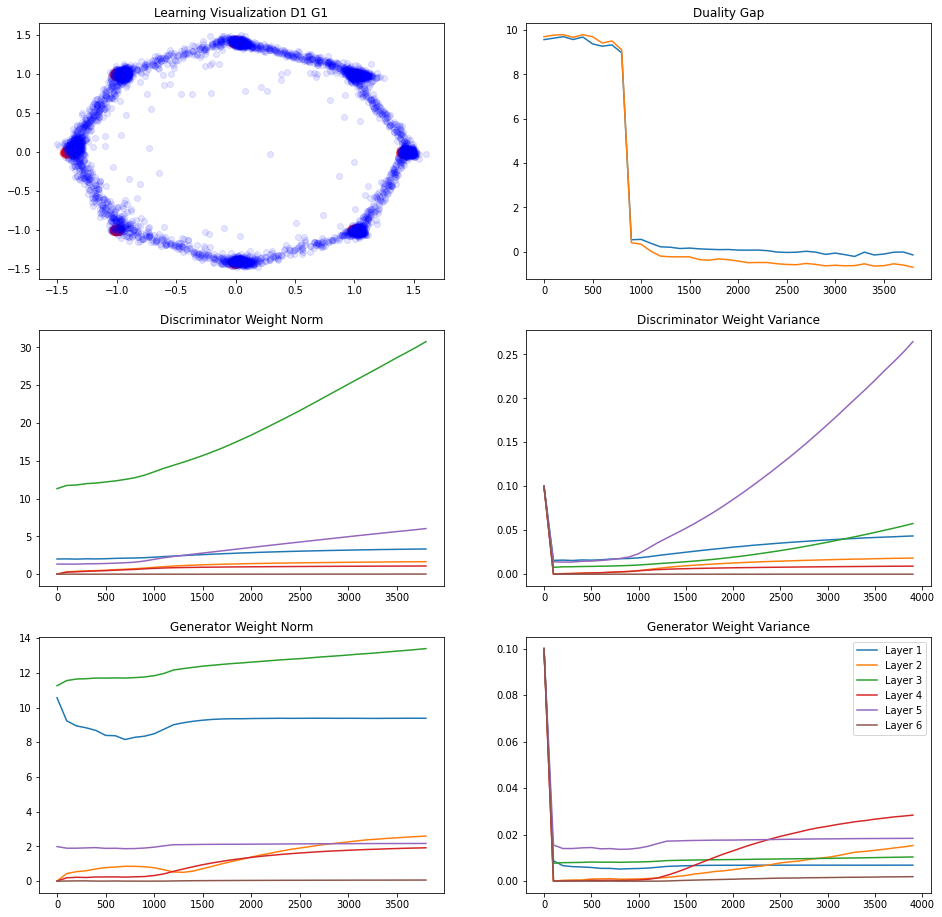

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.073617935
L Random  Duality Gap :  -0.6226278


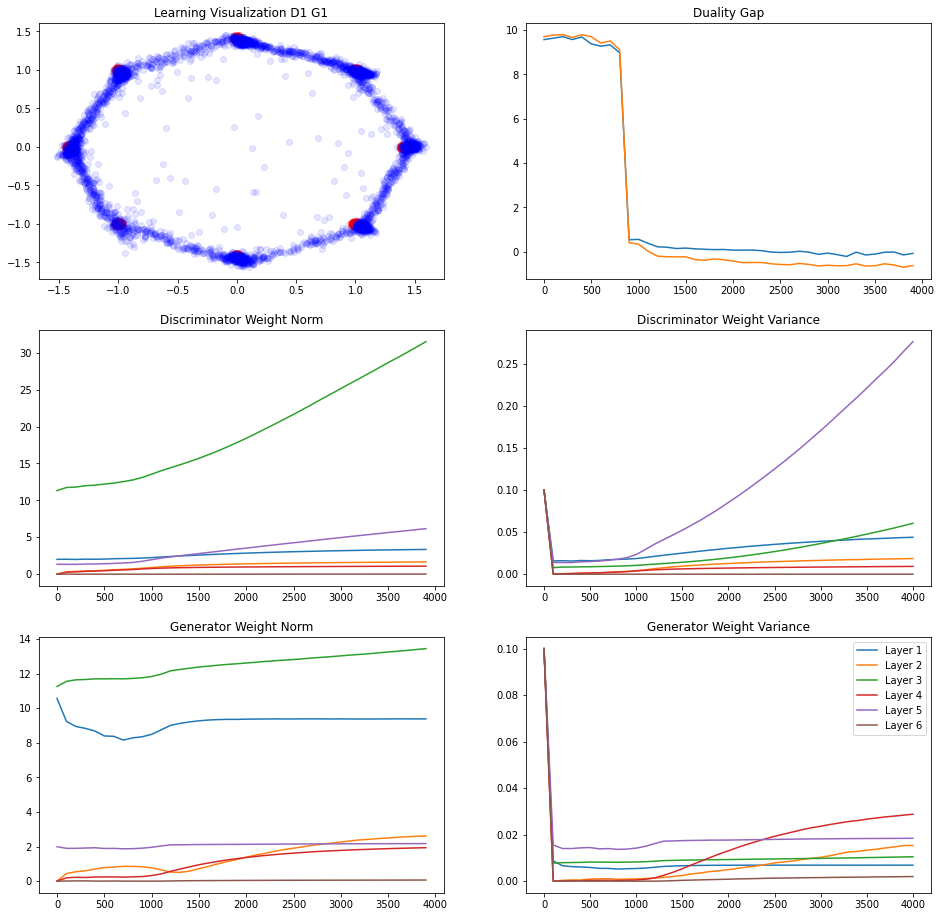

244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.063114345
L Random  Duality Gap :  -0.7419345
238/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  -0.10995287
L Random  Duality Gap :  -0.65836644


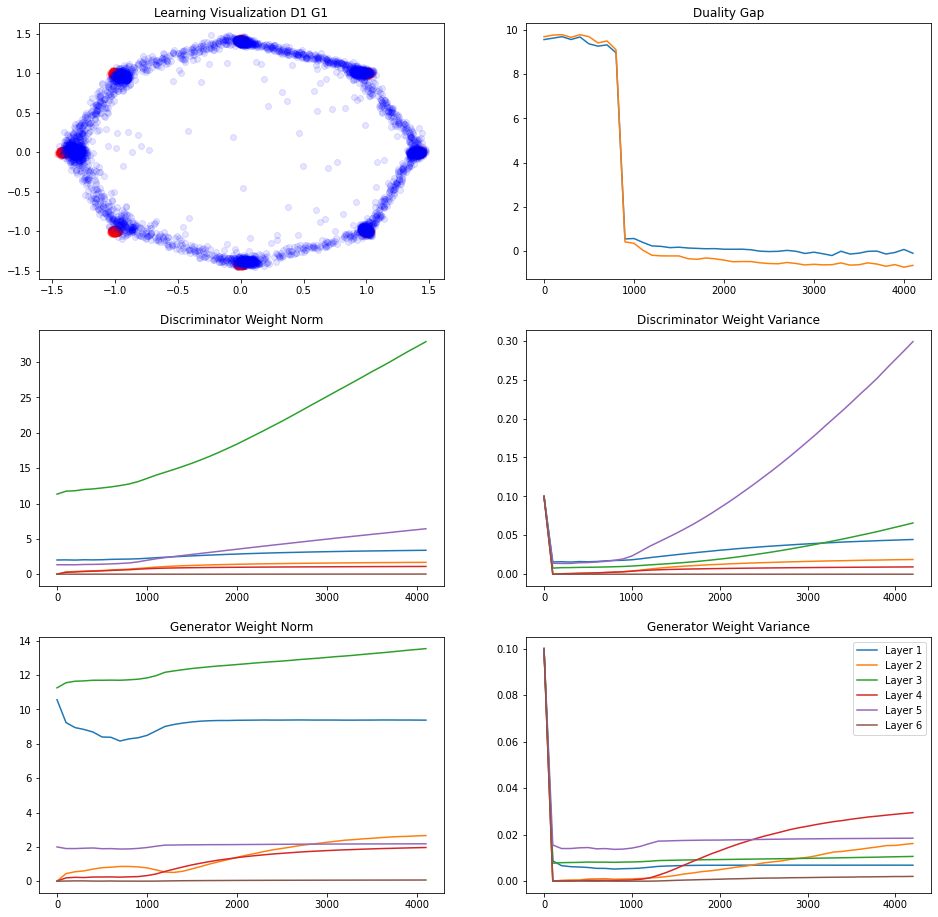

237/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  -0.10432619
L Random  Duality Gap :  -0.69849485


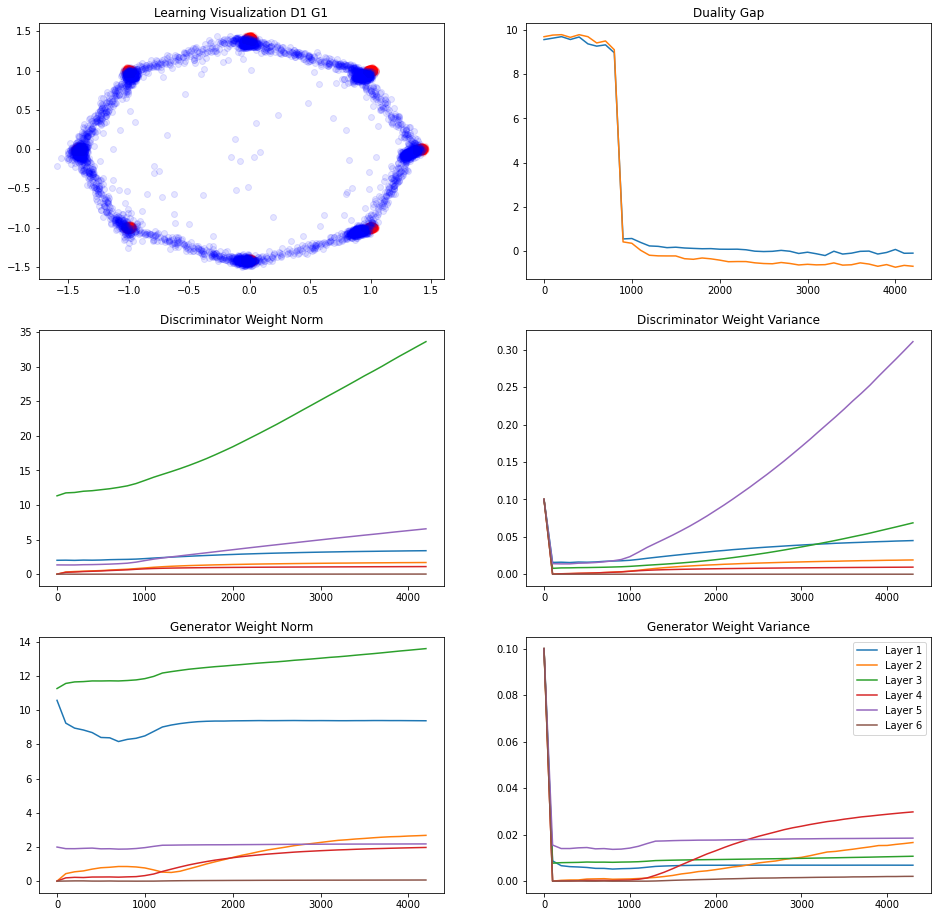

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.13371539
L Random  Duality Gap :  -0.71007943


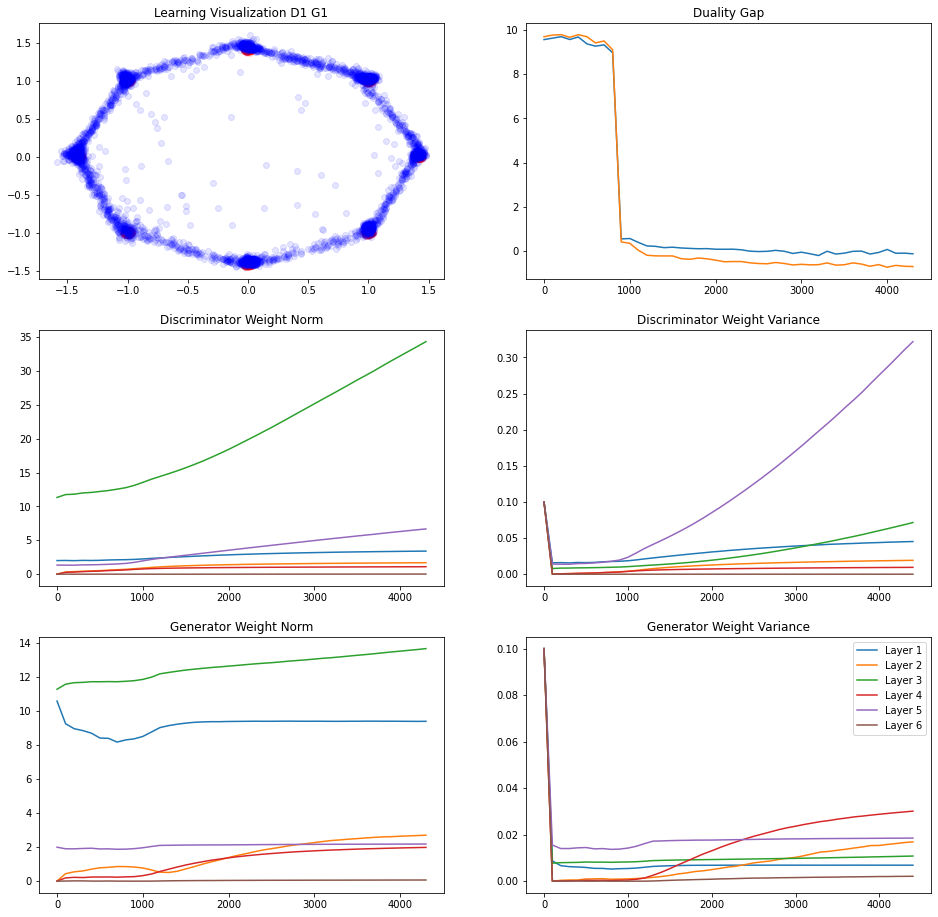

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.20167023
L Random  Duality Gap :  -0.80349237


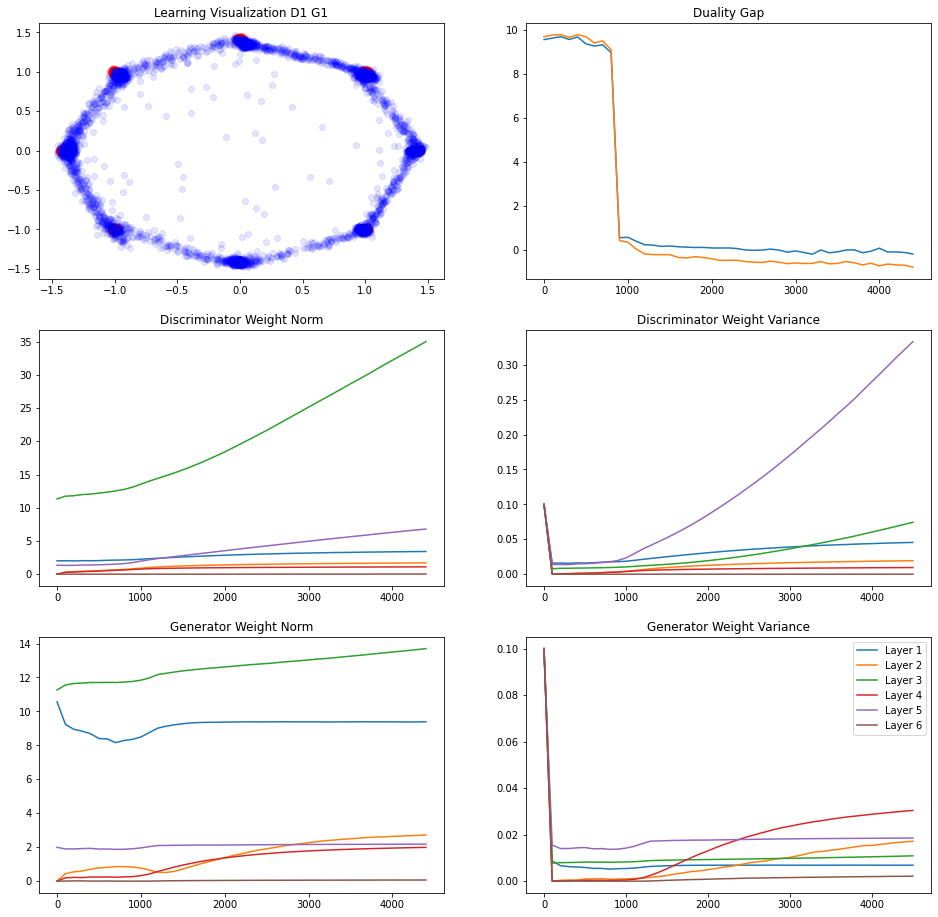

242/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.15724993
L Random  Duality Gap :  -0.61655
243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.078327775
L Random  Duality Gap :  -0.6120176


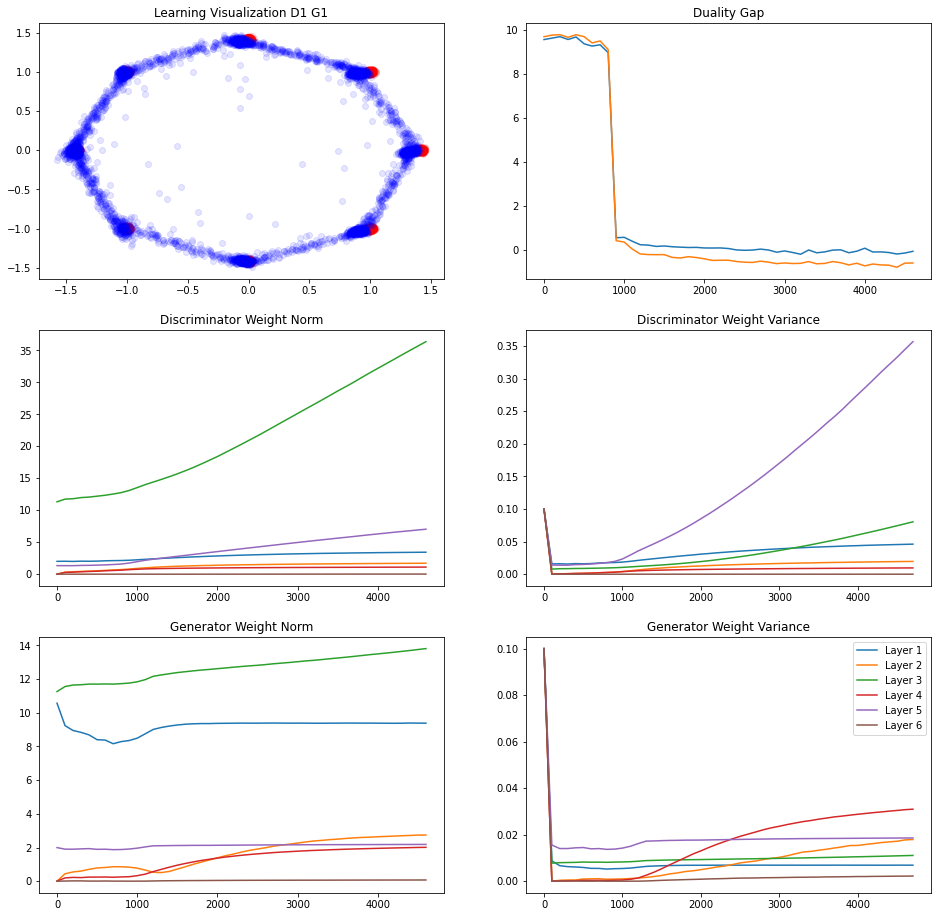

241/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  -0.36863846
L Random  Duality Gap :  -0.7858675


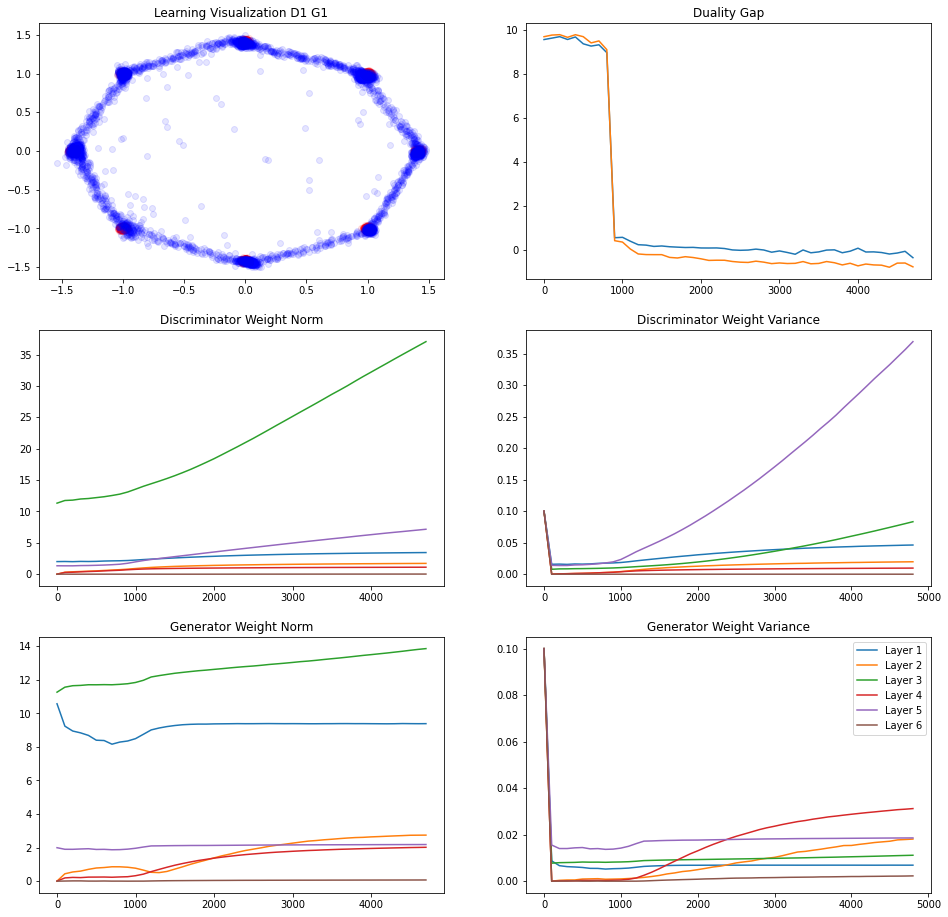

244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.28153002
L Random  Duality Gap :  -0.7201184


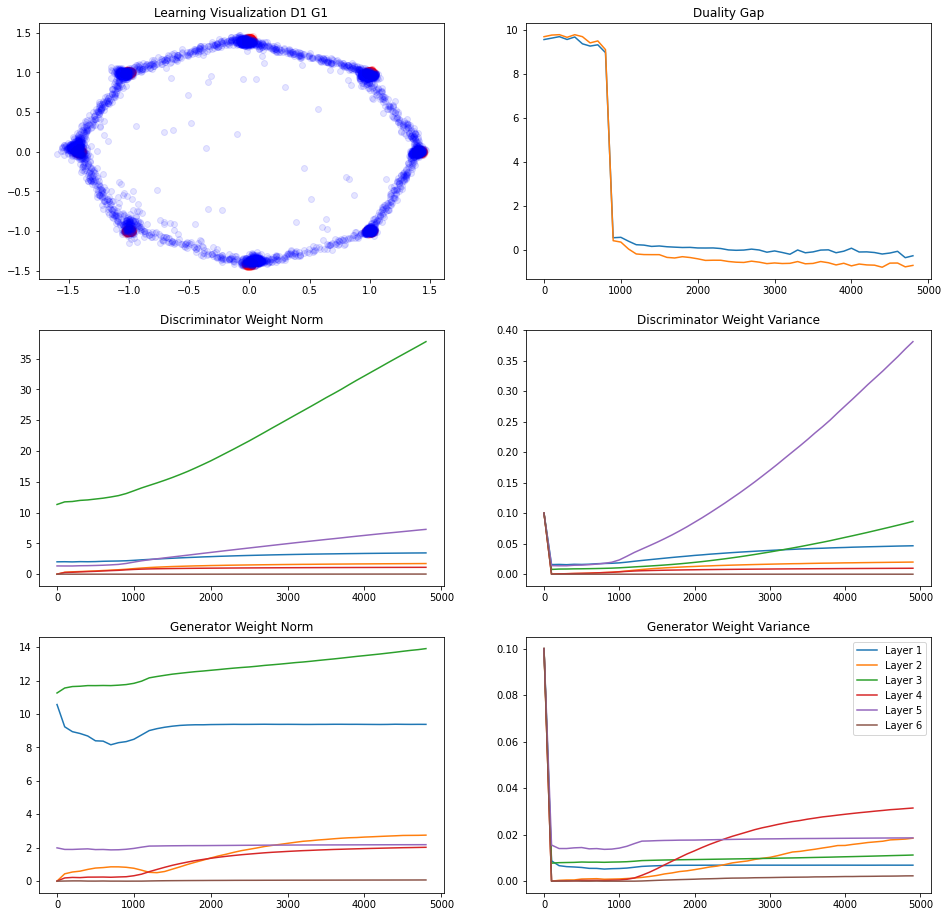

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.27979589
L Random  Duality Gap :  -0.66252136


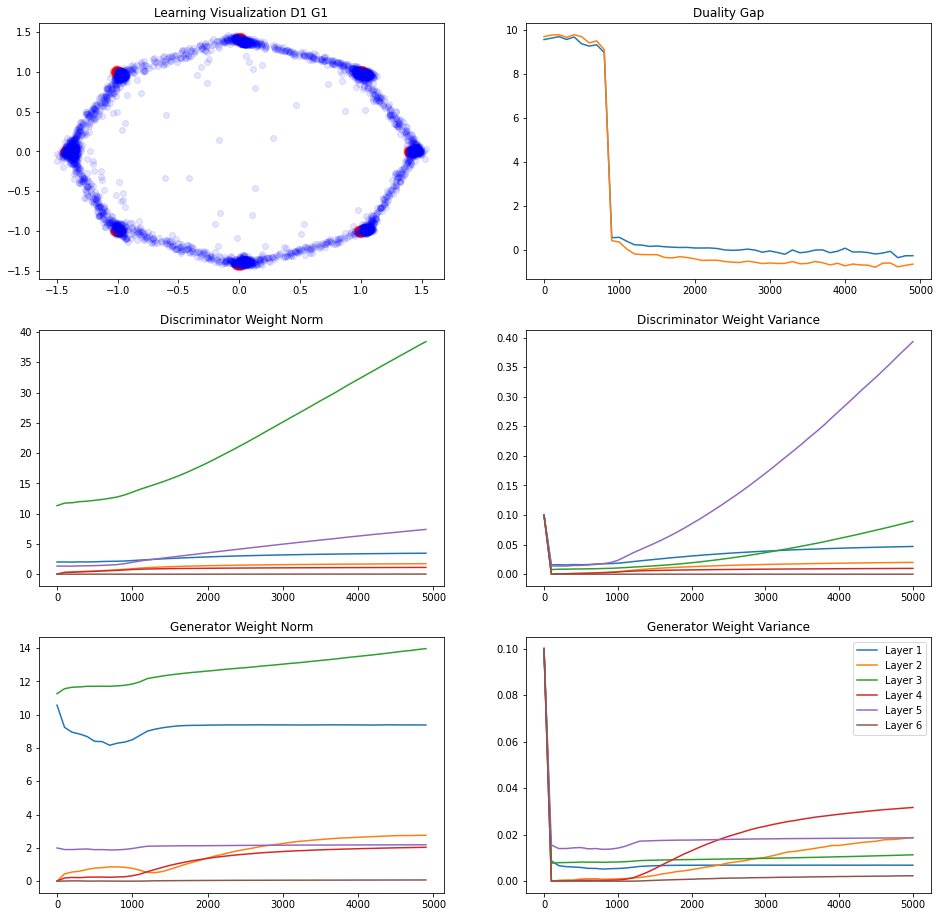

237/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  -0.20505261
L Random  Duality Gap :  -0.7142291
241/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  -0.099393666
L Random  Duality Gap :  -0.647899


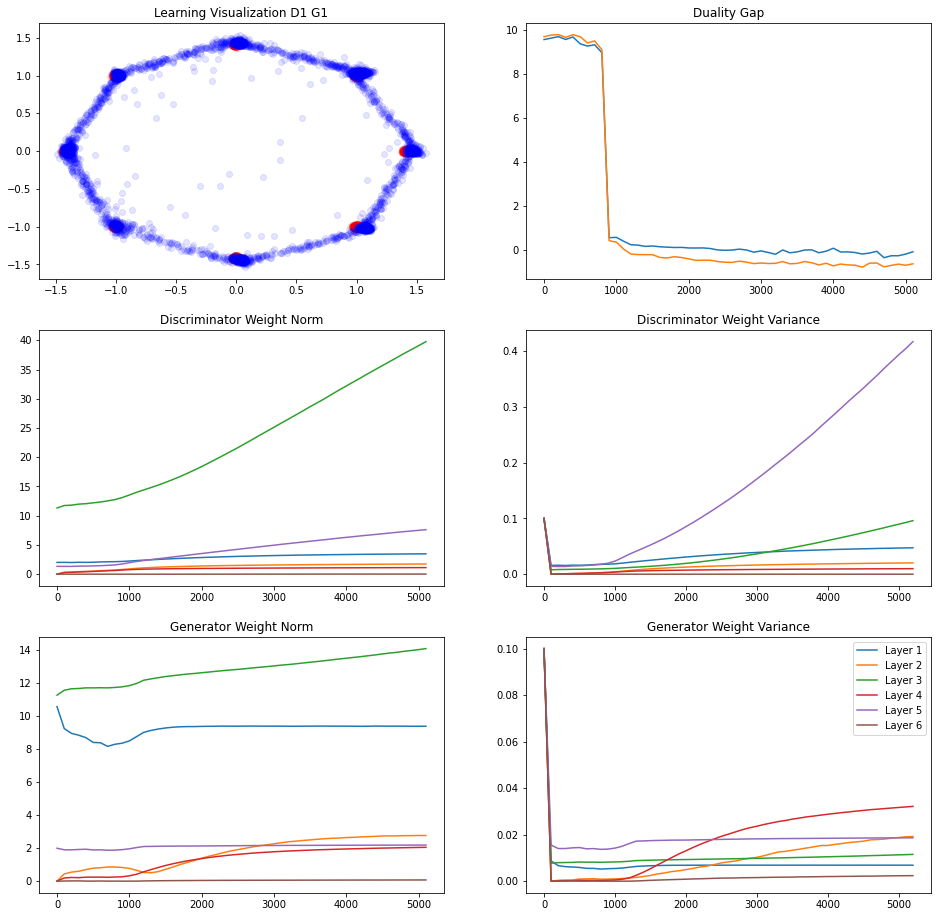

240/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  -0.19063902
L Random  Duality Gap :  -0.6280362


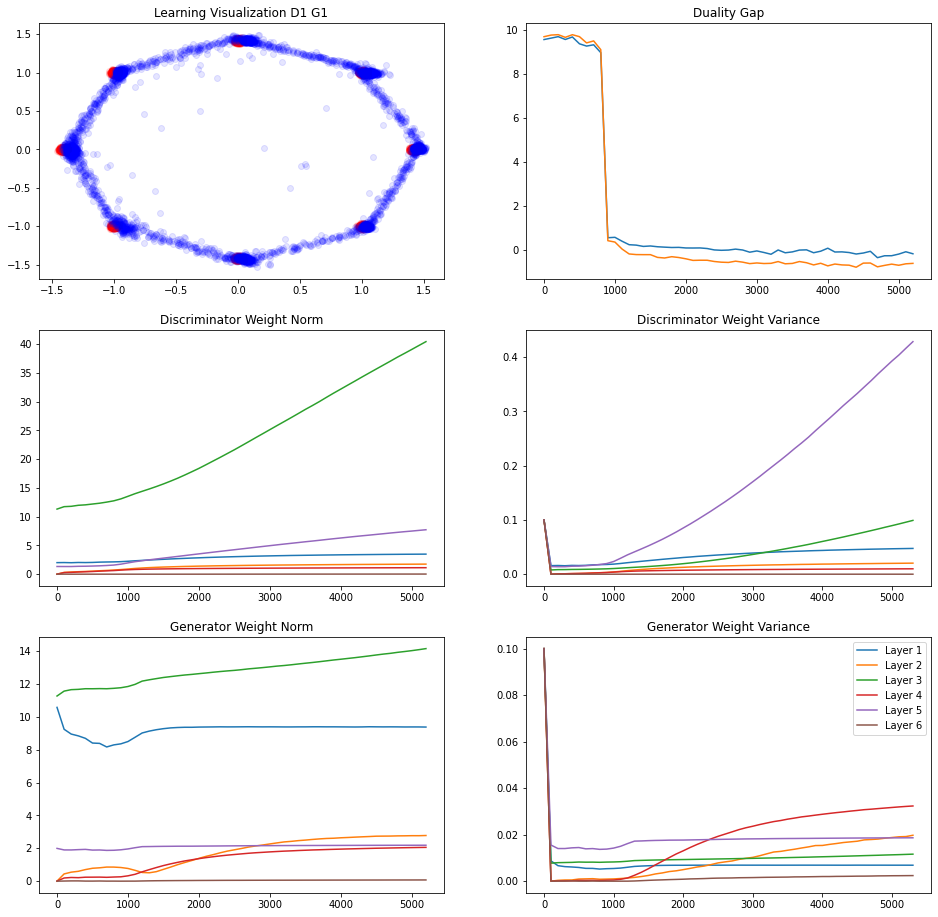

245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.34828424
L Random  Duality Gap :  -0.72354555


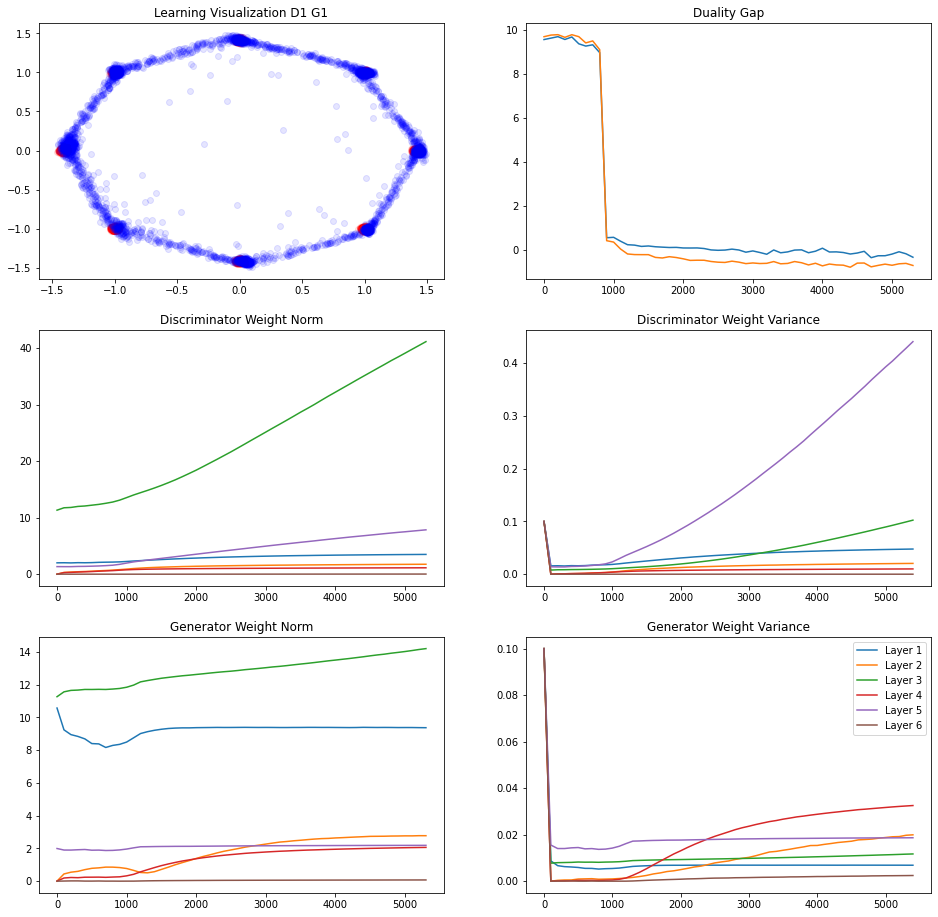

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.41528744
L Random  Duality Gap :  -0.85114384


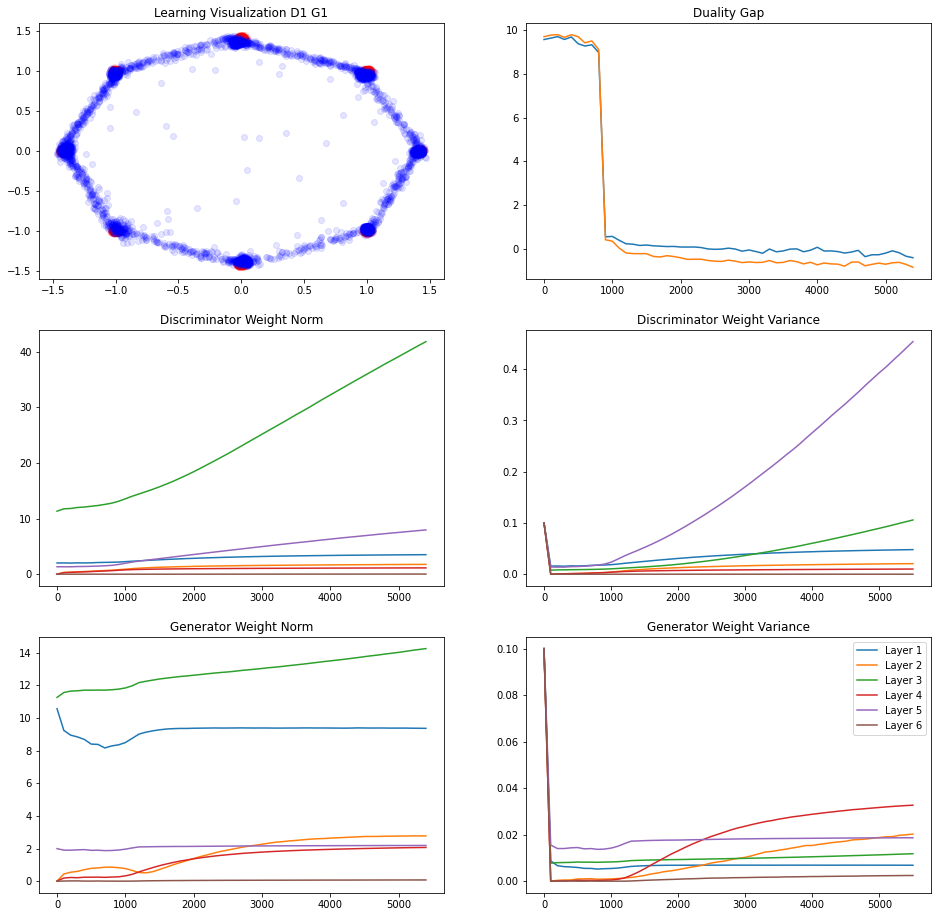

240/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  -0.39717168
L Random  Duality Gap :  -0.79789495
238/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  -0.17513639
L Random  Duality Gap :  -0.60407007


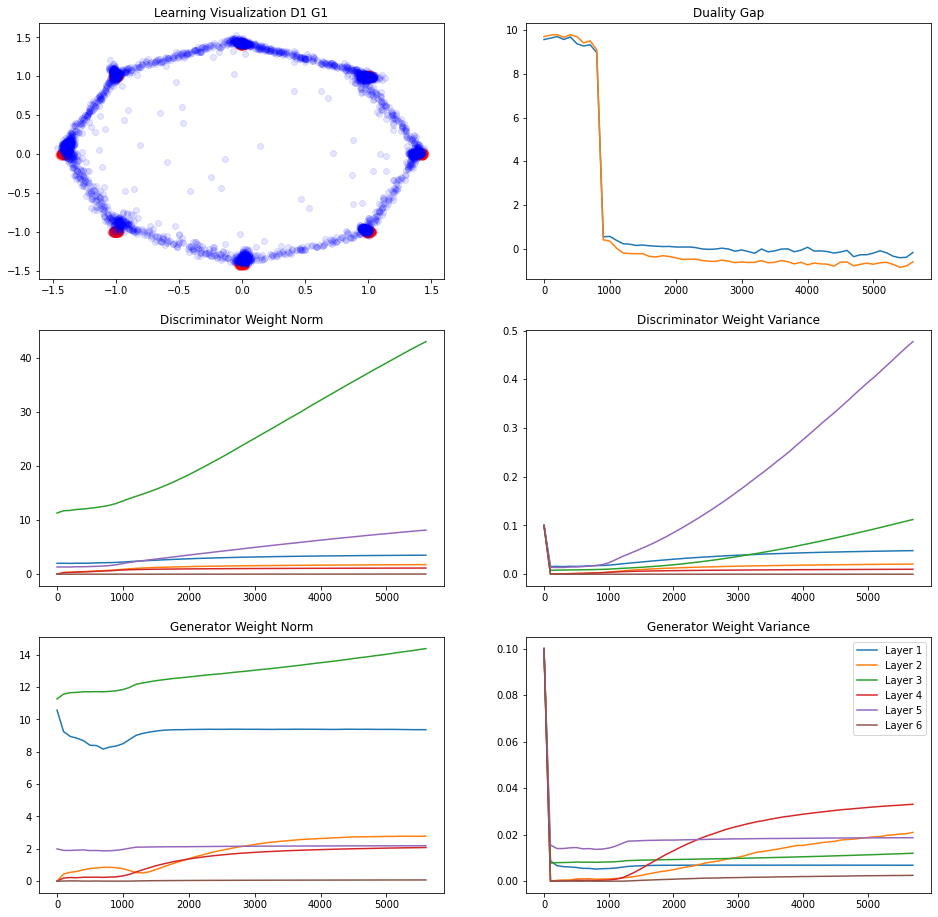

239/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  -0.28680038
L Random  Duality Gap :  -0.7121099


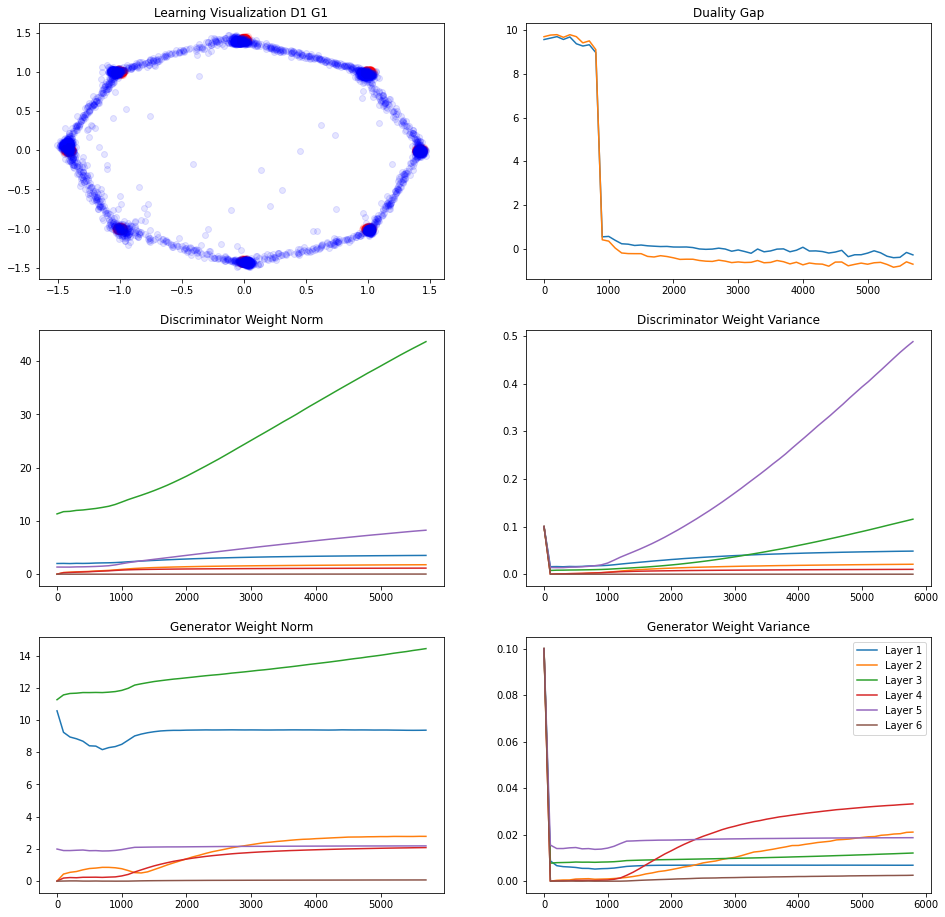

245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.41000438
L Random  Duality Gap :  -0.7538854


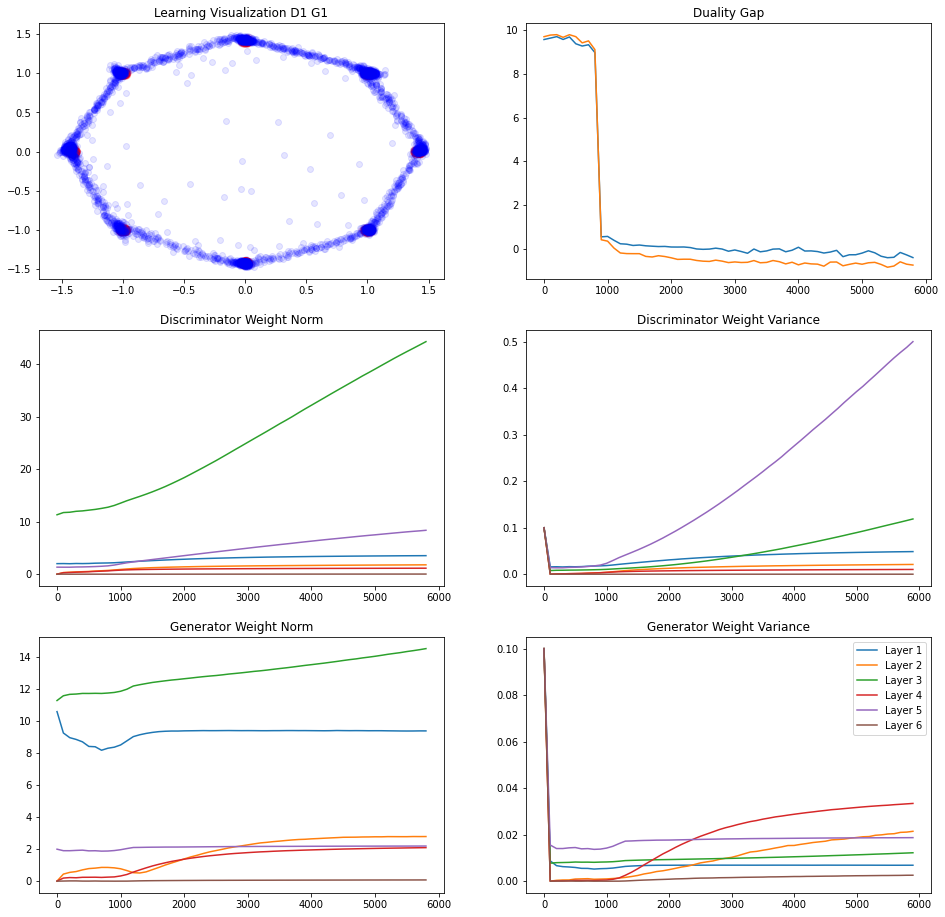

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.36135215
L Random  Duality Gap :  -0.6831921


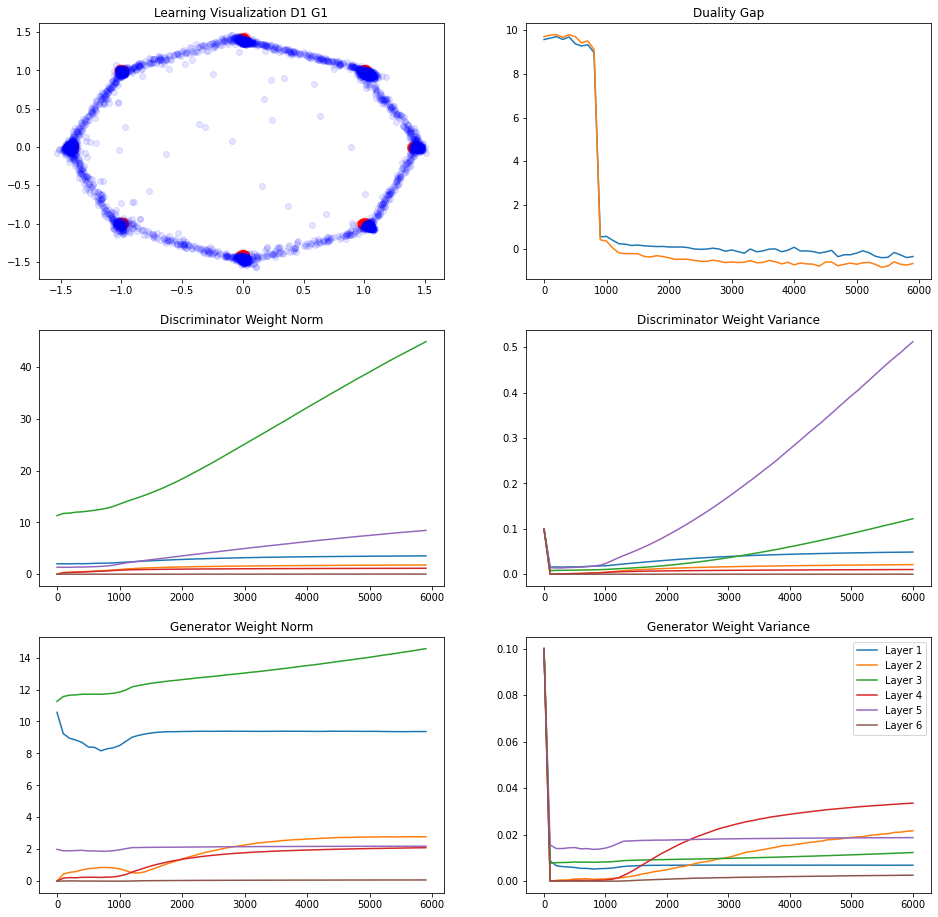

242/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.35453272
L Random  Duality Gap :  -0.86549795
239/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  -0.31176072
L Random  Duality Gap :  -0.78088945


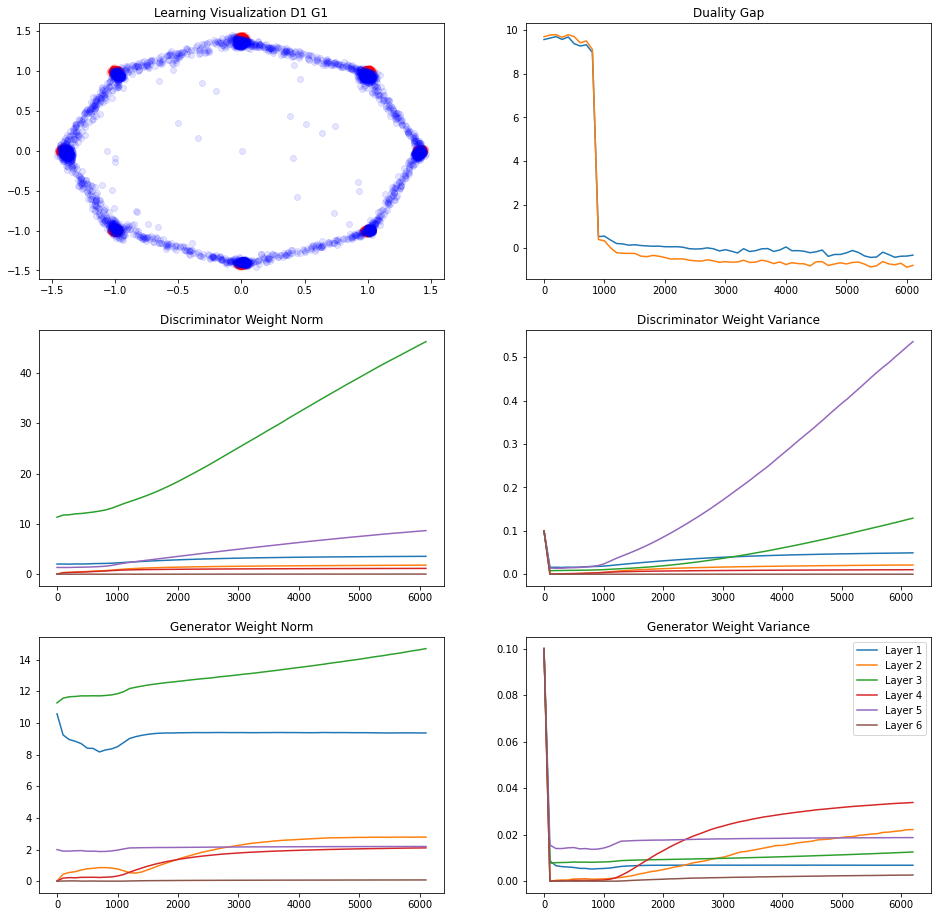

241/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  -0.25041664
L Random  Duality Gap :  -0.6363915


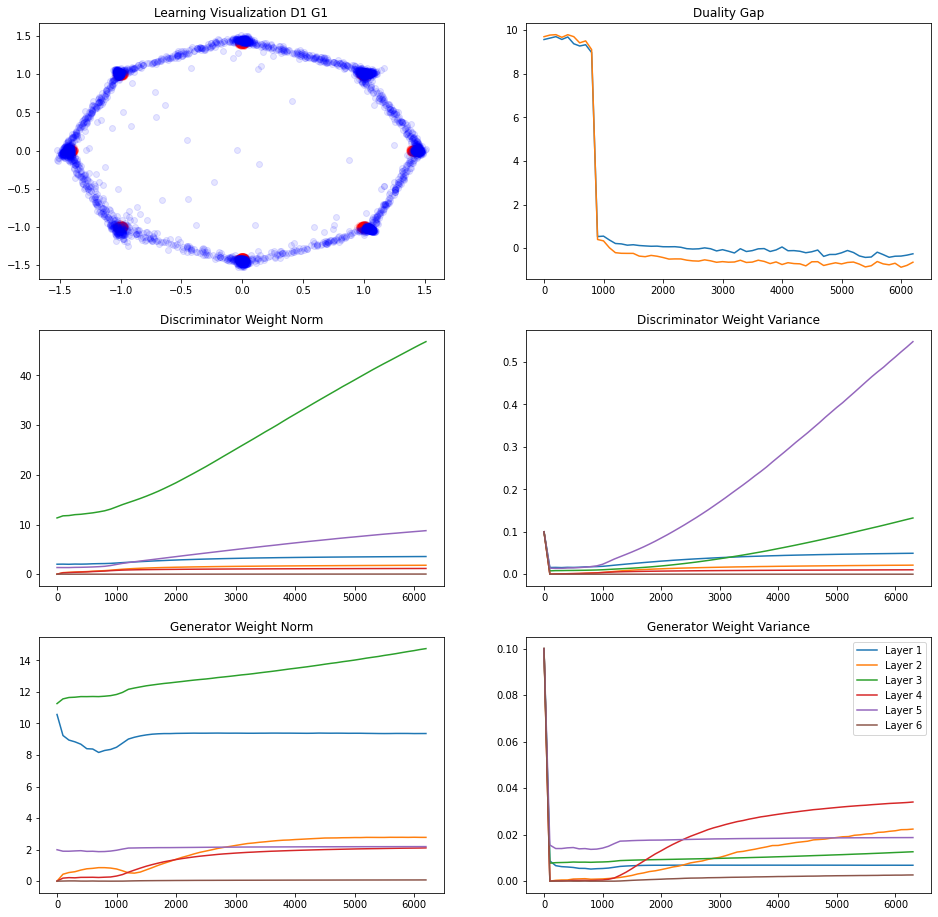

245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.41755283
L Random  Duality Gap :  -0.80118287


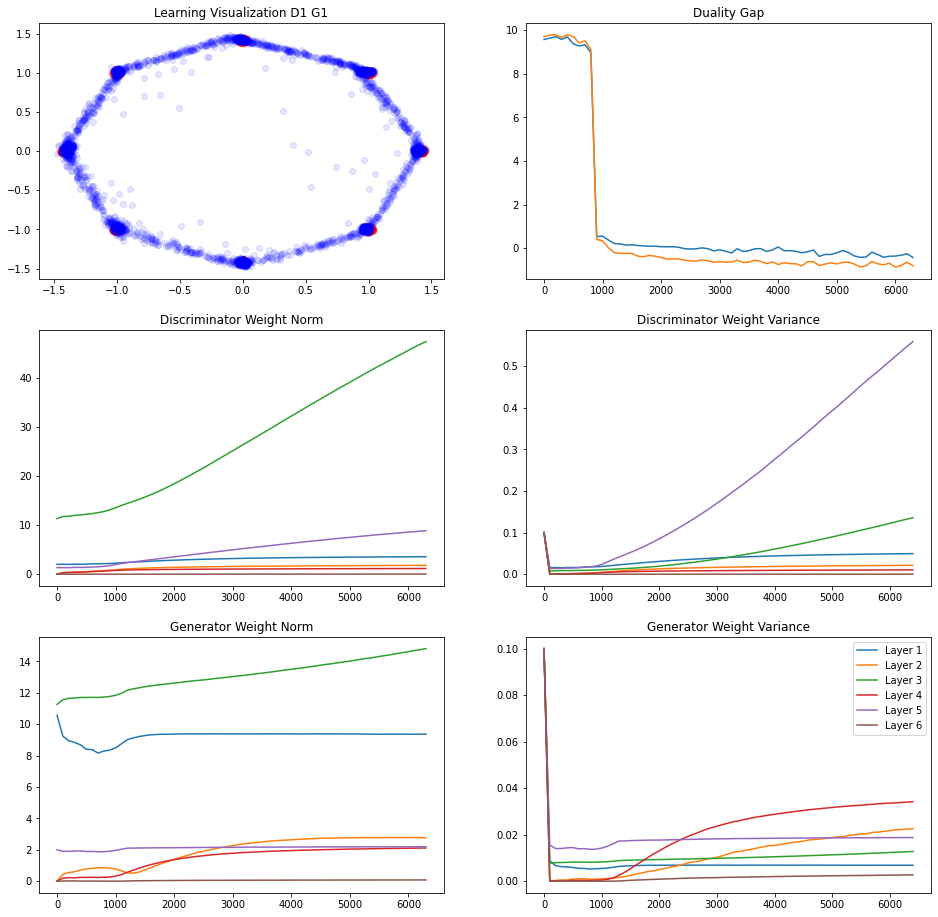

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.4553377
L Random  Duality Gap :  -0.7755349


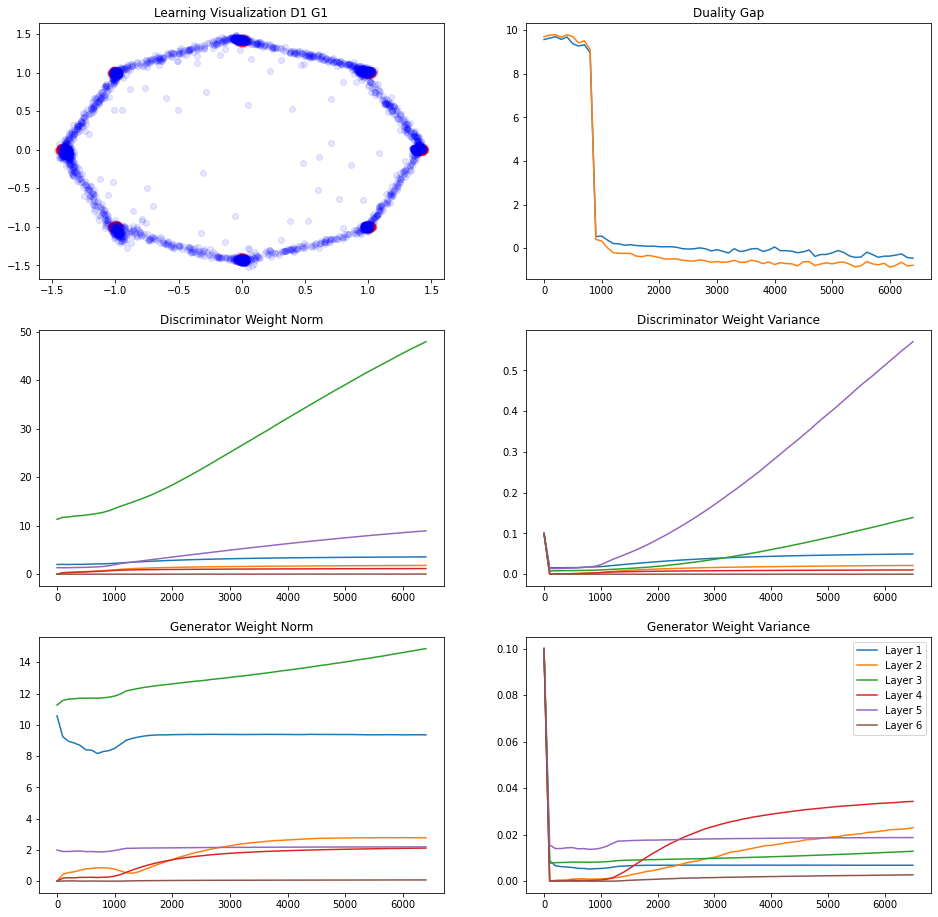

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.1875171
L Random  Duality Gap :  -0.69126016
244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.42266744
L Random  Duality Gap :  -0.6704269


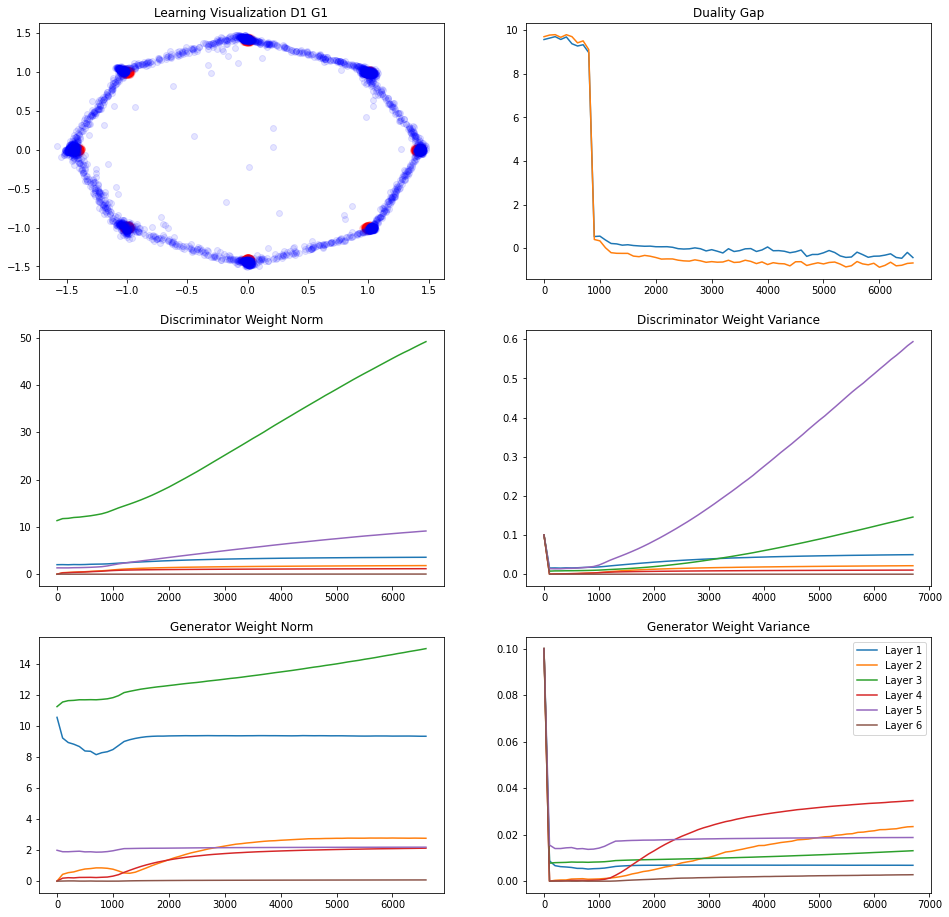

238/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  -0.4089297
L Random  Duality Gap :  -0.80985653


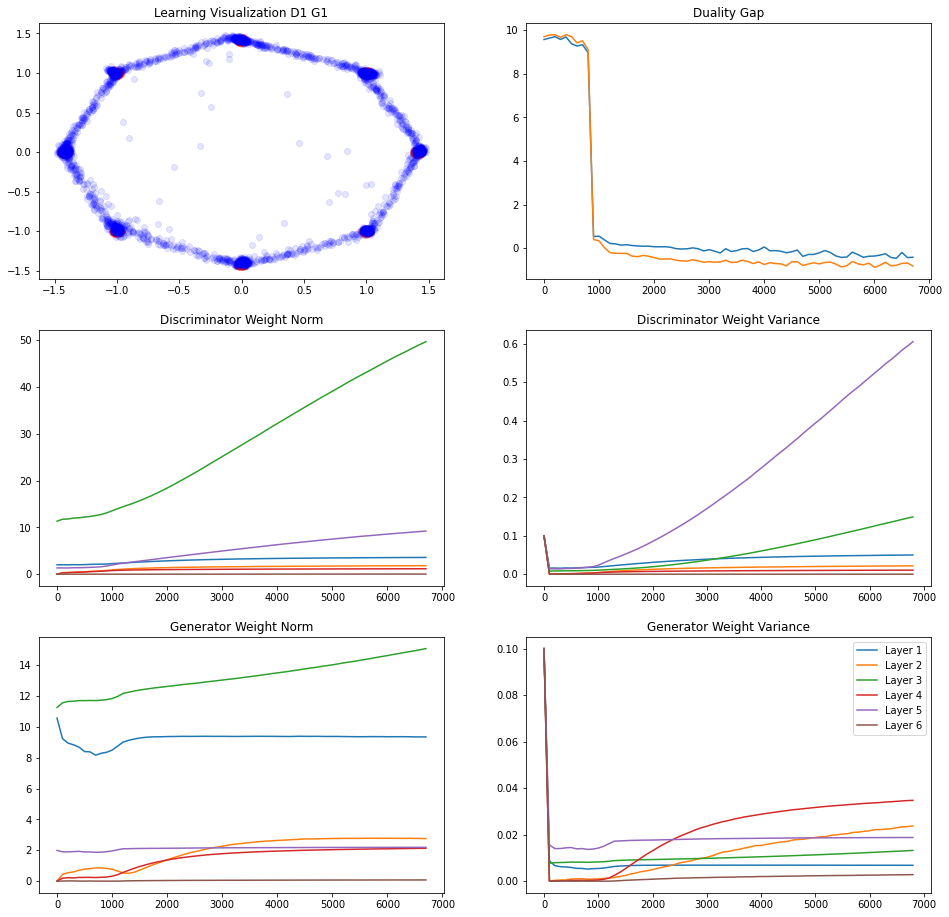

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.2701643
L Random  Duality Gap :  -0.7772186


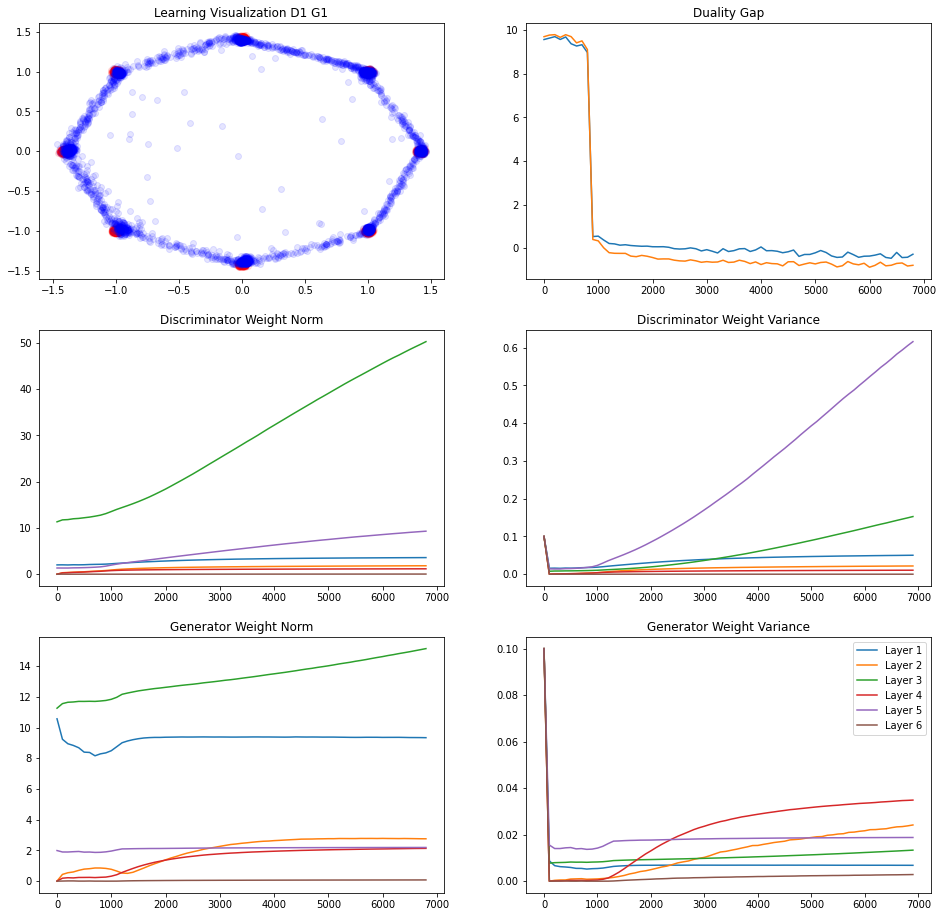

237/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  -0.31882083
L Random  Duality Gap :  -0.78198785


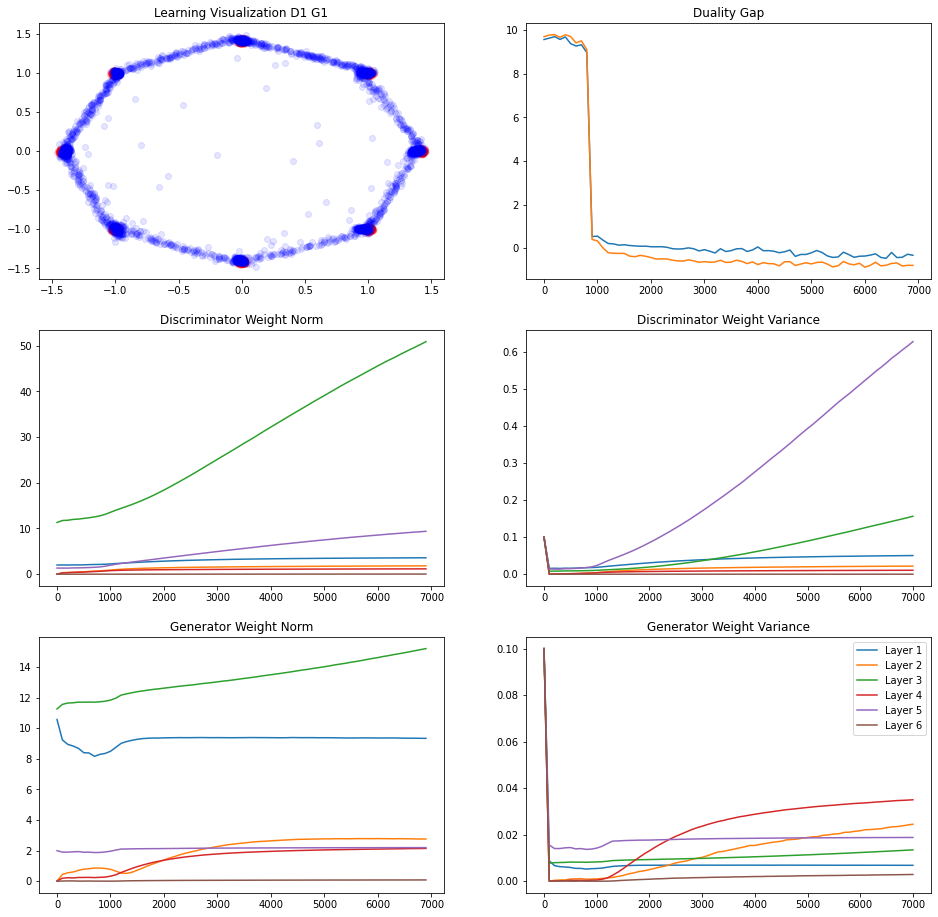

241/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  -0.1533457
L Random  Duality Gap :  -0.75671375
245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.33554375
L Random  Duality Gap :  -0.8233391


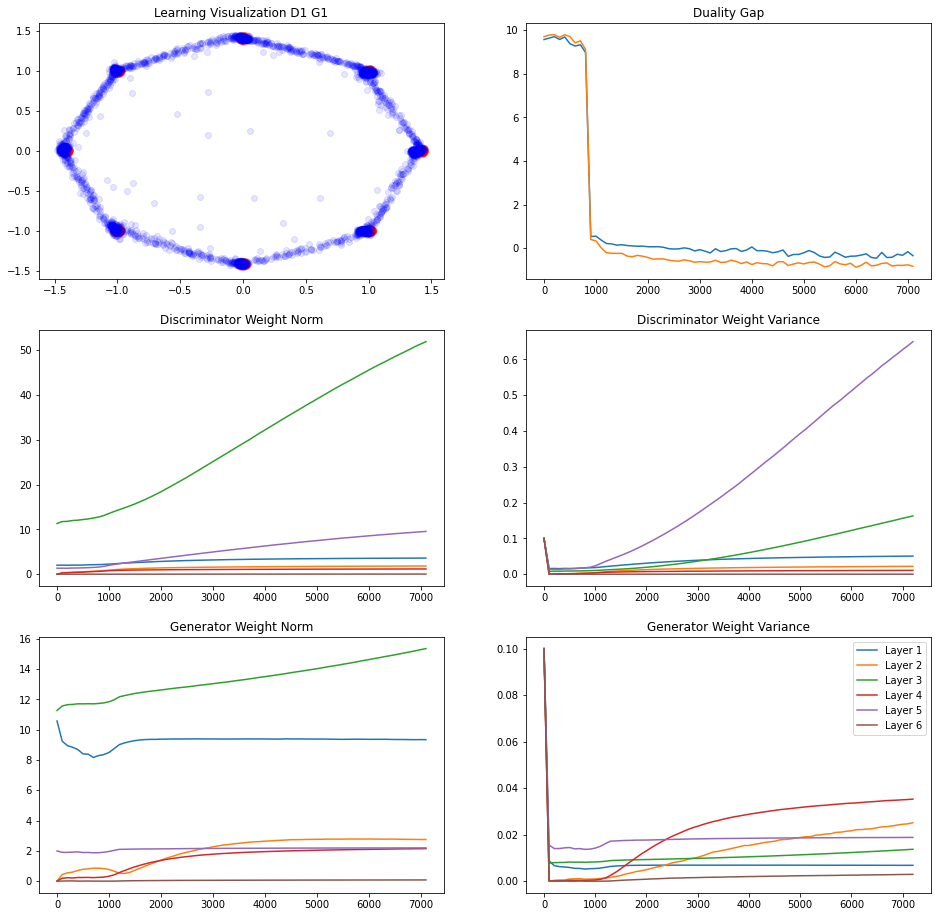

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.25049812
L Random  Duality Gap :  -0.7506716


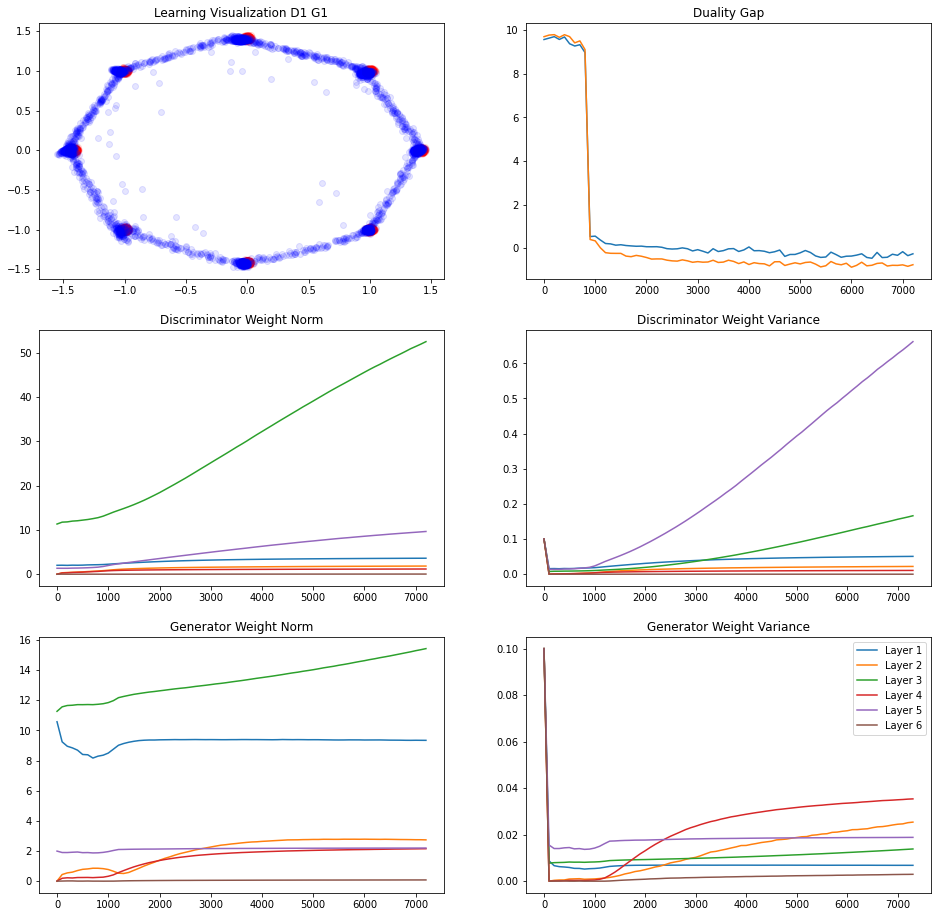

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.36766642
L Random  Duality Gap :  -0.7206337


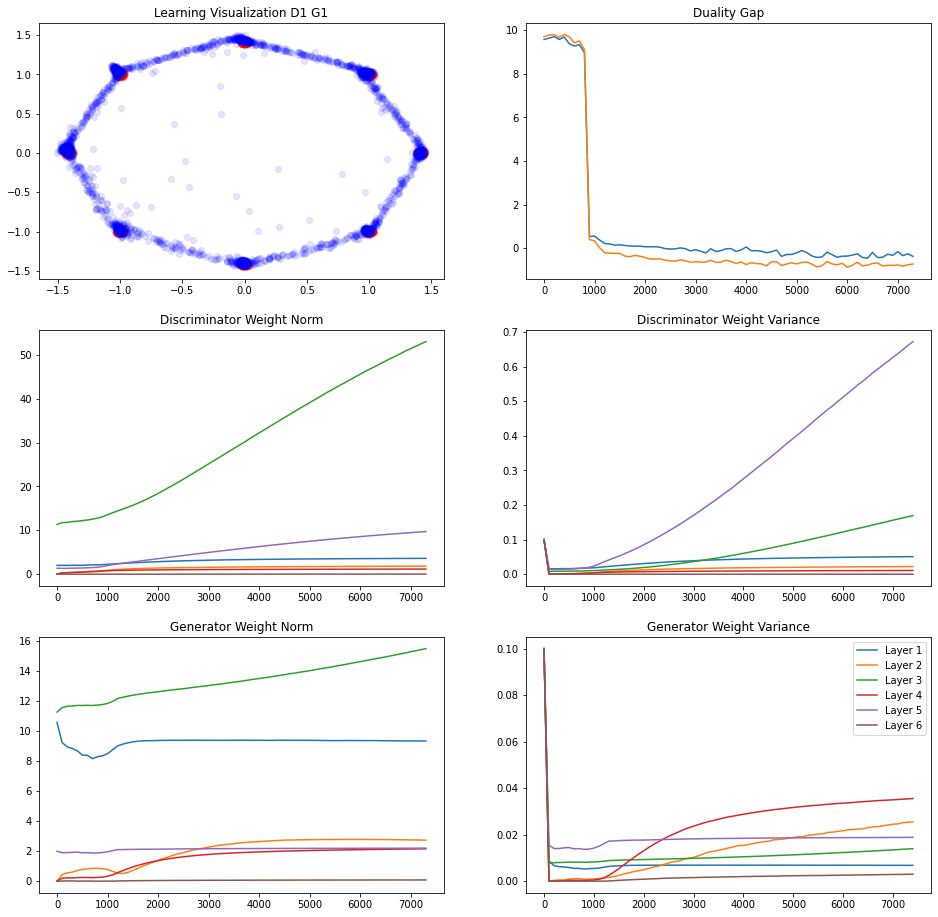

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.3216682
L Random  Duality Gap :  -0.7515819


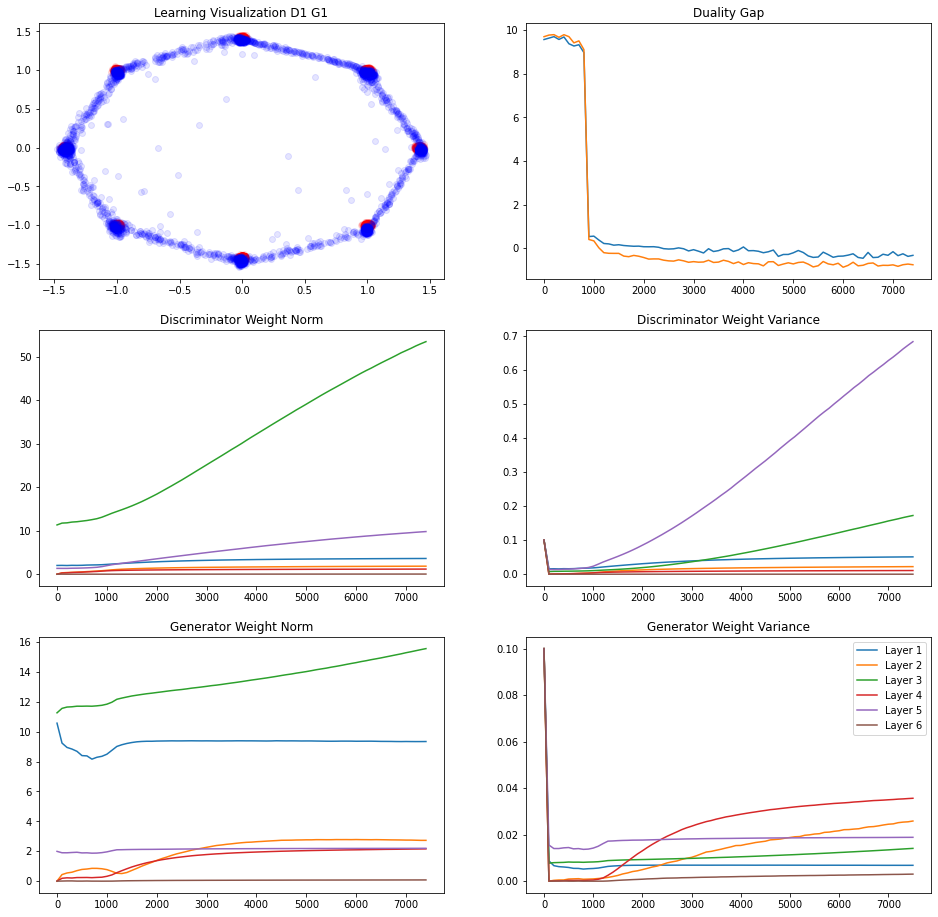

240/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  -0.28323644
L Random  Duality Gap :  -0.9143632
242/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.3326481
L Random  Duality Gap :  -0.6836253


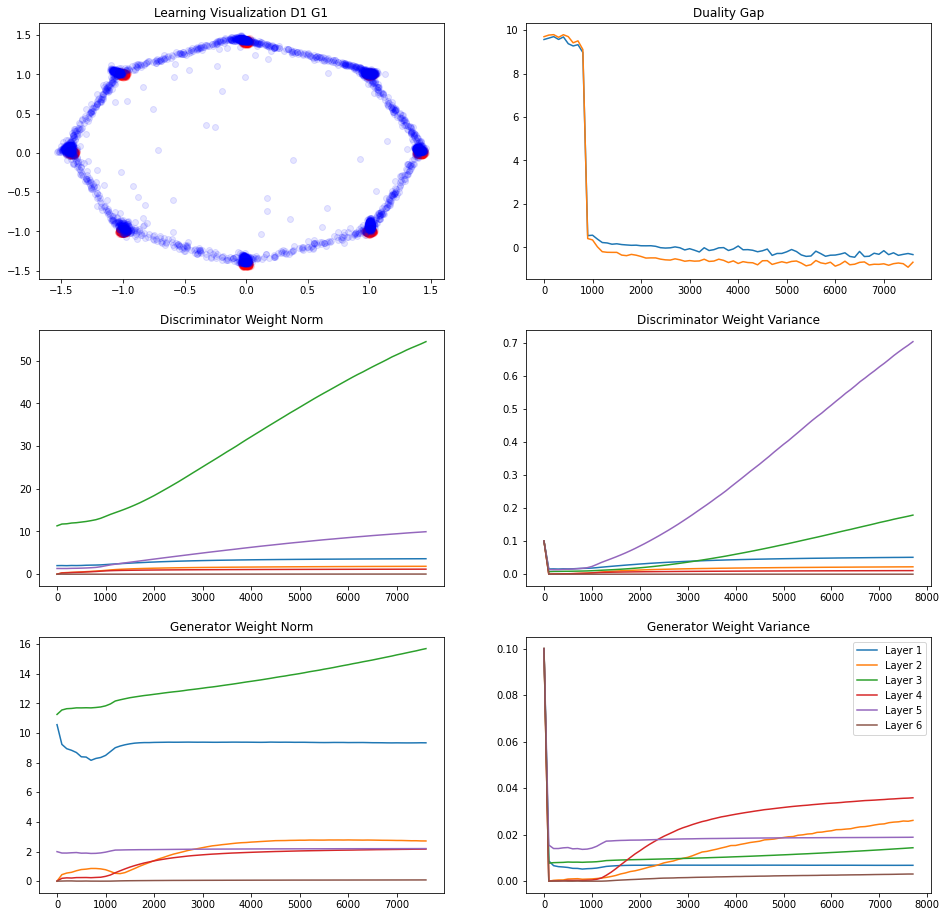

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.20891339
L Random  Duality Gap :  -0.7171323


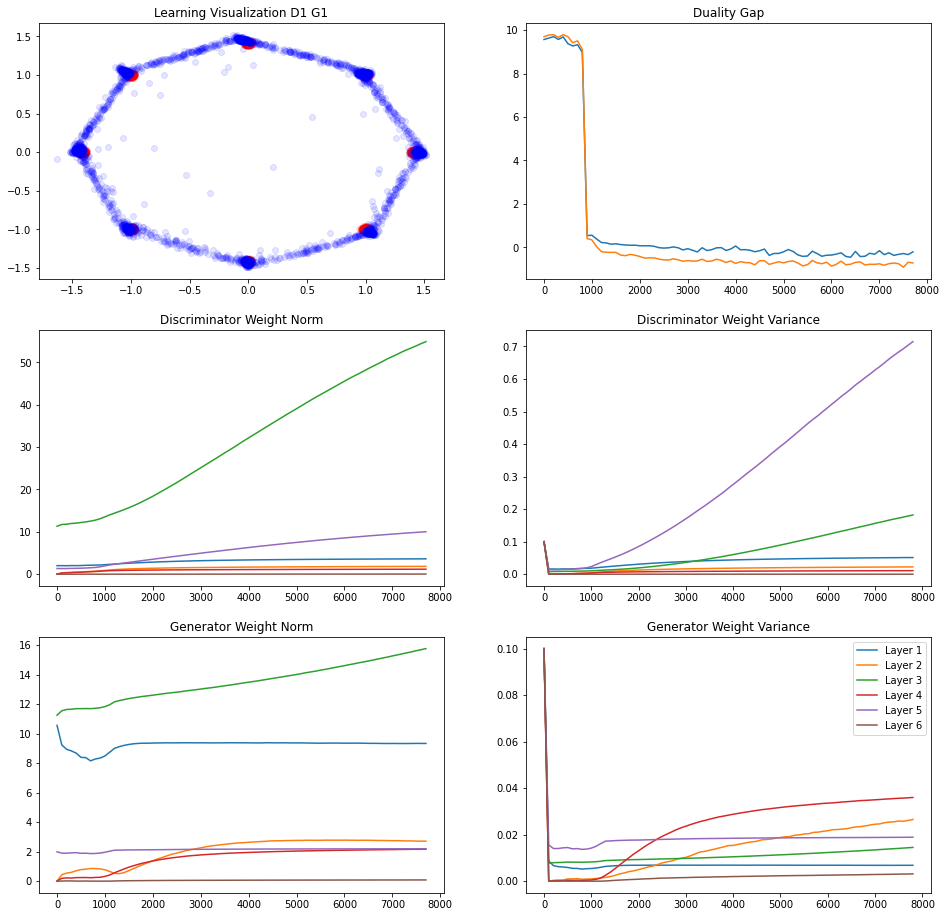

240/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  -0.08783752
L Random  Duality Gap :  -0.811403


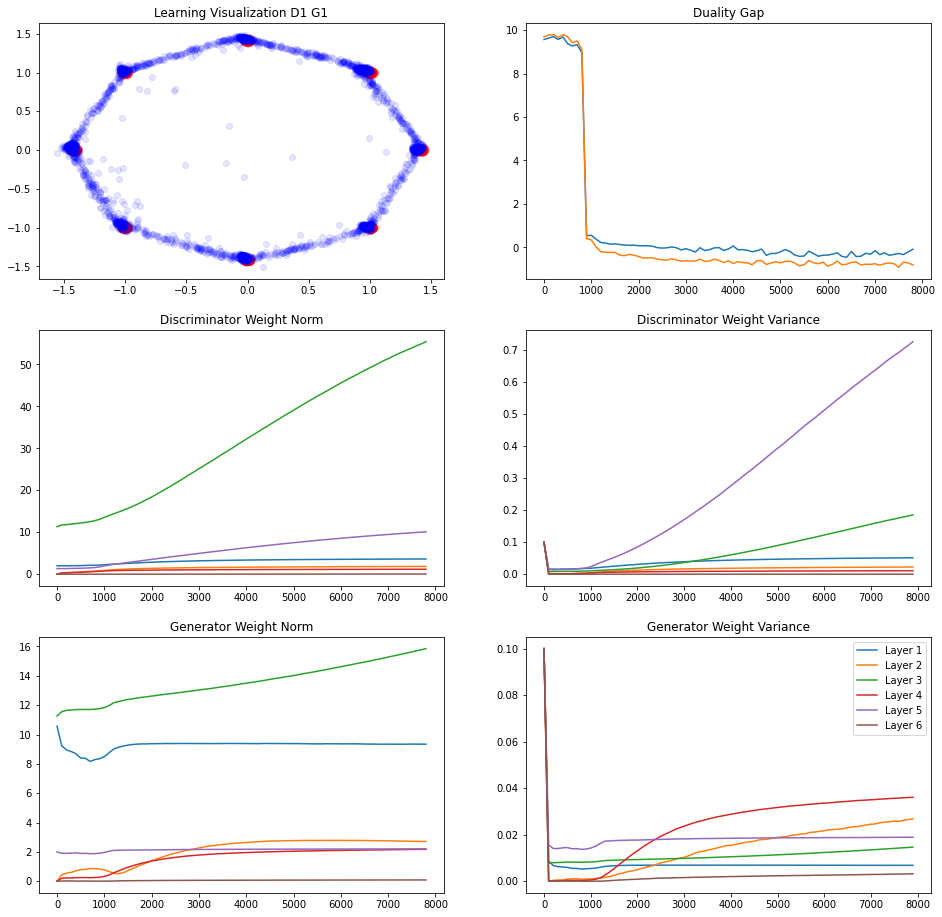

241/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  -0.22447306
L Random  Duality Gap :  -0.770884


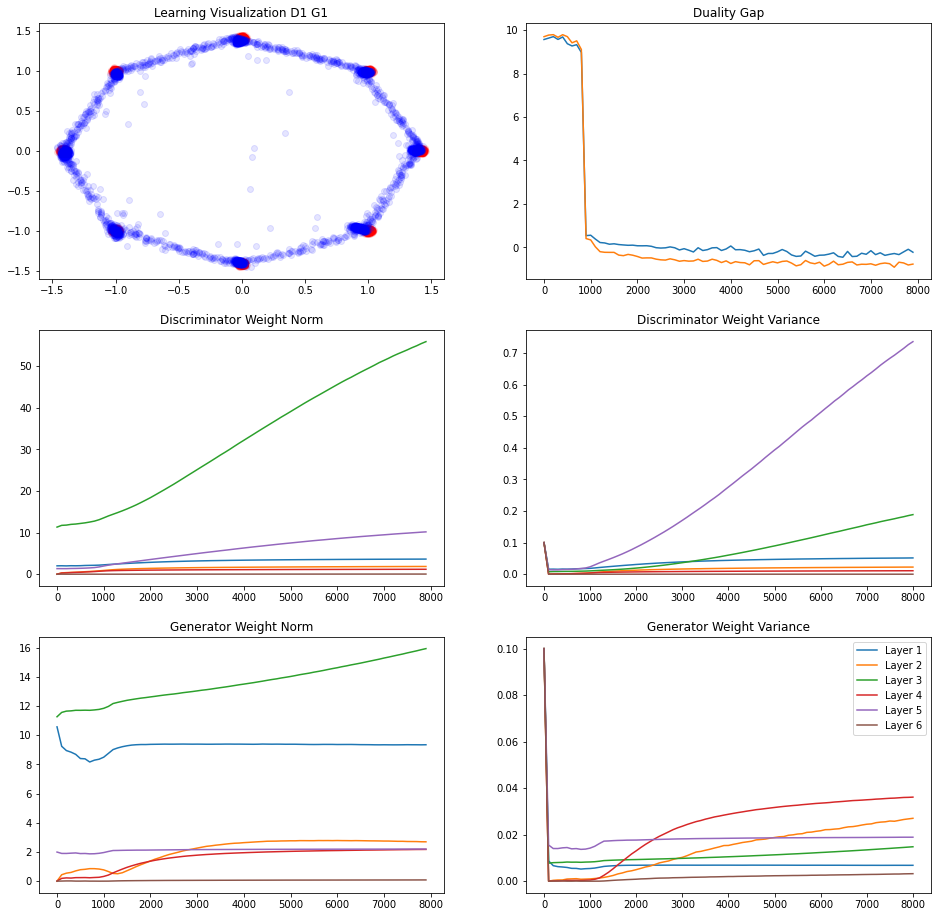

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.36531508
L Random  Duality Gap :  -0.7944371
241/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  -0.31940705
L Random  Duality Gap :  -0.6342454


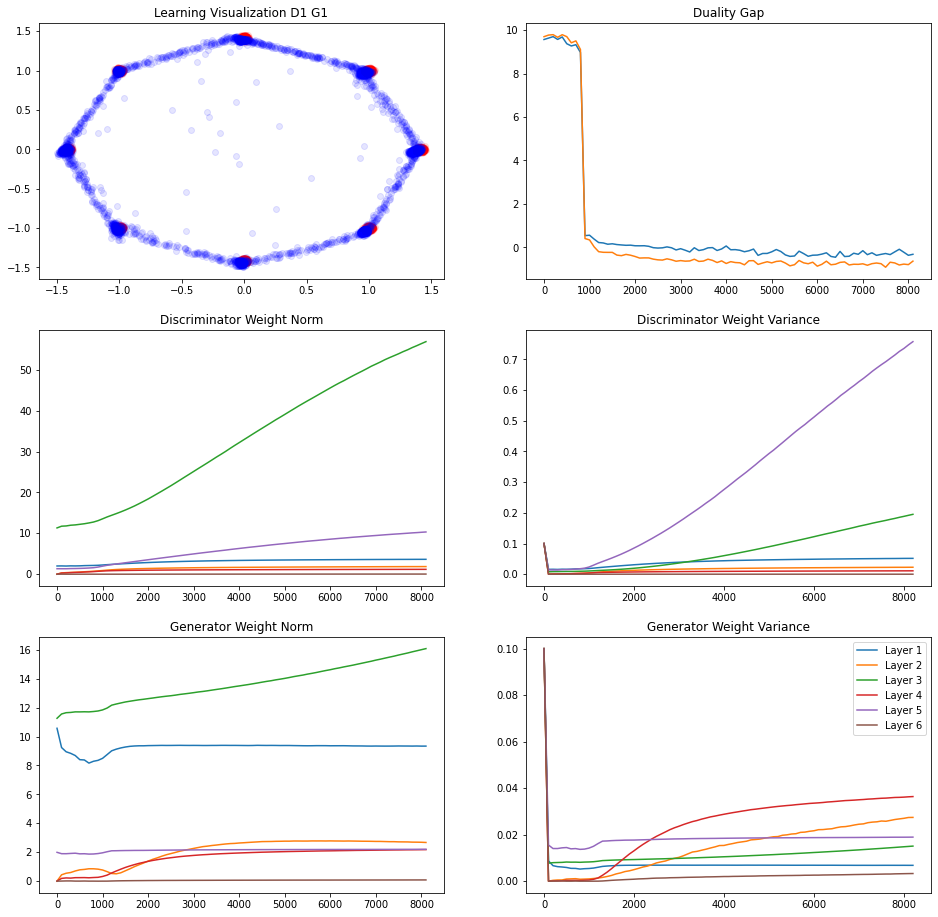

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.5157206
L Random  Duality Gap :  -0.77937144


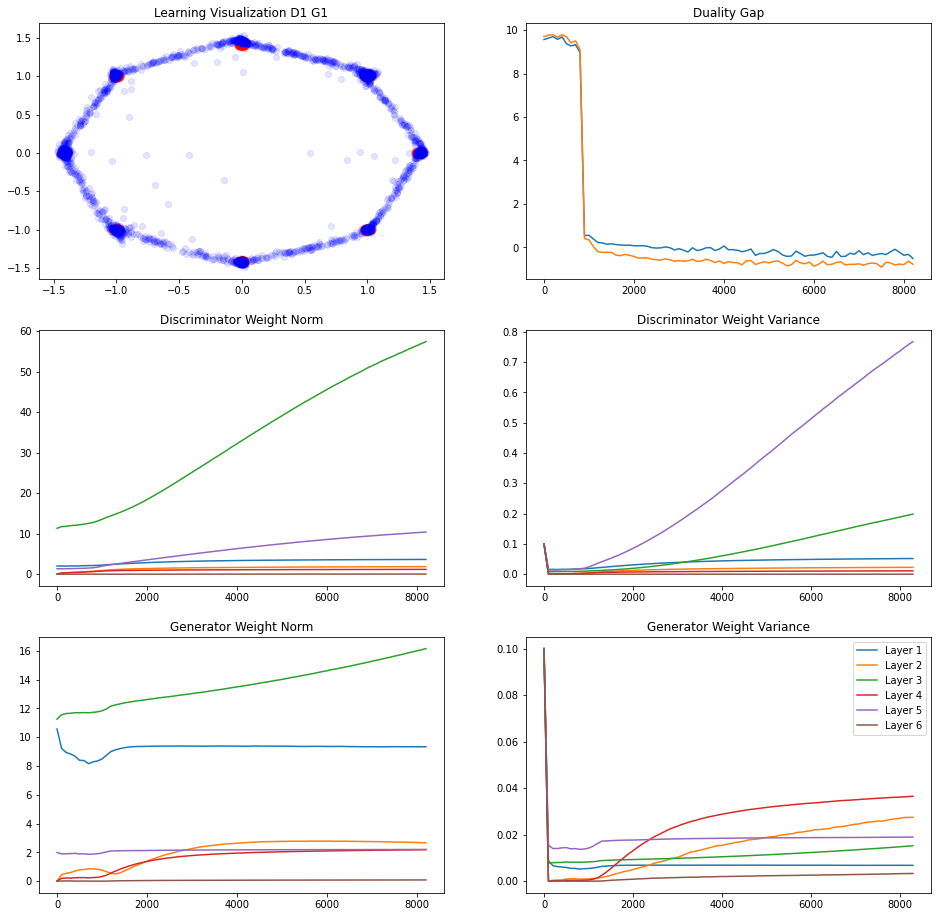

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.5141783
L Random  Duality Gap :  -0.74526924


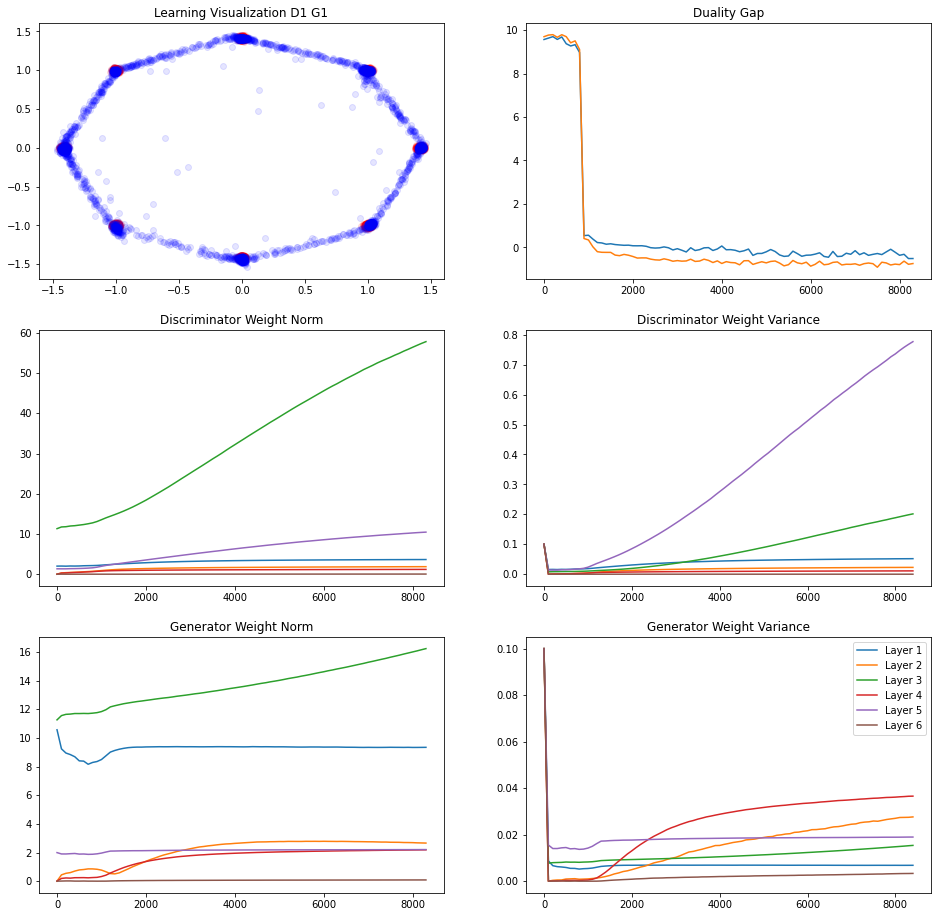

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.23028815
L Random  Duality Gap :  -0.81903666


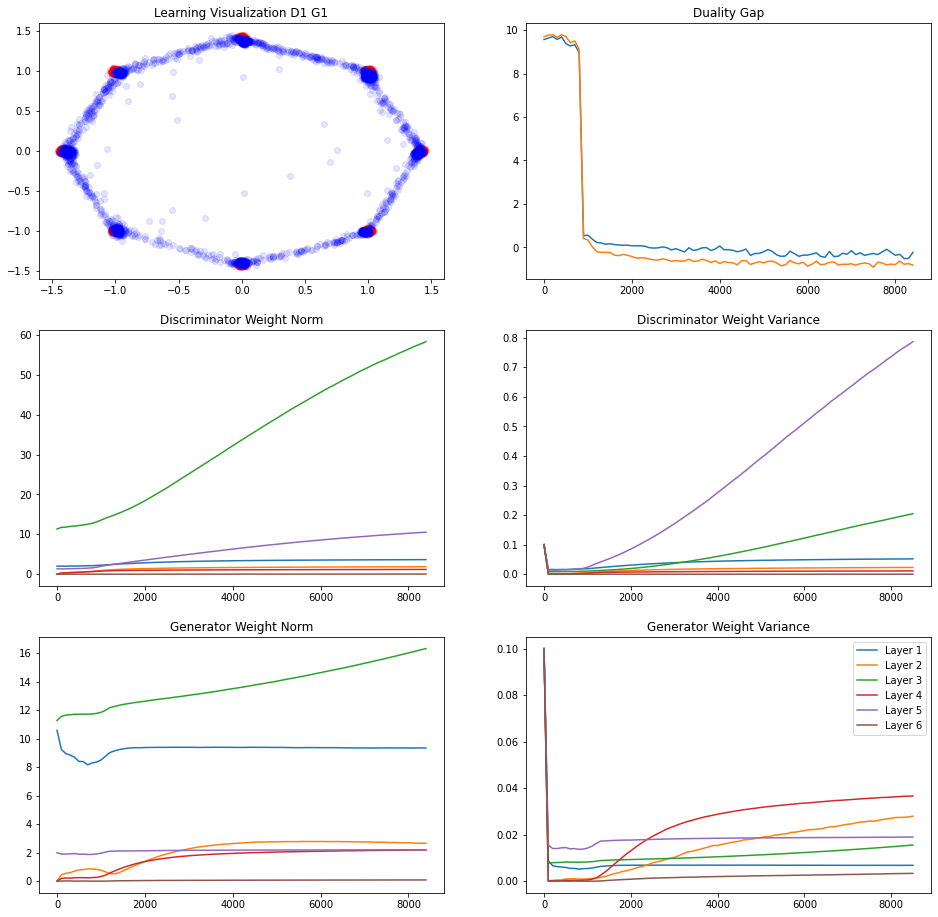

241/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  -0.15499139
L Random  Duality Gap :  -0.58371276
239/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  -0.48348475
L Random  Duality Gap :  -0.86459756


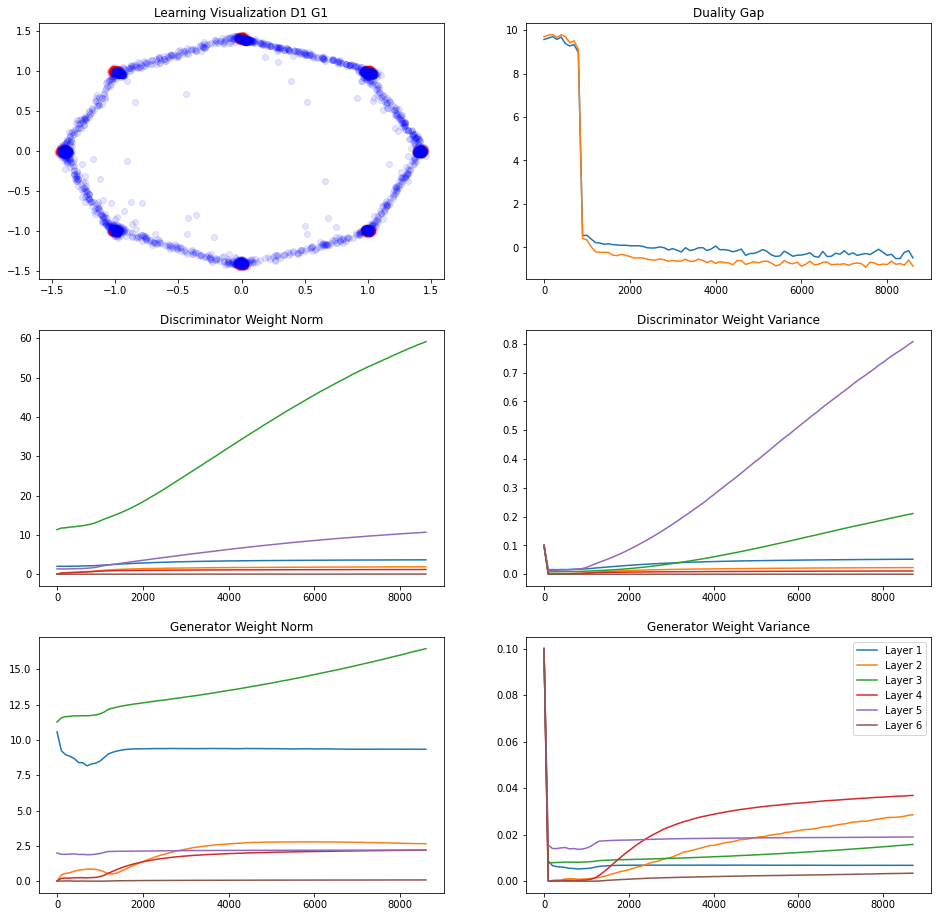

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.38276154
L Random  Duality Gap :  -0.7840431


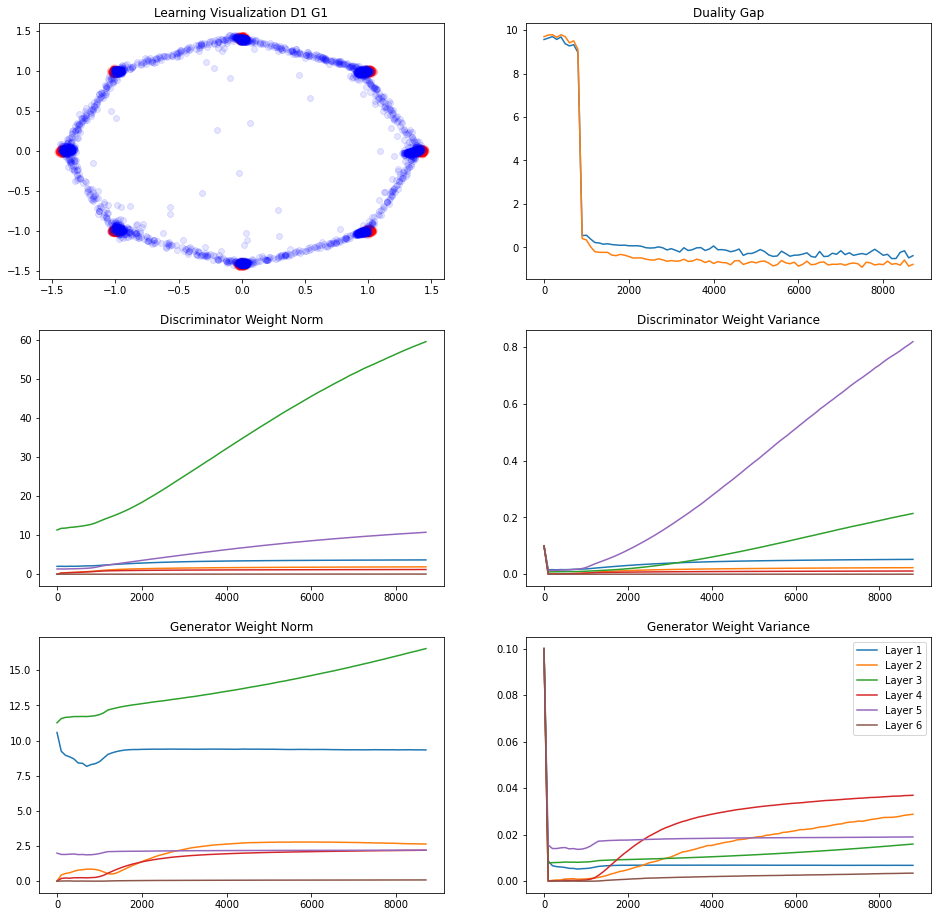

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.3252554
L Random  Duality Gap :  -0.7030097


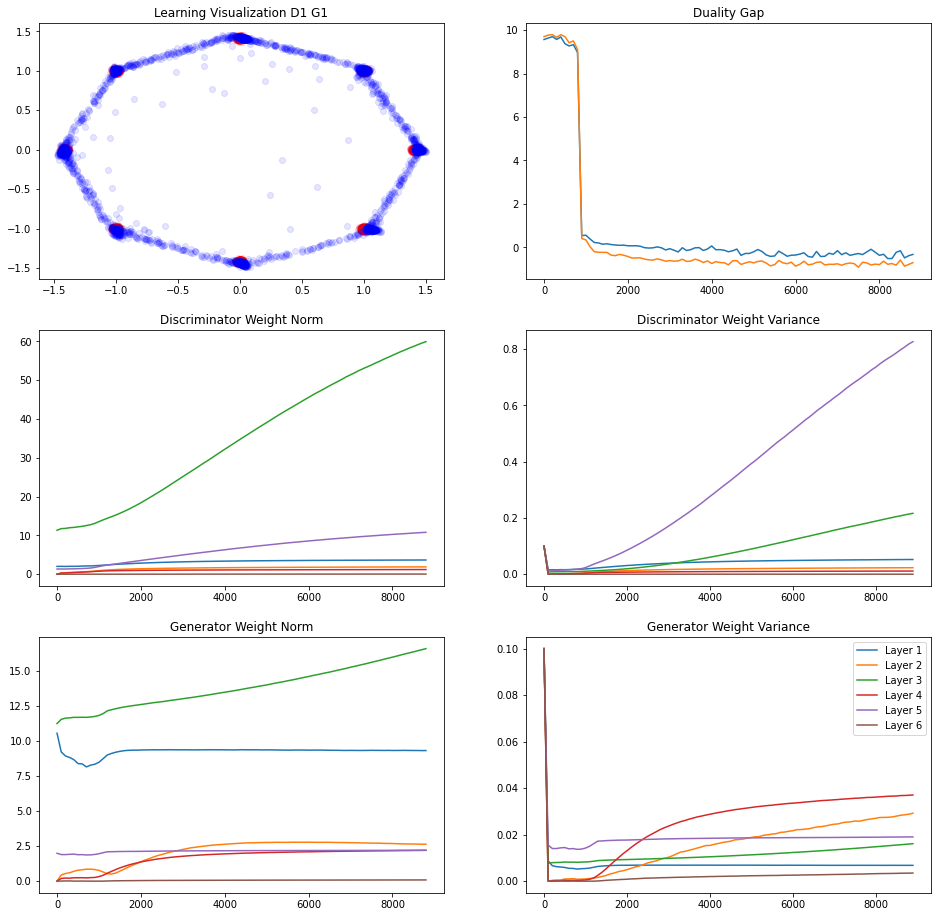

238/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  -0.34247255
L Random  Duality Gap :  -0.82317704


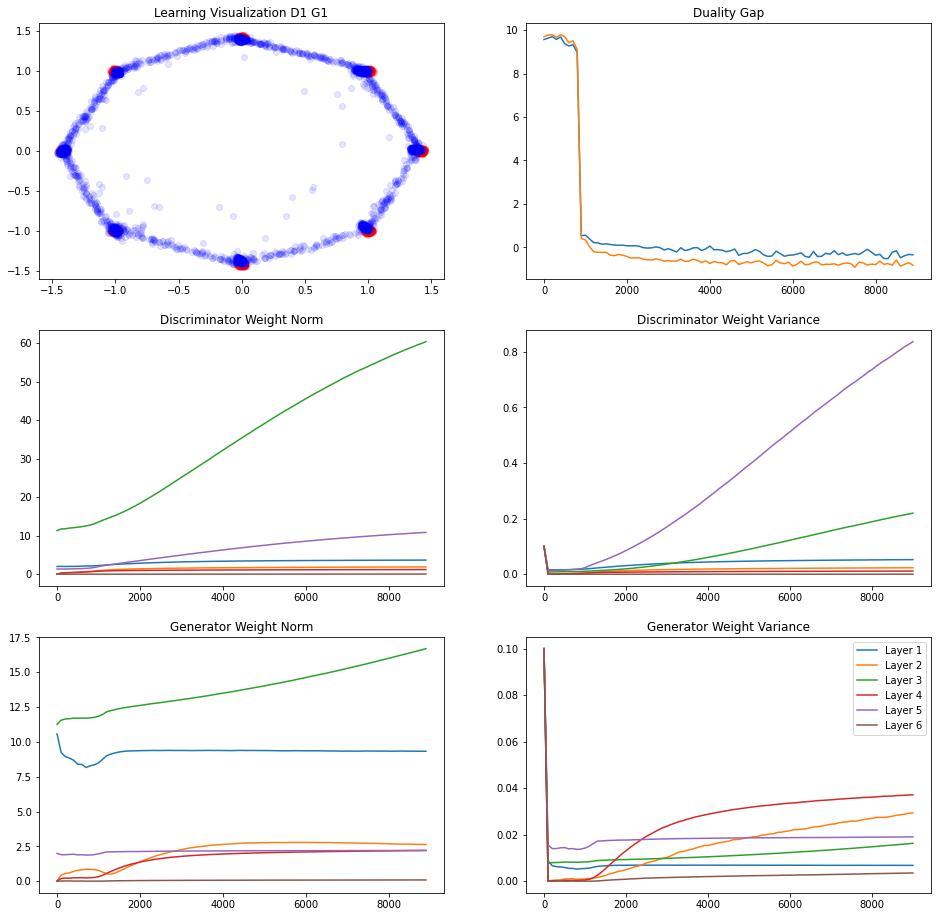

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.24782407
L Random  Duality Gap :  -0.74247897
247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.39898676
L Random  Duality Gap :  -0.76868385


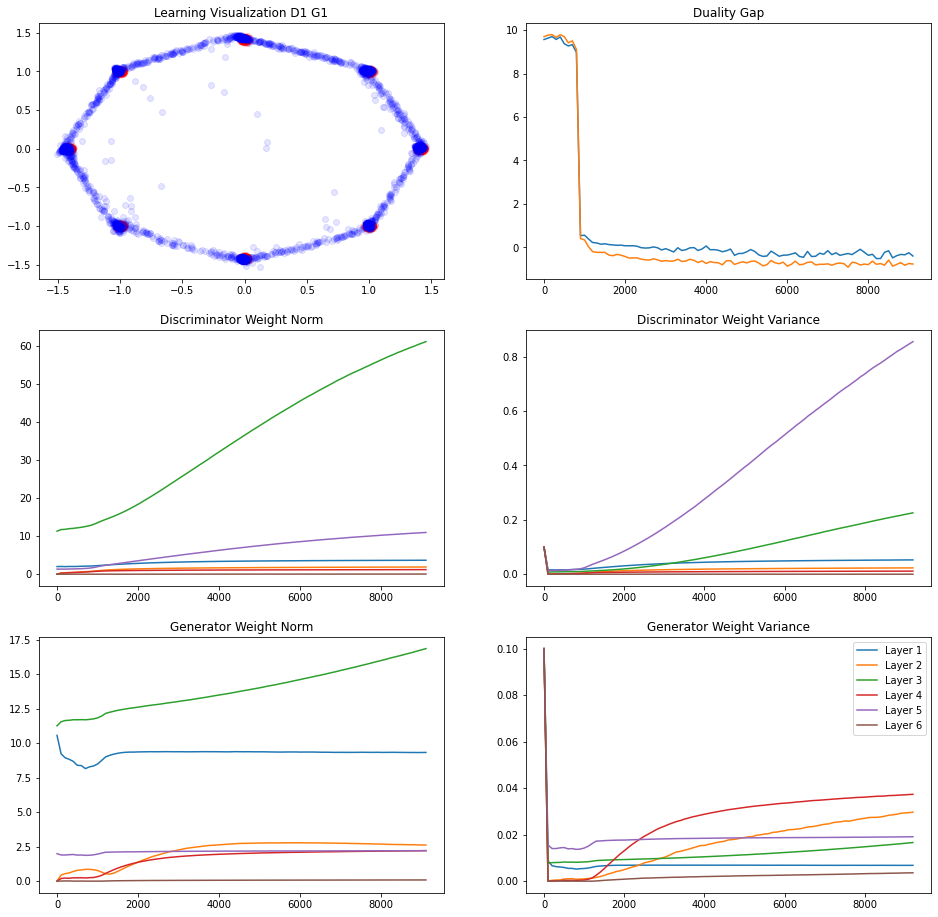

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.34740657
L Random  Duality Gap :  -0.7565051


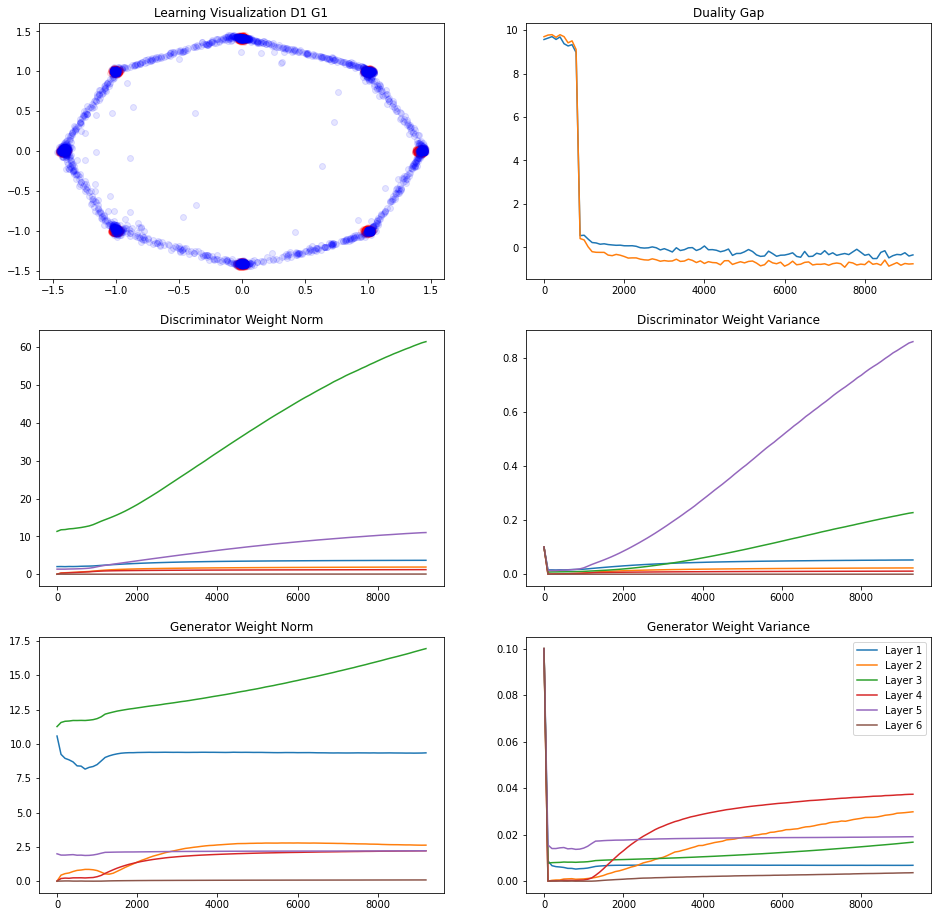

245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.3967734
L Random  Duality Gap :  -0.7758076


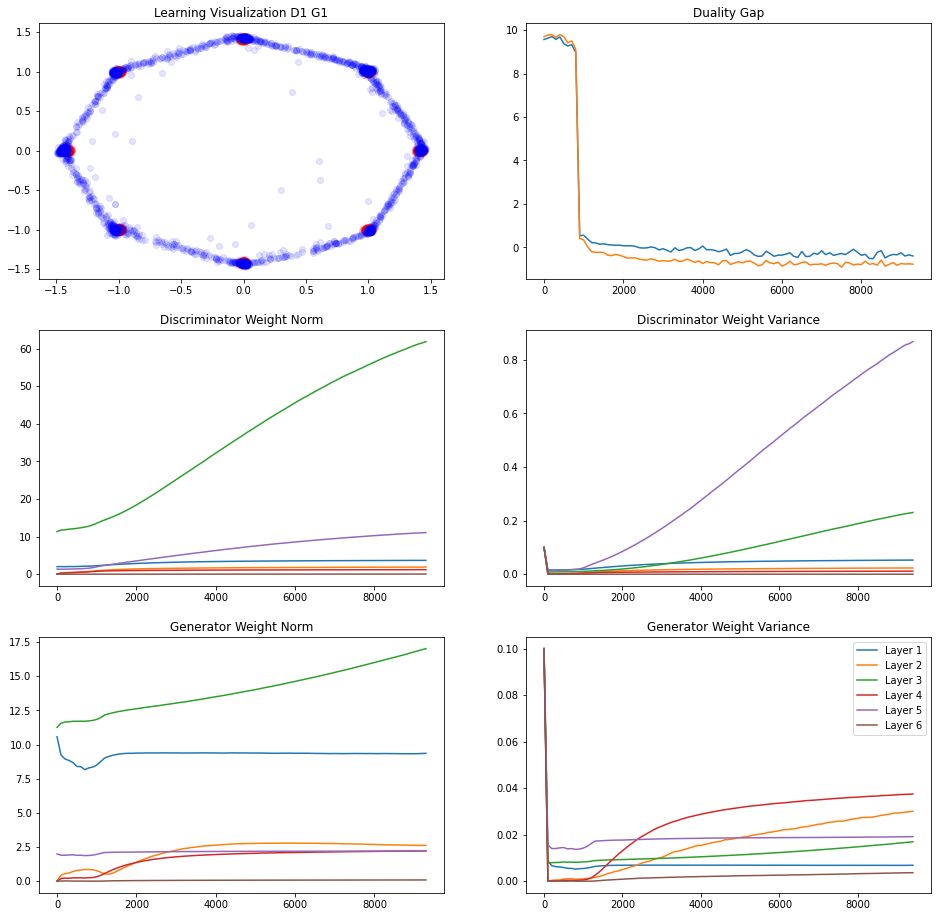

237/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  -0.45645785
L Random  Duality Gap :  -0.78057665


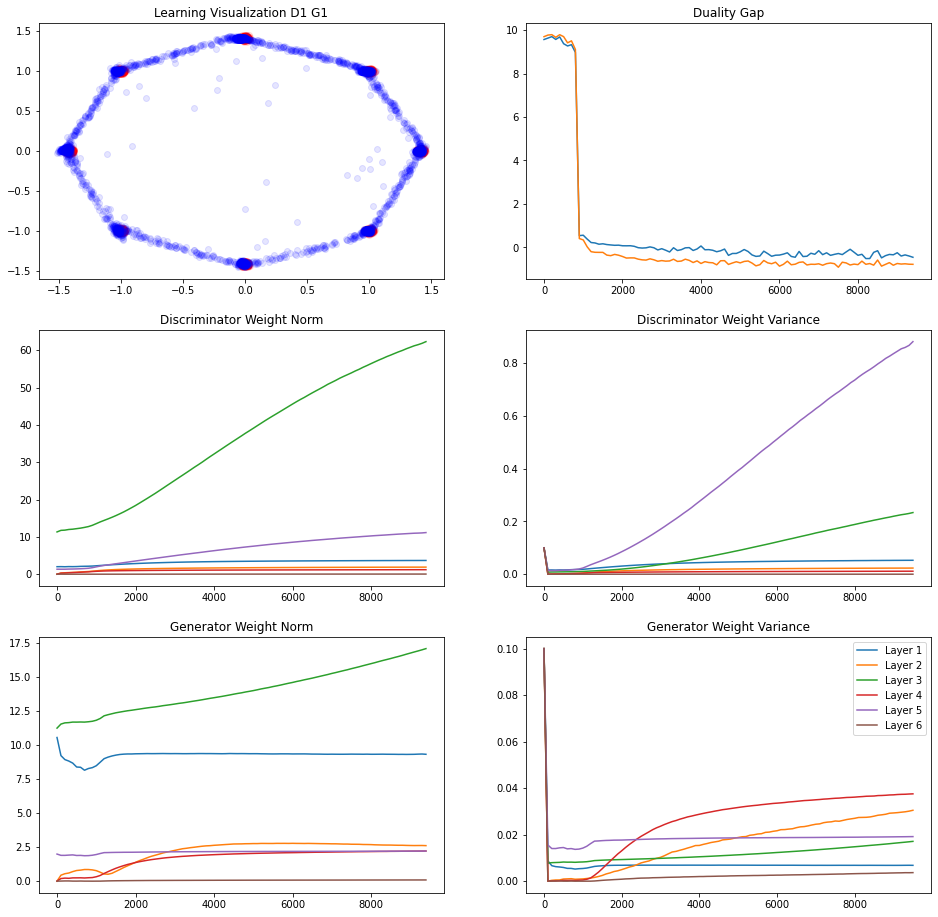

245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.06295782
L Random  Duality Gap :  -0.82127064
242/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.53063613
L Random  Duality Gap :  -0.804097


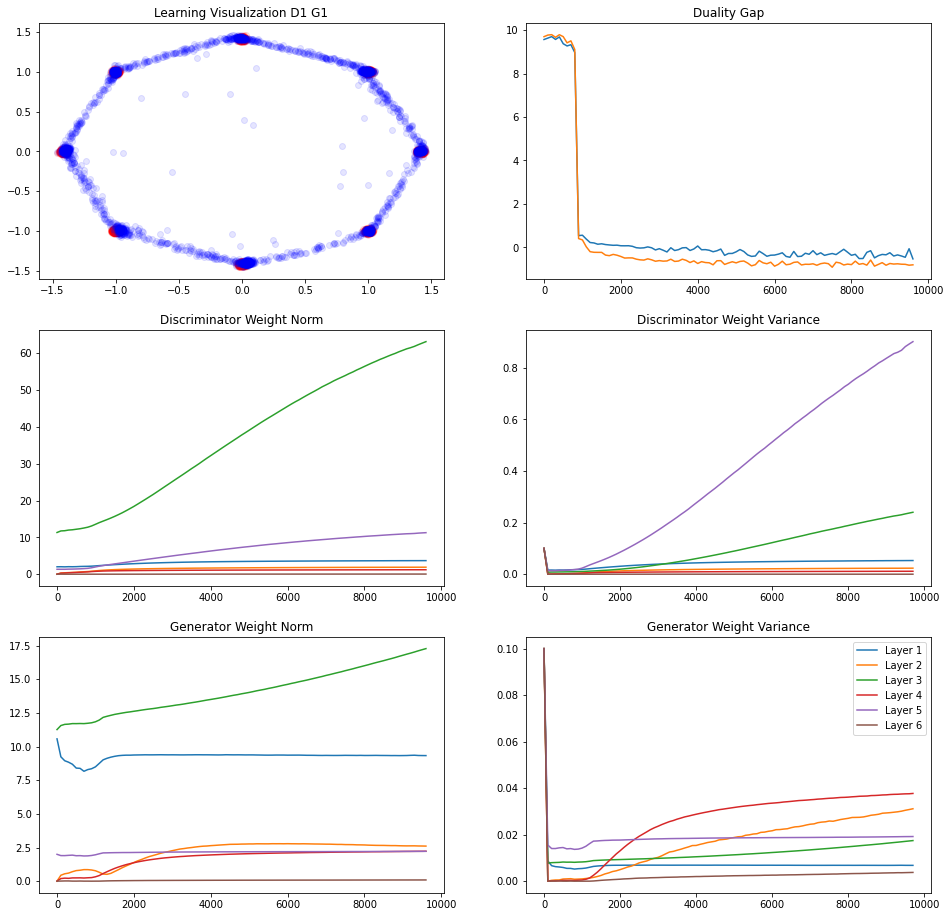

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.30655915
L Random  Duality Gap :  -0.79605794


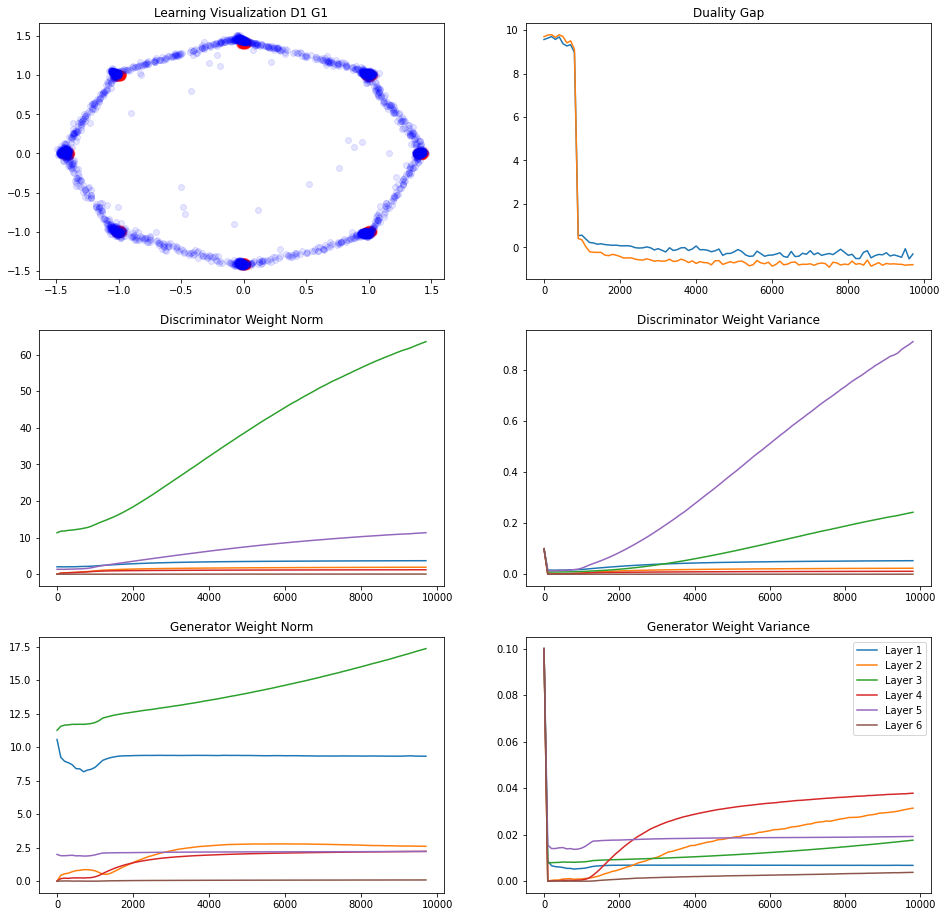

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.13777071
L Random  Duality Gap :  -0.7819854


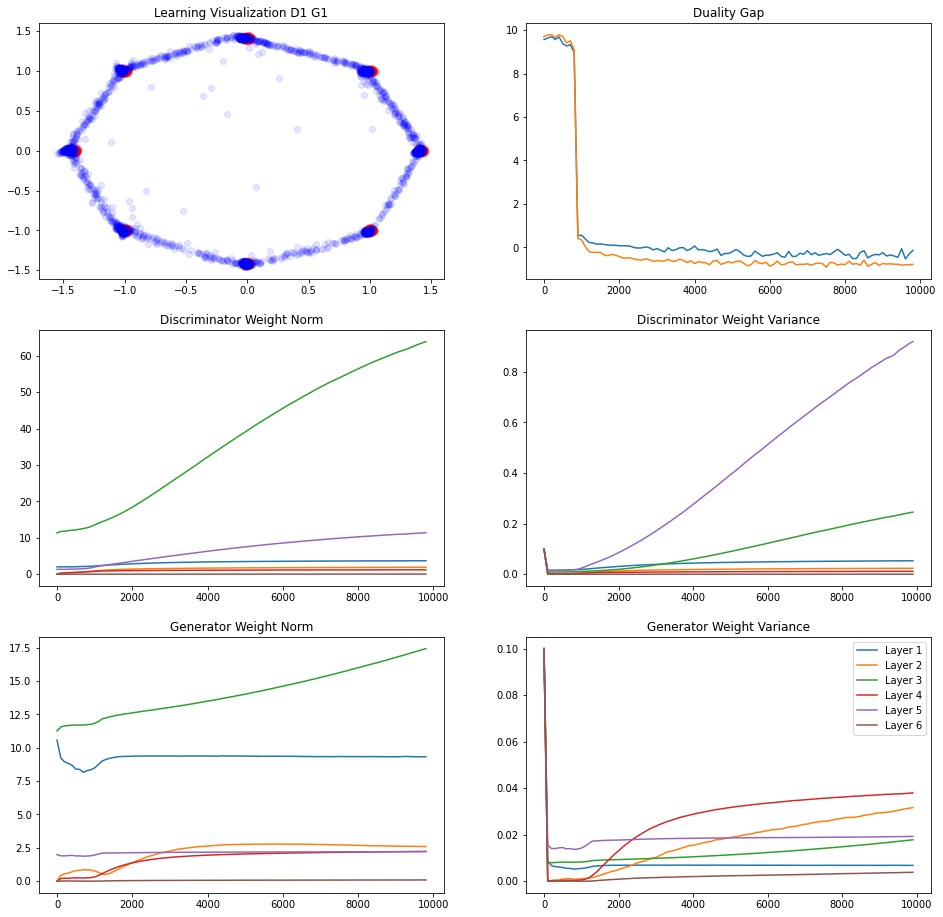

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.2537862
L Random  Duality Gap :  -0.7233958


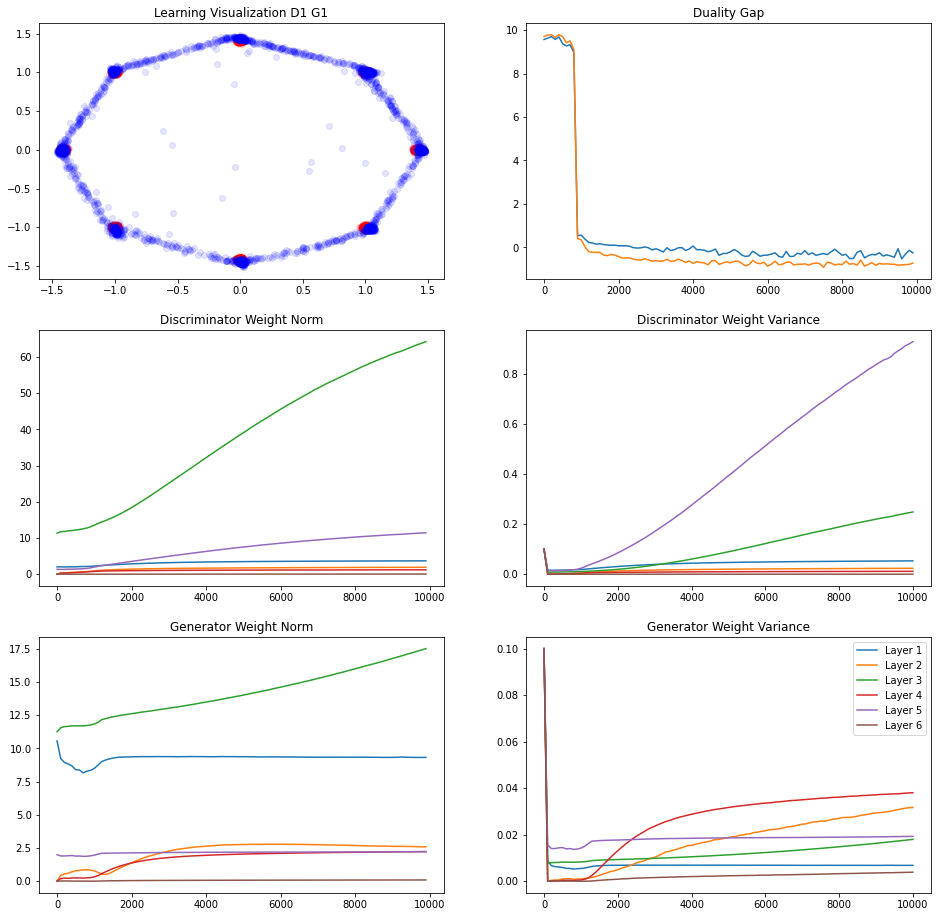

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  -0.043900967
L Random  Duality Gap :  -0.70522827
10000/10001 [============================>.] - ETA: 0s ----------------------------------------------------------------------------------------------------
		8_modes DCGAN divergence
----------------------------------------------------------------------------------------------------
./Experiments/8_modes/DCGAN/divergence
8_modes divergence
1 1
 M1 - Random : False
249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  9.895796
L Random  Duality Gap :  9.892711
249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.3827742
L Random  Duality Gap :  8.634559


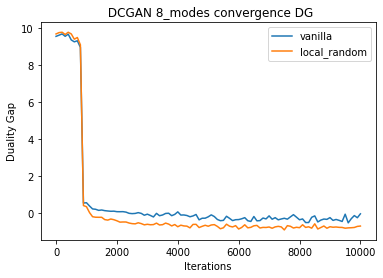

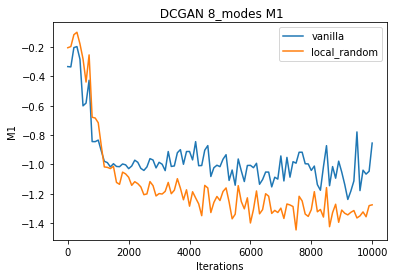

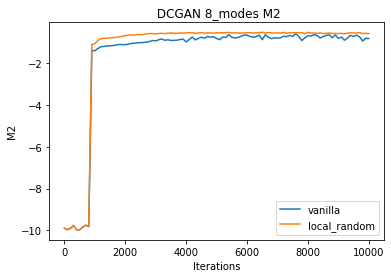

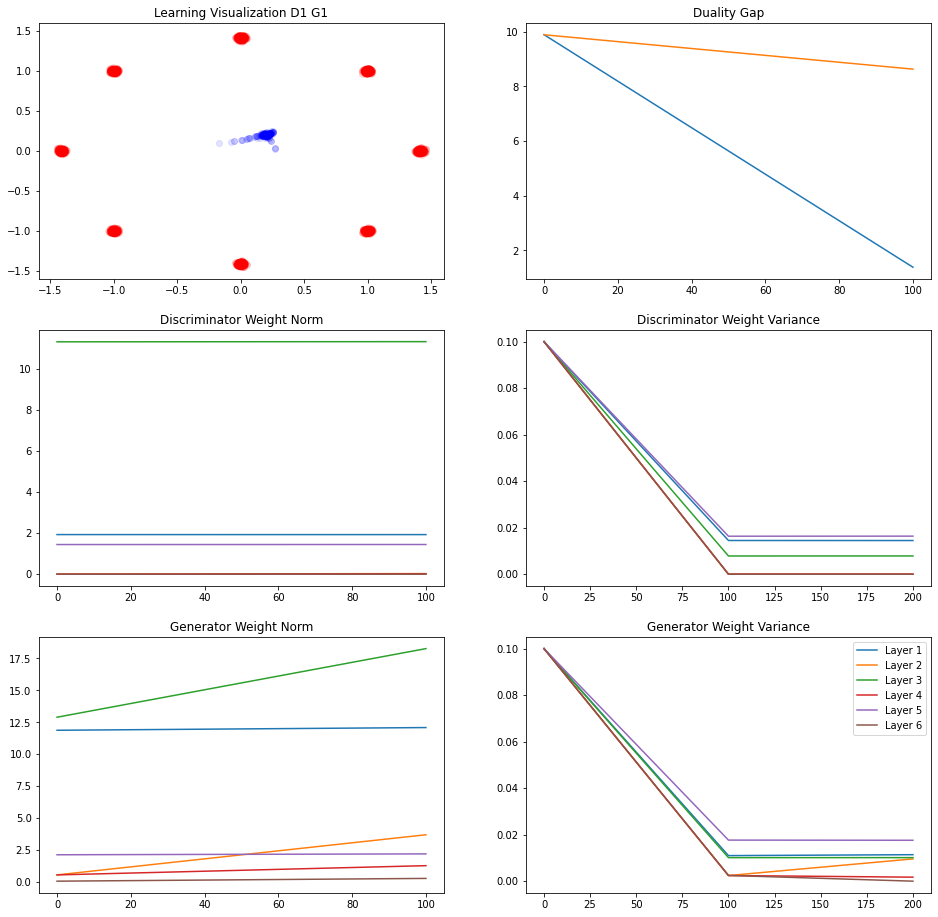

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.3247473
L Random  Duality Gap :  0.7609641


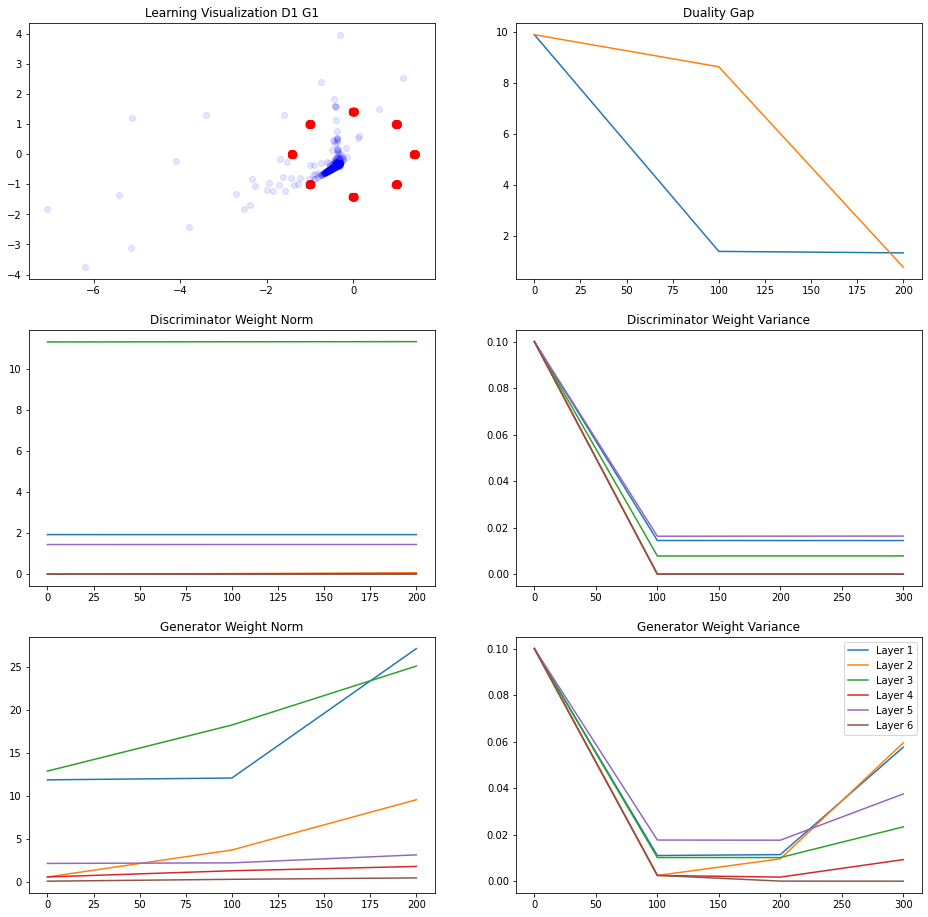

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.3677881
L Random  Duality Gap :  1.0958918


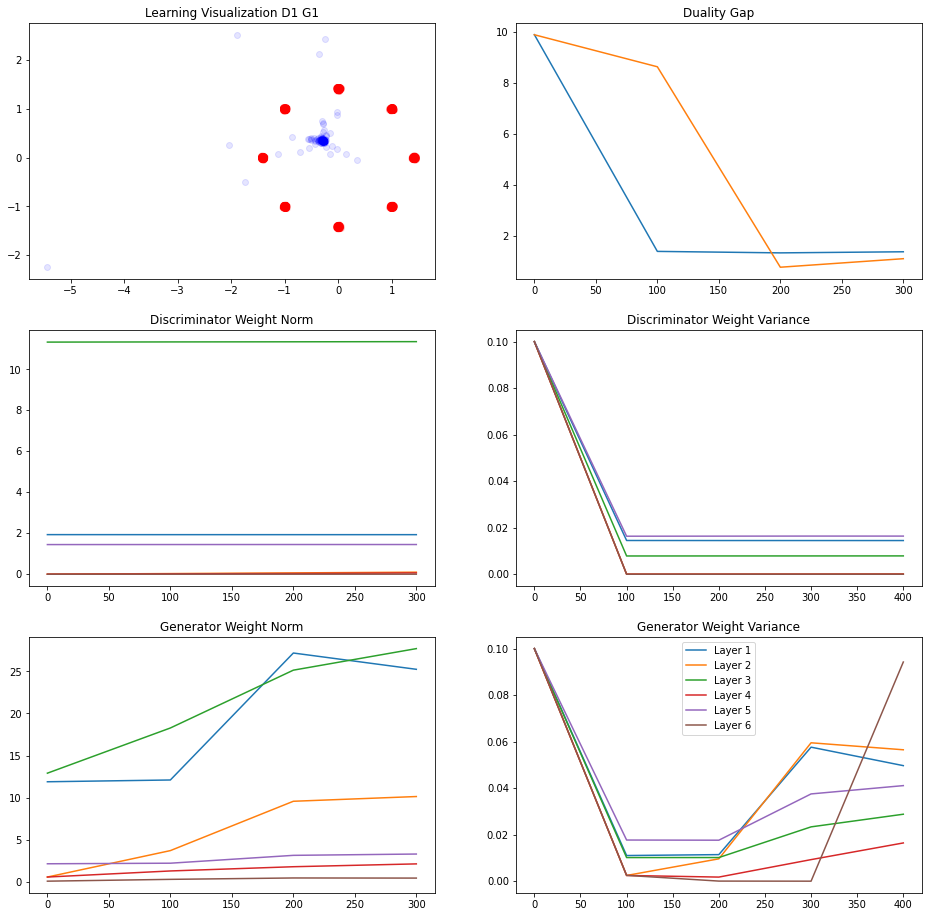

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.3586406
L Random  Duality Gap :  0.8686678


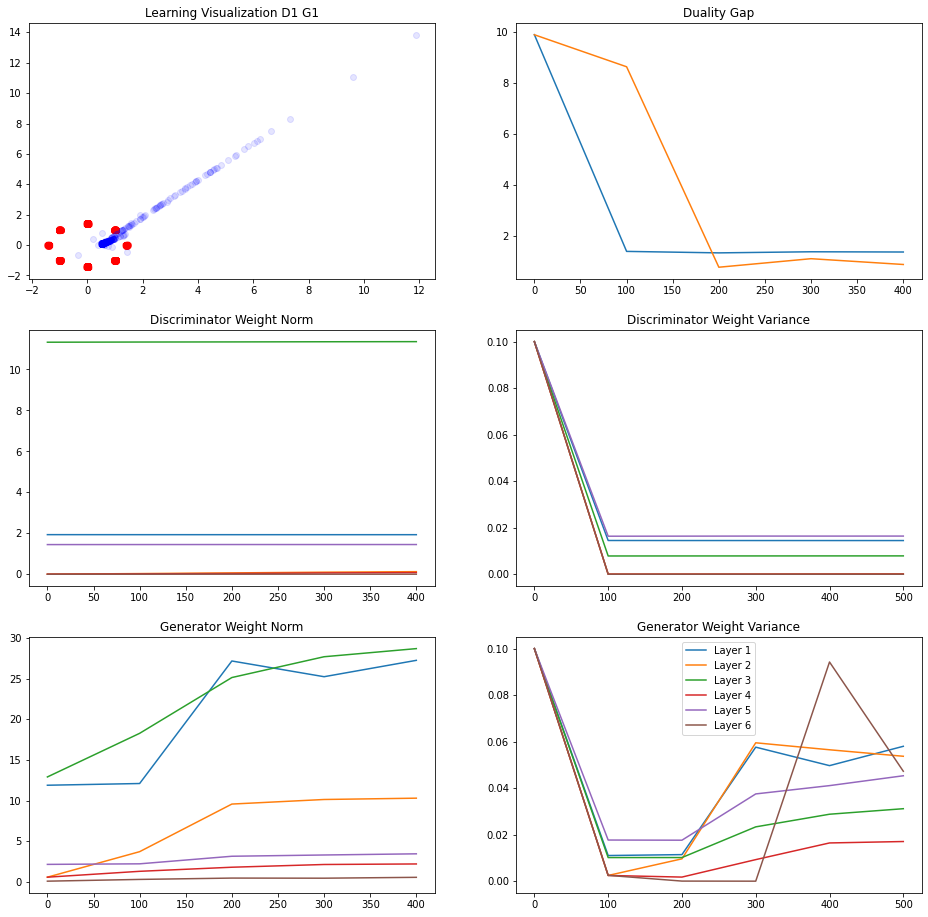

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.1048863
L Random  Duality Gap :  0.9472208
243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.041473
L Random  Duality Gap :  0.8479128


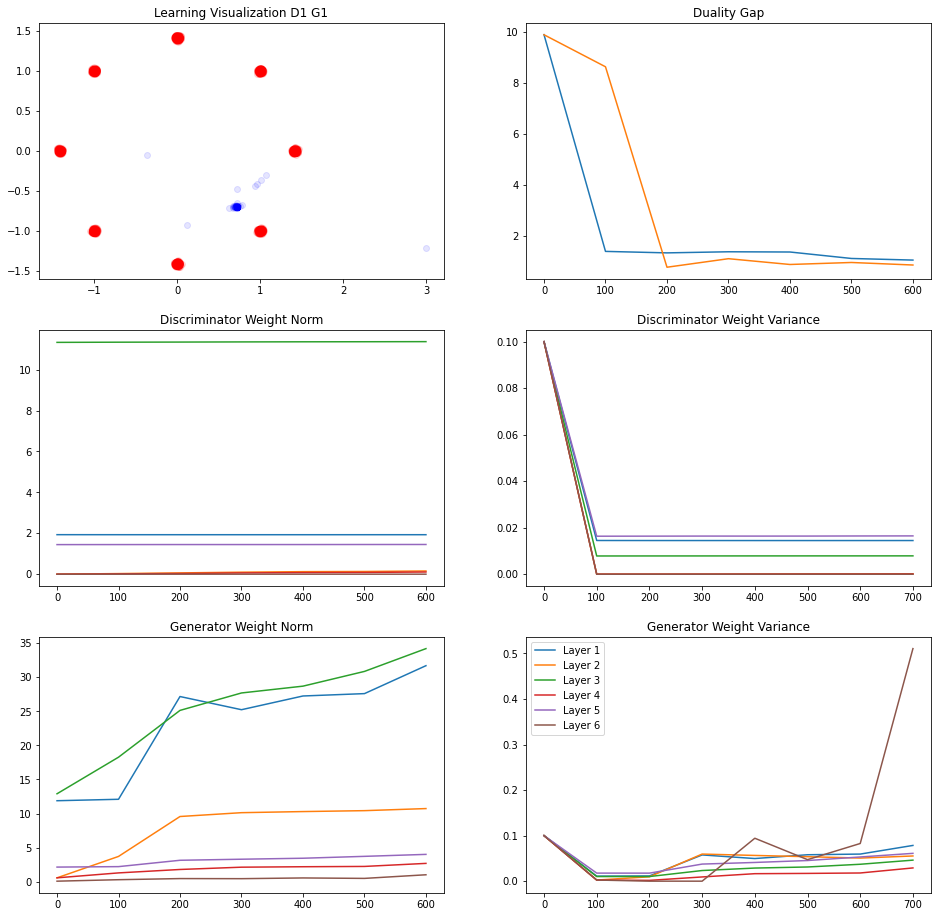

240/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  1.2333529
L Random  Duality Gap :  9.506175


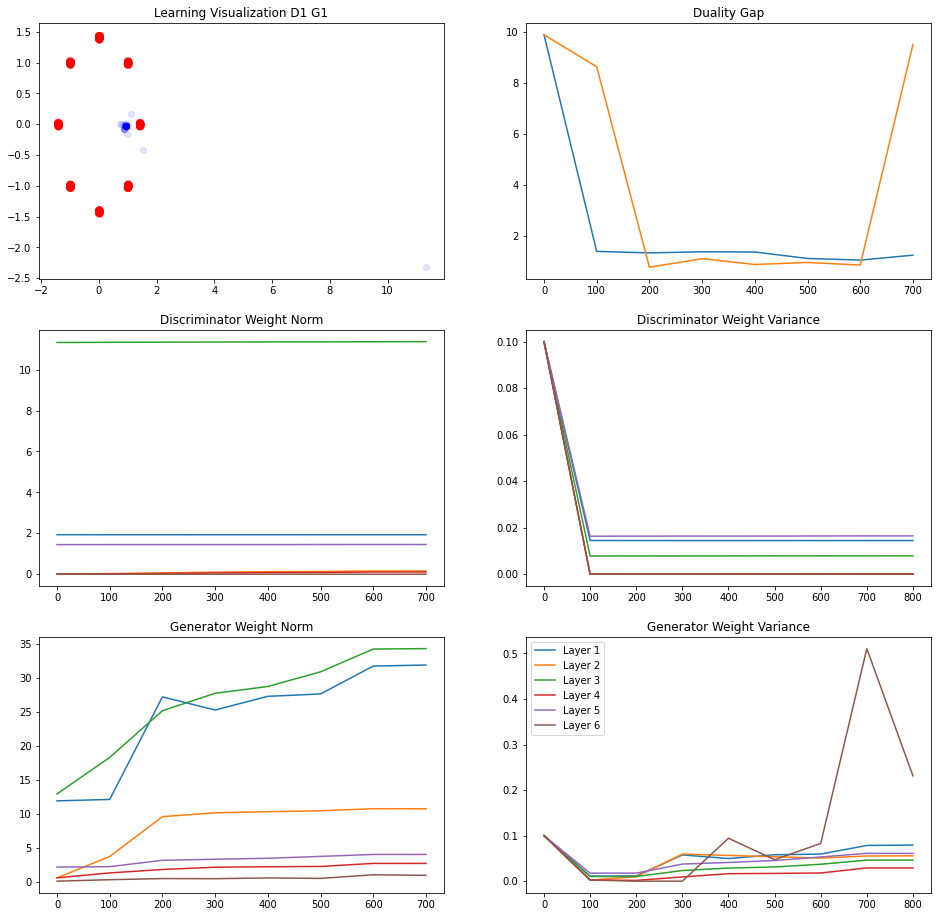

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.2698861
L Random  Duality Gap :  0.74048376


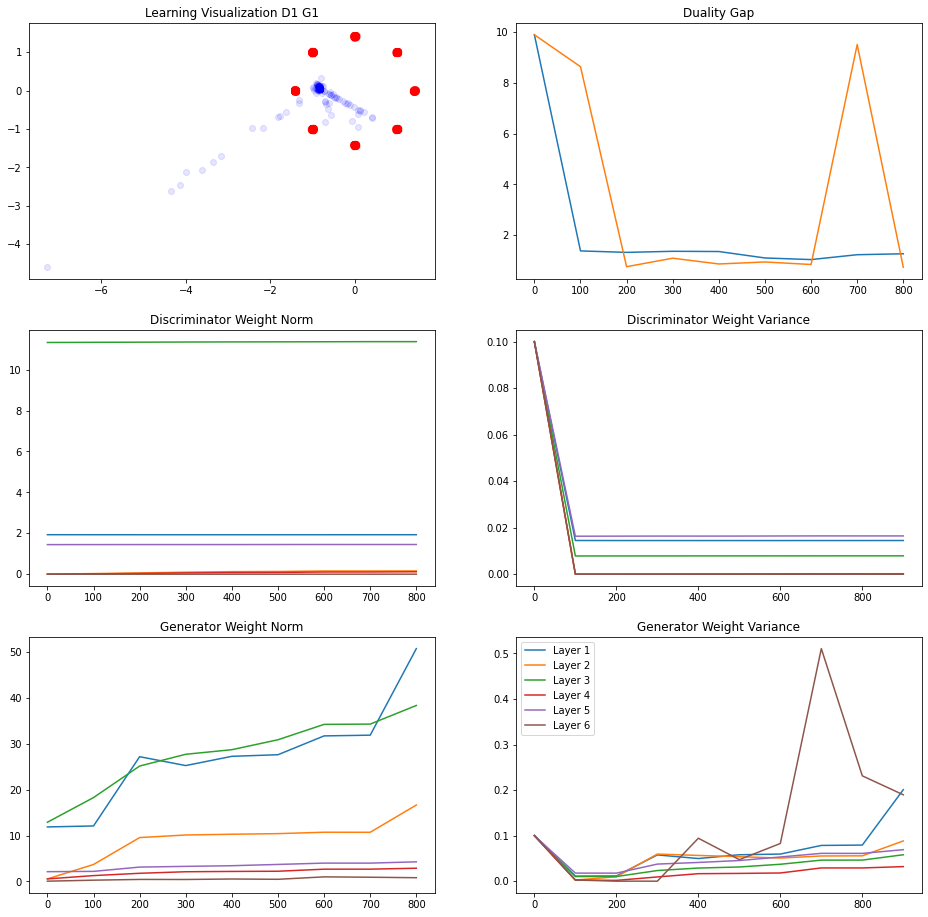

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.5609053
L Random  Duality Gap :  9.812397


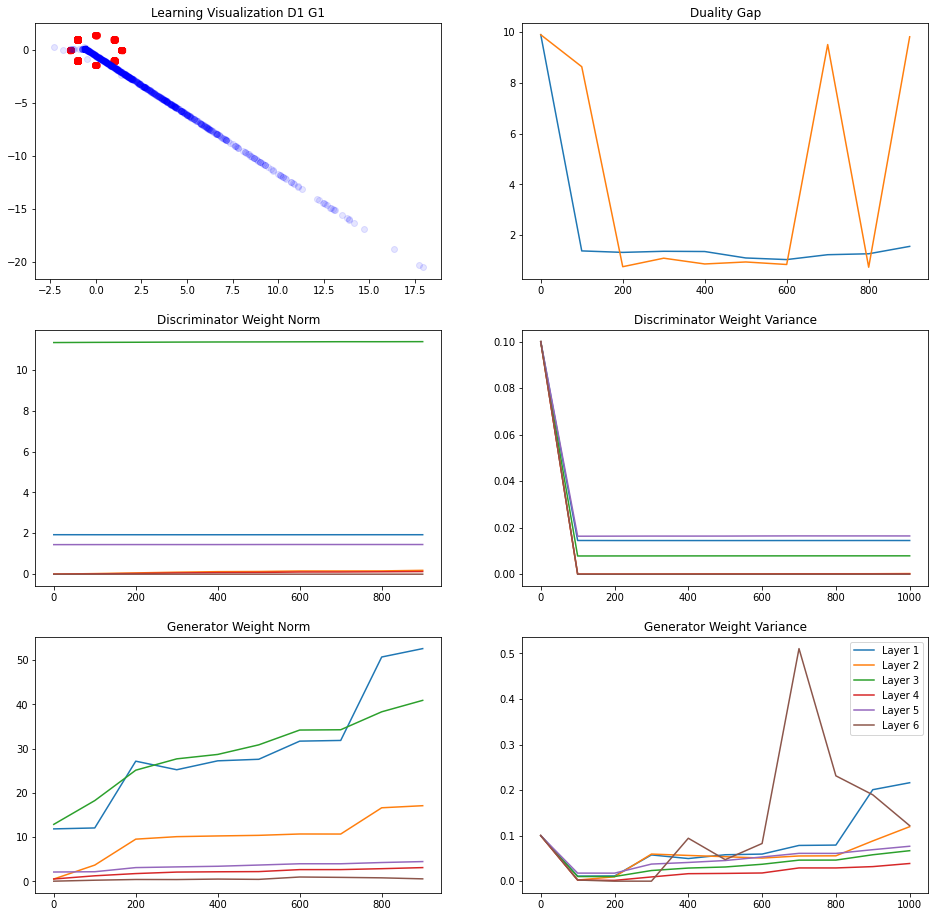

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.98751986
L Random  Duality Gap :  0.71827334
239/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  1.3788686
L Random  Duality Gap :  0.7612449


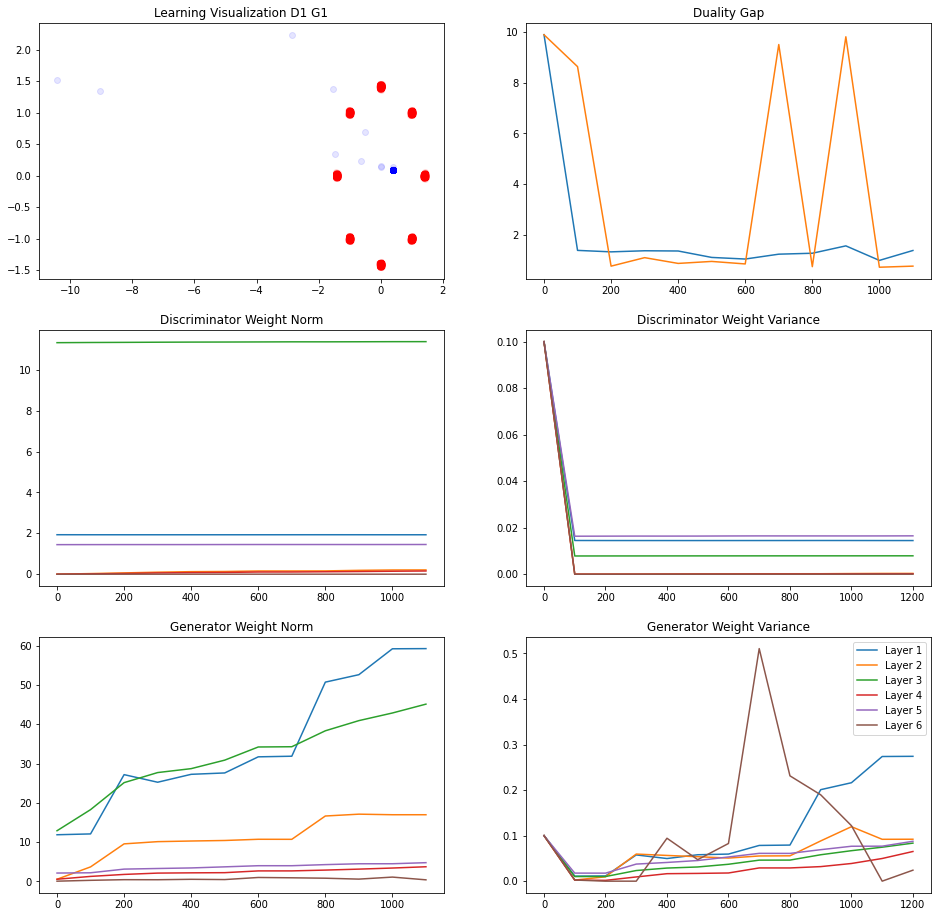

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.3527815
L Random  Duality Gap :  0.9400146


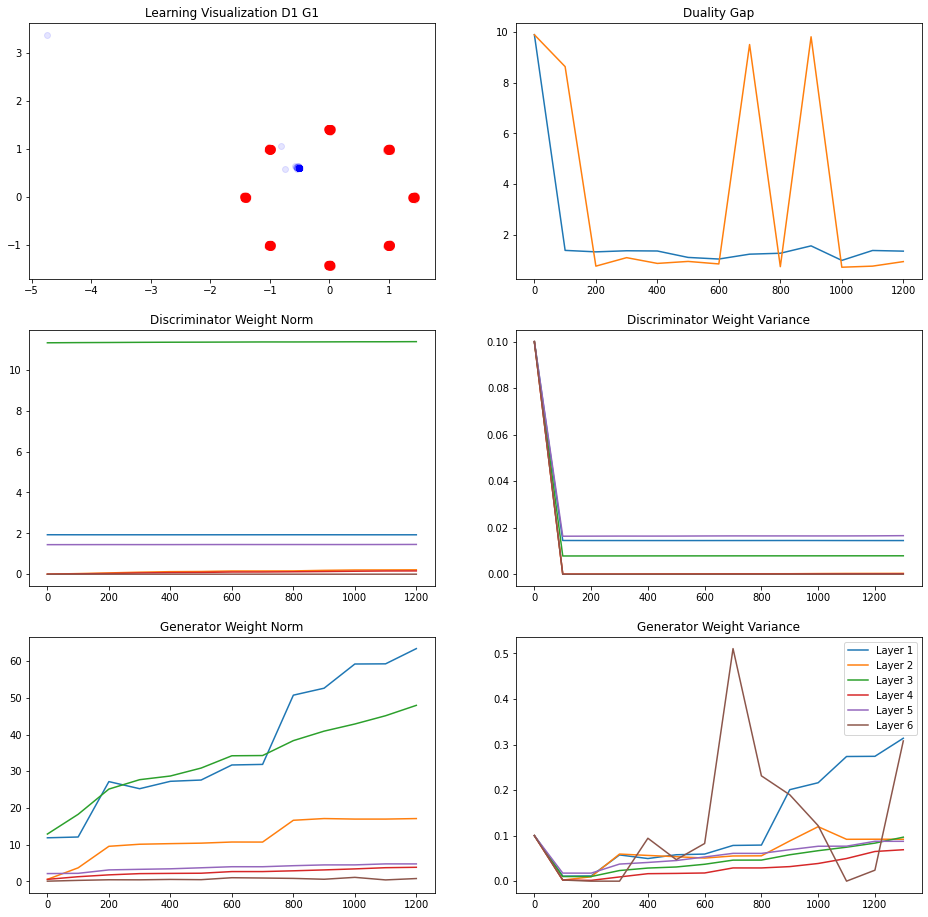

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.3766131
L Random  Duality Gap :  0.72714317


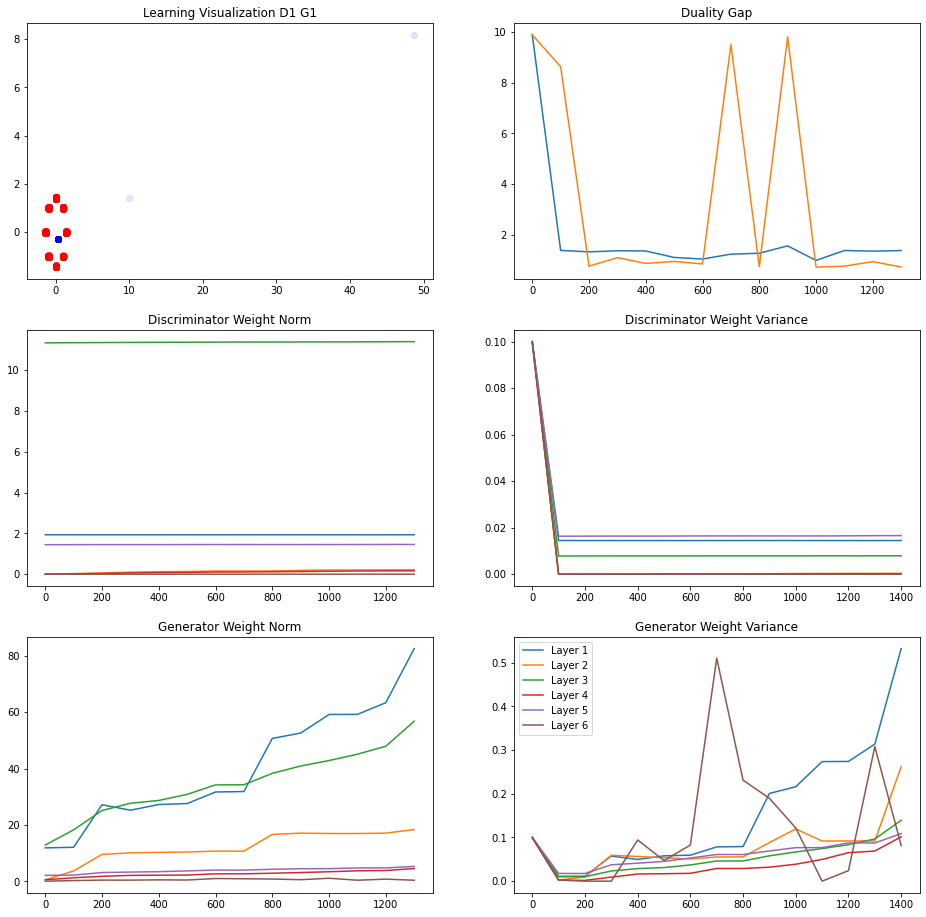

242/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.109233
L Random  Duality Gap :  9.857249


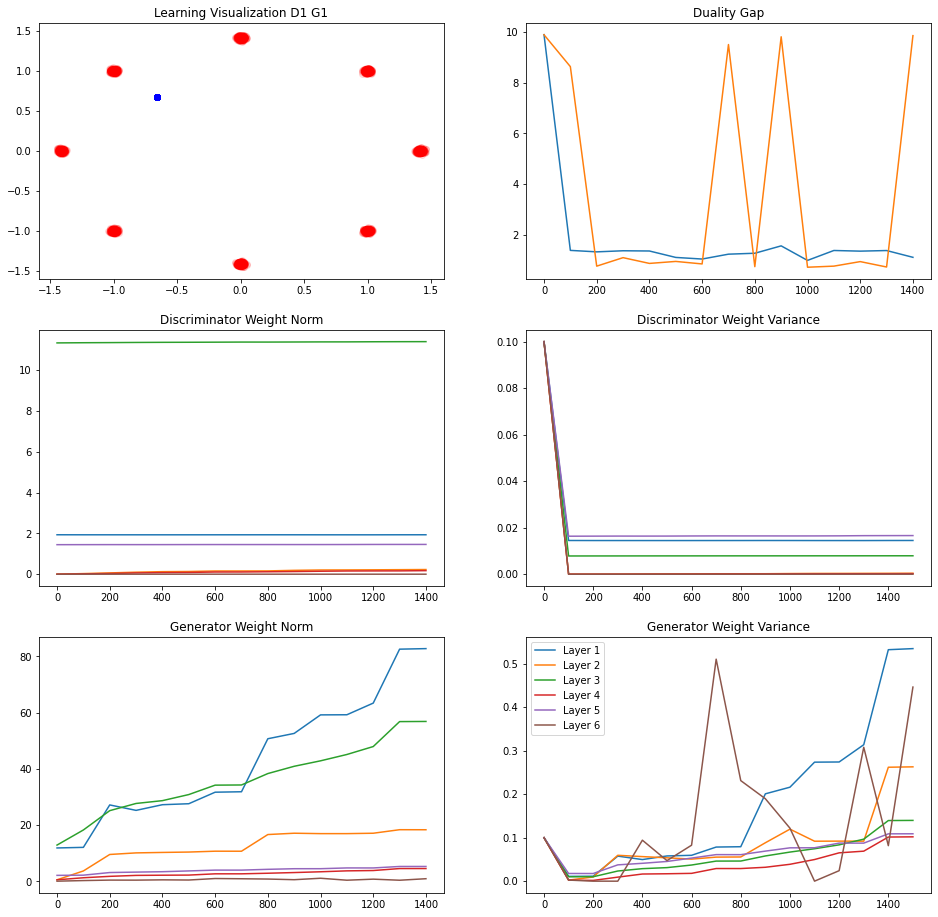

240/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  1.3849283
L Random  Duality Gap :  0.9378764
244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.3815794
L Random  Duality Gap :  9.824358


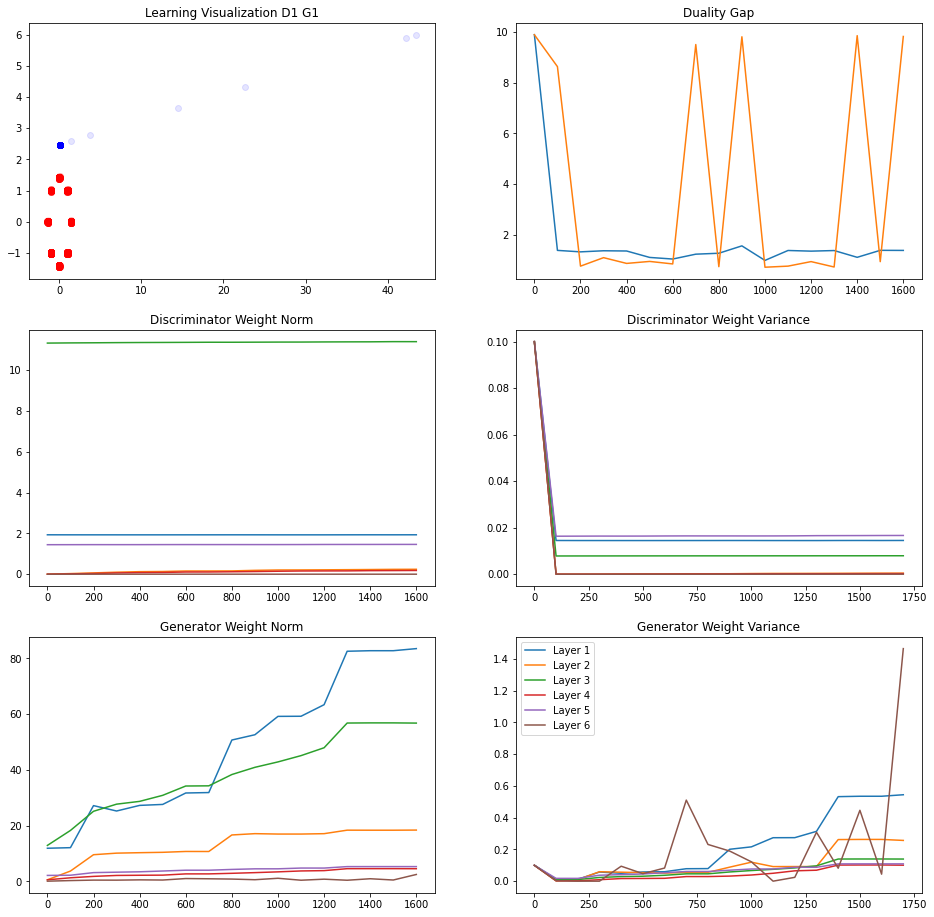

245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.2753837
L Random  Duality Gap :  0.82301736


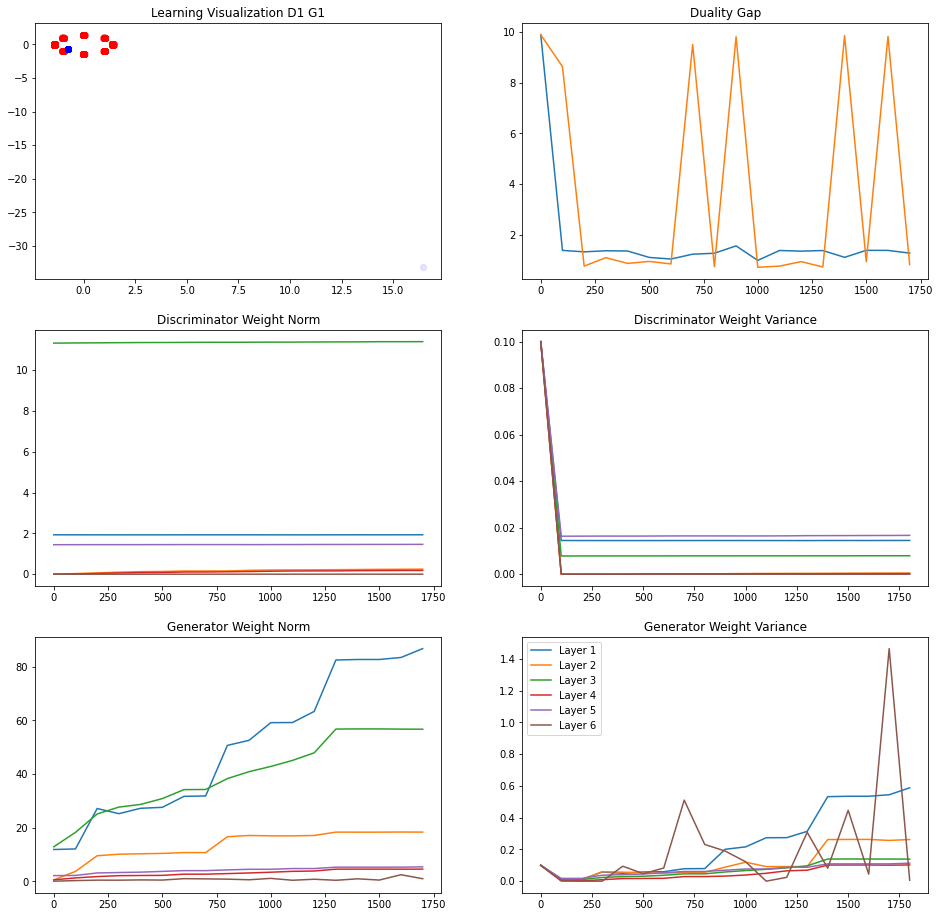

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.3106314
L Random  Duality Gap :  9.861887


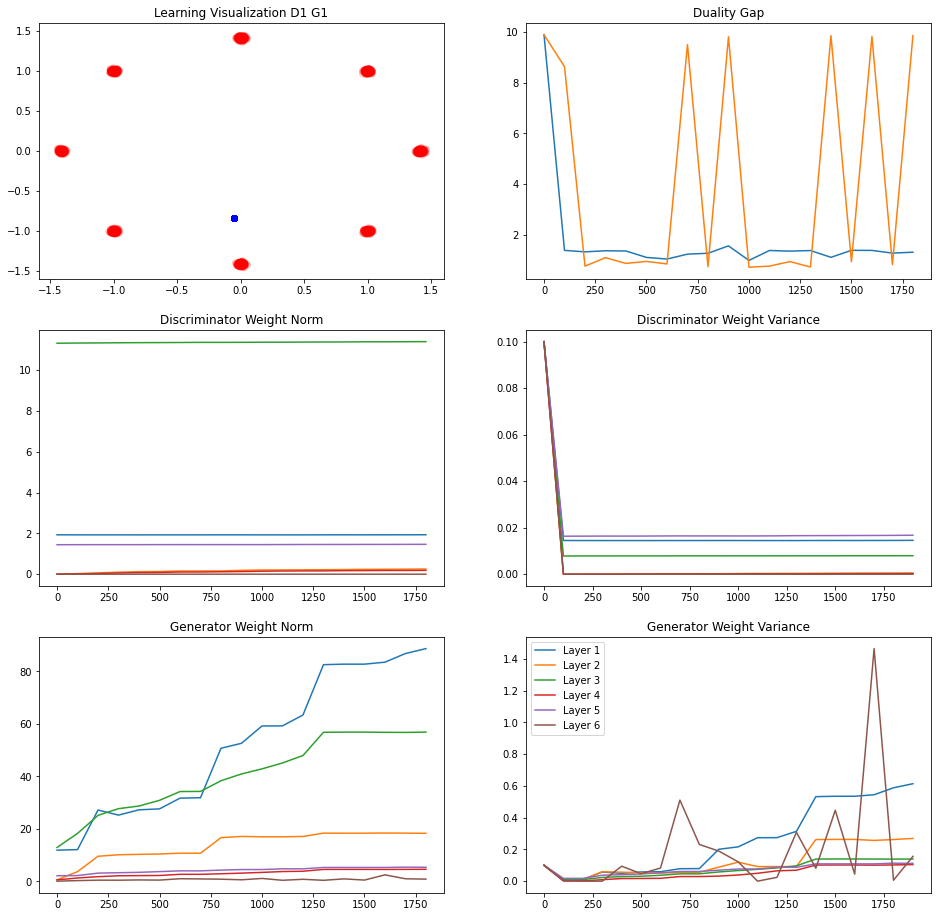

244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.28076
L Random  Duality Gap :  9.808496


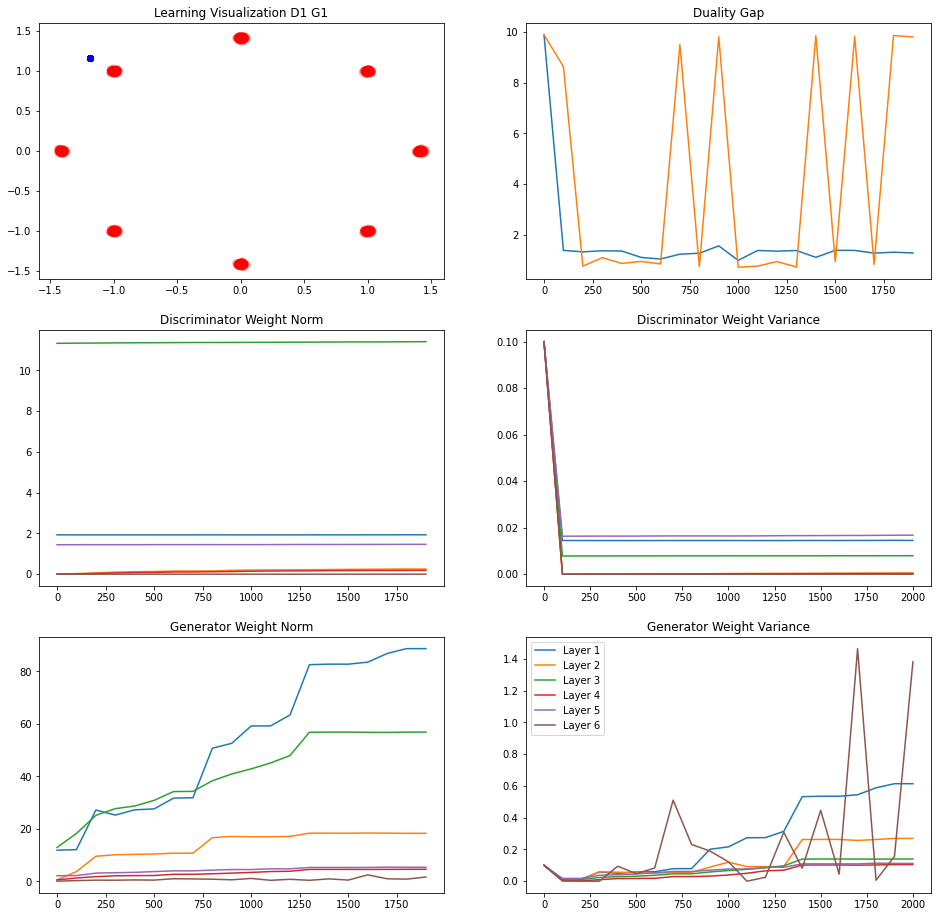

240/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  1.372556
L Random  Duality Gap :  9.576755
243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.3957534
L Random  Duality Gap :  0.73255384


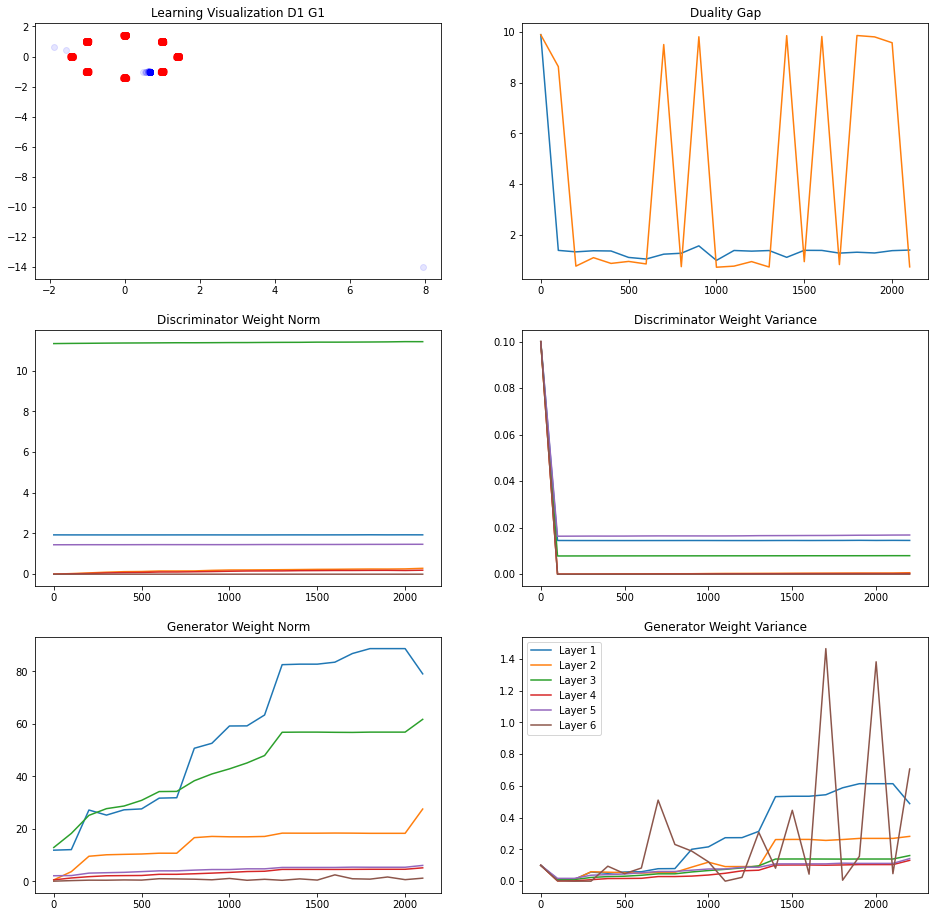

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.3387724
L Random  Duality Gap :  0.7364098


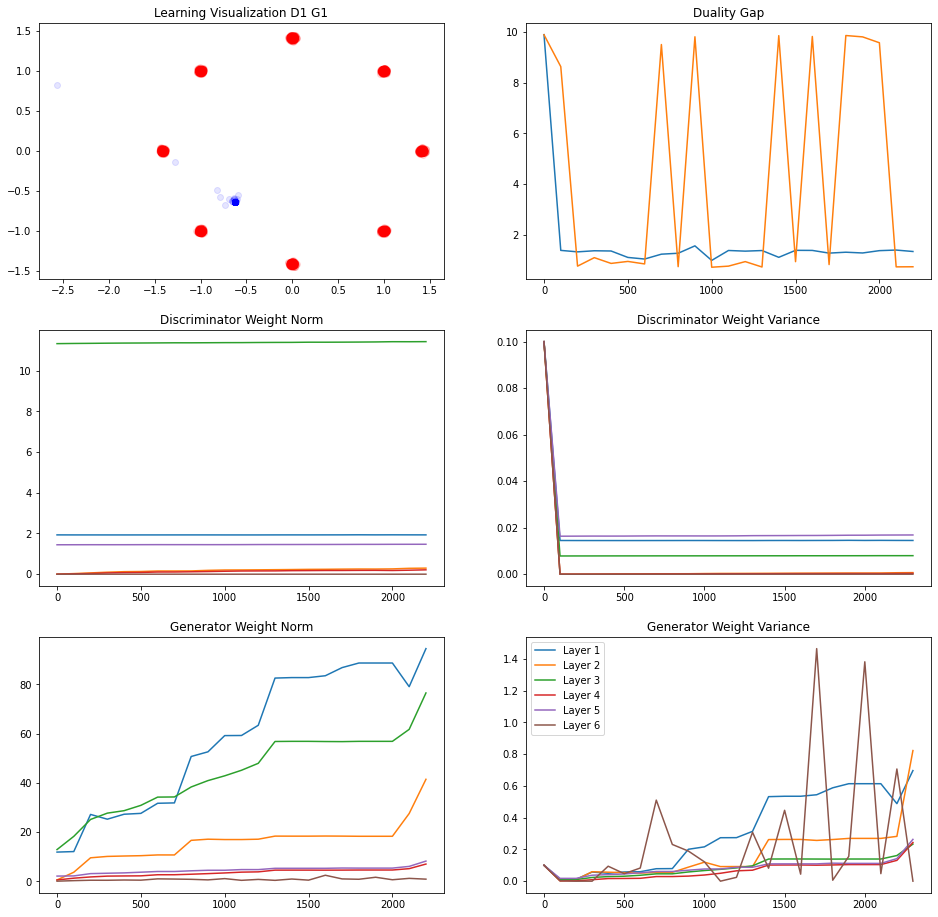

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.0490998
L Random  Duality Gap :  0.7273579


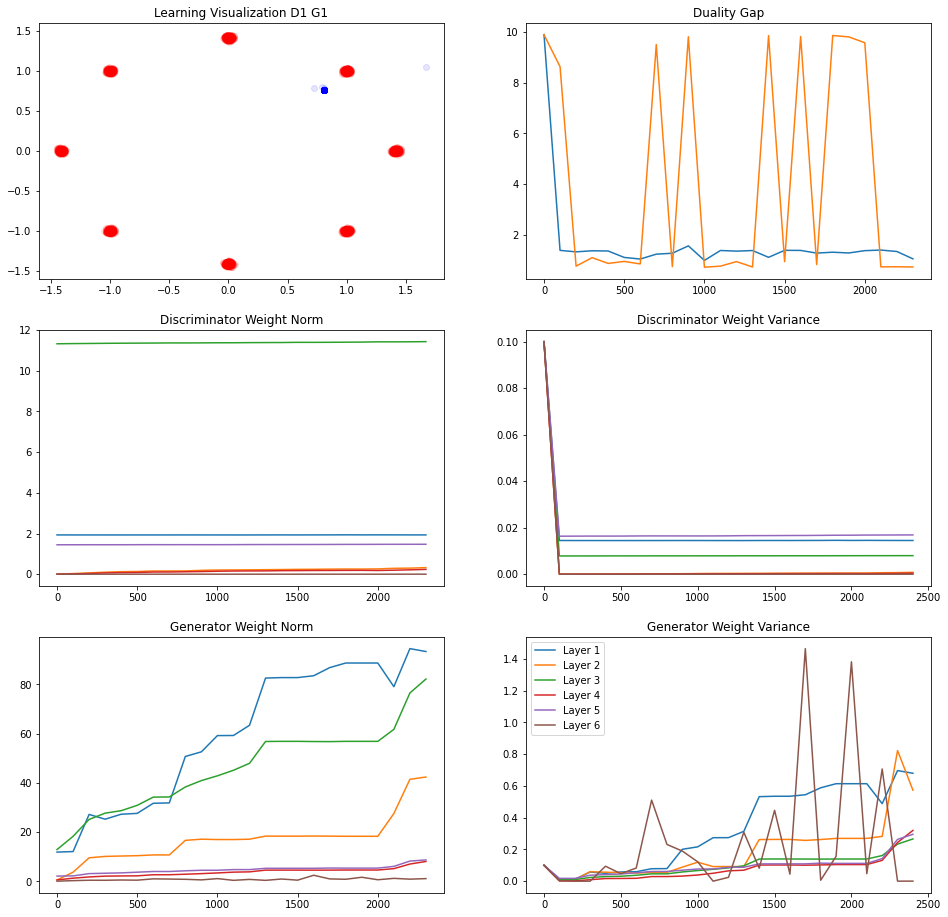

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.1528877
L Random  Duality Gap :  0.71915334


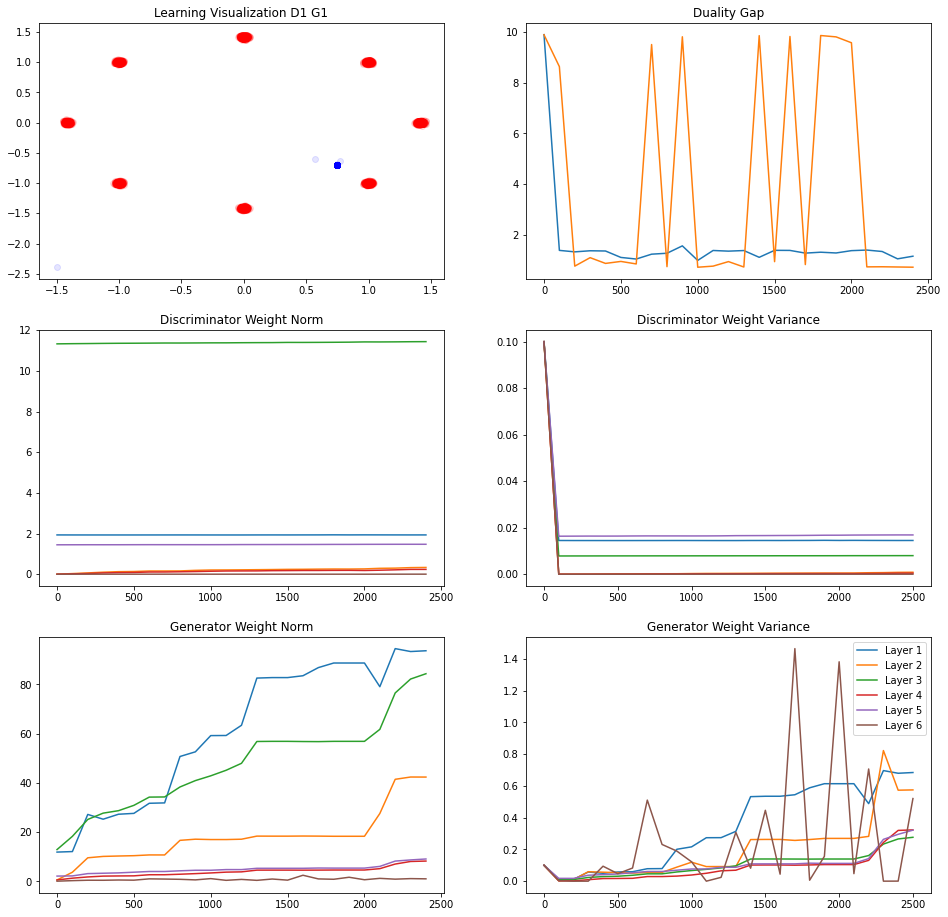

244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.4408216
L Random  Duality Gap :  9.720244
243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.39582
L Random  Duality Gap :  9.214841


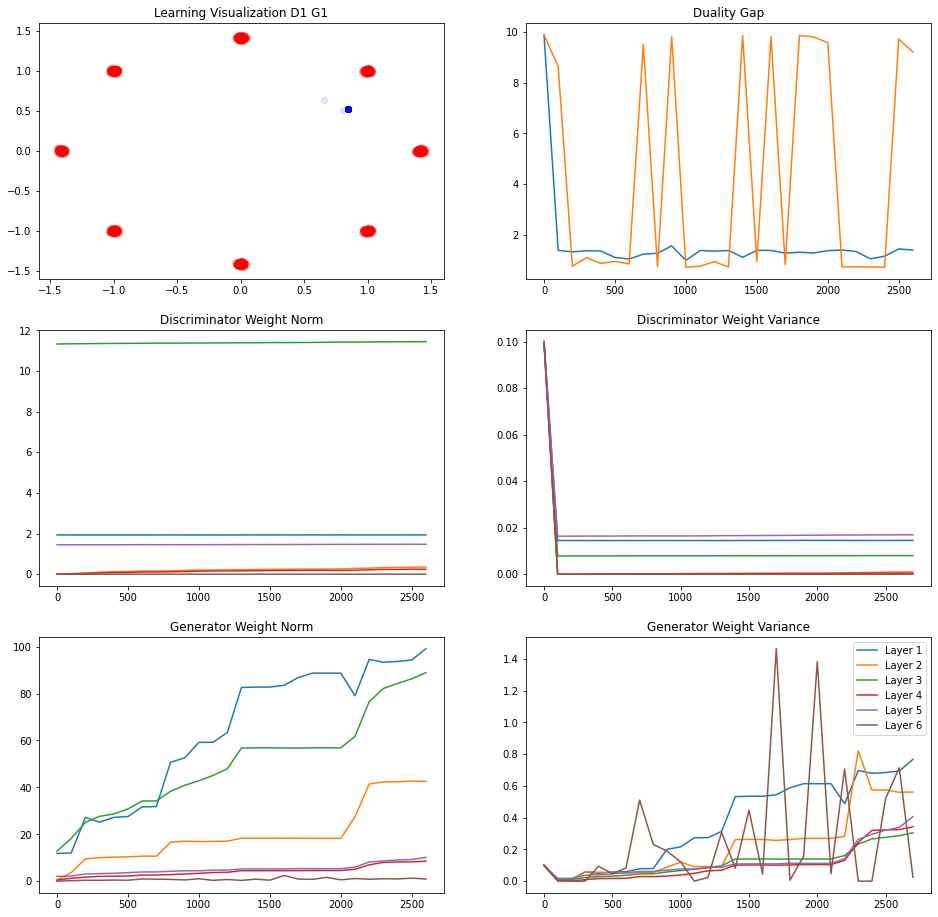

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.0611583
L Random  Duality Gap :  -0.43900436


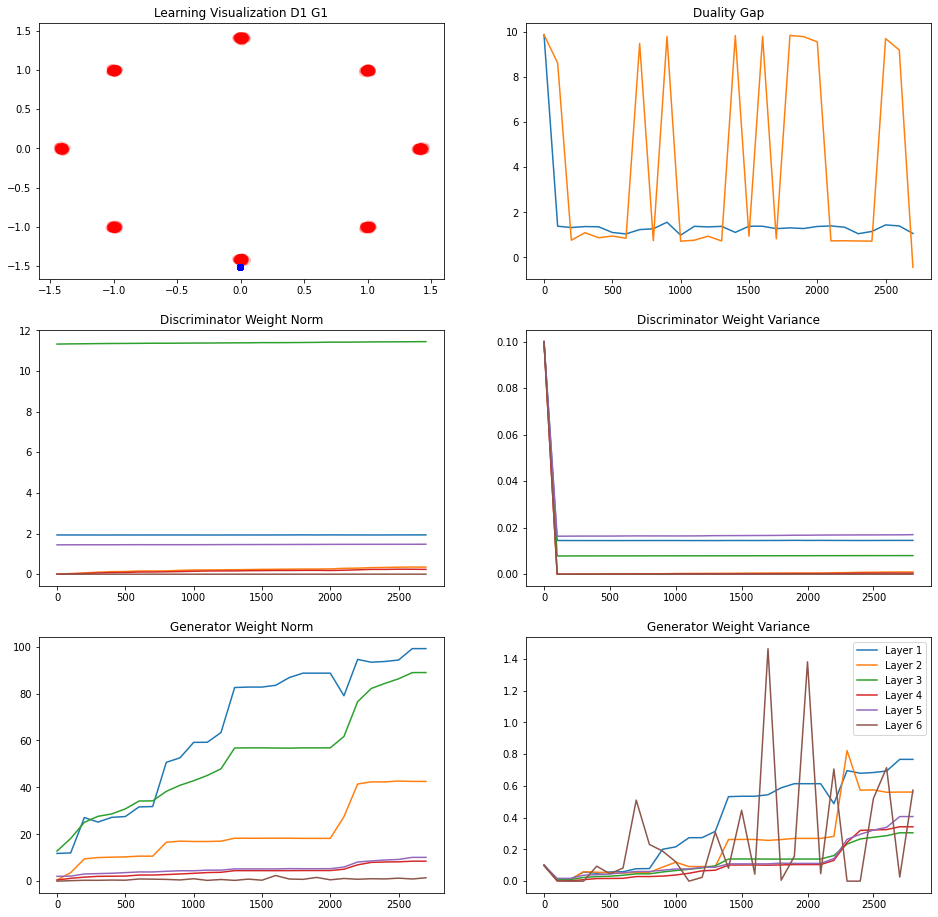

241/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  1.3256904
L Random  Duality Gap :  1.3913727


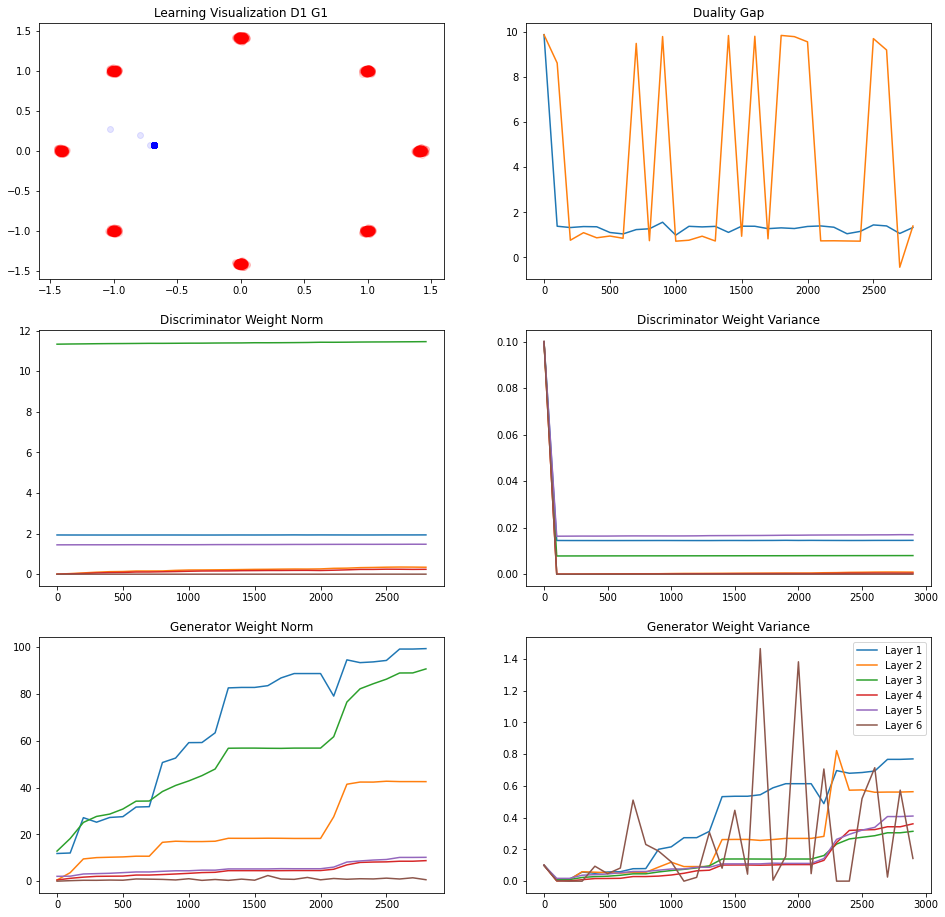

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.3524588
L Random  Duality Gap :  9.767028


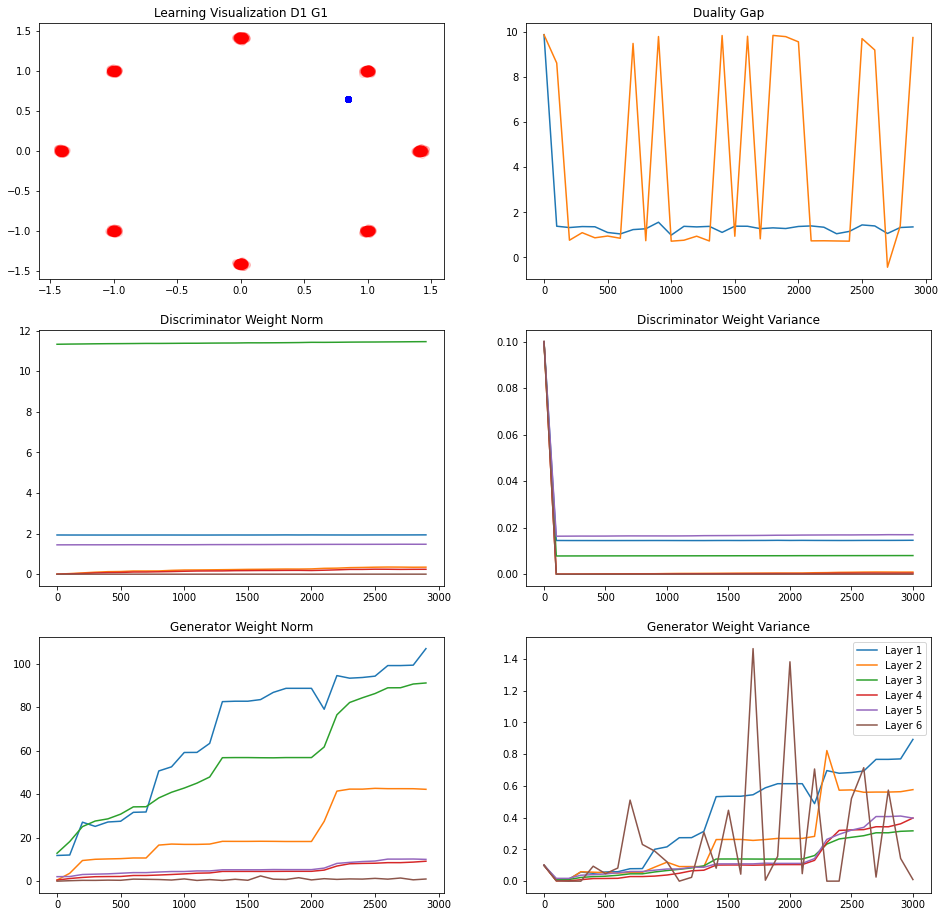

242/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.3144561
L Random  Duality Gap :  8.650196
249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.3072553
L Random  Duality Gap :  9.749955


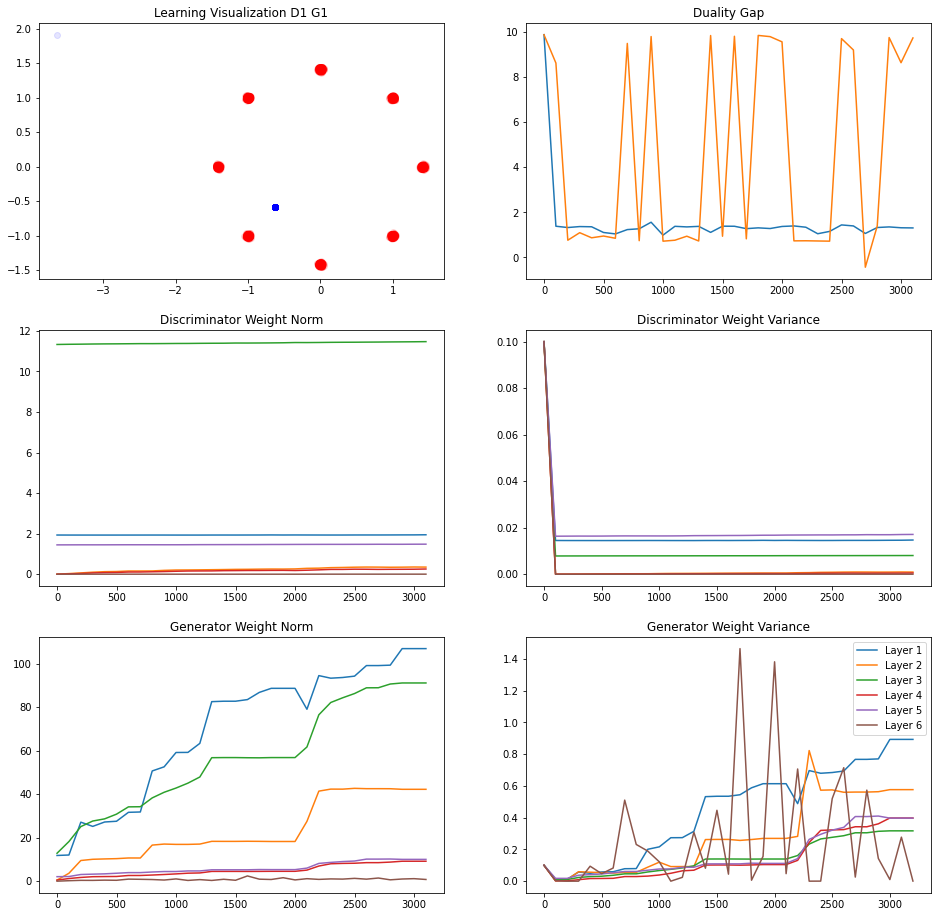

242/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.9539814
L Random  Duality Gap :  8.615876


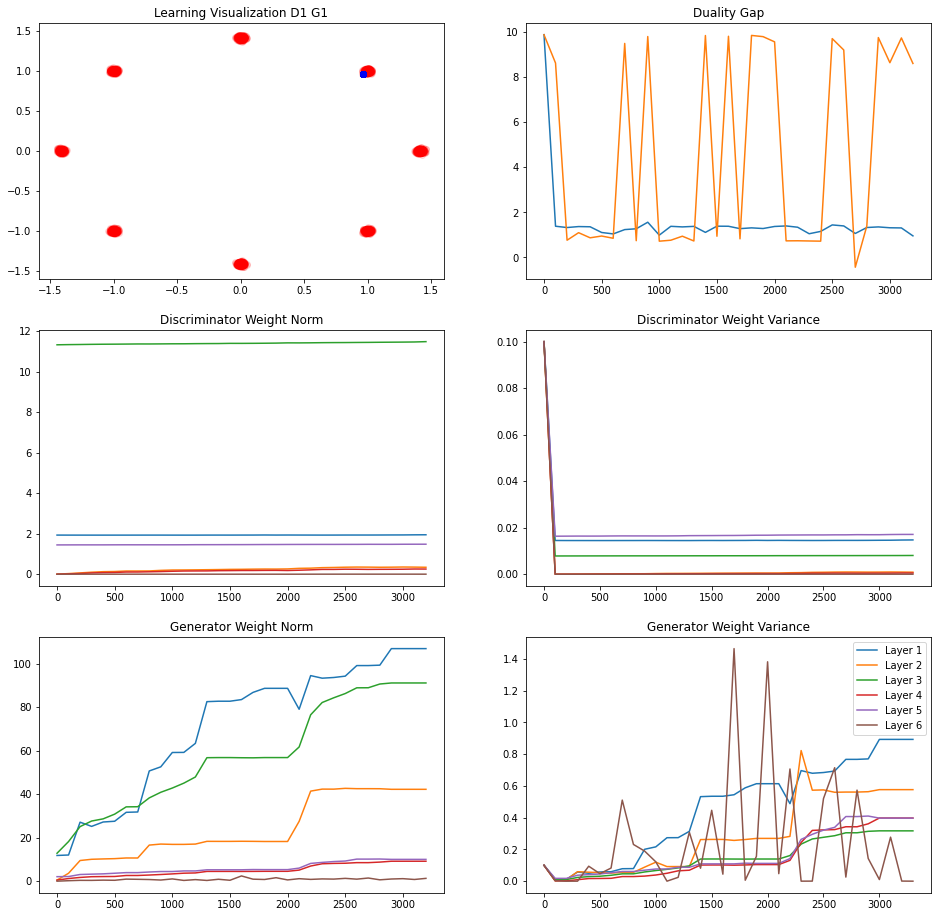

244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.3890738
L Random  Duality Gap :  9.78479


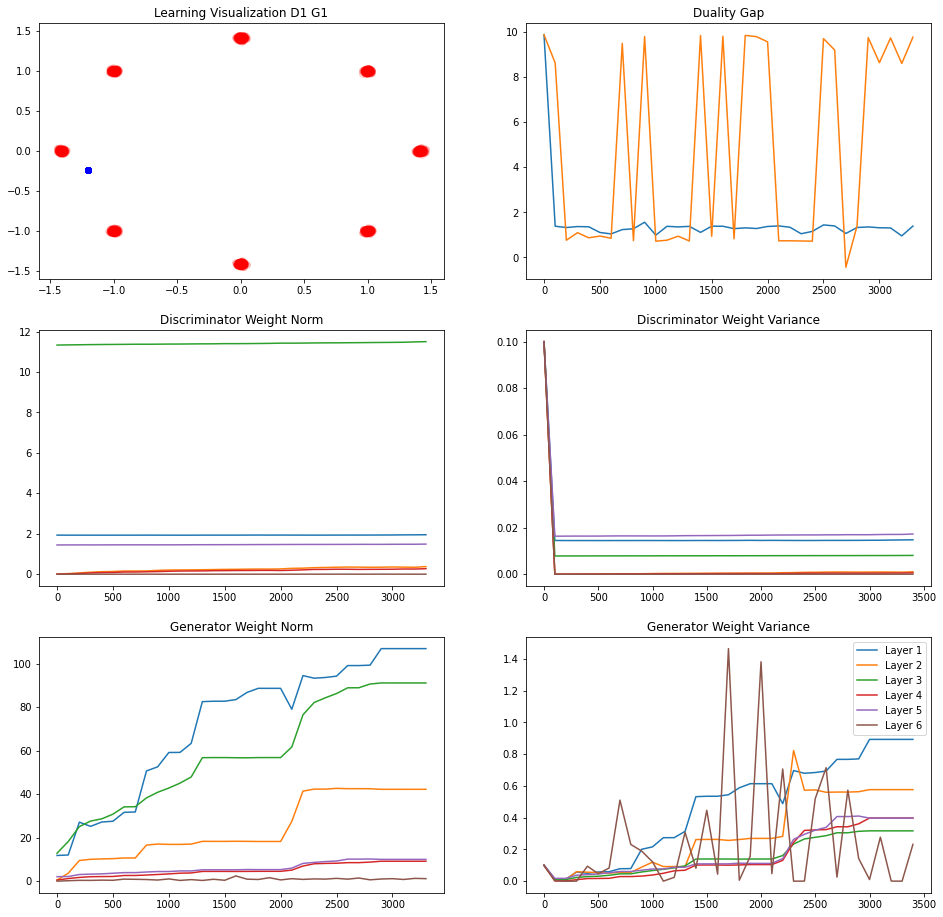

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.369794
L Random  Duality Gap :  0.7411236


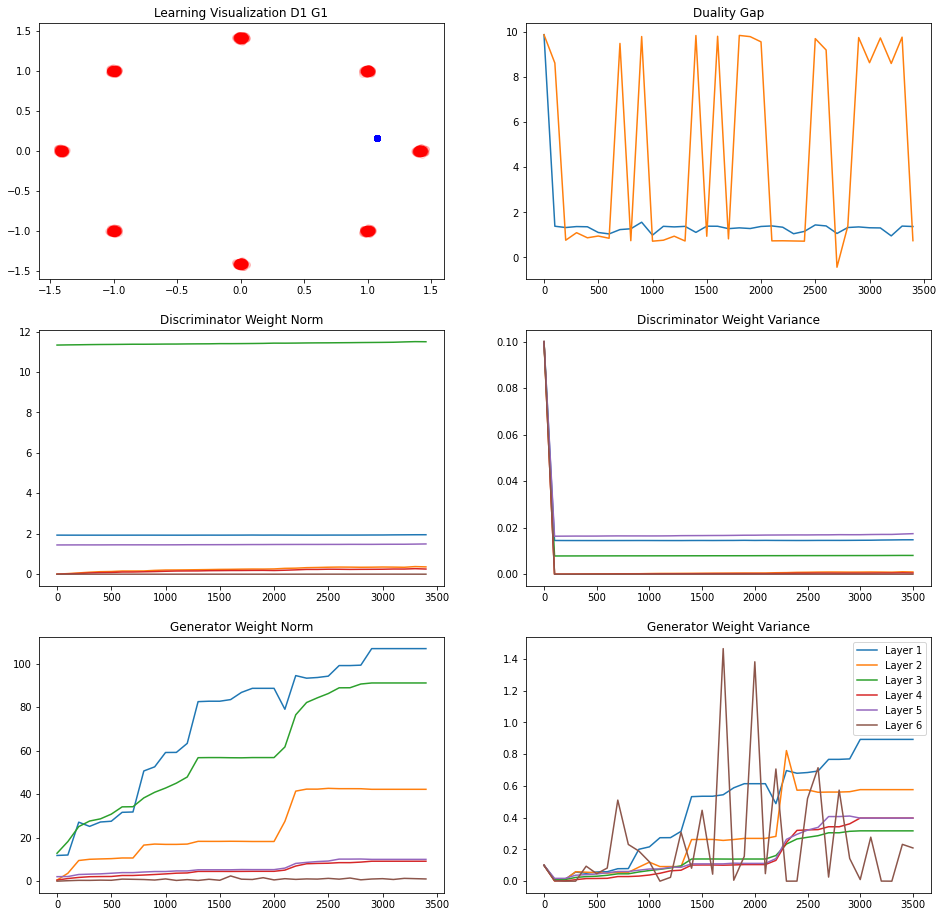

242/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.3452405
L Random  Duality Gap :  9.495217
245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.3590481
L Random  Duality Gap :  9.792339


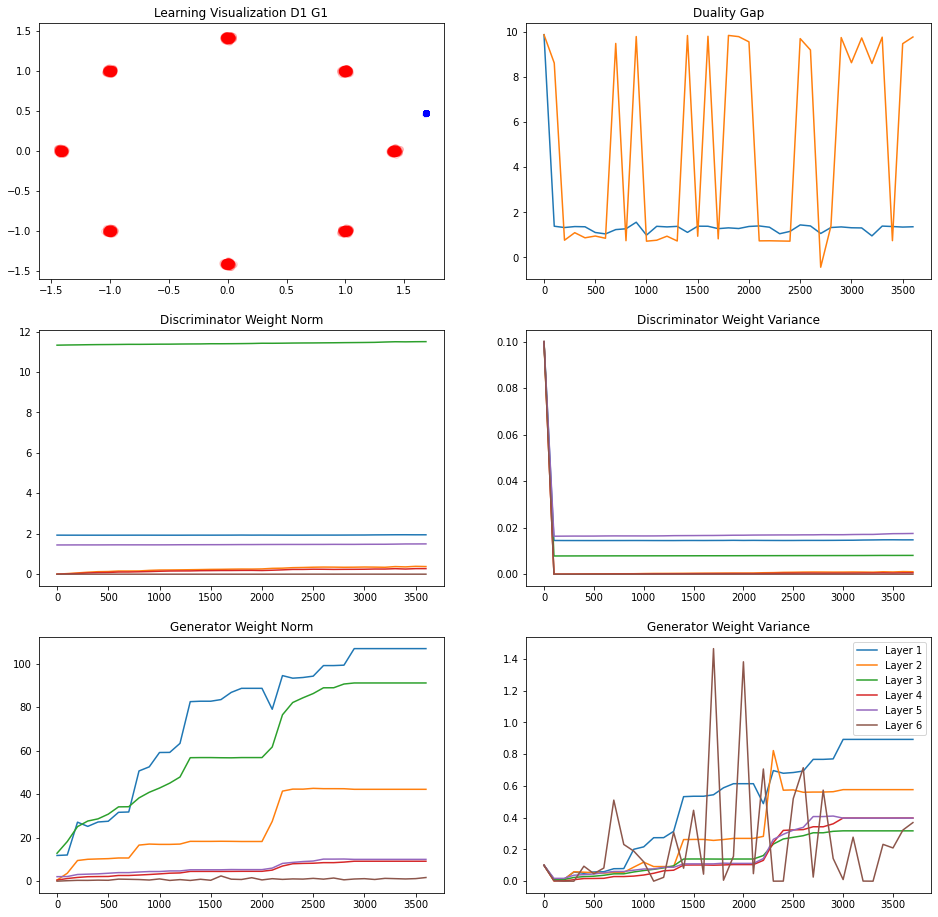

244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.3971896
L Random  Duality Gap :  9.789783


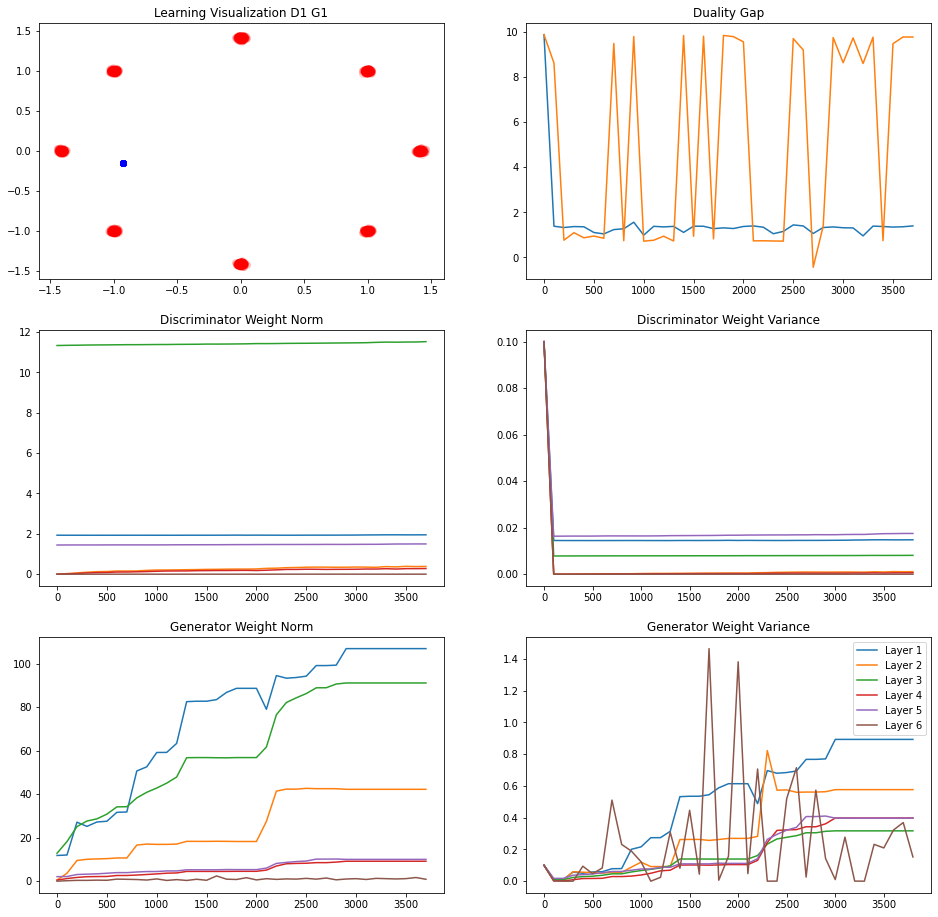

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.3137689
L Random  Duality Gap :  9.776602


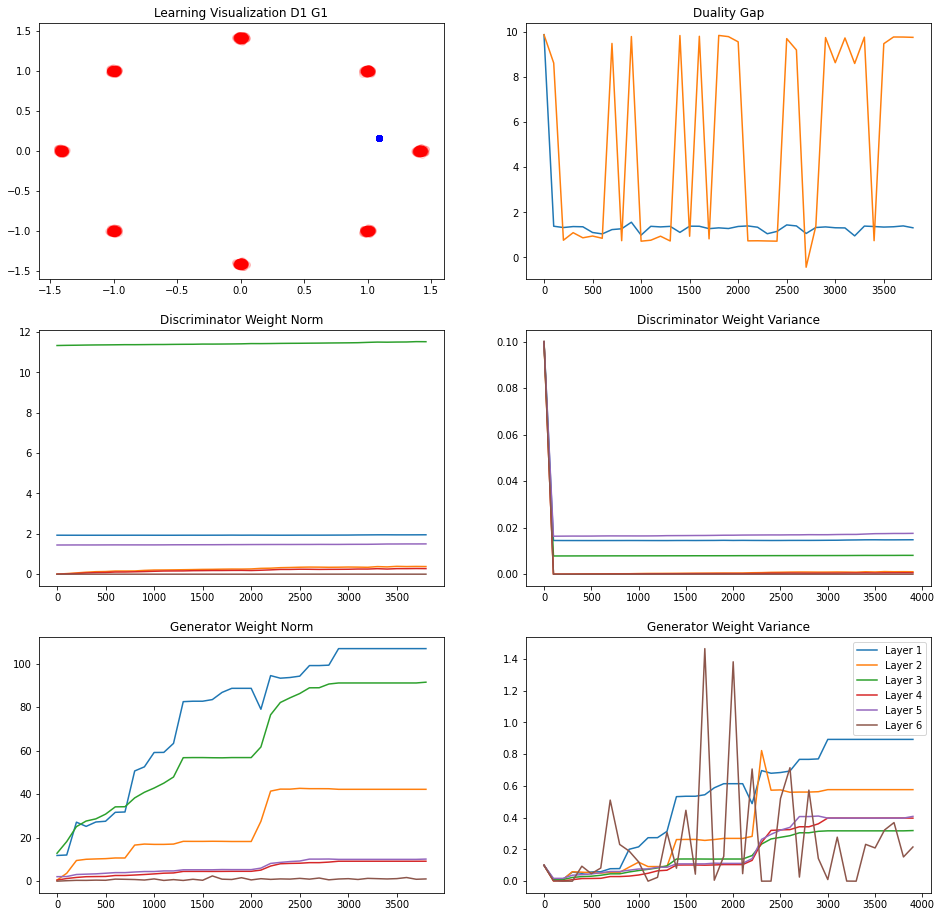

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.187843
L Random  Duality Gap :  -1.2667618


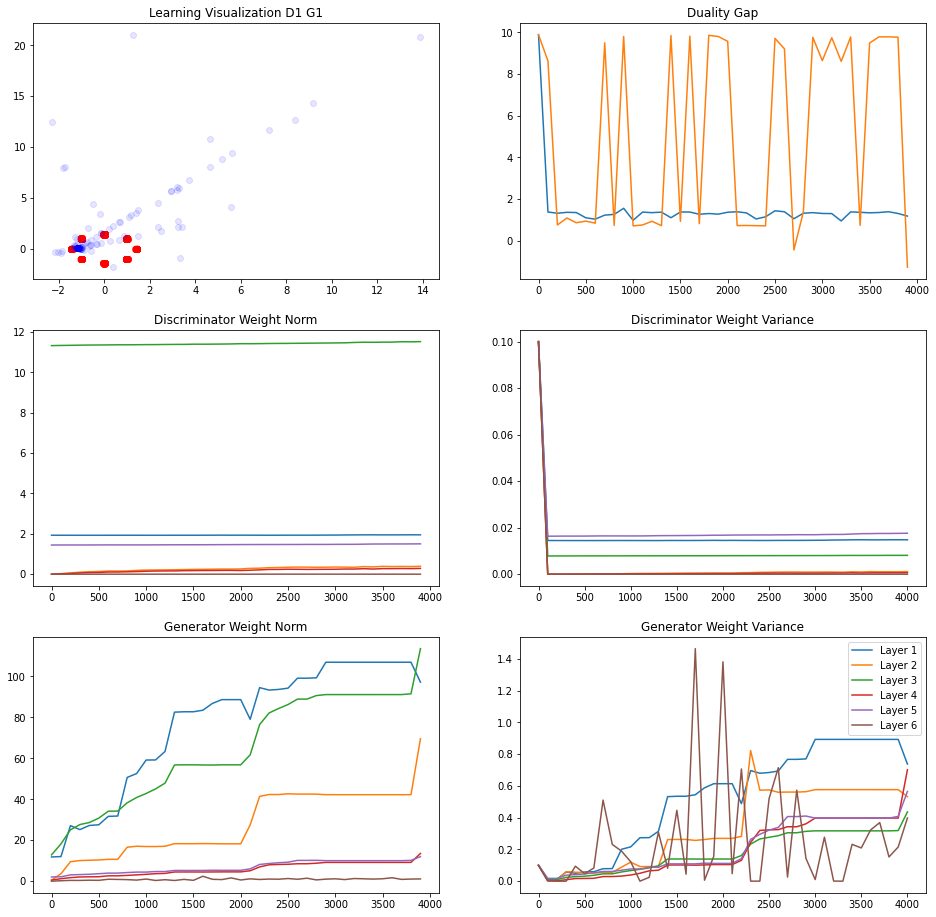

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.0326567
L Random  Duality Gap :  0.72064
245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.068379
L Random  Duality Gap :  0.73420215


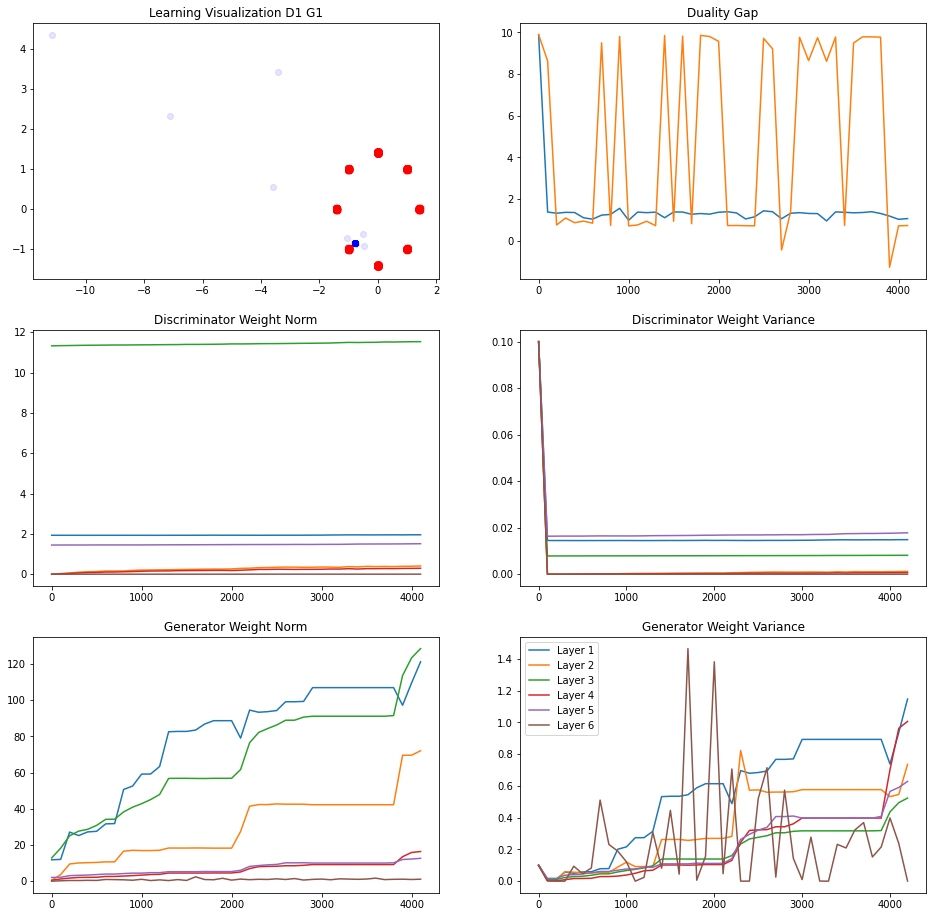

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.2825402
L Random  Duality Gap :  0.7569297


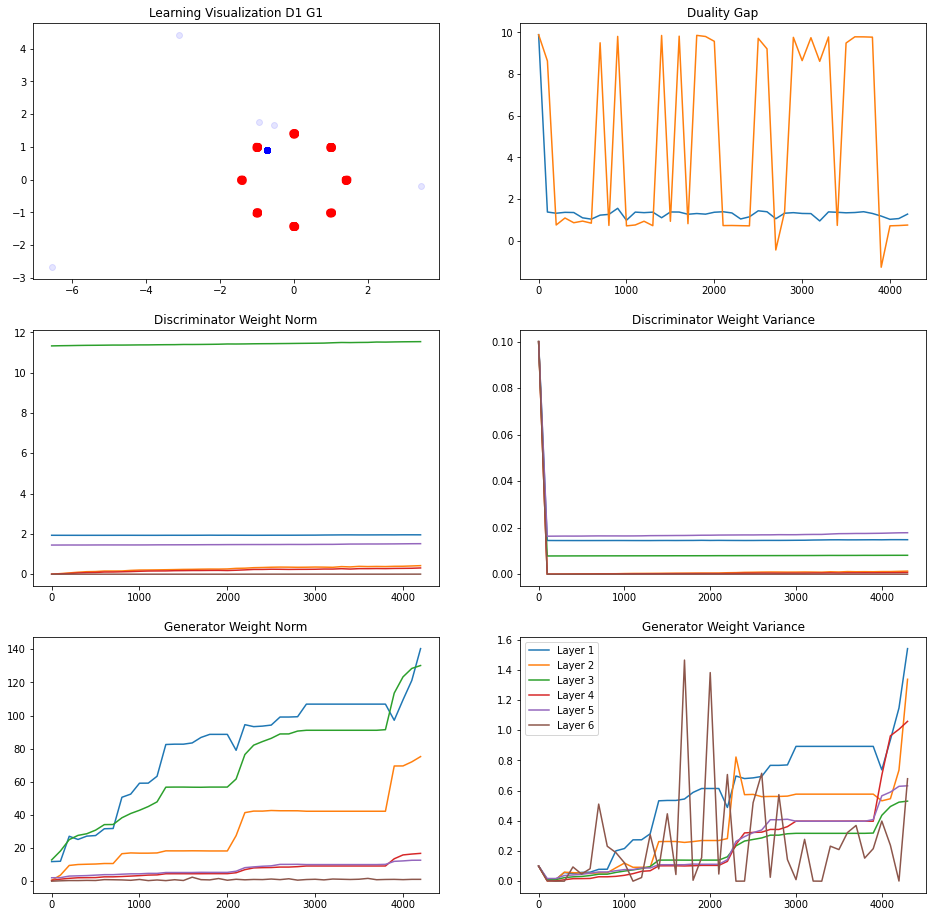

240/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  1.2447436
L Random  Duality Gap :  0.72483814


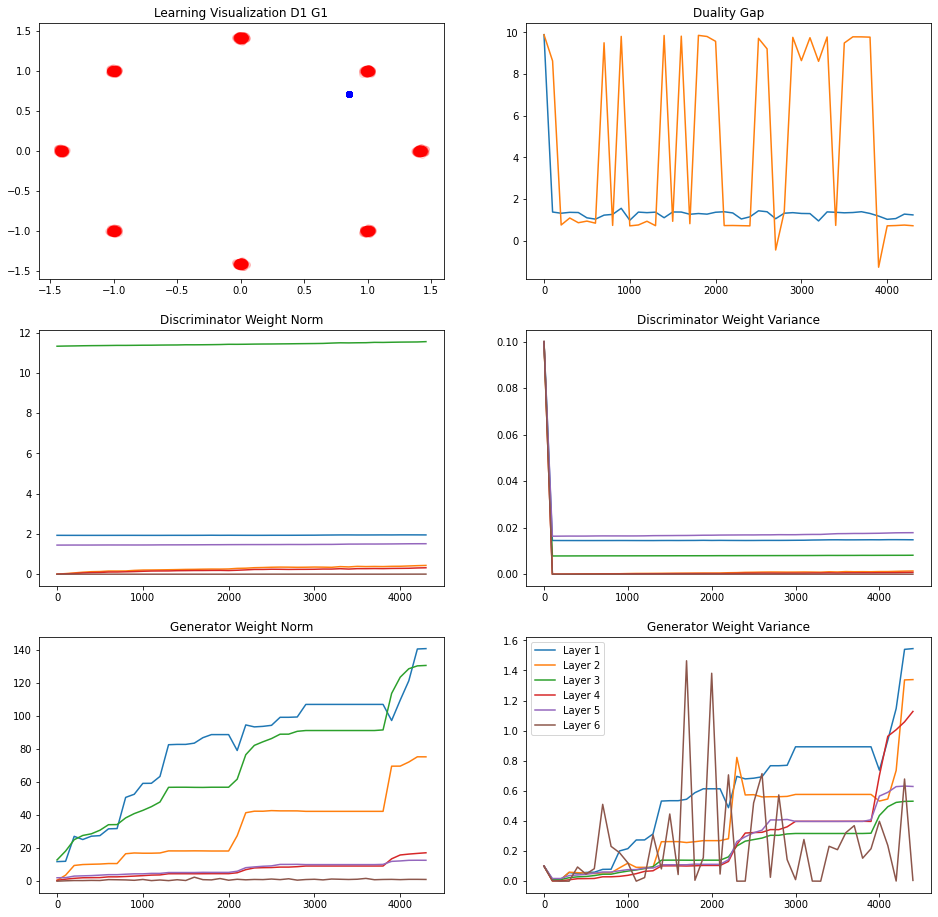

241/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  1.3350296
L Random  Duality Gap :  6.3818526


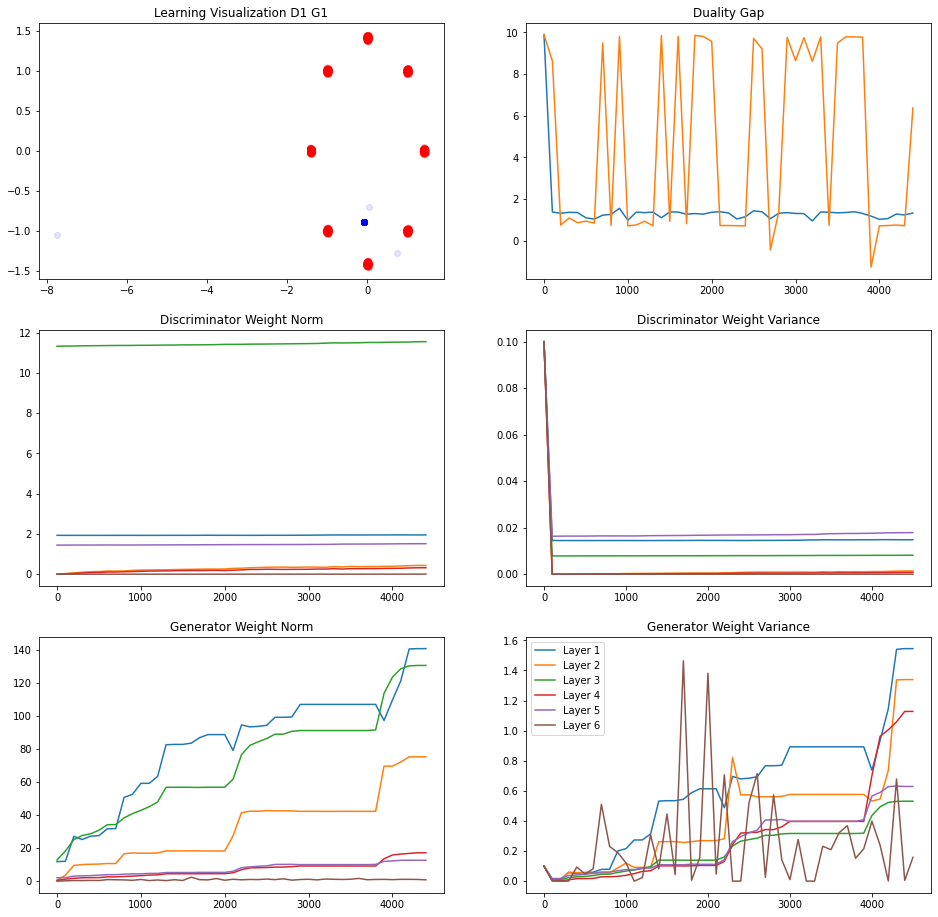

245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.0118899
L Random  Duality Gap :  0.6966808
249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.1467263
L Random  Duality Gap :  1.80988


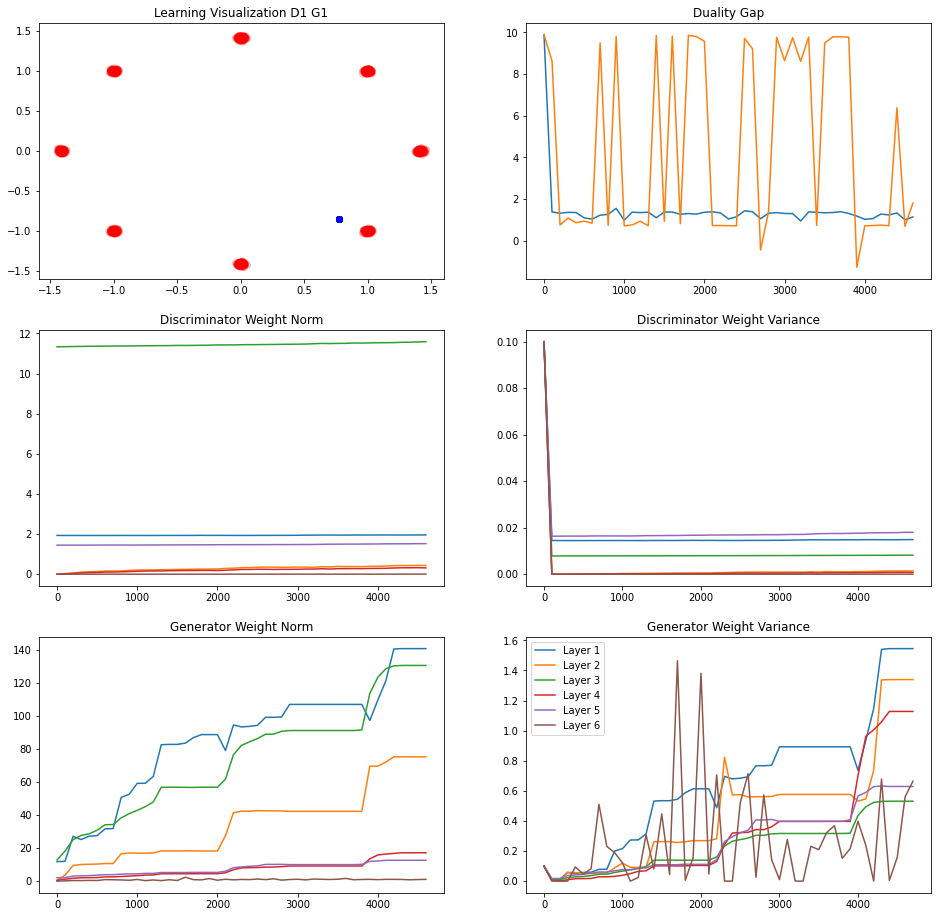

241/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  1.2204895
L Random  Duality Gap :  7.963171


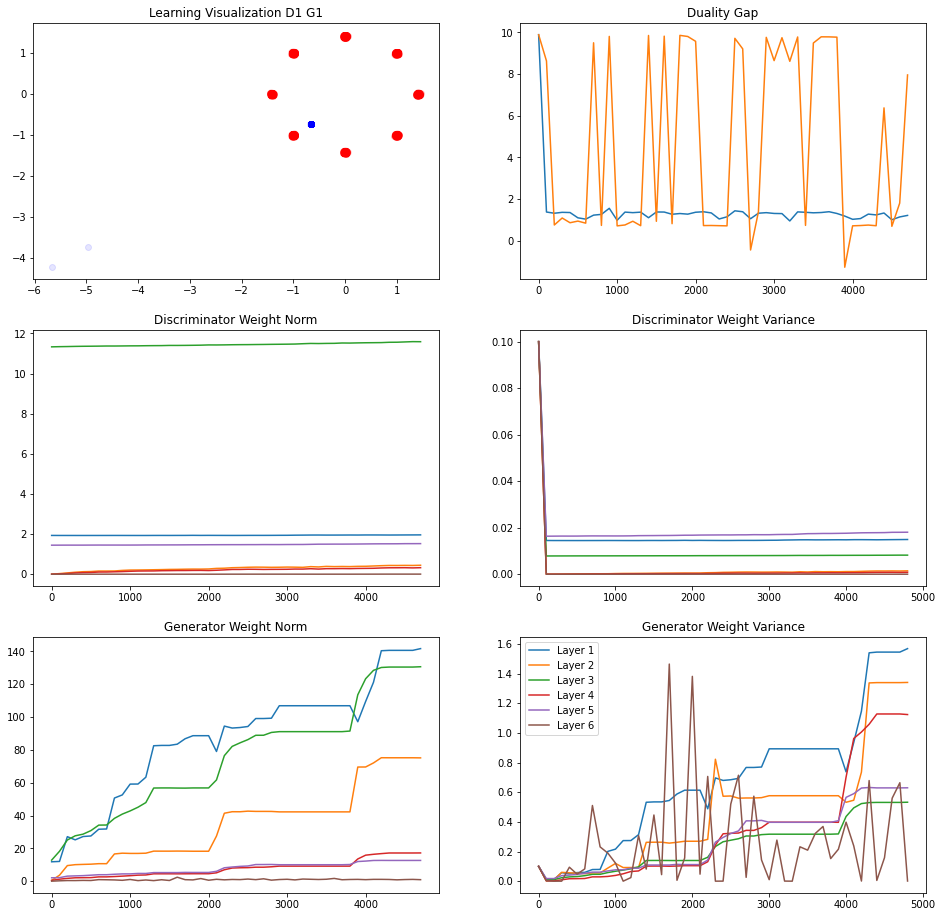

242/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.265764
L Random  Duality Gap :  9.443832


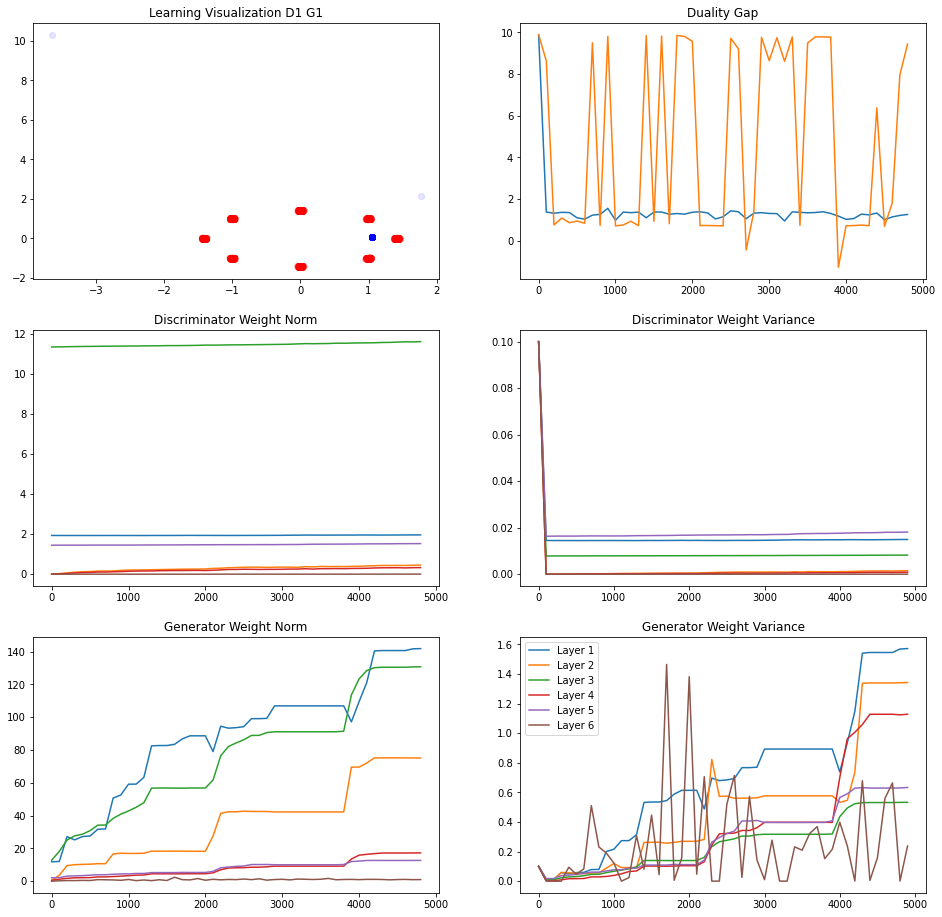

240/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  1.5419546
L Random  Duality Gap :  9.711742


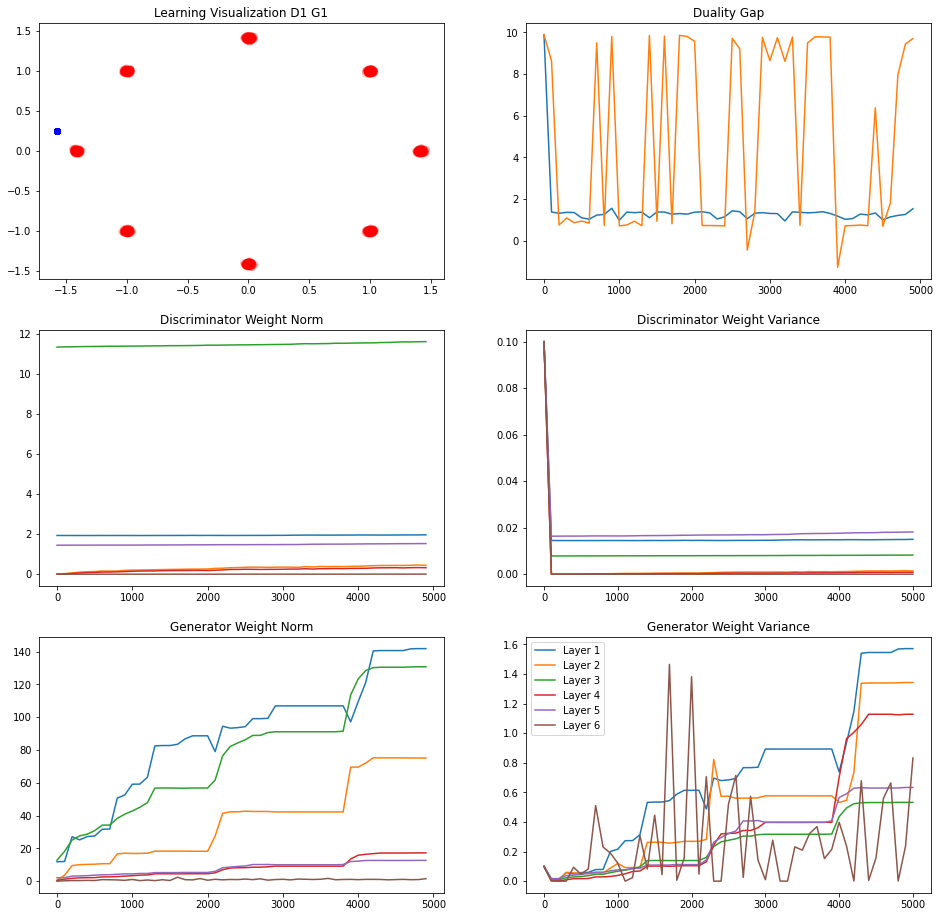

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.8150287
L Random  Duality Gap :  9.597739
242/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.276907
L Random  Duality Gap :  0.75704026


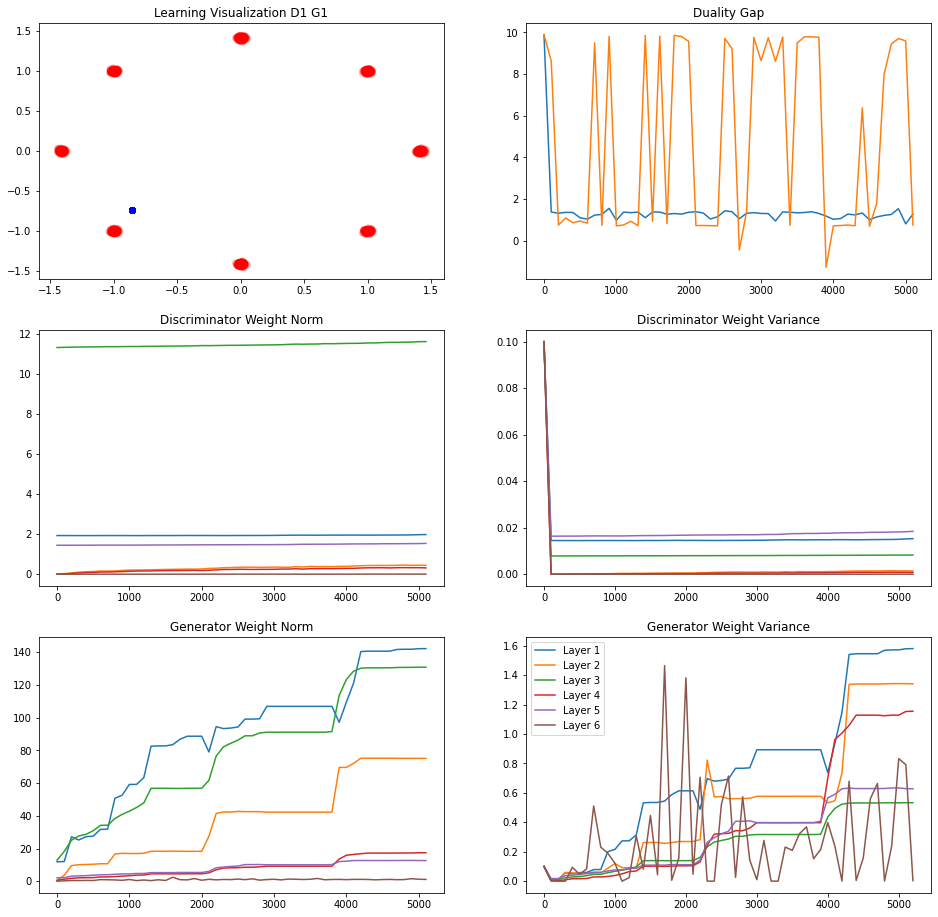

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.2867275
L Random  Duality Gap :  8.994289


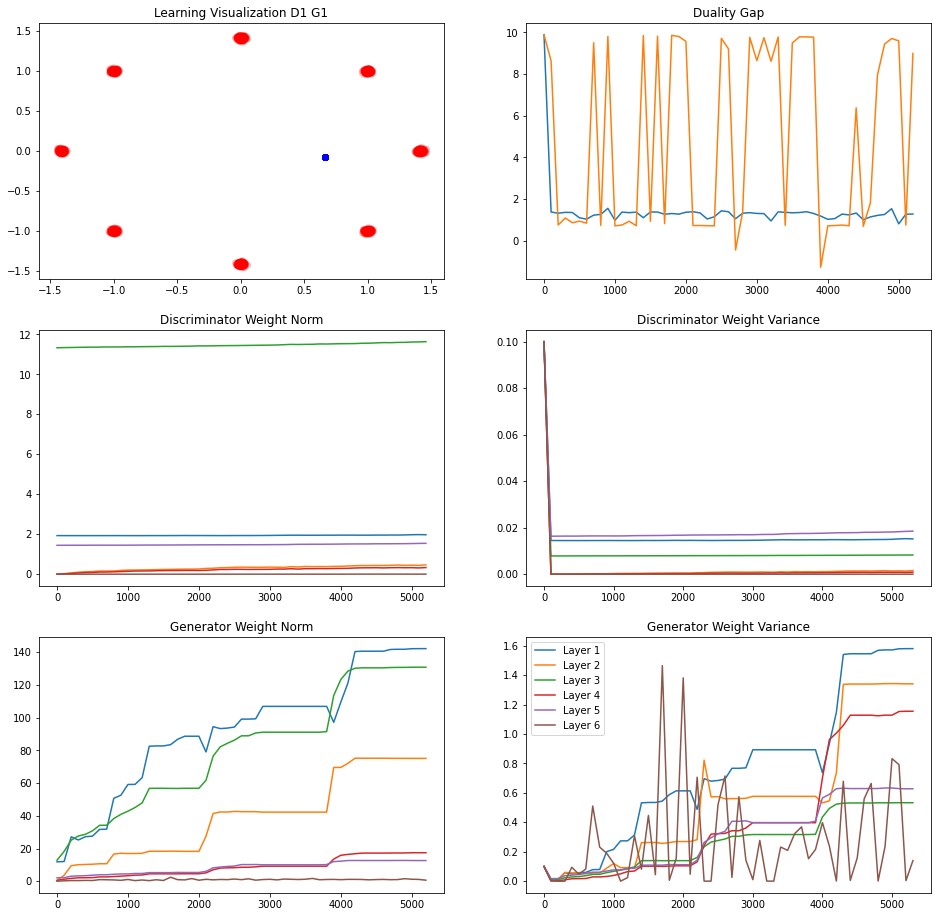

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.9718294
L Random  Duality Gap :  -0.35151196


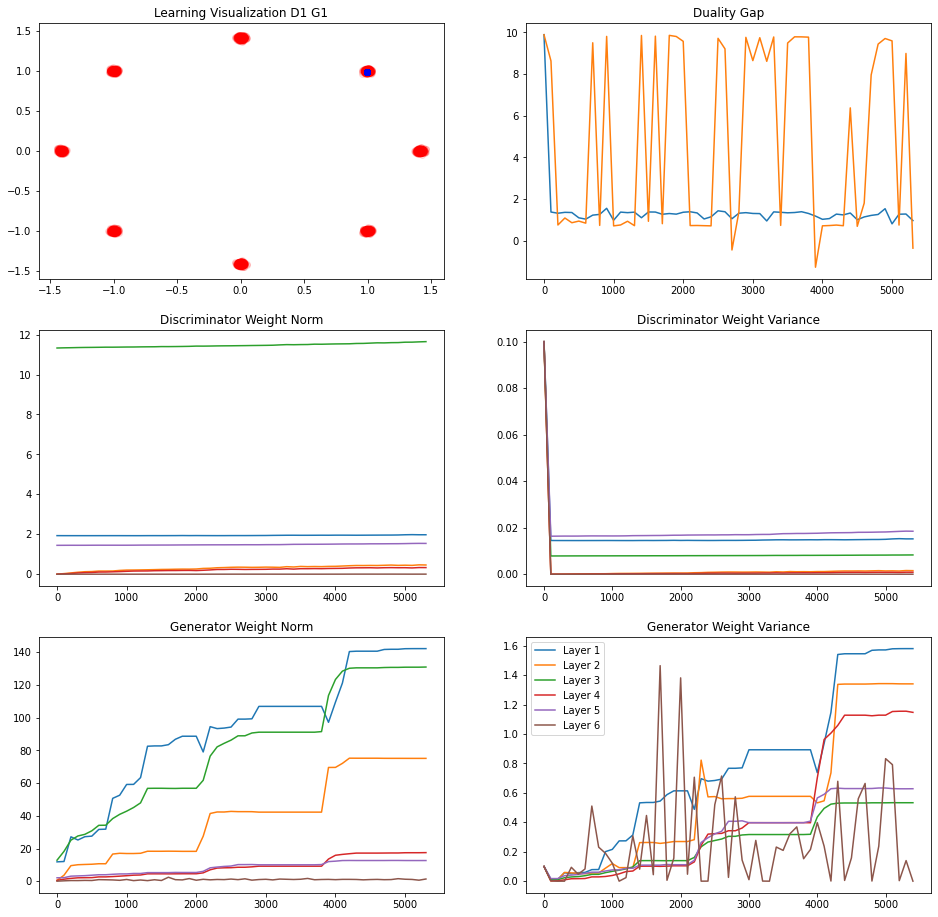

244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.3709922
L Random  Duality Gap :  9.297552


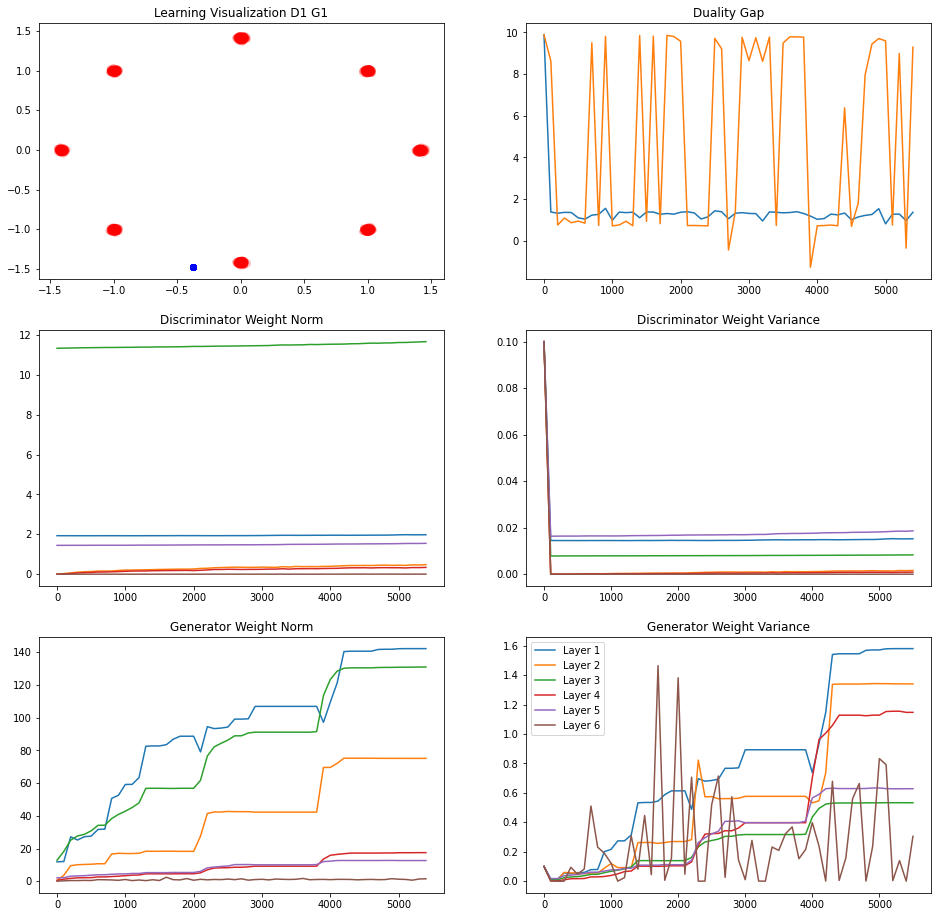

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.2205403
L Random  Duality Gap :  8.755332
243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.0425802
L Random  Duality Gap :  0.7313196


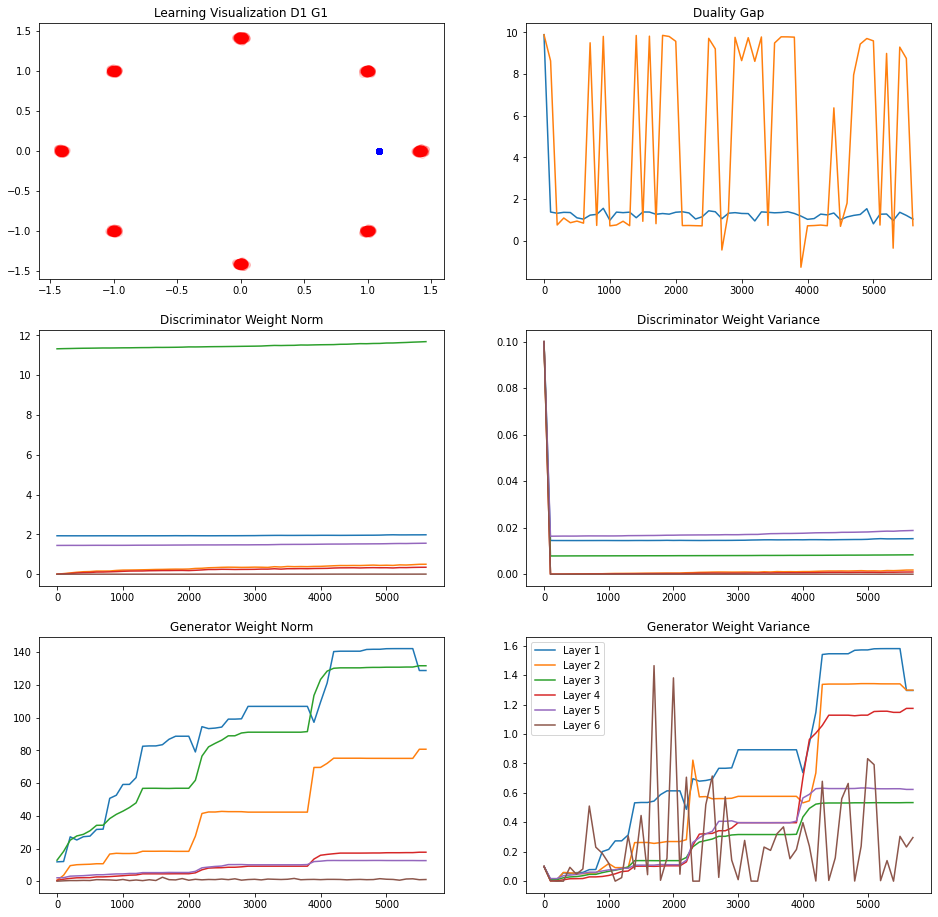

241/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  0.91753495
L Random  Duality Gap :  8.138938


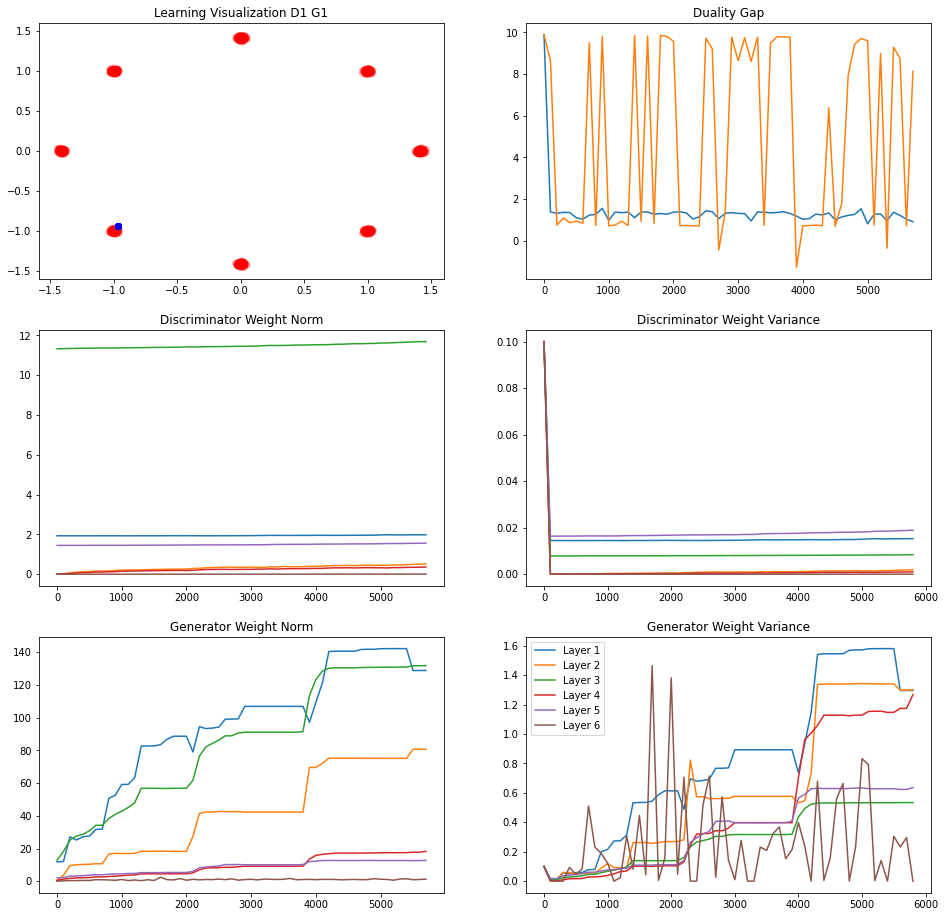

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.4677942
L Random  Duality Gap :  0.77260906


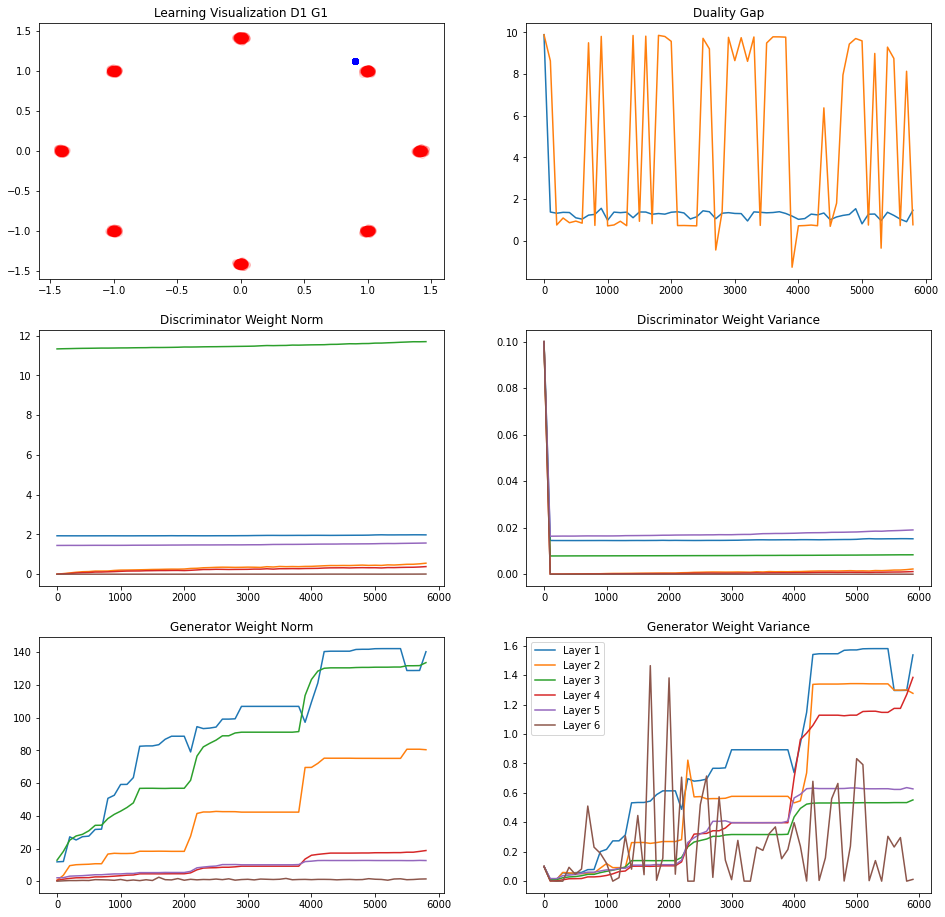

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.0964379
L Random  Duality Gap :  8.868681


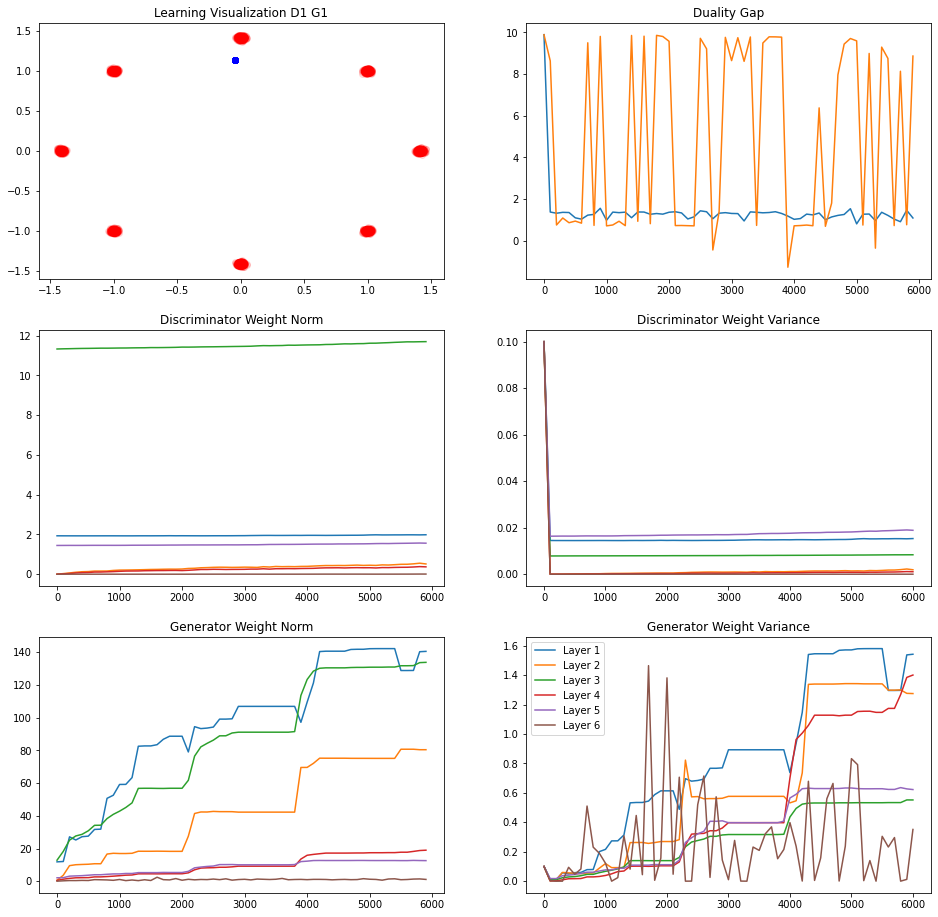

240/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  1.1476269
L Random  Duality Gap :  9.643004
247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.0867101
L Random  Duality Gap :  0.7262956


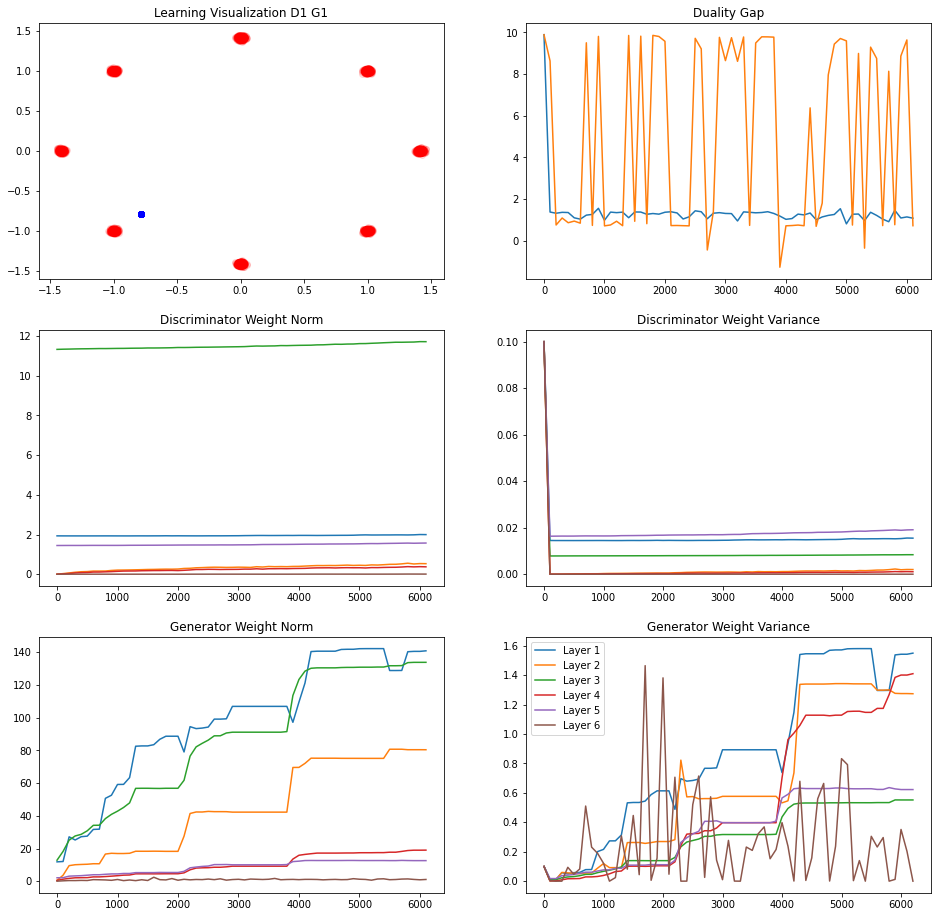

245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.8876157
L Random  Duality Gap :  0.49563217


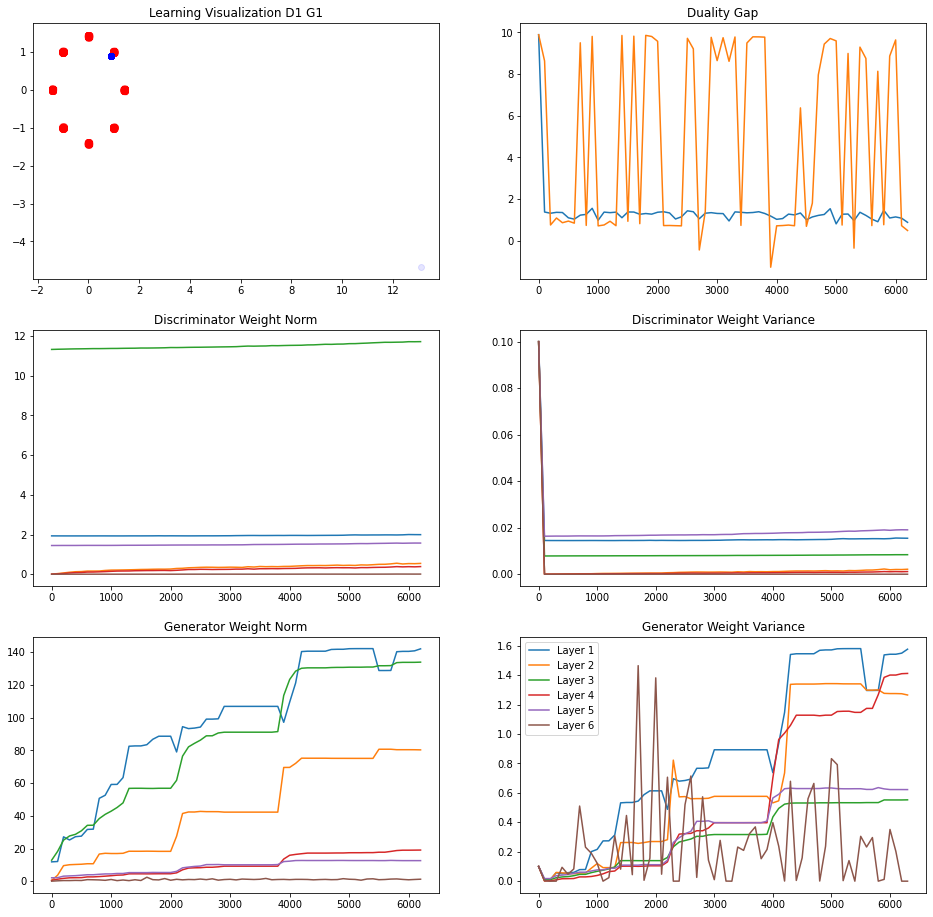

245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.2831763
L Random  Duality Gap :  0.73040044


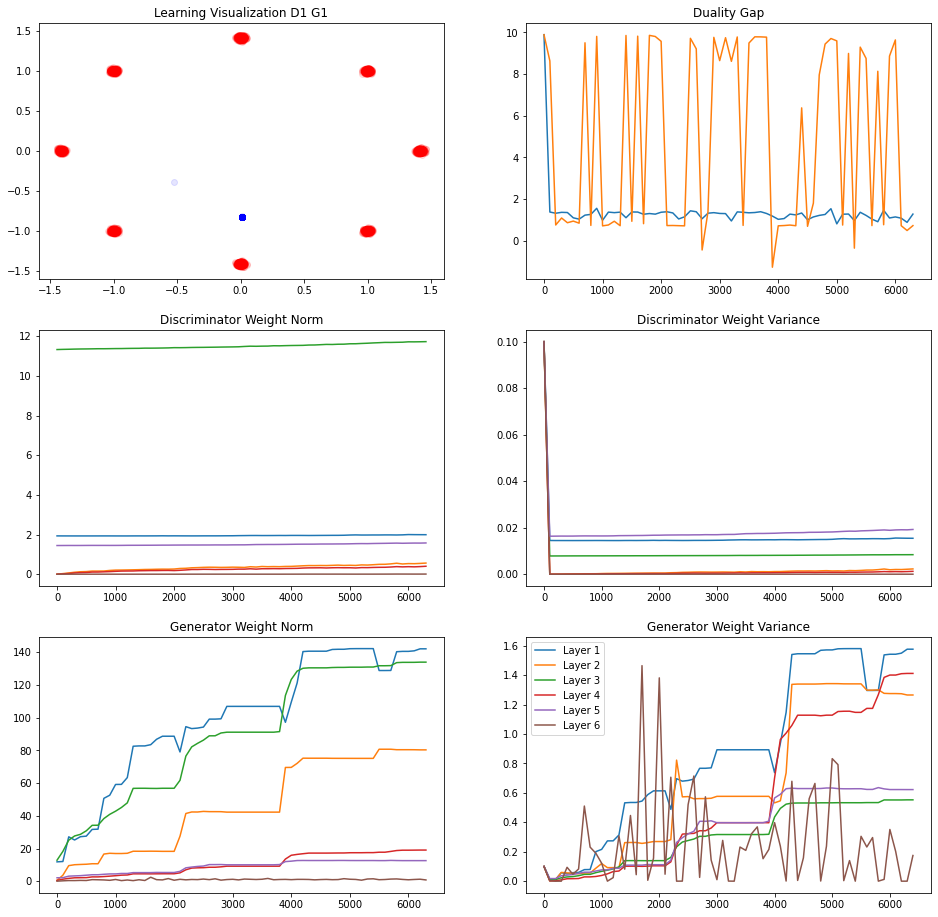

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.3405094
L Random  Duality Gap :  9.623074


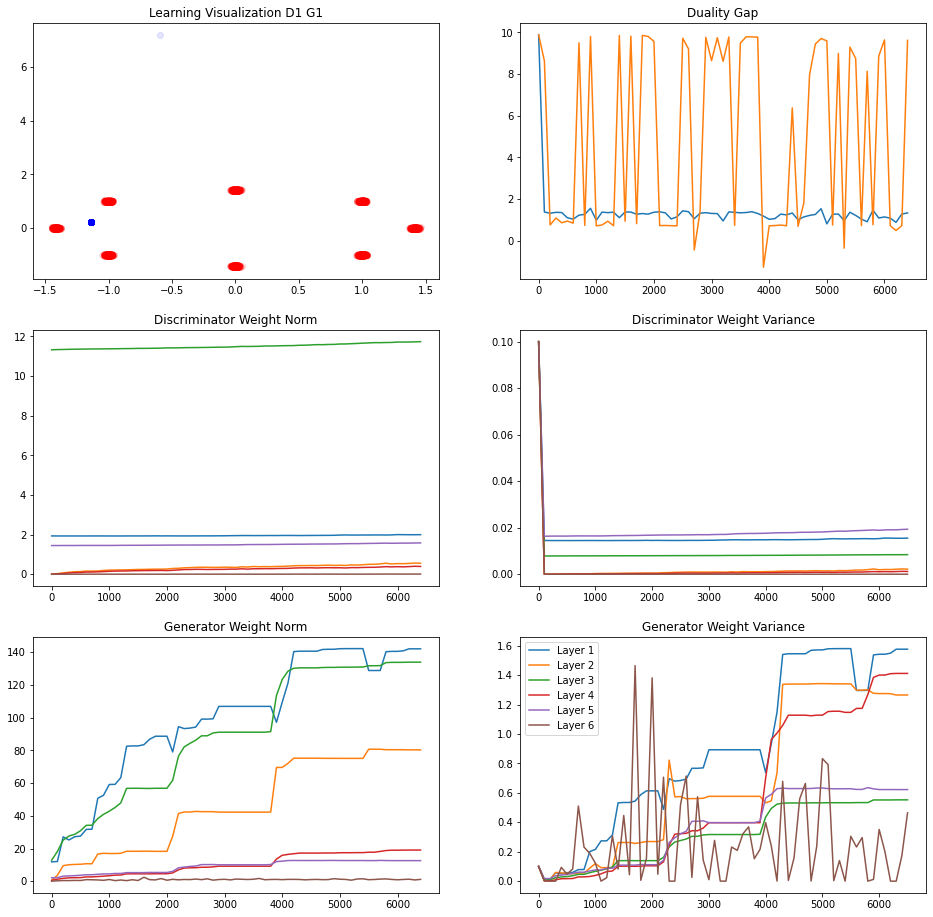

241/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  0.94616747
L Random  Duality Gap :  9.667263
248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.4469287
L Random  Duality Gap :  0.7841802


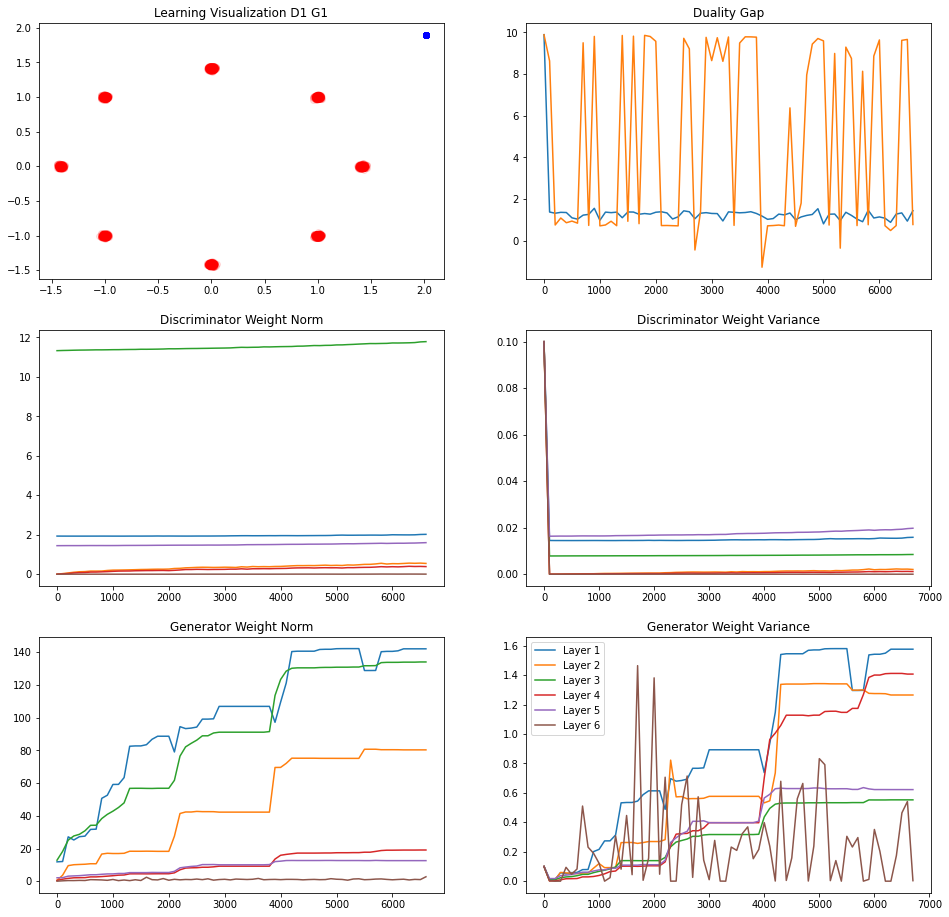

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.4542303
L Random  Duality Gap :  0.74239534


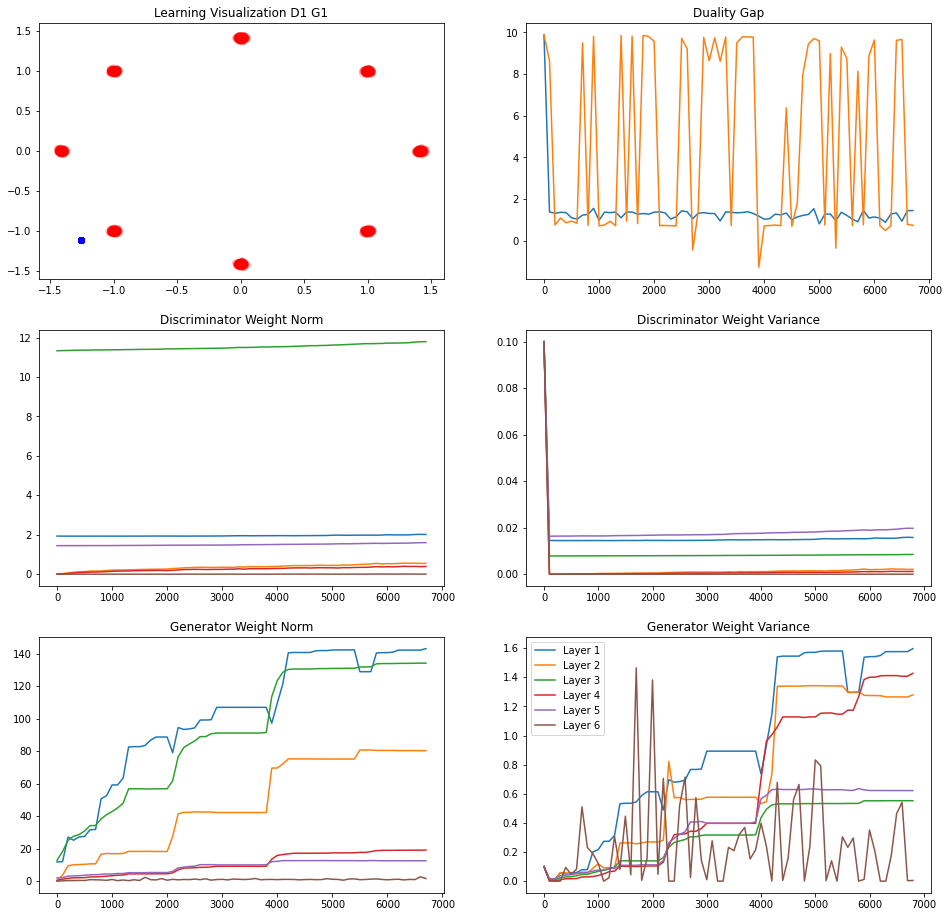

241/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  1.3760486
L Random  Duality Gap :  0.73636466


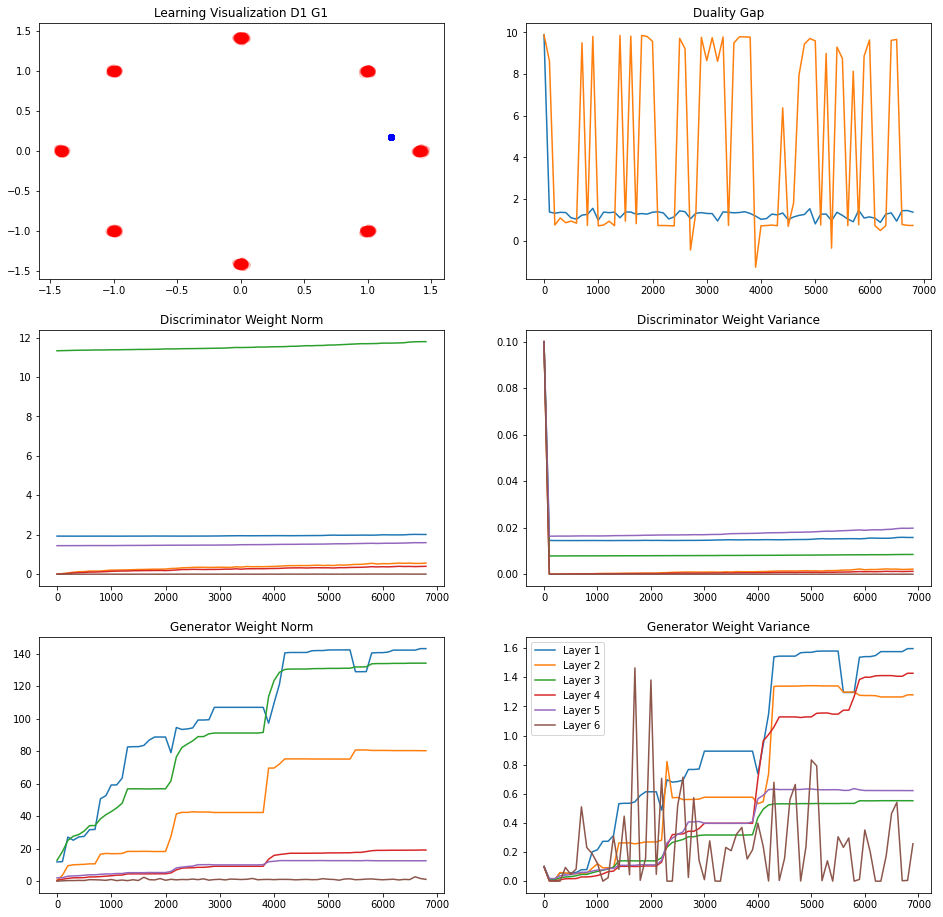

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.2088515
L Random  Duality Gap :  2.4099724


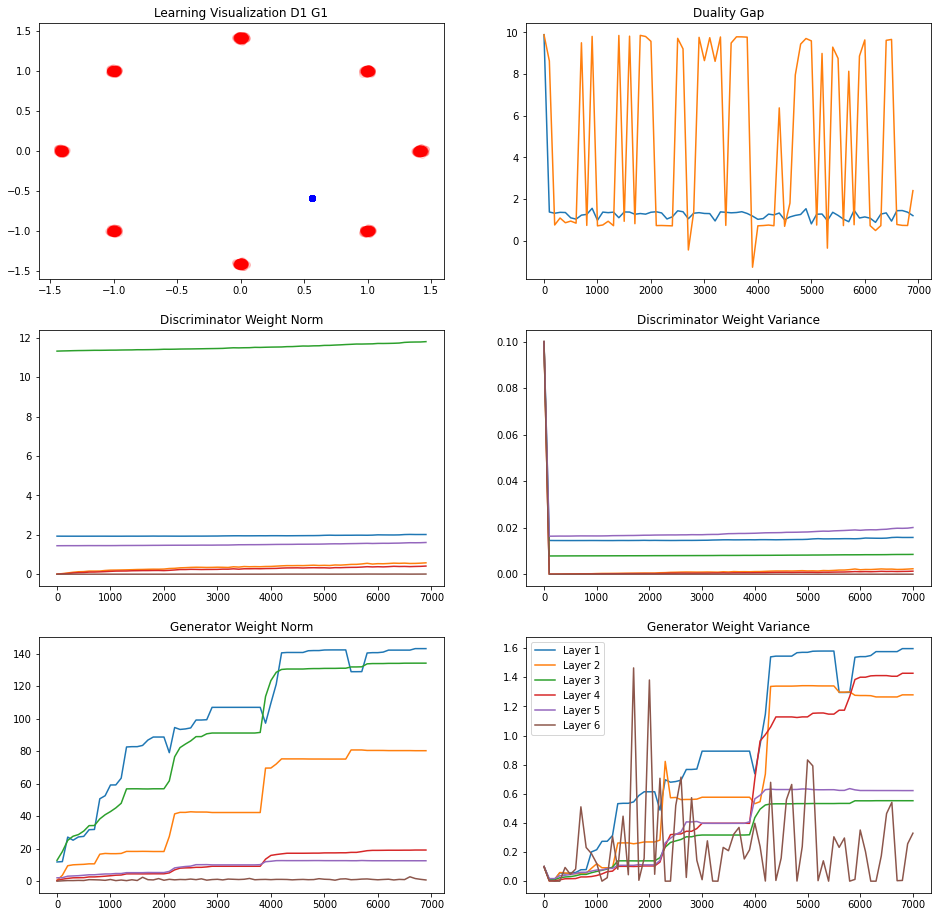

244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.2450442
L Random  Duality Gap :  9.646516
237/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  1.663534
L Random  Duality Gap :  9.61937


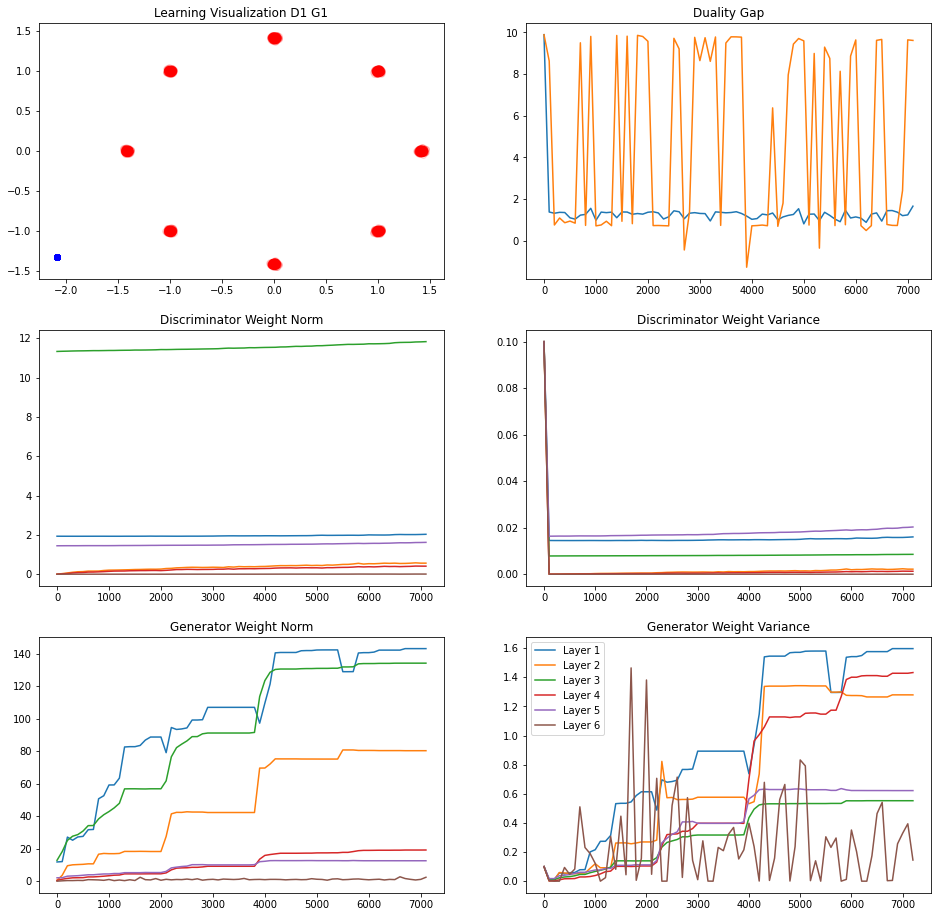

242/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.1666765
L Random  Duality Gap :  9.689113


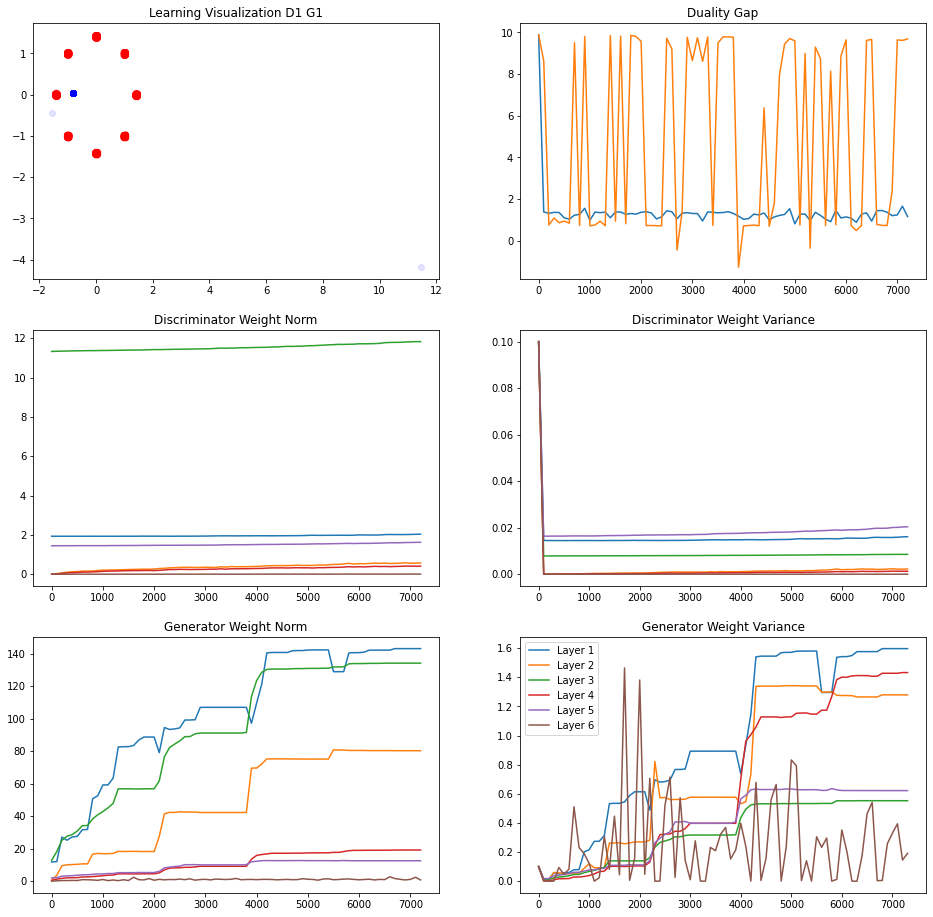

244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.9132627
L Random  Duality Gap :  0.73540235


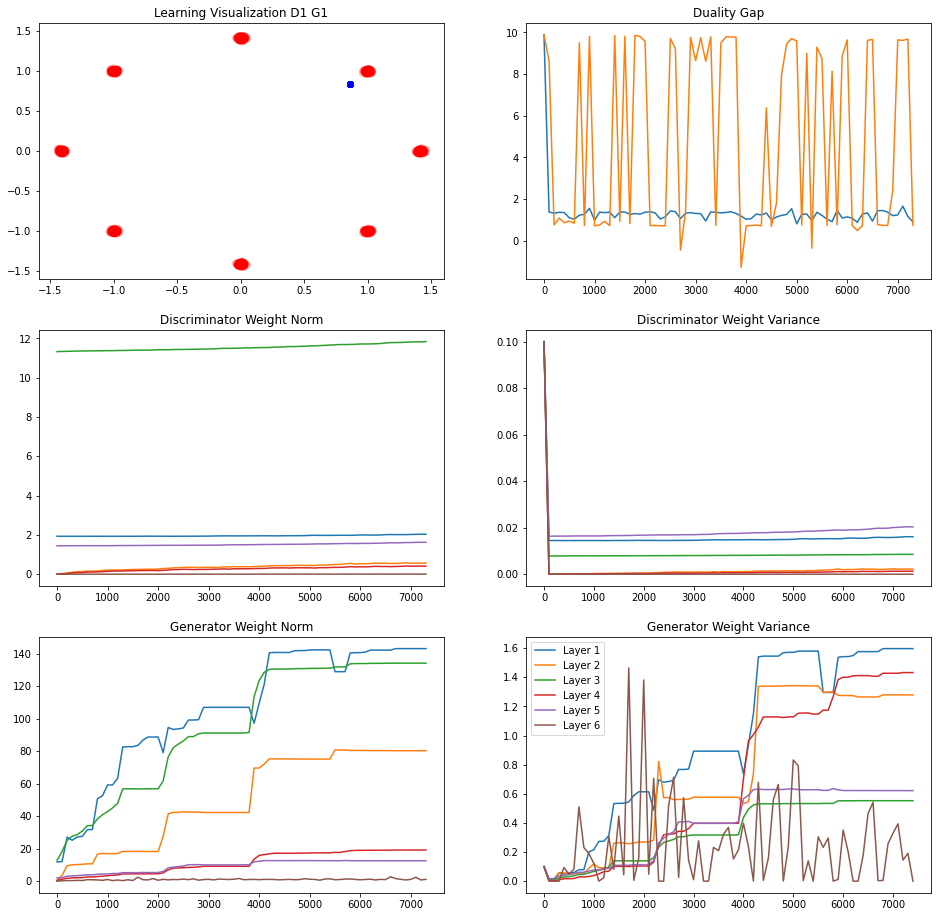

241/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  1.0171735
L Random  Duality Gap :  9.669366


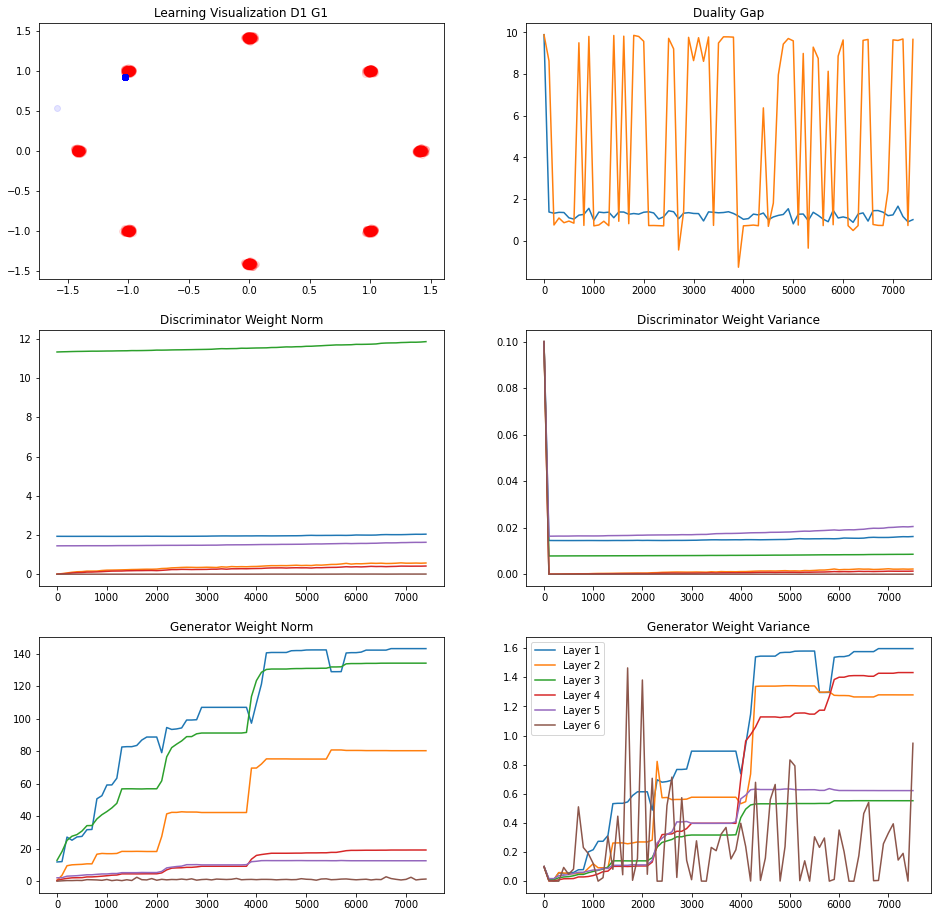

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.3724699
L Random  Duality Gap :  0.7508008
241/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  1.4340405
L Random  Duality Gap :  8.838589


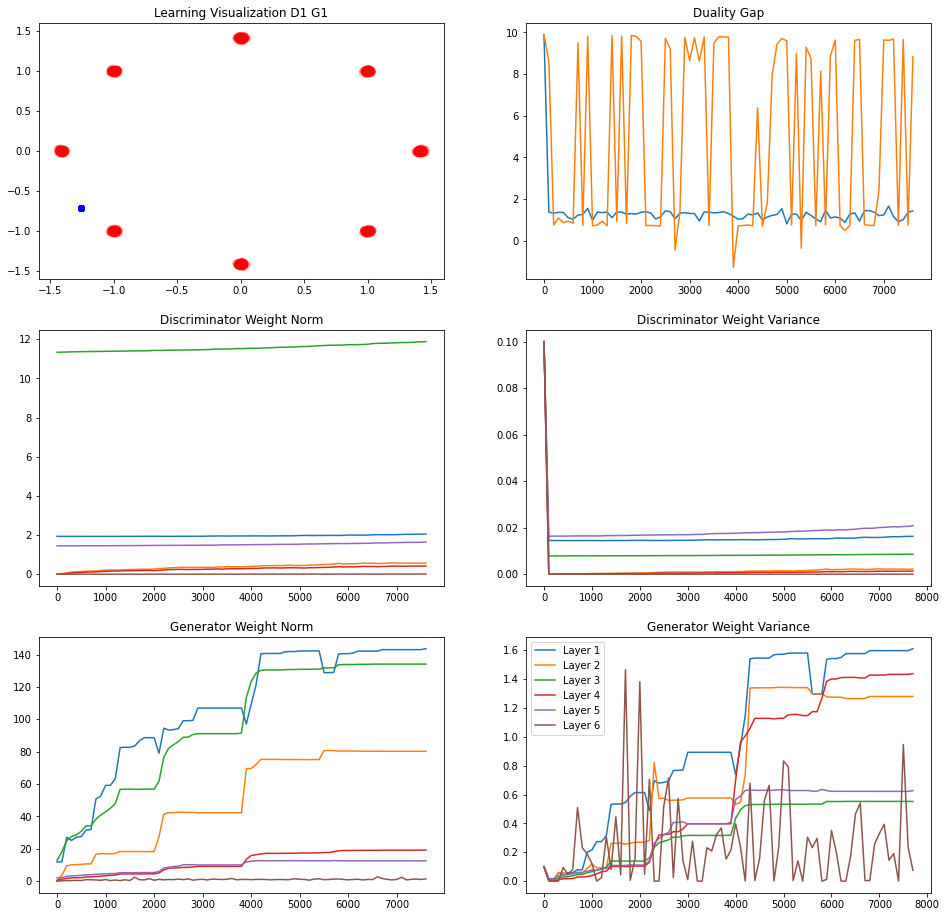

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.1528348
L Random  Duality Gap :  8.97784


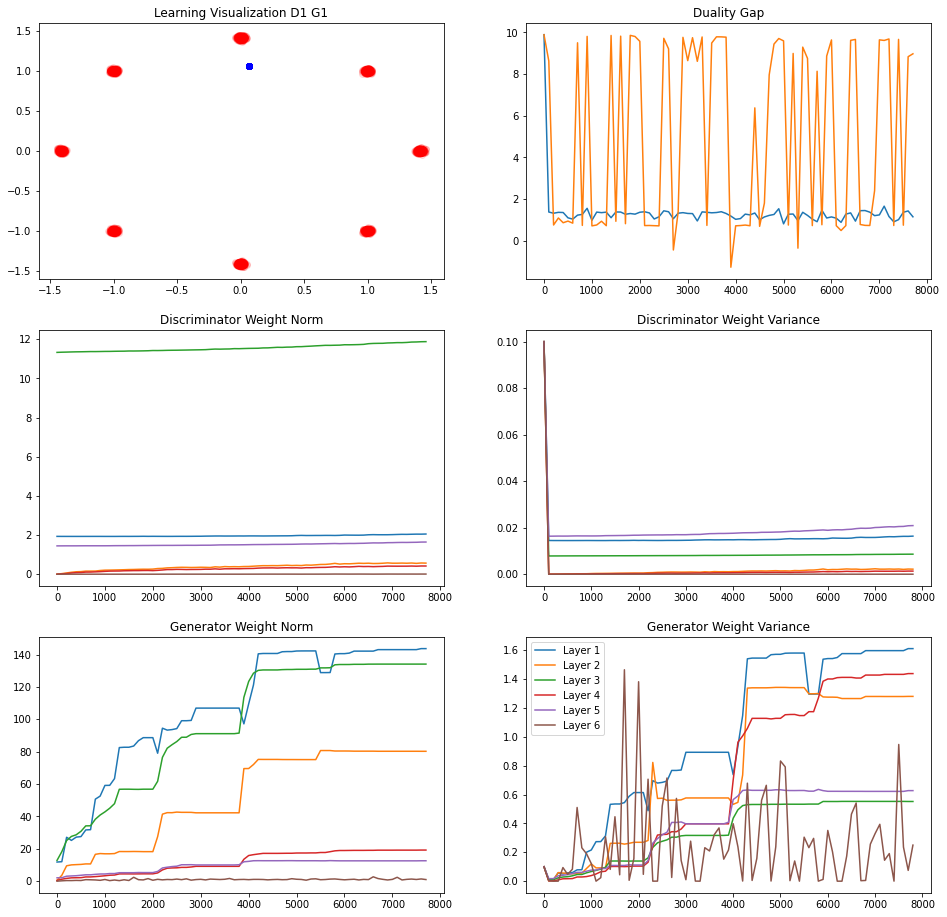

239/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  1.3135222
L Random  Duality Gap :  0.71600944


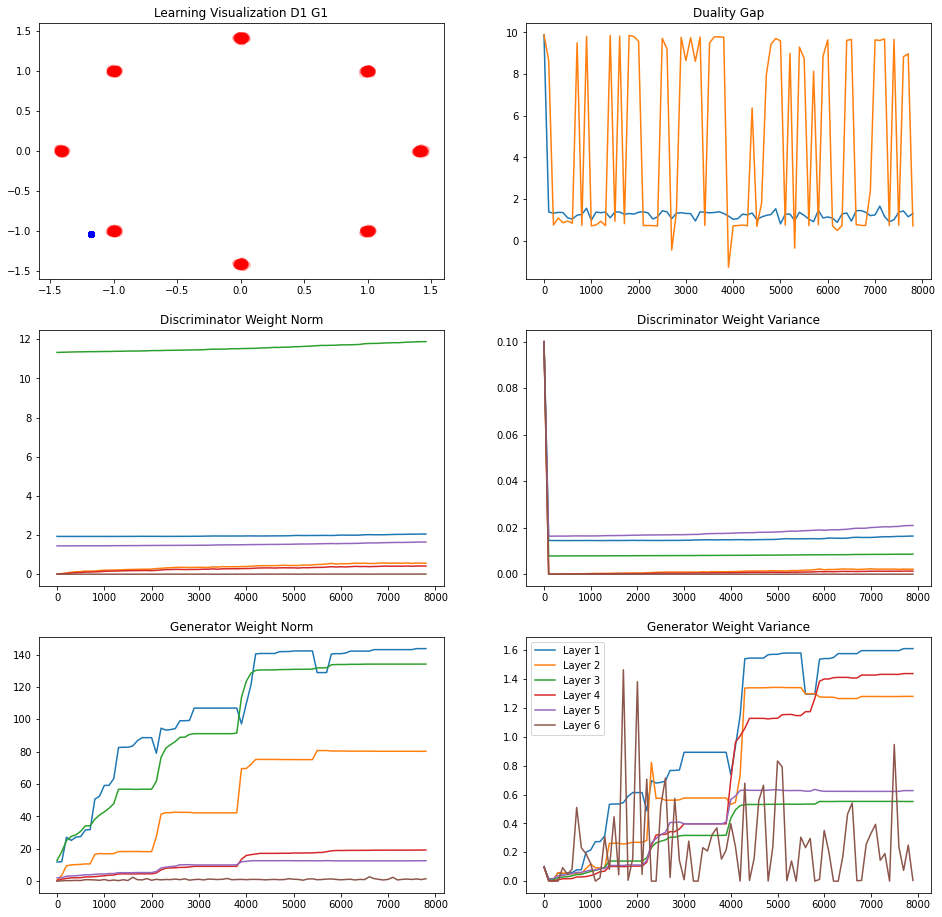

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.9638105
L Random  Duality Gap :  9.63542


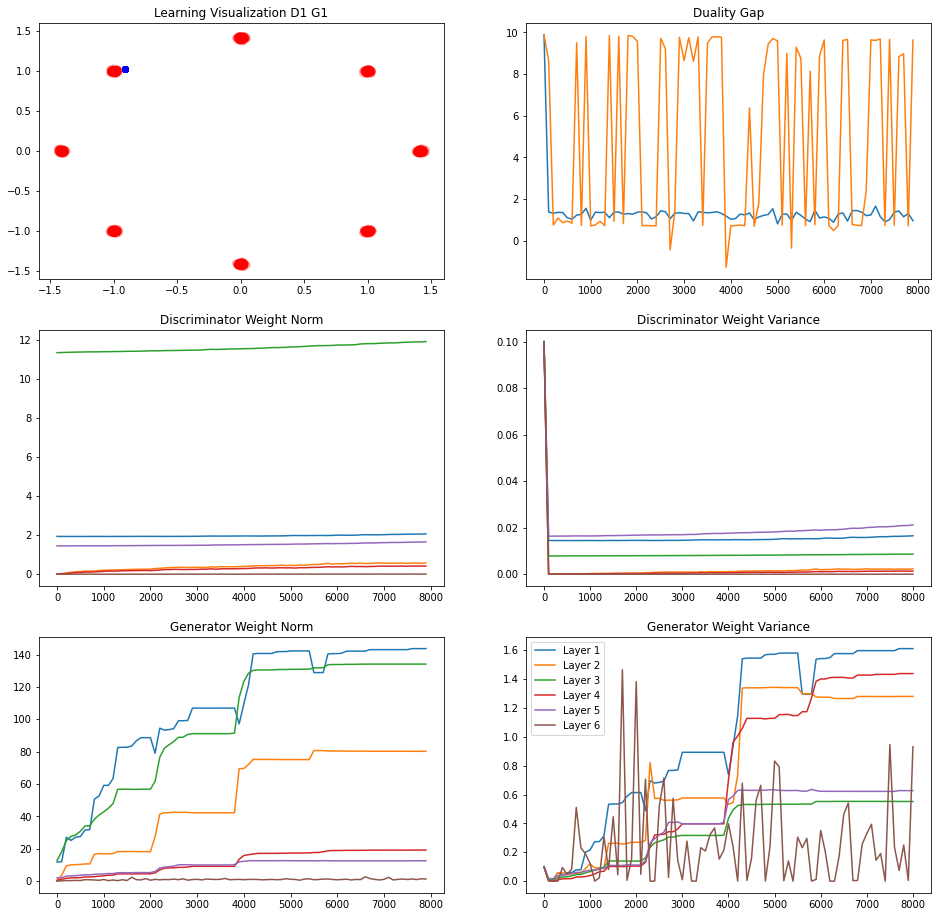

245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.6143237
L Random  Duality Gap :  9.0731735
246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.2401944
L Random  Duality Gap :  9.313976


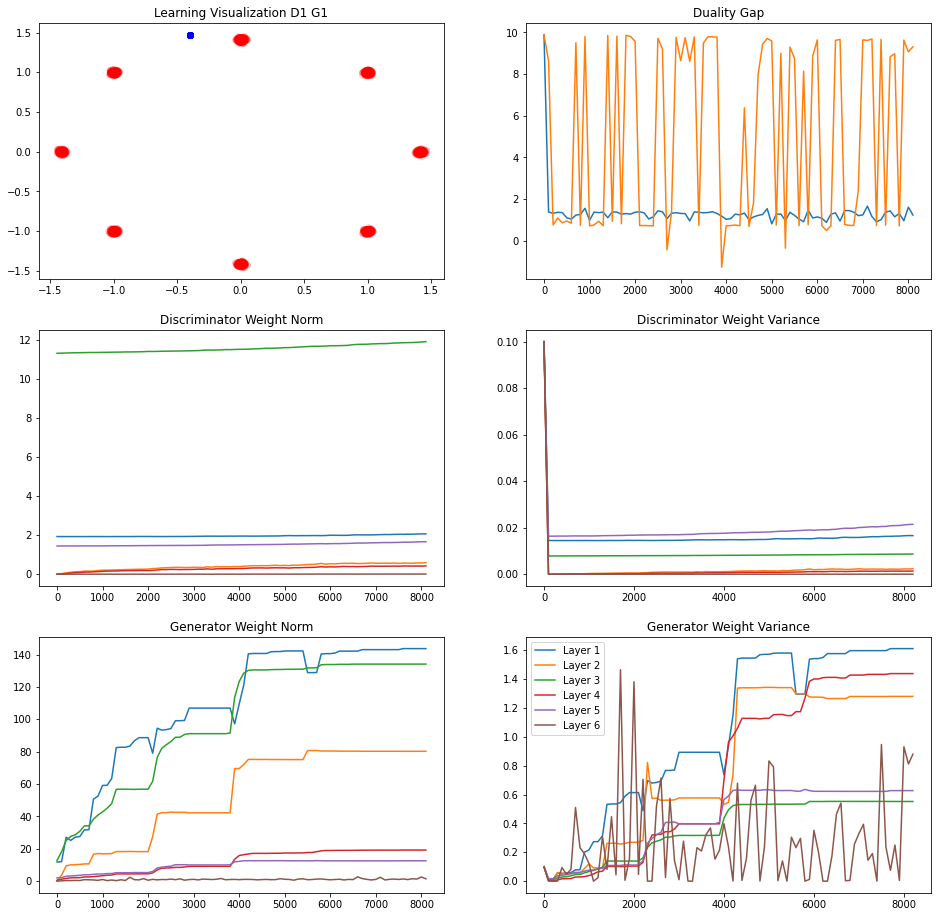

240/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  1.619401
L Random  Duality Gap :  9.6914


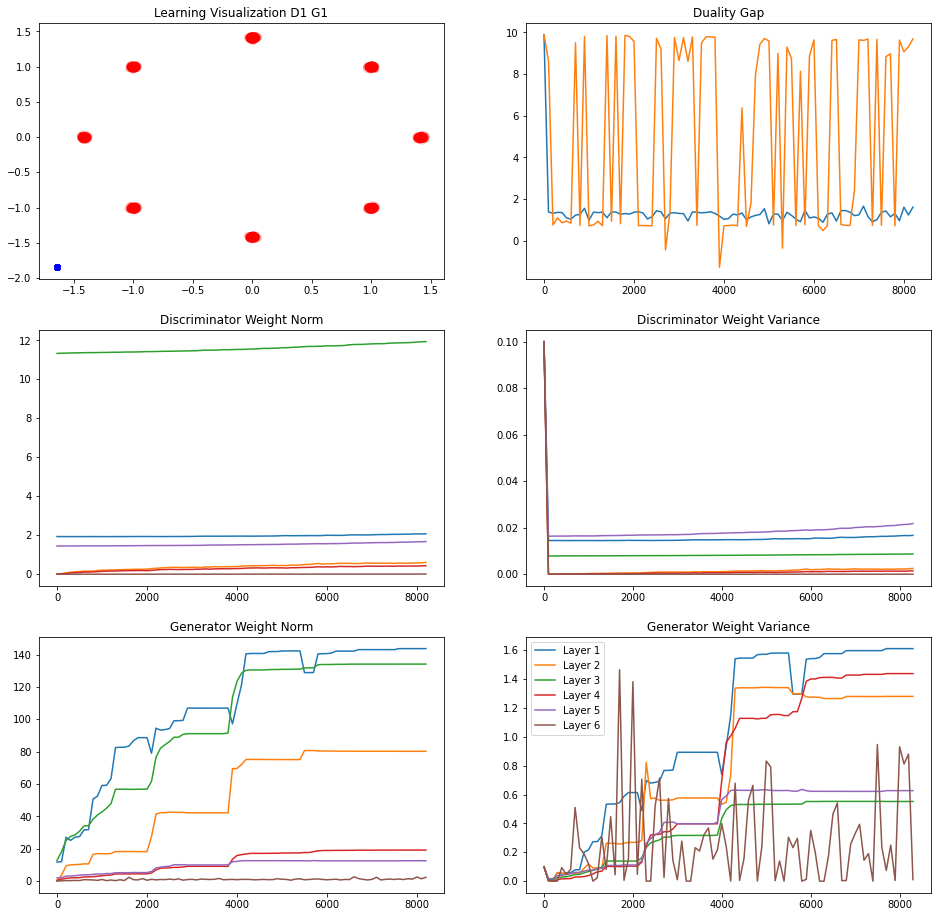

239/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  1.2519724
L Random  Duality Gap :  9.19786


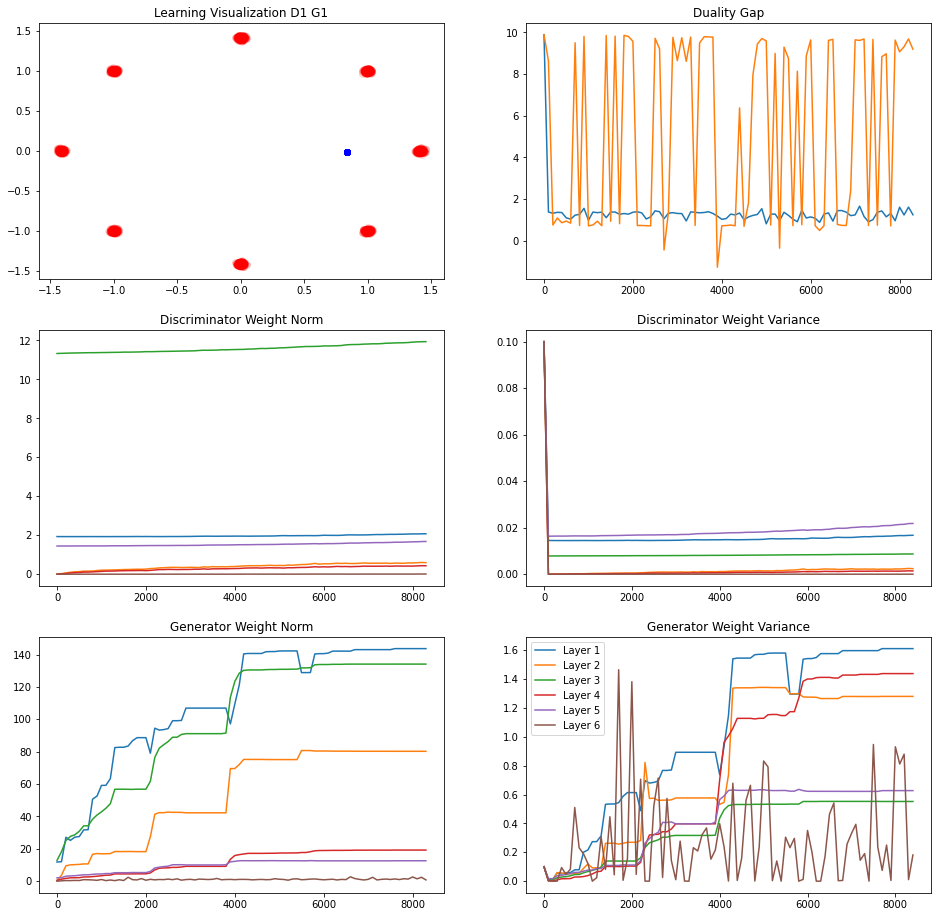

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  0.9356054
L Random  Duality Gap :  8.203605


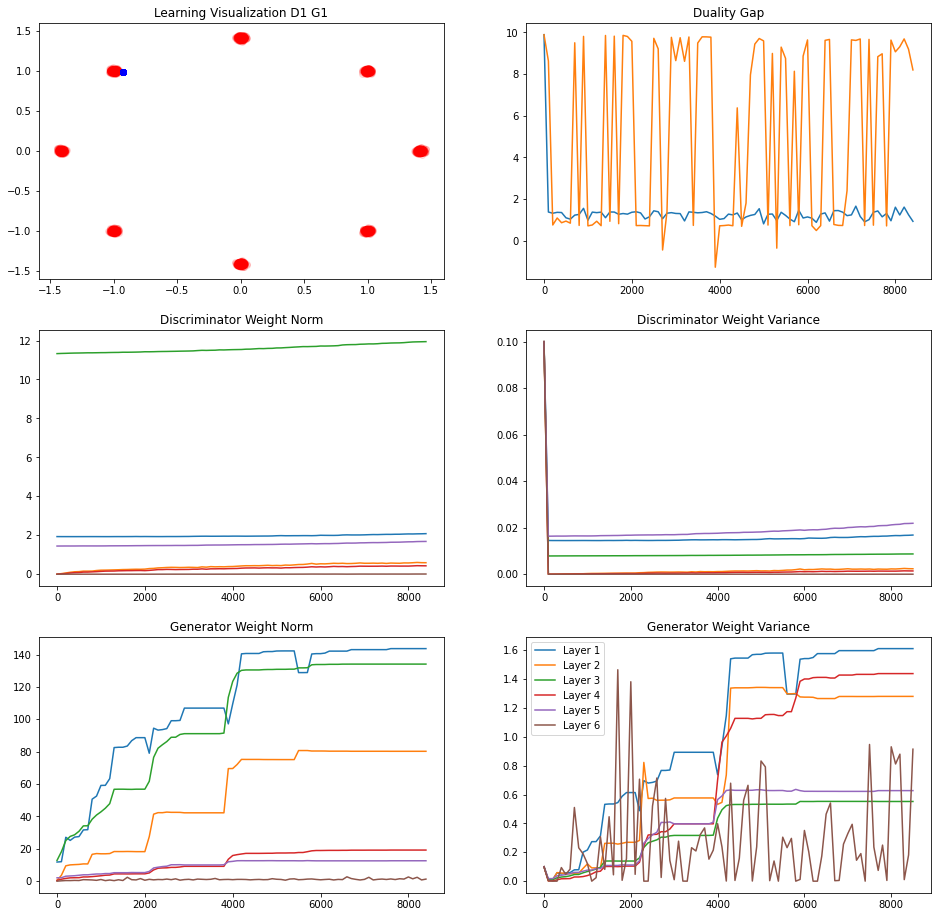

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.3521338
L Random  Duality Gap :  9.477141
248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.3353137
L Random  Duality Gap :  0.7324058


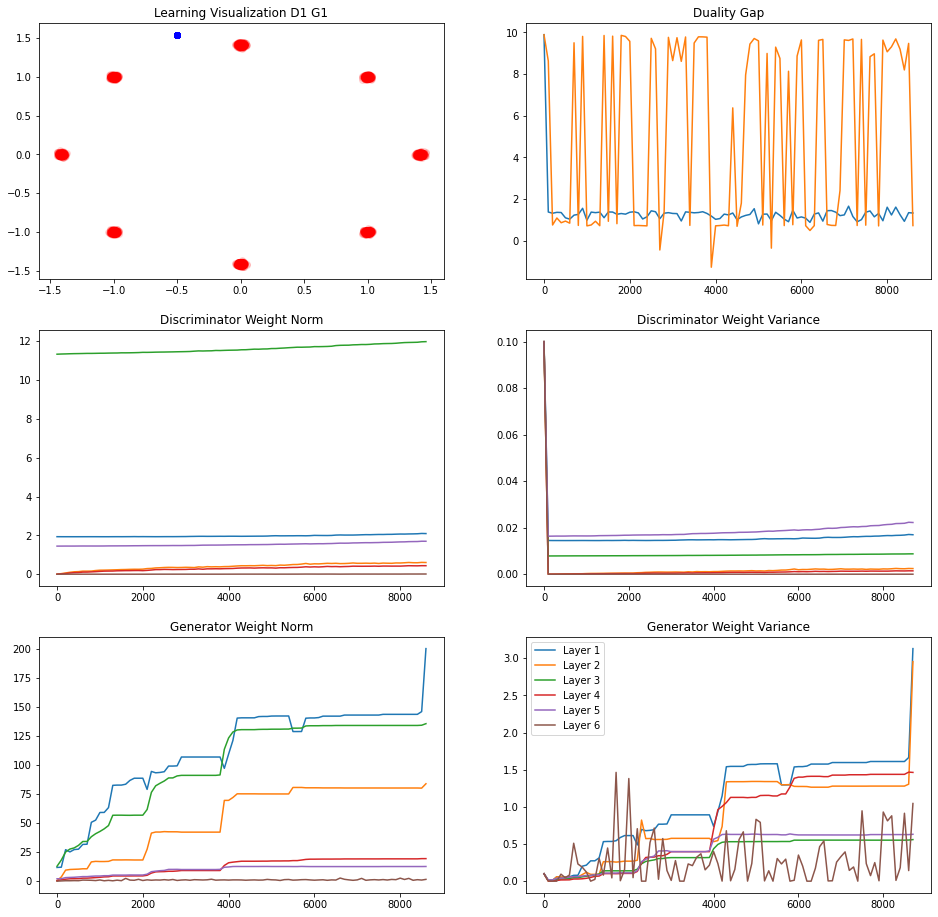

241/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  1.6137501
L Random  Duality Gap :  6.847523


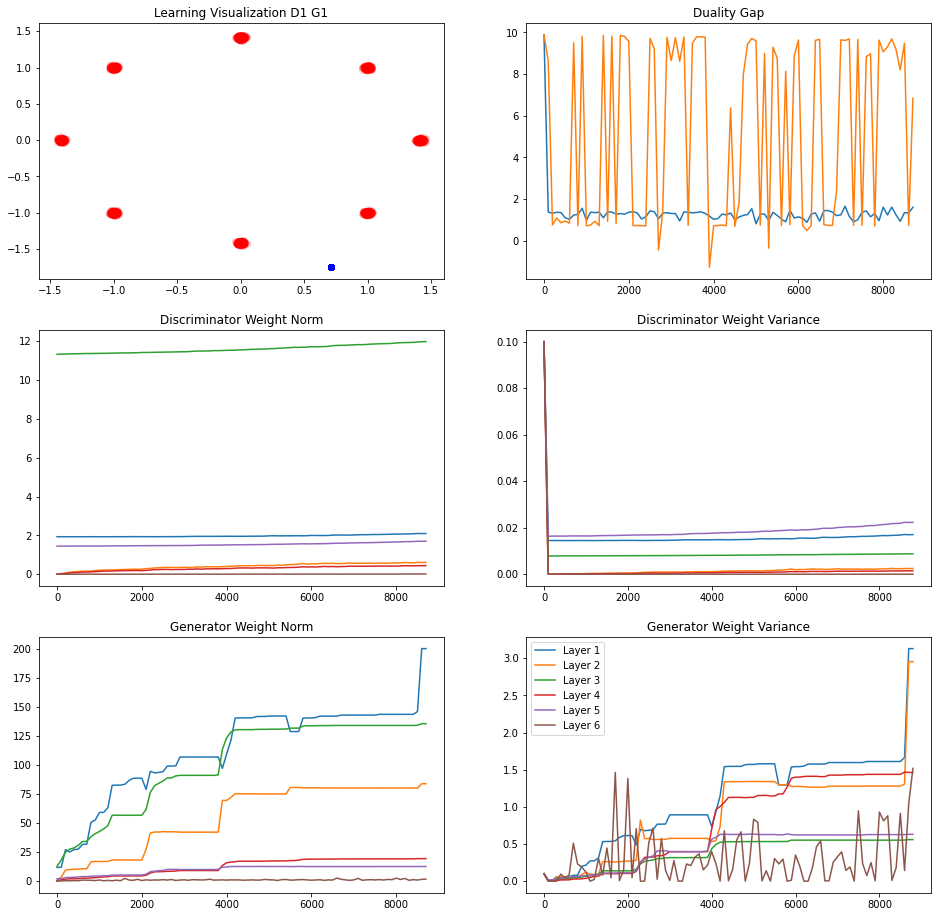

241/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  1.2775177
L Random  Duality Gap :  0.60915136


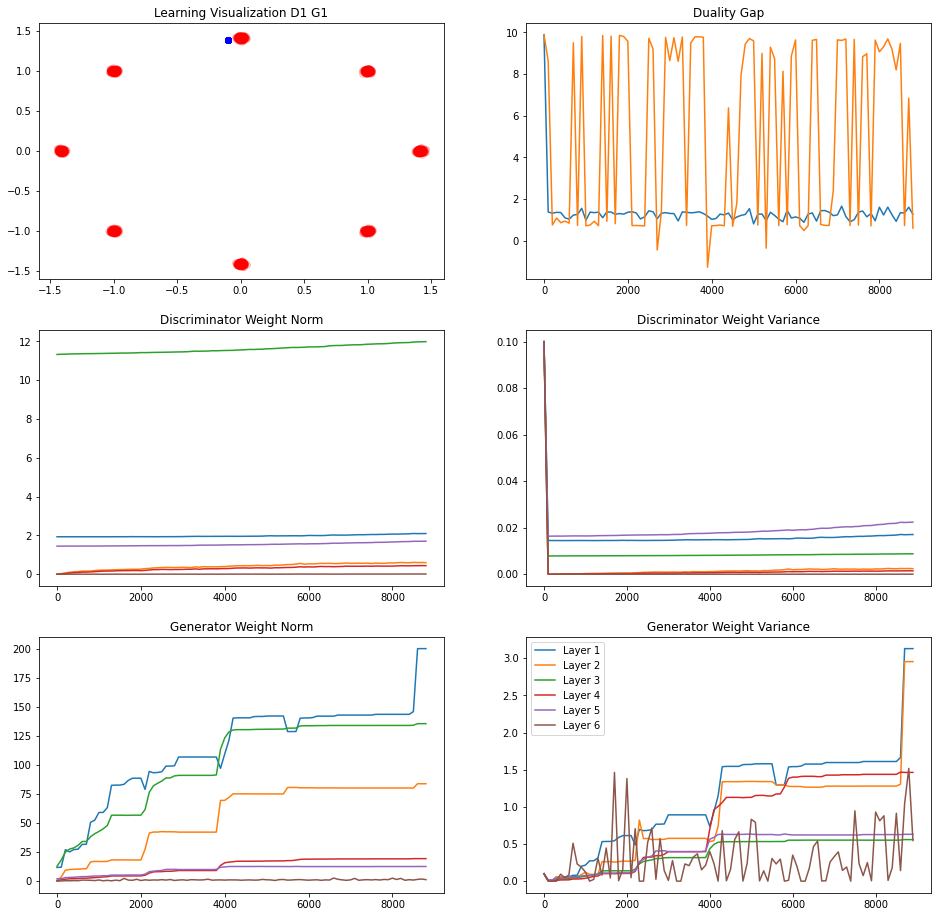

240/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  1.5724915
L Random  Duality Gap :  9.745575


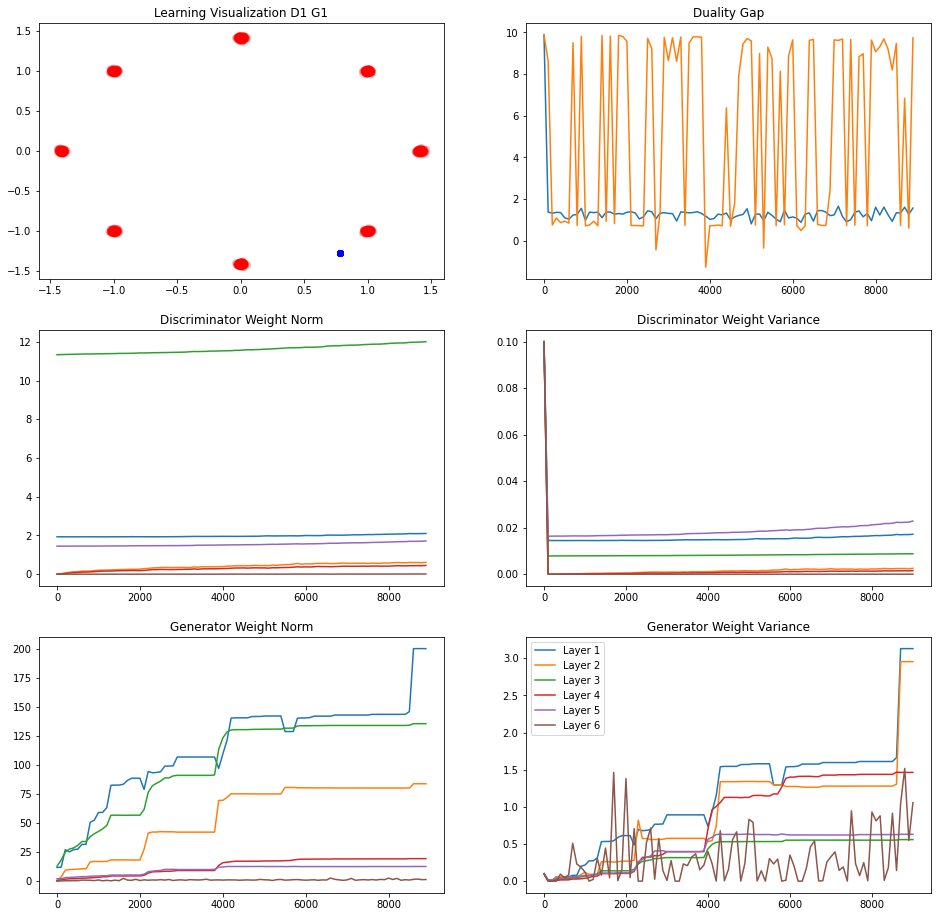

244/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.3266968
L Random  Duality Gap :  9.00345
240/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  1.2427577
L Random  Duality Gap :  9.317911


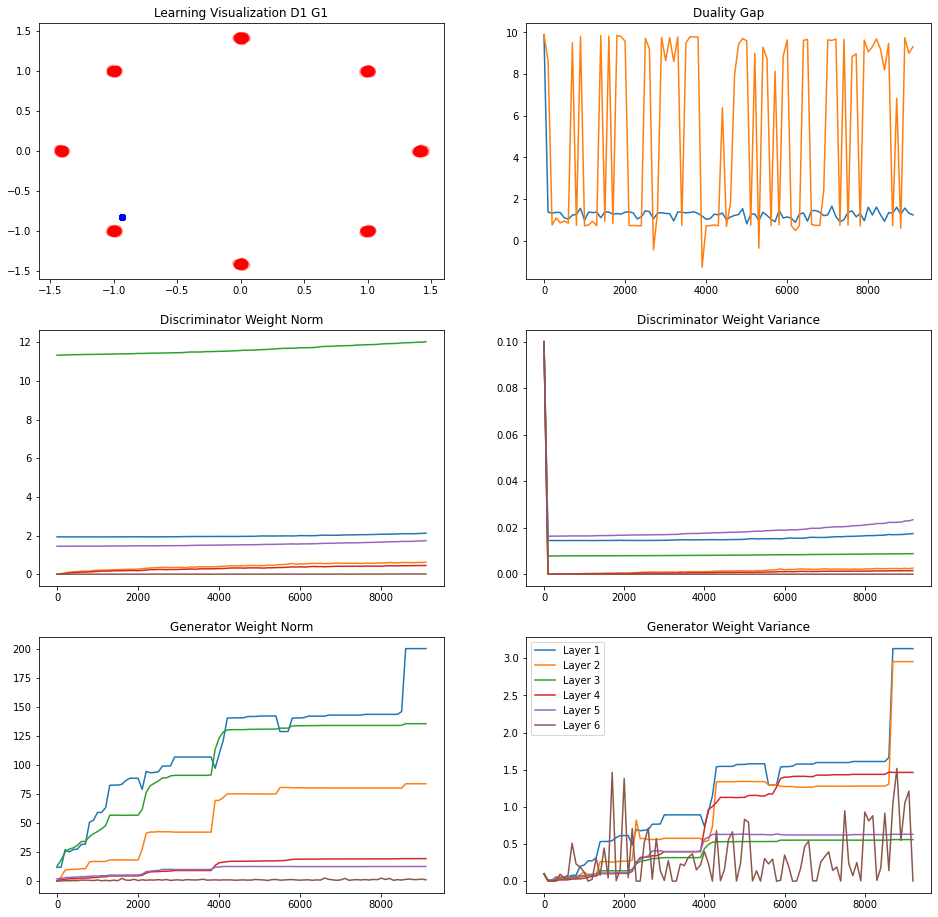

246/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.3919653
L Random  Duality Gap :  0.76257026


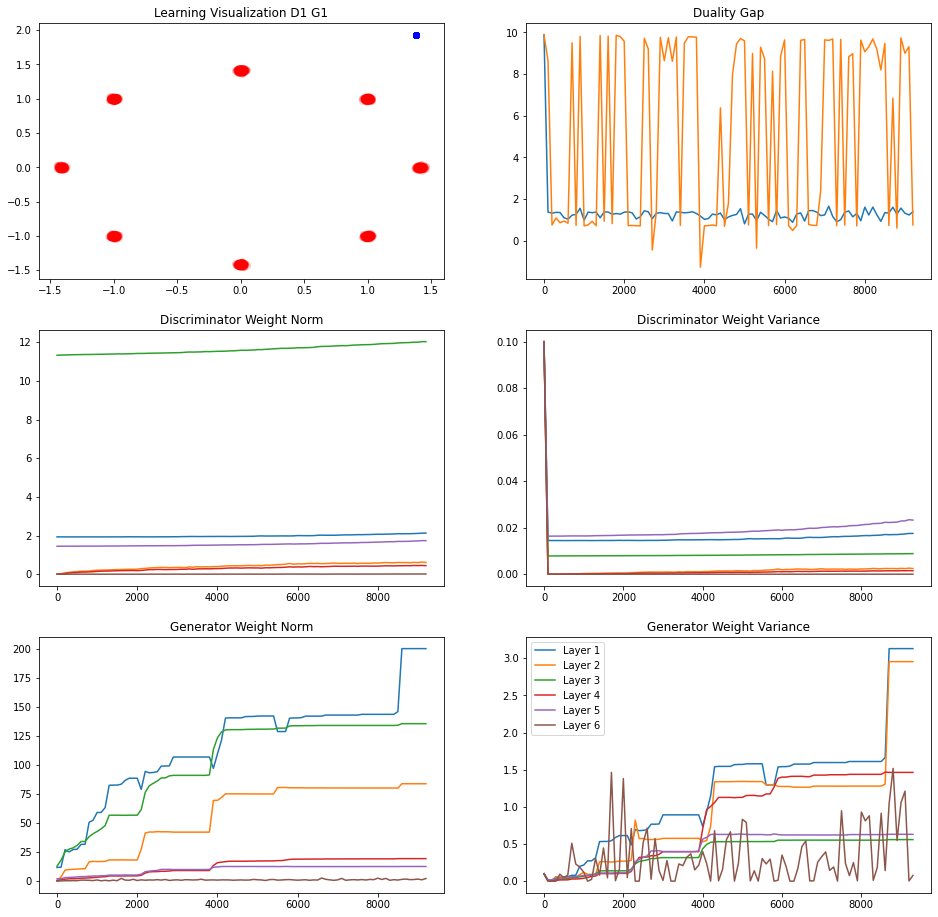

241/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  1.3955312
L Random  Duality Gap :  5.5412707


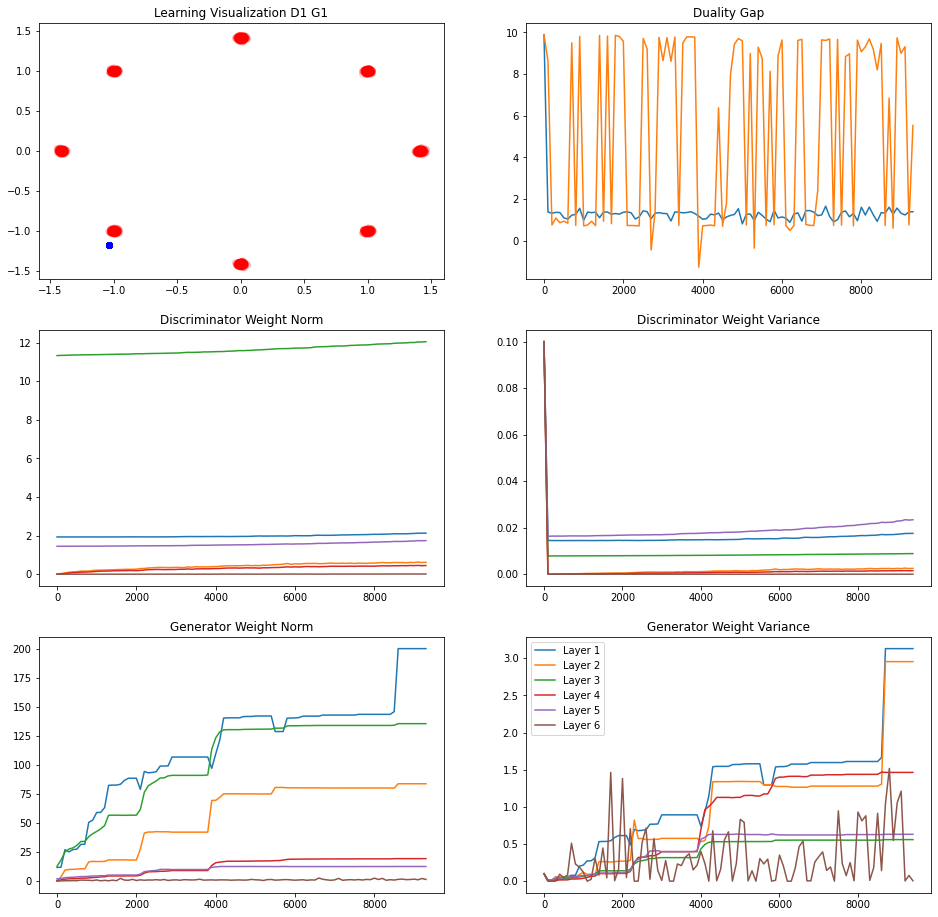

247/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.4558718
L Random  Duality Gap :  9.796946


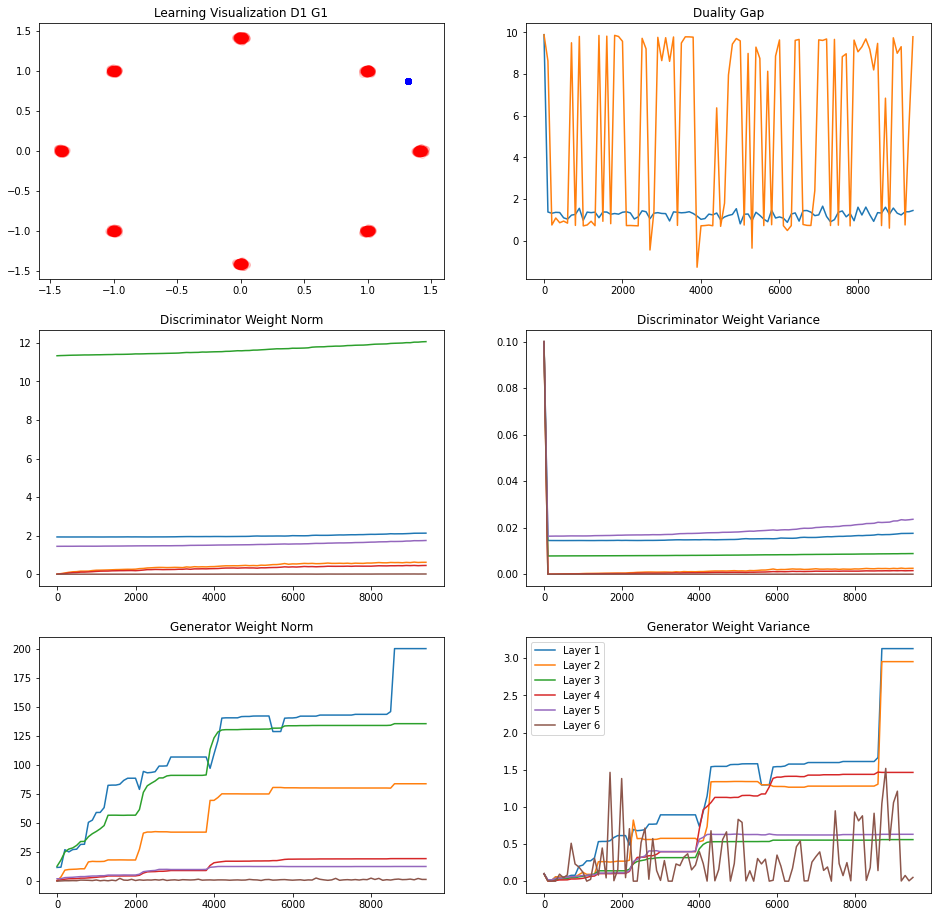

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.1316339
L Random  Duality Gap :  9.330101
245/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.5730832
L Random  Duality Gap :  9.360353


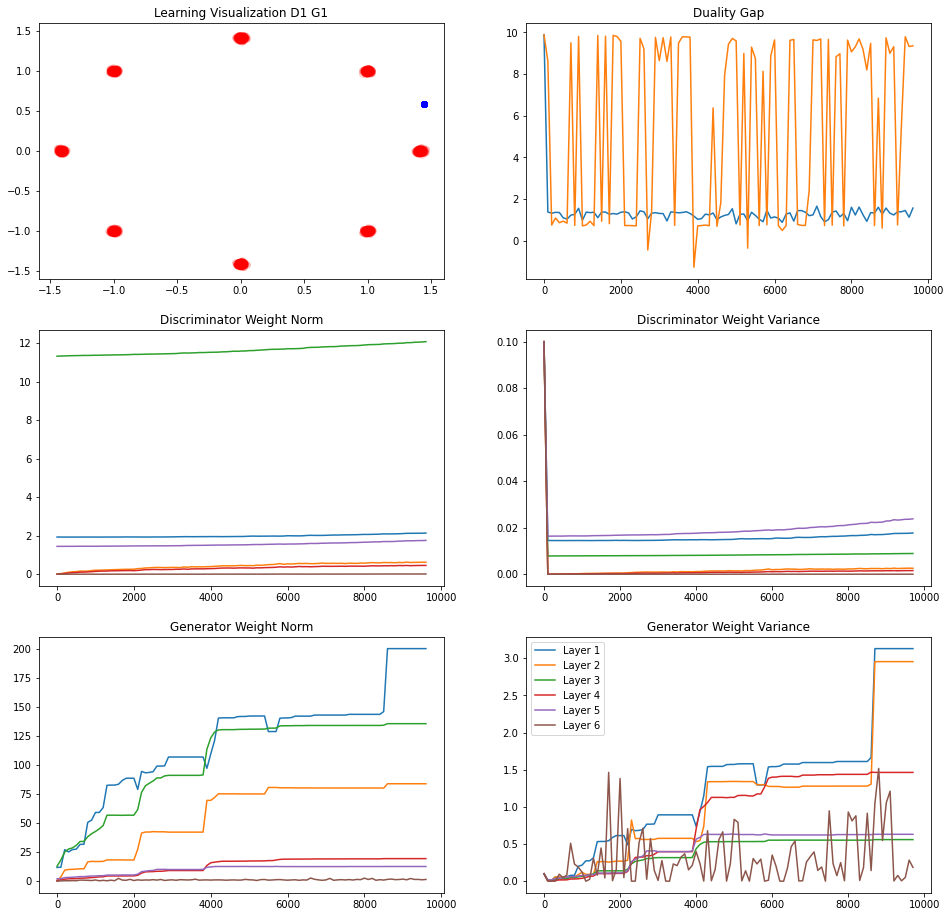

249/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.5247827
L Random  Duality Gap :  9.318017


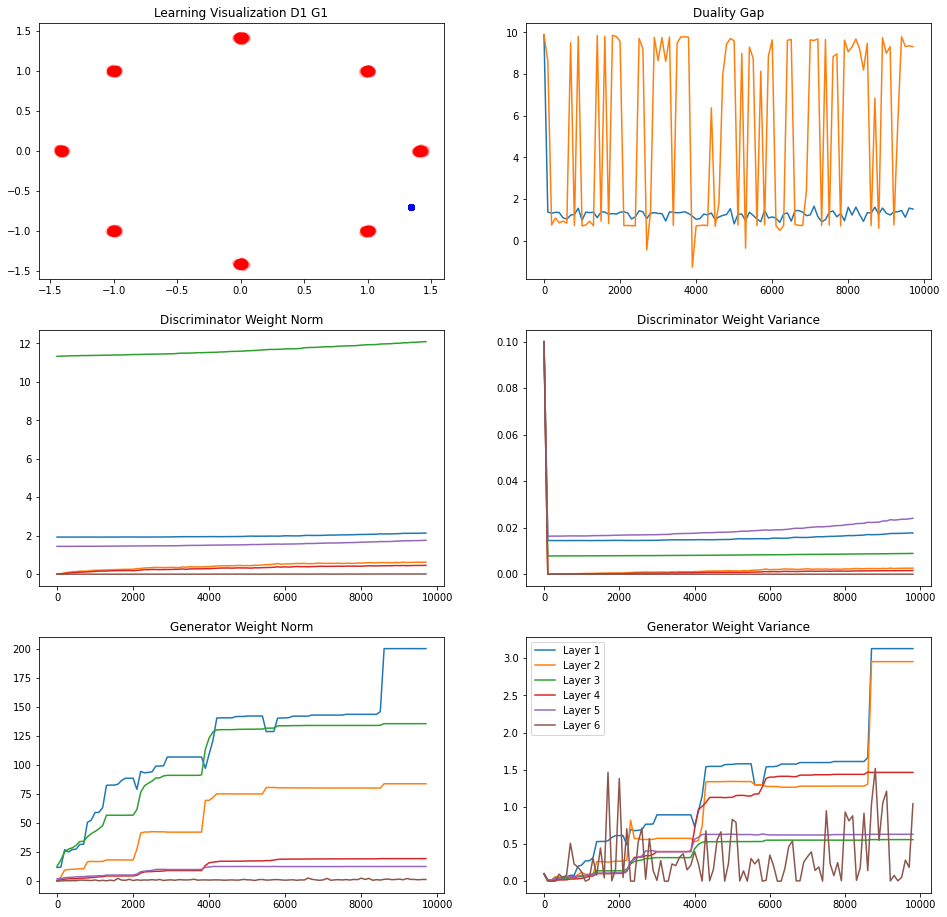

243/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.0993315
L Random  Duality Gap :  9.686819


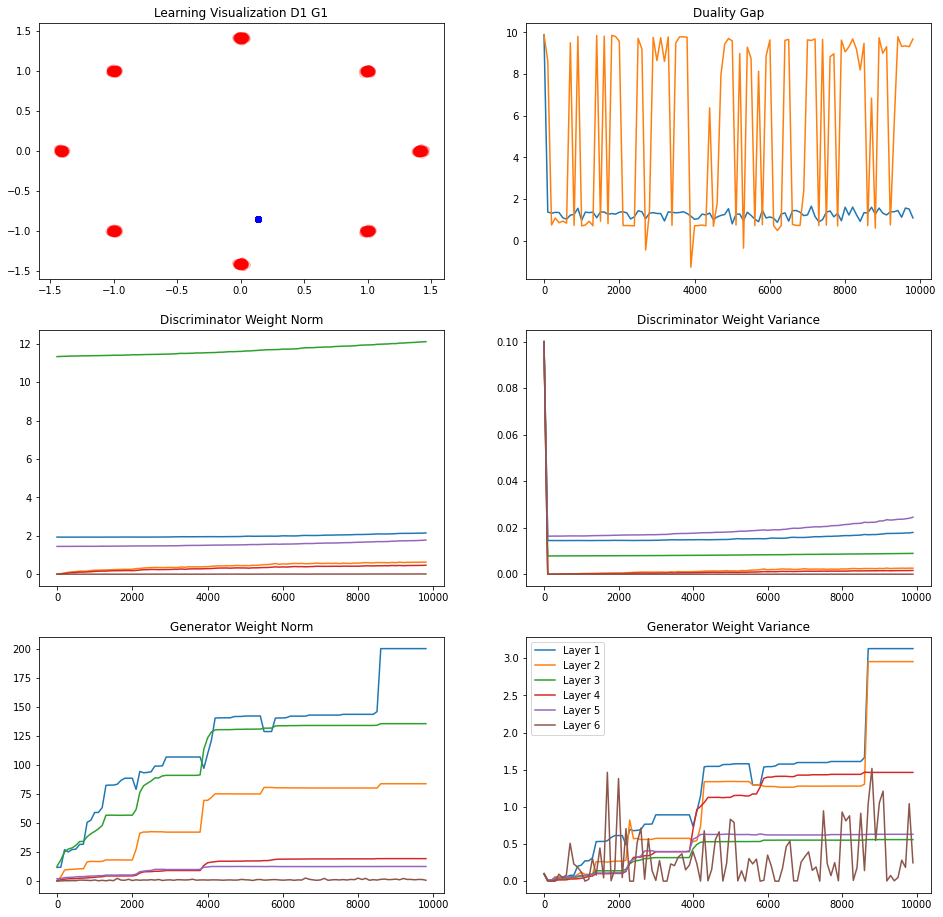

238/250 [===========================>..] - ETA: 0sVanilla   Duality GAP :  1.2914877
L Random  Duality Gap :  0.7123547


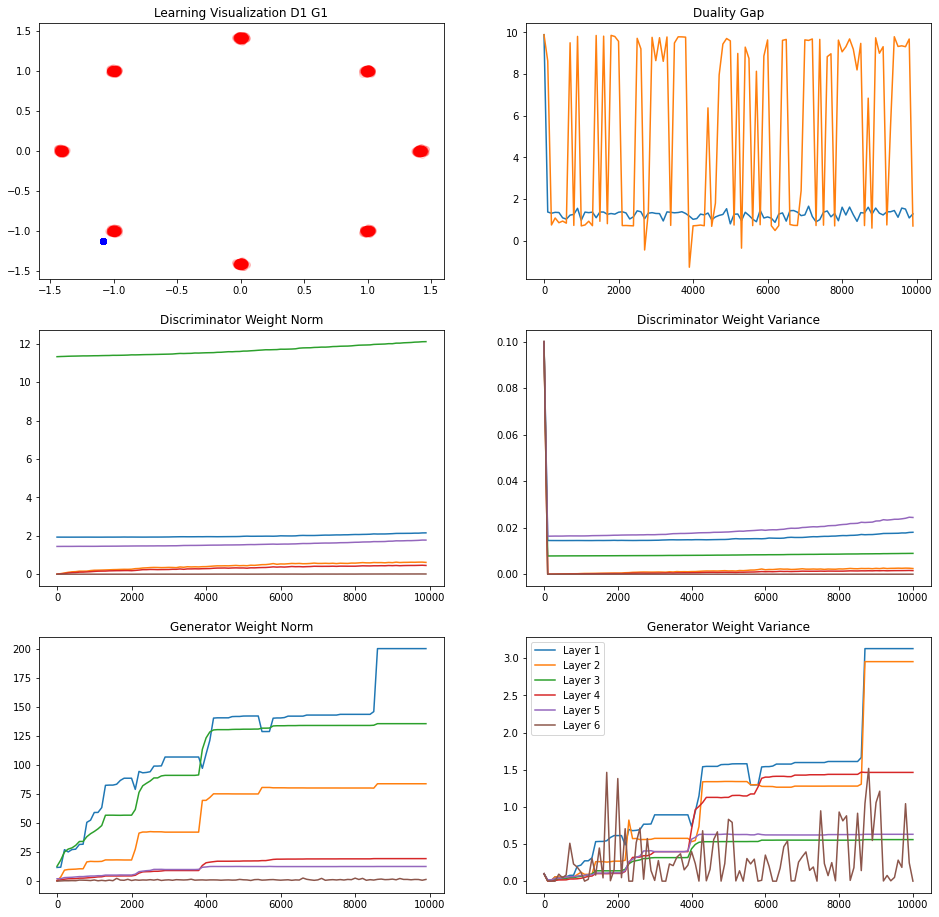

248/250 [============================>.] - ETA: 0sVanilla   Duality GAP :  1.3725458
L Random  Duality Gap :  9.687039
10000/10001 [============================>.] - ETA: 0s 

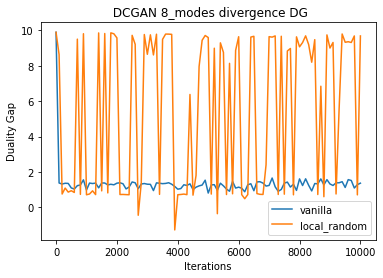

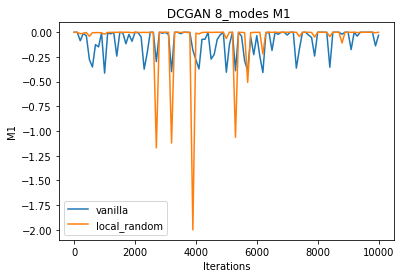

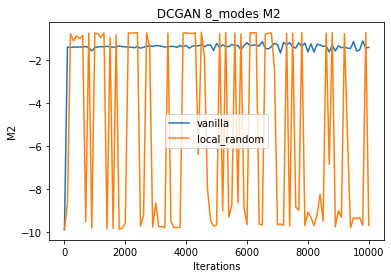

In [14]:

datasets      = ['8_modes']
# exp_types     = ['mode_collapse','convergence','divergence']
exp_types   = ['convergence','divergence']

total_data    = {}
epochs        = 10001
save_interval = 100
batch_size    = 128

model_data    = {}
for dataset in datasets:
    
    trials={}
    
    for setting in exp_types:
      
      models = {
      'DCGAN':DCGAN()
      } 

      for model in models.keys():
          print('--'*50+'\n\t\t{} {} {}\n'.format(dataset,model,setting)+'--'*50)
          save_path = './Experiments/{}/{}/{}'.format(dataset,model,setting)
          print(save_path)
          # save_path = './Experiments/{}/{}/{}'.format(dataset,model,setting)
          os.makedirs(save_path,exist_ok = True)               
          x_axis = [i for i in range(0,epochs,save_interval)]
          M1[model+'-vanilla-'+setting]=[]
          M2[model+'-vanilla-'+setting]=[]
          duality_gaps[model+'-vanilla-'+setting]=[]
          
          M1[model+'-local_random-'+setting]=[]
          M2[model+'-local_random-'+setting]=[]
          duality_gaps[model+'-local_random-'+setting]=[]
          
          models[model].configure_setting(setting)
          #train the model
          models[model].train(epochs=epochs, batch_size=batch_size, save_interval=save_interval,dataset=dataset,save_path=save_path)
          
          
          plt.figure()
          plt.title(' {} {} {} DG'.format(model,dataset,setting))
          plt.xlabel('Iterations')
          plt.ylabel('Duality Gap')
          plt.plot(x_axis,duality_gaps[model+'-vanilla-'+setting],label='vanilla')
          plt.plot(x_axis,duality_gaps[model+'-local_random-'+setting],label='local_random')
          plt.legend()
          plt.savefig(save_path+'/DG.png',bbox_inches='tight')
          
          
          plt.figure()
          plt.title(' {} {} M1'.format(model,dataset,setting))
          plt.xlabel('Iterations')
          plt.ylabel('M1')
          plt.plot(x_axis,M1[model+'-vanilla-'+setting],label='vanilla')
          plt.plot(x_axis,M1[model+'-local_random-'+setting],label='local_random')
          plt.legend()
          plt.savefig(save_path+'/M1.png',bbox_inches='tight')
          
          plt.figure()
          plt.title(' {} {} M2'.format(model,dataset,setting))
          plt.xlabel('Iterations')
          plt.ylabel('M2')
          plt.plot(x_axis,M2[model+'-vanilla-'+setting],label='vanilla')
          plt.plot(x_axis,M2[model+'-local_random-'+setting],label='local_random')
          plt.legend()
          plt.savefig(save_path+'/M2.png',bbox_inches='tight')
          
          trials['{}'.format(model)]={
              'DG':duality_gaps,
              'M1' :M1,
              'M2' :M2
          } 
          
    model_data[dataset]=models    
    total_data[dataset]=trials